In [1]:
import os
import sys
import numpy as np
import matplotlib.pyplot as plt

# Add the directory where dynamics.py and utils.py are located to sys.path
module_path = os.path.abspath(os.path.join('../src'))
if module_path not in sys.path:
    sys.path.append(module_path)

from tqdm import tqdm
from dynamics import SatelliteDynamics
from scipy.optimize import approx_fprime
from scipy.linalg import block_diag, solve
from utils import get_form_initial_conditions

In [2]:
# Simulation parameters
dt = 60.0  # Time step [s]
T = 395  # Duration [min]
T_RMSE = 300  # Index from which the RMSE is calculated
M = 1  # Number of Monte-Carlo simulations
N = 4  # Number of satellites
formation = 1
n_x = 6  # Number of states
n_p = 3  
n_y_1 = 3  # Number of measurements
n_y_2 = 2
n_y_3 = 2
n_y_4 = 2
K = T
W = 100 # Window size [min]

In [3]:
# Initial state vector and get the true state vectors (propagation) F
X_initial = get_form_initial_conditions(formation)
X_true = np.zeros((24, 1, T))
X_true[:, :, 0] = X_initial
for t in range(T - 1):
    X_true[:, :, t + 1] = SatelliteDynamics().x_new(dt, X_true[:, :, t])

# Process noise
q_chief_pos = 1e-1  # [m]
q_chief_vel = 1e-2 # [m / s]
Q_chief = (
    np.diag(np.concatenate([q_chief_pos * np.ones(3), q_chief_vel * np.ones(3)]))
    ** 2
)
q_deputy_pos = 1e0  # [m]
q_deputy_vel = 1e-2  # [m / s]
Q_deputy = (
    np.diag(np.concatenate([q_deputy_pos * np.ones(3), q_deputy_vel * np.ones(3)]))
    ** 2
)
Q_deputies = block_diag(Q_deputy, Q_deputy, Q_deputy)
Q = block_diag(Q_chief, Q_deputies)

# Observation noise
r_chief_pos = 1e-1  # [m]
R_chief = np.diag(np.concatenate([r_chief_pos * np.ones(3)])) ** 2
r_deputy_pos = 1e0  # [m]
R_deputies = np.diag(np.concatenate([r_deputy_pos * np.ones(6)])) ** 2
R = block_diag(R_chief, R_deputies)

# Initial deviation noise
p_pos_initial = 1e2  # [m]
p_vel_initial = 1e-2  # [m / s]
P = np.array([[1, 0, 0, 0, 0, 0], [0, 1, 0, 0, 0, 0], [0, 0, 1, 0, 0, 0]])

In [4]:
def h_function_chief(x_vec):
    """
    Computes the measurement vector based on the current state vector.
    The measurement vector includes position components.

    Parameters:
    x_vec (np.array): The current state vector of the satellite (position [km] and velocity [km / s]).
    """
    return x_vec[0:3]

def h_function_deputy(x_vec):
    """
    Computes the measurement vector based on the current state vector.

    Parameters:
    x_vec (np.array): The current state vector of the satellite (position [km] and velocity [km / s]).

    Returns:
    y (np.array): The measurement vector of the satellite (range [km]).
    """
    r_chief = x_vec[:3]
    r_deputy1 = x_vec[6:9]
    r_deputy2 = x_vec[12:15]
    r_deputy3 = x_vec[18:21]

    range_deputy1_chief = np.linalg.norm(r_deputy1 - r_chief)
    range_deputy1_deputy2 = np.linalg.norm(r_deputy1 - r_deputy2)
    range_deputy1_deputy3 = np.linalg.norm(r_deputy1 - r_deputy3)
    range_deputy2_chief = np.linalg.norm(r_deputy2 - r_chief)
    range_deputy2_deputy3 = np.linalg.norm(r_deputy2 - r_deputy3)
    range_deputy3_chief = np.linalg.norm(r_deputy3 - r_chief)

    return np.array(
        [
            [range_deputy1_chief],
            [range_deputy1_deputy2],
            [range_deputy1_deputy3],
            [range_deputy2_chief],
            [range_deputy2_deputy3],
            [range_deputy3_chief],
        ]
    )

def h(x_vec):
    return np.concatenate([h_function_chief(x_vec), h_function_deputy(x_vec)])

In [5]:
# Simulation setup
np.random.seed(43)
X_est = np.zeros_like(X_true)
initial_dev = np.concatenate(
    (
        p_pos_initial * np.random.randn(3, 1),
        p_vel_initial * np.random.randn(3, 1),
        p_pos_initial * np.random.randn(3, 1),
        p_vel_initial * np.random.randn(3, 1),
        p_pos_initial * np.random.randn(3, 1),
        p_vel_initial * np.random.randn(3, 1),
        p_pos_initial * np.random.randn(3, 1),
        p_vel_initial * np.random.randn(3, 1),
    )
)
X_est[:, :, 0] = X_initial + initial_dev
for t in range(T - 1):
    X_est[:, :, t + 1] = SatelliteDynamics().x_new(dt, X_est[:, :, t])

# Observations
Y = np.zeros((9, 1, T))
for t in range(T):
    Y[:, :, t] = h(X_true[:, :, t]) + np.random.normal(0, np.sqrt(np.diag(R)).reshape((9, 1)), size=(9, 1))
    
dev_chief_initial = np.linalg.norm(X_est[:3, :, :] - X_true[:3, :, :], axis=0).reshape(-1, 1)
dev_deputy1_initial = np.linalg.norm(X_est[6:9, :, :] - X_true[6:9, :, :], axis=0).reshape(-1, 1)
dev_deputy2_initial = np.linalg.norm(X_est[12:15, :, :] - X_true[12:15, :, :], axis=0).reshape(-1, 1)
dev_deputy3_initial = np.linalg.norm(X_est[18:21, :, :] - X_true[18:21, :, :], axis=0).reshape(-1, 1)

In [6]:
def f(x_0, y):
    f_x_0 = 0

    # Extract x_1(0), x_2(0), x_3(0), x_4(0) from flattened state vector x_0
    x_1_k = x_0[:n_x, :]
    x_2_k = x_0[n_x:2*n_x, :]
    x_3_k = x_0[2*n_x:3*n_x, :]
    x_4_k = x_0[3*n_x:4*n_x, :]
    
    # Iterate over all sliding window time steps
    for k in range(W):    
        # Absolute residual term: observed data y for each state
        y_1_k = y[:n_y_1, :, k]
        y_rel_k = y[n_y_1:, :, k]

        # Update the cost function with the residuals for self-measurements
        residual = y_1_k - P @ x_1_k
        f_x_0 += 1 / 2 * residual.T @ np.linalg.inv(R_chief) @ residual

        # Pairwise relative measurements
        y_21_k = y_rel_k[0]
        y_23_k = y_rel_k[1]
        y_24_k = y_rel_k[2]
        y_31_k = y_rel_k[3]
        y_34_k = y_rel_k[4]
        y_41_k = y_rel_k[5]

        # Process pairwise relative residuals for each pair
        pairs = [
            (2, 1, x_2_k, x_1_k, y_21_k),  # (2, 1)
            (2, 3, x_2_k, x_3_k, y_23_k),  # (2, 3)
            (2, 4, x_2_k, x_4_k, y_24_k),  # (2, 4)
            (3, 1, x_3_k, x_1_k, y_31_k),  # (3, 1)
            (3, 4, x_3_k, x_4_k, y_34_k),  # (3, 4)
            (4, 1, x_4_k, x_1_k, y_41_k),  # (4, 1)
        ]

        # Iterate over each pair and update the cost function with the residuals for pairwise measurements
        for i, j, x_i_k, x_j_k, y_ij_k in pairs:
            d_ij_k_vec = P @ x_i_k - P @ x_j_k
            d_ij_k = np.linalg.norm(d_ij_k_vec)
            f_x_0 += (y_ij_k - d_ij_k) ** 2 / (2 * r_deputy_pos**2)

        if k < W - 1:
            # Get x_1(k), x_2(k), x_3(k), x_4(k) from the state vector x_0
            x_1_k = SatelliteDynamics().x_new(dt, x_1_k)
            x_2_k = SatelliteDynamics().x_new(dt, x_2_k)
            x_3_k = SatelliteDynamics().x_new(dt, x_3_k)
            x_4_k = SatelliteDynamics().x_new(dt, x_4_k)

    return f_x_0

def grad_f(x_0, y):
    grad_f_x_0 = np.zeros_like(x_0)

    # Extract x_1(0), x_2(0), x_3(0), x_4(0) from flattened state vector x_0
    x_1_k = x_0[:n_x, :]
    x_2_k = x_0[n_x:2*n_x, :]
    x_3_k = x_0[2*n_x:3*n_x, :]
    x_4_k = x_0[3*n_x:4*n_x, :]
    STM_t0_1 = np.eye(n_x)
    STM_t0_2 = np.eye(n_x)
    STM_t0_3 = np.eye(n_x)
    STM_t0_4 = np.eye(n_x)
    
    # Iterate over all sliding window time steps
    for k in range(W):
        # Absolute residual term: observed data y for each state
        y_1_k = y[:n_y_1, :, k]
        y_rel_k = y[n_y_1:, :, k]

        # Compute gradients for the absolute residual terms
        grad_f_x_0[:n_x, :] -= STM_t0_1.T @ P.T @ np.linalg.inv(R_chief) @ (y_1_k - P @ x_1_k)

        # Pairwise relative measurements
        y_21_k = y_rel_k[0]
        y_23_k = y_rel_k[1]
        y_24_k = y_rel_k[2]
        y_31_k = y_rel_k[3]
        y_34_k = y_rel_k[4]
        y_41_k = y_rel_k[5]

        # Process pairwise relative residuals for each pair
        pairs = [
            (2, 1, x_2_k, x_1_k, y_21_k, STM_t0_2, STM_t0_1),  # (2, 1)
            (2, 3, x_2_k, x_3_k, y_23_k, STM_t0_2, STM_t0_3),  # (2, 3)
            (2, 4, x_2_k, x_4_k, y_24_k, STM_t0_2, STM_t0_4),  # (2, 4)
            (3, 1, x_3_k, x_1_k, y_31_k, STM_t0_3, STM_t0_1),  # (3, 1)
            (3, 4, x_3_k, x_4_k, y_34_k, STM_t0_3, STM_t0_4),  # (3, 4)
            (4, 1, x_4_k, x_1_k, y_41_k, STM_t0_4, STM_t0_1),  # (4, 1)
        ]

        # Iterate over each pair and compute gradients
        for i, j, x_i_k, x_j_k, y_ij_k, STM_t0_i, STM_t0_j in pairs:
            d_ij_k_vec = P @ x_i_k - P @ x_j_k
            d_ij_k = np.linalg.norm(d_ij_k_vec)

            # Update the gradient of f(x) with respect to x_i(k) and x_j(k)
            grad_f_x_0[(i - 1) * n_x:i * n_x, :] -= (y_ij_k - d_ij_k) / r_deputy_pos**2 * (STM_t0_i.T @ P.T @ d_ij_k_vec) / d_ij_k
            grad_f_x_0[(j - 1) * n_x:j * n_x, :] += (y_ij_k - d_ij_k) / r_deputy_pos**2 * (STM_t0_j.T @ P.T @ d_ij_k_vec) / d_ij_k

        if k < W - 1:
            # Get x_1(k), x_2(k), x_3(k), x_4(k) from the state vector x_0
            STM_t0_1_old = STM_t0_1
            STM_t0_2_old = STM_t0_2
            STM_t0_3_old = STM_t0_3
            STM_t0_4_old = STM_t0_4
            x_1_k, STM_t0_1 = SatelliteDynamics().x_new_and_F(dt, x_1_k)
            x_2_k, STM_t0_2 = SatelliteDynamics().x_new_and_F(dt, x_2_k)
            x_3_k, STM_t0_3 = SatelliteDynamics().x_new_and_F(dt, x_3_k)
            x_4_k, STM_t0_4 = SatelliteDynamics().x_new_and_F(dt, x_4_k)
            STM_t0_1 = STM_t0_1 @ STM_t0_1_old
            STM_t0_2 = STM_t0_2 @ STM_t0_2_old
            STM_t0_3 = STM_t0_3 @ STM_t0_3_old
            STM_t0_4 = STM_t0_4 @ STM_t0_4_old

    return grad_f_x_0

def hessian_f(x_0, y):
    hessian_f_x_0 = np.zeros((x_0.shape[0], x_0.shape[0]))  # Initialize Hessian matrix
    
    # Extract x_1(0), x_2(0), x_3(0), x_4(0) from flattened state vector x_0
    x_1_k = x_0[:n_x, :]
    x_2_k = x_0[n_x:2*n_x, :]
    x_3_k = x_0[2*n_x:3*n_x, :]
    x_4_k = x_0[3*n_x:4*n_x, :]
    STM_t0_1 = np.eye(n_x)
    STM_t0_2 = np.eye(n_x)
    STM_t0_3 = np.eye(n_x)
    STM_t0_4 = np.eye(n_x)

    # Iterate over all sliding window time steps
    for k in range(W):
        # Absolute residual term: observed data y for each state
        y_rel_k = y[n_y_1:, :, k]

        # Absolute measurement residuals' Hessian
        hessian_f_x_0[:n_x, :n_x] += STM_t0_1.T @ P.T @ np.linalg.inv(R_chief) @ P @ STM_t0_1 

        # Pairwise relative measurements
        y_21_k = y_rel_k[0]
        y_23_k = y_rel_k[1]
        y_24_k = y_rel_k[2]
        y_31_k = y_rel_k[3]
        y_34_k = y_rel_k[4]
        y_41_k = y_rel_k[5]

        # Process pairwise relative residuals for each pair in the tree
        pairs = [
            (2, 1, x_2_k, x_1_k, y_21_k, STM_t0_2, STM_t0_1),  # (2, 1)
            (3, 1, x_3_k, x_1_k, y_31_k, STM_t0_3, STM_t0_1),  # (3, 1)
            (4, 1, x_4_k, x_1_k, y_41_k, STM_t0_4, STM_t0_1),  # (4, 1)
        ]

        # Iterate over each pair and compute gradients
        for i, j, x_i_k, x_j_k, y_ij_k, STM_t0_i, STM_t0_j in pairs:
            d_ij_k_vec = P @ x_i_k - P @ x_j_k
            d_ij_k = np.linalg.norm(d_ij_k_vec)

            # Update the Hessian for x_i(k) and x_j(k)
            idx_i = n_x * (i - 1)
            idx_j = n_x * (j - 1)
            
            hessian_f_x_0[idx_i:idx_i + n_x, idx_i:idx_i + n_x] -= 1 / (r_deputy_pos ** 2) * (STM_t0_i.T @ ((y_ij_k - d_ij_k) / d_ij_k * P.T @ P - y_ij_k / d_ij_k**3 * P.T @ d_ij_k_vec @ d_ij_k_vec.T @ P) @ STM_t0_i)
            hessian_f_x_0[idx_i:idx_i + n_x, idx_j:idx_j + n_x] += 1 / (r_deputy_pos ** 2) * (STM_t0_i.T @ ((y_ij_k - d_ij_k) / d_ij_k * P.T @ P - y_ij_k / d_ij_k**3 * P.T @ d_ij_k_vec @ d_ij_k_vec.T @ P) @ STM_t0_j)
            hessian_f_x_0[idx_j:idx_j + n_x, idx_i:idx_i + n_x] += 1 / (r_deputy_pos ** 2) * (STM_t0_j.T @ ((y_ij_k - d_ij_k) / d_ij_k * P.T @ P - y_ij_k / d_ij_k**3 * P.T @ d_ij_k_vec @ d_ij_k_vec.T @ P) @ STM_t0_i)
            hessian_f_x_0[idx_j:idx_j + n_x, idx_j:idx_j + n_x] -= 1 / (r_deputy_pos ** 2) * (STM_t0_j.T @ ((y_ij_k - d_ij_k) / d_ij_k * P.T @ P - y_ij_k / d_ij_k**3 * P.T @ d_ij_k_vec @ d_ij_k_vec.T @ P) @ STM_t0_j)
            
        # Process pairwise relative residuals for each pair in the residual set of edges
        pairs = [
            (2, 3, x_2_k, x_3_k, y_23_k, STM_t0_2, STM_t0_3),  # (2, 3)
            (2, 4, x_2_k, x_4_k, y_24_k, STM_t0_2, STM_t0_4),  # (2, 4)
            (3, 4, x_3_k, x_4_k, y_34_k, STM_t0_3, STM_t0_4),  # (3, 4)
        ]

        # Iterate over each pair and compute gradients
        for i, j, x_i_k, x_j_k, y_ij_k, STM_t0_i, STM_t0_j in pairs:
            d_ij_k_vec = P @ x_i_k - P @ x_j_k
            d_ij_k = np.linalg.norm(d_ij_k_vec)

            # Update the Hessian for x_i(k) and x_j(k)
            idx_i = n_x * (i - 1)
            idx_j = n_x * (j - 1)
            
            hessian_f_x_0[idx_i:idx_i + n_x, idx_i:idx_i + n_x] -= 1 / (r_deputy_pos ** 2) * (STM_t0_i.T @ ((y_ij_k - d_ij_k) / d_ij_k * P.T @ P - y_ij_k / d_ij_k**3 * P.T @ d_ij_k_vec @ d_ij_k_vec.T @ P) @ STM_t0_i)
            # hessian_f_x_0[idx_i:idx_i + n_x, idx_j:idx_j + n_x] += 1 / (r_deputy_pos ** 2) * (STM_t0_i.T @ ((y_ij_k - d_ij_k) / d_ij_k * P.T @ P - y_ij_k / d_ij_k**3 * P.T @ d_ij_k_vec @ d_ij_k_vec.T @ P) @ STM_t0_j)
            # hessian_f_x_0[idx_j:idx_j + n_x, idx_i:idx_i + n_x] += 1 / (r_deputy_pos ** 2) * (STM_t0_j.T @ ((y_ij_k - d_ij_k) / d_ij_k * P.T @ P - y_ij_k / d_ij_k**3 * P.T @ d_ij_k_vec @ d_ij_k_vec.T @ P) @ STM_t0_i)
            hessian_f_x_0[idx_j:idx_j + n_x, idx_j:idx_j + n_x] -= 1 / (r_deputy_pos ** 2) * (STM_t0_j.T @ ((y_ij_k - d_ij_k) / d_ij_k * P.T @ P - y_ij_k / d_ij_k**3 * P.T @ d_ij_k_vec @ d_ij_k_vec.T @ P) @ STM_t0_j)

        if k < W - 1:
            # Get x_1(k), x_2(k), x_3(k), x_4(k) from the state vector x_0
            STM_t0_1_old = STM_t0_1
            STM_t0_2_old = STM_t0_2
            STM_t0_3_old = STM_t0_3
            STM_t0_4_old = STM_t0_4
            x_1_k, STM_t0_1 = SatelliteDynamics().x_new_and_F(dt, x_1_k)
            x_2_k, STM_t0_2 = SatelliteDynamics().x_new_and_F(dt, x_2_k)
            x_3_k, STM_t0_3 = SatelliteDynamics().x_new_and_F(dt, x_3_k)
            x_4_k, STM_t0_4 = SatelliteDynamics().x_new_and_F(dt, x_4_k)
            STM_t0_1 = STM_t0_1 @ STM_t0_1_old
            STM_t0_2 = STM_t0_2 @ STM_t0_2_old
            STM_t0_3 = STM_t0_3 @ STM_t0_3_old
            STM_t0_4 = STM_t0_4 @ STM_t0_4_old

    return hessian_f_x_0

In [7]:
def L(x_0, y):
    """
    Lagrangian wrapper for the cost function.
    """
    return f(x_0, y)
    
def grad_L(x_0, y):
    """
    Gradient of Lagrangian wrapper.
    """
    return grad_f(x_0, y)

def hessian_L(x_0, y):
    """
    Hessian of Lagrangian wrapper.
    """
    return hessian_f(x_0, y)

In [8]:
class approxH_Newton:
    def __init__(self, grad_tol=1e0, max_iter=20):
        self.grad_tol = grad_tol
        self.max_iter = max_iter
        
        # Storage for results
        self.cost_function_values = []
        self.grad_norm_values = []

    def solve(self, x_init, Y, X_true):
        x = x_init
            
        prev_cost_function_value = None
        prev_grad_norm_value = None
        prev_global_error = None
        
        for iteration in range(self.max_iter):
            # Compute the cost function, gradient and approximated Hessian
            L_x = L(x, Y)
            grad_L_x = grad_L(x, Y)
            hessian_L_x = hessian_L(x, Y)

            # Convergence tracking
            cost_function_value = L_x[0][0]
            grad_norm_value = np.linalg.norm(grad_L_x)

            # Store the norms
            self.cost_function_values.append(cost_function_value)
            self.grad_norm_values.append(grad_norm_value)
            
            if prev_cost_function_value is not None:
                cost_function_change = (cost_function_value - prev_cost_function_value) / abs(prev_cost_function_value) * 100
                grad_norm_change = (grad_norm_value - prev_grad_norm_value) / abs(prev_grad_norm_value) * 100
                global_error_change = (np.linalg.norm(x - X_true) - prev_global_error) / abs(prev_global_error) * 100
            prev_cost_function_value = cost_function_value
            prev_grad_norm_value = grad_norm_value
            prev_global_error = np.linalg.norm(x - X_true)

            # Check convergence and print metrics
            if grad_norm_value < self.grad_tol or iteration + 1 == self.max_iter:
                print(f"STOP on Iteration {iteration}\nCost function = {cost_function_value} ({cost_function_change:.2f}%)\nGradient norm = {grad_norm_value} ({grad_norm_change:.2f}%)\nGlobal relative error = {np.linalg.norm(x - X_true)} ({global_error_change:.2f}%)")
                print(f"Final position relative errors: {np.linalg.norm(x[0:3, :] - X_true[0:3, :])} m, {np.linalg.norm(x[6:9, :] - X_true[6:9, :])} m, {np.linalg.norm(x[12:15, :] - X_true[12:15, :])} m, {np.linalg.norm(x[18:21, :] - X_true[18:21, :])} m\n")
                break
            else:
                if iteration == 0:
                    print(f"Before applying the algorithm\nCost function: {cost_function_value}\nGradient norm: {grad_norm_value}\nGlobal relative error: {np.linalg.norm(x - X_true)}")
                else:
                    print(f"Iteration {iteration}\nCost function: {cost_function_value} ({cost_function_change:.2f}%)\nGradient norm: {grad_norm_value} ({grad_norm_change:.2f}%)\nGlobal relative error: {np.linalg.norm(x - X_true)} ({global_error_change:.2f}%)")
                    
            # Print relative errors 
            print(f"Position relative errors: {np.linalg.norm(x[0:3, :] - X_true[0:3, :])} m, {np.linalg.norm(x[6:9, :] - X_true[6:9, :])} m, {np.linalg.norm(x[12:15, :] - X_true[12:15, :])} m, {np.linalg.norm(x[18:21, :] - X_true[18:21, :])} m\n")
            
            # Solve for the Newton step
            delta_x = solve(hessian_L_x, -grad_L_x)
            x += delta_x

        return x

In [9]:
def give_me_the_plots(cost_function_values, grad_norm_values):
    iterations = np.arange(0, len(cost_function_values))

    # Plot 1
    plt.semilogy(iterations, cost_function_values, '.-')
    plt.xlabel(r'$m$')
    plt.ylabel(r'$L(x^{(m)})$')
    plt.grid(True)
    plt.grid(True, which="minor", linestyle='--')
    plt.show()
    
    # Plot 2
    plt.semilogy(iterations, grad_norm_values, '.-')
    plt.xlabel(r'$m$')
    plt.ylabel(r'$||\nabla L(x^{(m)})||_2$')
    plt.grid(True)
    plt.grid(True, which="minor", linestyle='--')
    plt.show()

Windows:   0%|          | 0/296 [00:00<?, ?it/s]

Before applying the algorithm
Cost function: 1027490136.0165378
Gradient norm: 29945857737.629856
Global relative error: 354.63849616863644
Position relative errors: 101.72796255564326 m, 242.56776705223683 m, 194.18001273776096 m, 137.38589643018517 m

Iteration 1
Cost function: 1805310339.878995 (75.70%)
Gradient norm: 4895500700.201737 (-83.65%)
Global relative error: 3505.2985175507188 (888.41%)
Position relative errors: 6.267719870176709 m, 2834.4630485896505 m, 1114.0393558526205 m, 1735.430448655689 m

Iteration 2
Cost function: 219243947.96232367 (-87.86%)
Gradient norm: 1666866929.0770419 (-65.95%)
Global relative error: 2860.587518749225 (-18.39%)
Position relative errors: 7.68104767883091 m, 1754.6240047998335 m, 1969.825125923949 m, 1106.3197998084124 m

Iteration 3
Cost function: 905709876.8523309 (313.11%)
Gradient norm: 3095526209.3123026 (85.71%)
Global relative error: 7070.220154665864 (147.16%)
Position relative errors: 2.923947423063939 m, 2620.8402543091706 m, 1099.

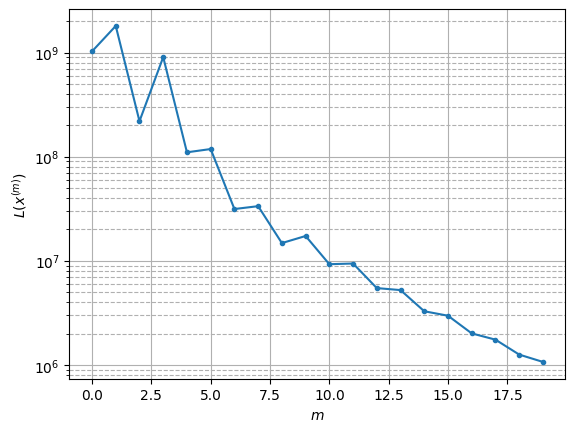

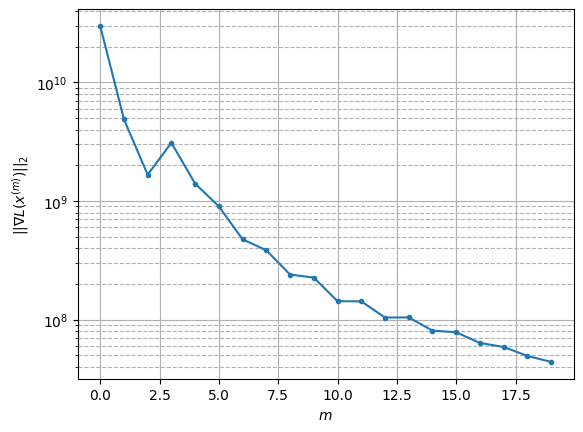

Windows:   0%|          | 1/296 [00:41<3:25:31, 41.80s/it]

Before applying the algorithm
Cost function: 1032832.8330360383
Gradient norm: 40302472.039876305
Global relative error: 1023.8817256976372
Position relative errors: 0.48962506551896795 m, 572.0455355009952 m, 650.0113023640904 m, 546.4271076271248 m

Iteration 1
Cost function: 770949.7246662419 (-25.36%)
Gradient norm: 35021918.039757796 (-13.10%)
Global relative error: 956.9350935998991 (-6.54%)
Position relative errors: 0.3212305823462096 m, 512.2775784782693 m, 600.6467065568875 m, 540.850908851047 m

Iteration 2
Cost function: 655889.2762828056 (-14.92%)
Gradient norm: 30967514.99011316 (-11.58%)
Global relative error: 891.9109569573197 (-6.80%)
Position relative errors: 0.3351840504300694 m, 487.58629586447233 m, 575.9444526685425 m, 475.4497749726295 m

Iteration 3
Cost function: 513355.64012311026 (-21.73%)
Gradient norm: 27532092.485132776 (-11.09%)
Global relative error: 828.3629672144571 (-7.12%)
Position relative errors: 0.2618433202399779 m, 445.94455451970873 m, 515.25251

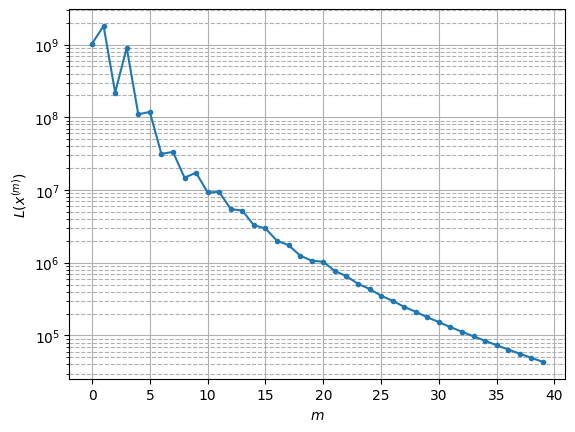

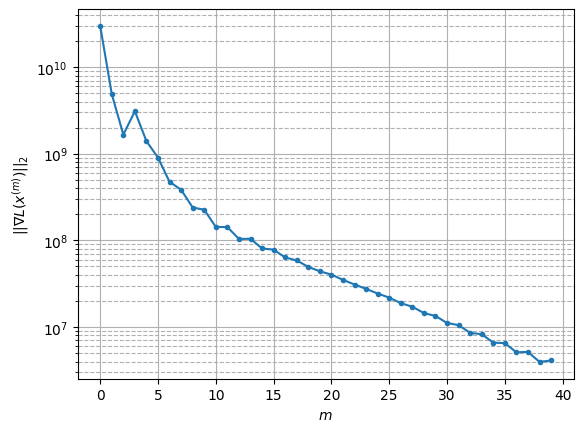

Windows:   1%|          | 2/296 [01:25<3:29:06, 42.68s/it]

Before applying the algorithm
Cost function: 42066.942074517996
Gradient norm: 5200411.0416514175
Global relative error: 299.6493837354293
Position relative errors: 0.06029915032822144 m, 157.57440396070322 m, 181.08294385655108 m, 179.35720324328463 m

Iteration 1
Cost function: 36799.757924974474 (-12.52%)
Gradient norm: 3483957.603304969 (-33.01%)
Global relative error: 285.46552722026337 (-4.73%)
Position relative errors: 0.05506976227186748 m, 148.17076082941156 m, 184.10617008775043 m, 160.12773326627283 m

Iteration 2
Cost function: 32425.566328964007 (-11.89%)
Gradient norm: 3521178.9521201407 (1.07%)
Global relative error: 266.3185334841897 (-6.71%)
Position relative errors: 0.04932388208238387 m, 135.84038443637306 m, 162.78681491194993 m, 161.16260498059575 m

Iteration 3
Cost function: 28677.43845461402 (-11.56%)
Gradient norm: 2520118.079190516 (-28.43%)
Global relative error: 251.7569802814676 (-5.47%)
Position relative errors: 0.04495933167155309 m, 129.45985977588433 m,

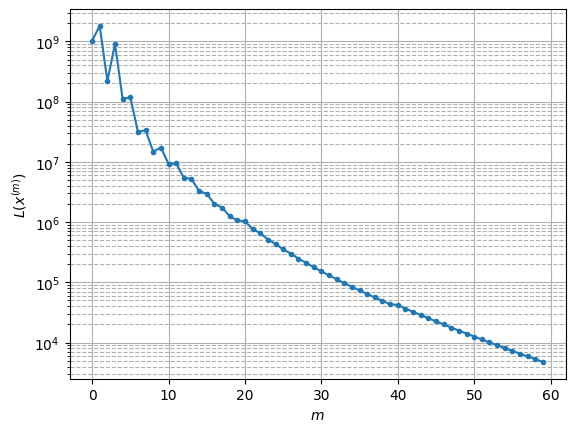

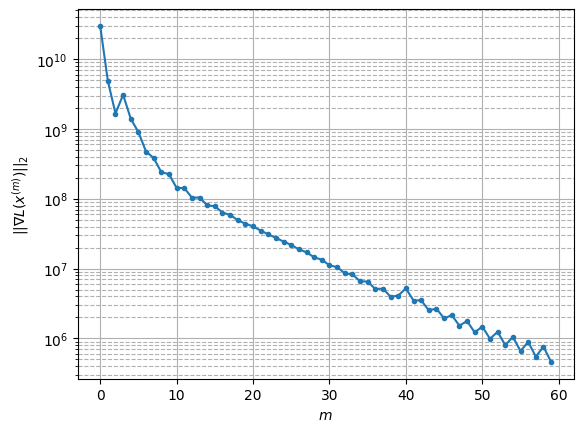

Windows:   1%|          | 3/296 [02:07<3:27:27, 42.48s/it]

Before applying the algorithm
Cost function: 4858.044427581102
Gradient norm: 602360.7985085163
Global relative error: 97.91034776032
Position relative errors: 0.006381532527899902 m, 48.51775551919507 m, 62.027382493022266 m, 58.18130929036662 m

Iteration 1
Cost function: 4343.598092759974 (-10.59%)
Gradient norm: 560022.921589489 (-7.03%)
Global relative error: 92.07864621088738 (-5.96%)
Position relative errors: 0.012225105817575098 m, 45.17276911461199 m, 57.02546319445518 m, 56.44459136295472 m

Iteration 2
Cost function: 3901.2050534649397 (-10.18%)
Gradient norm: 391777.3657604122 (-30.04%)
Global relative error: 86.43990594950897 (-6.12%)
Position relative errors: 0.009516485823311669 m, 42.27145412496845 m, 55.147770627383736 m, 51.41694855705163 m

Iteration 3
Cost function: 3512.227725533159 (-9.97%)
Gradient norm: 549461.7674786275 (40.25%)
Global relative error: 81.17082523434318 (-6.10%)
Position relative errors: 0.00804266197262593 m, 39.40044706795997 m, 50.42705266000

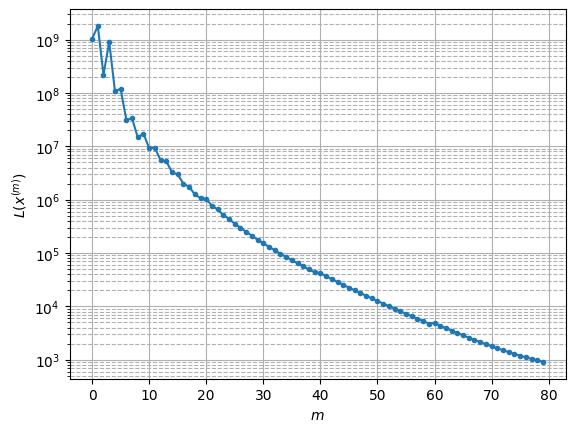

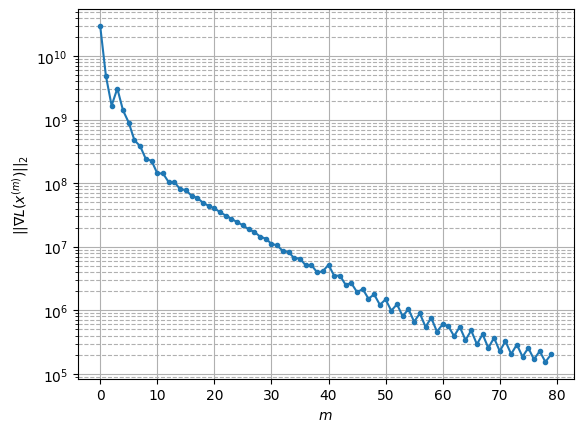

Windows:   1%|▏         | 4/296 [02:49<3:25:56, 42.32s/it]

Before applying the algorithm
Cost function: 934.6327979435507
Gradient norm: 404438.04540070664
Global relative error: 31.24595485008547
Position relative errors: 0.010887003890072418 m, 14.738698143605179 m, 19.231449501538258 m, 19.728947478170486 m

Iteration 1
Cost function: 871.9908908691259 (-6.70%)
Gradient norm: 184556.16244731695 (-54.37%)
Global relative error: 29.129565824330463 (-6.77%)
Position relative errors: 0.012556077992737693 m, 13.822589745729656 m, 18.64227051557453 m, 17.604912064693533 m

Iteration 2
Cost function: 819.2672375357336 (-6.05%)
Gradient norm: 194997.9332274165 (5.66%)
Global relative error: 27.22857759509286 (-6.53%)
Position relative errors: 0.0129197436754263 m, 12.6856737673453 m, 17.04836982640438 m, 17.024152817084822 m

Iteration 3
Cost function: 773.1072768860752 (-5.63%)
Gradient norm: 136873.7727430945 (-29.81%)
Global relative error: 25.553443767248897 (-6.15%)
Position relative errors: 0.01341312956608337 m, 11.997120007159777 m, 16.4172

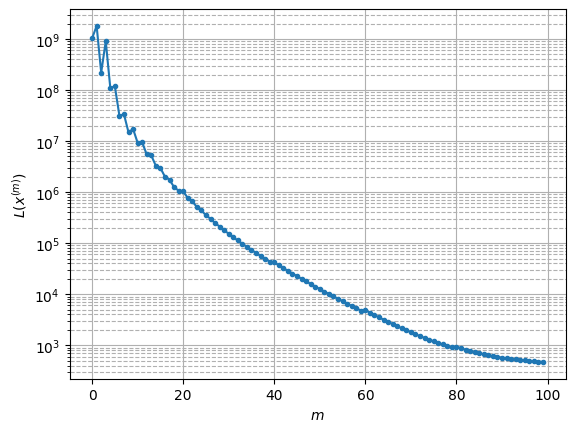

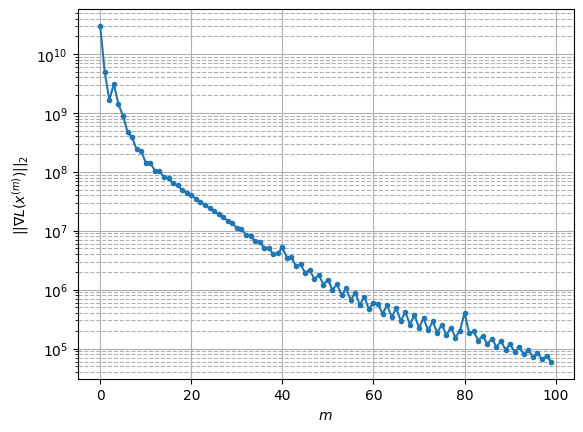

Windows:   2%|▏         | 5/296 [03:33<3:27:36, 42.81s/it]

Before applying the algorithm
Cost function: 470.05281657384853
Gradient norm: 111446.29222622026
Global relative error: 9.233749666189288
Position relative errors: 0.01809441781742513 m, 4.206132201623176 m, 5.819098418113601 m, 5.8058869760968825 m

Iteration 1
Cost function: 463.60372826770623 (-1.37%)
Gradient norm: 58677.944917610344 (-47.35%)
Global relative error: 8.496270004057145 (-7.99%)
Position relative errors: 0.016360019677737023 m, 3.7751606542605085 m, 5.390286412514262 m, 5.373945330465808 m

Iteration 2
Cost function: 458.197229925205 (-1.17%)
Gradient norm: 46896.40205157086 (-20.08%)
Global relative error: 7.9657167967814715 (-6.24%)
Position relative errors: 0.016605432874727412 m, 3.549167715772246 m, 5.074095268692872 m, 5.010919549169331 m

Iteration 3
Cost function: 453.4645029678488 (-1.03%)
Gradient norm: 56527.79522357873 (20.54%)
Global relative error: 7.4393080540224075 (-6.61%)
Position relative errors: 0.01676855515092188 m, 3.308824807286571 m, 4.714477

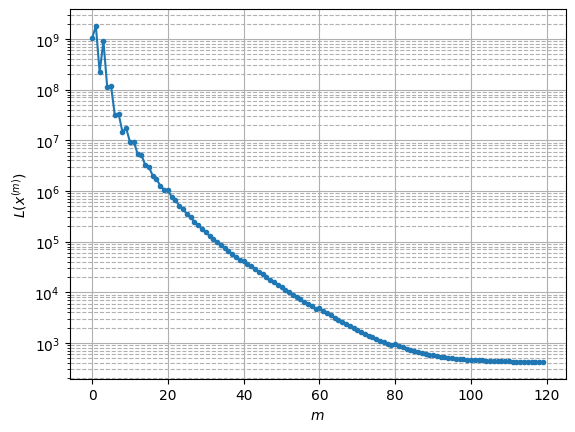

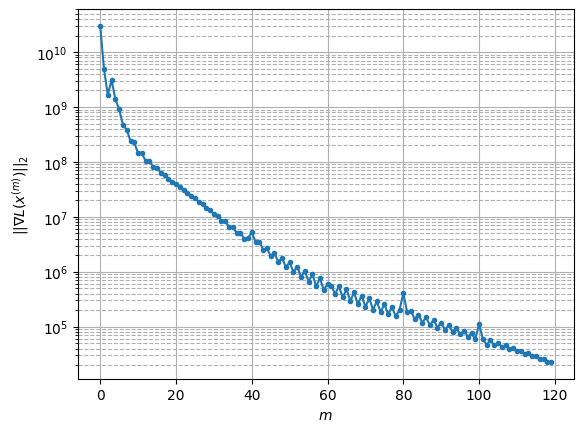

Windows:   2%|▏         | 6/296 [04:16<3:28:02, 43.04s/it]

Before applying the algorithm
Cost function: 424.17891867552487
Gradient norm: 160280.15381863114
Global relative error: 2.5719874620459473
Position relative errors: 0.018373758919751106 m, 1.0666948549495465 m, 1.5870822612870932 m, 1.7199159757878557 m

Iteration 1
Cost function: 423.26931153064277 (-0.21%)
Gradient norm: 31911.75861108525 (-80.09%)
Global relative error: 2.3140276096597394 (-10.03%)
Position relative errors: 0.01993531036598598 m, 0.9781190067389347 m, 1.3864935979061204 m, 1.5732903433187946 m

Iteration 2
Cost function: 422.6181814380014 (-0.15%)
Gradient norm: 25501.39364007944 (-20.09%)
Global relative error: 2.176744009917031 (-5.93%)
Position relative errors: 0.019960088996791546 m, 0.9174135559299531 m, 1.2940087353668381 m, 1.49053921216253 m

Iteration 3
Cost function: 422.0737323565646 (-0.13%)
Gradient norm: 23879.890307706046 (-6.36%)
Global relative error: 1.999336190840742 (-8.15%)
Position relative errors: 0.019984823360033887 m, 0.8311629384805282 m,

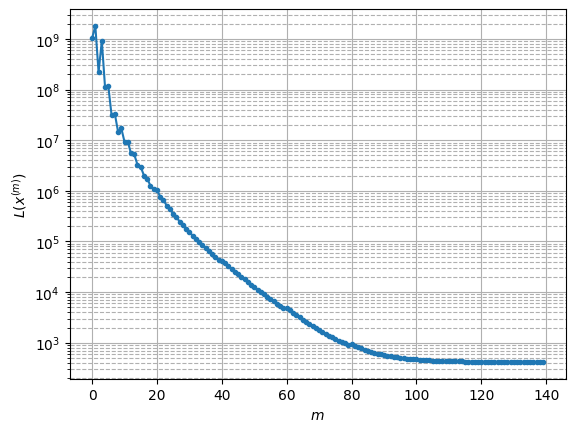

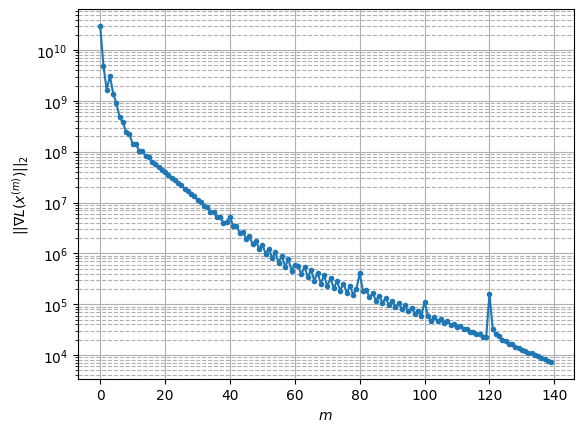

Windows:   2%|▏         | 7/296 [04:55<3:21:01, 41.73s/it]

Before applying the algorithm
Cost function: 423.3719026315417
Gradient norm: 167542.7479048622
Global relative error: 0.7777444611288947
Position relative errors: 0.020537238787895547 m, 0.08342196059914118 m, 0.5213149561769426 m, 0.5707297224163891 m

Iteration 1
Cost function: 422.8897936512636 (-0.11%)
Gradient norm: 24914.132432341656 (-85.13%)
Global relative error: 0.7280937939587641 (-6.38%)
Position relative errors: 0.021601150301157283 m, 0.2880472839862208 m, 0.33560862698643495 m, 0.5779674124969955 m

Iteration 2
Cost function: 422.7676039605123 (-0.03%)
Gradient norm: 11019.692819506554 (-55.77%)
Global relative error: 0.7700531414042753 (5.76%)
Position relative errors: 0.0216139902860449 m, 0.3270147558848103 m, 0.37308154243932234 m, 0.5885430564121014 m

Iteration 3
Cost function: 422.67927325733456 (-0.02%)
Gradient norm: 4928.535483656024 (-55.28%)
Global relative error: 0.7669940090481793 (-0.40%)
Position relative errors: 0.021657746214005458 m, 0.363538394290665

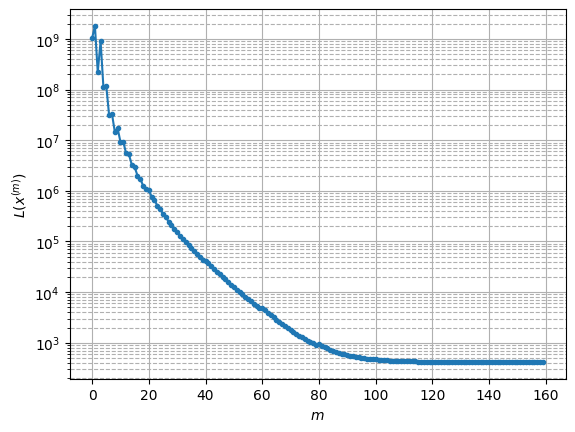

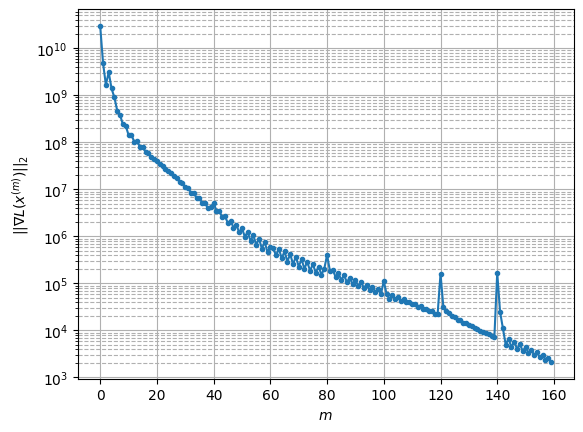

Windows:   3%|▎         | 8/296 [05:41<3:26:47, 43.08s/it]

Before applying the algorithm
Cost function: 421.5897655855168
Gradient norm: 242593.21055356786
Global relative error: 1.1859757289218613
Position relative errors: 0.02190282548026653 m, 0.7370915275216362 m, 0.6239771510132678 m, 0.6880436400564831 m

Iteration 1
Cost function: 421.2353318009857 (-0.08%)
Gradient norm: 11177.82301579313 (-95.39%)
Global relative error: 1.13712902027573 (-4.12%)
Position relative errors: 0.01933367586347615 m, 0.5063042611283352 m, 0.5760521175467085 m, 0.8393480118616602 m

Iteration 2
Cost function: 421.19219379043454 (-0.01%)
Gradient norm: 6478.759744315059 (-42.04%)
Global relative error: 1.1881861394445086 (4.49%)
Position relative errors: 0.019291087476462125 m, 0.583615738636015 m, 0.629304923900562 m, 0.8214490555619327 m

Iteration 3
Cost function: 421.17707559304125 (-0.00%)
Gradient norm: 2642.405998757908 (-59.21%)
Global relative error: 1.219762728285568 (2.66%)
Position relative errors: 0.019317224927289583 m, 0.5740376532599367 m, 0.63

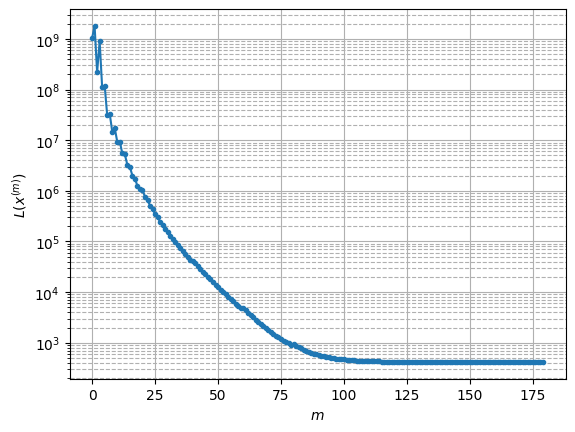

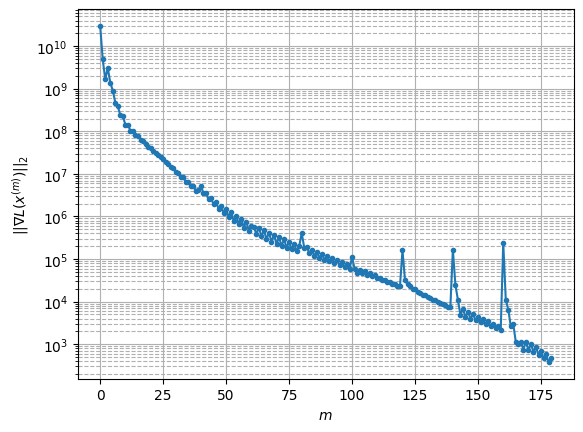

Windows:   3%|▎         | 9/296 [06:25<3:27:25, 43.36s/it]

Before applying the algorithm
Cost function: 421.5707077341077
Gradient norm: 246209.68691853635
Global relative error: 1.4219070030505472
Position relative errors: 0.019268891333842183 m, 0.729864393046251 m, 0.7608687229752343 m, 0.9538458555098351 m

Iteration 1
Cost function: 421.2941565960443 (-0.07%)
Gradient norm: 19257.86167496787 (-92.18%)
Global relative error: 1.3946352559863193 (-1.92%)
Position relative errors: 0.021058445814143352 m, 0.7331932977414872 m, 0.6651546586695397 m, 0.9821190797086313 m

Iteration 2
Cost function: 421.26655786488146 (-0.01%)
Gradient norm: 10769.356913488193 (-44.08%)
Global relative error: 1.4386796054838684 (3.16%)
Position relative errors: 0.02107279972843034 m, 0.7614443151939287 m, 0.7193341856349954 m, 0.985957798347097 m

Iteration 3
Cost function: 421.2562308577221 (-0.00%)
Gradient norm: 6646.90733430312 (-38.28%)
Global relative error: 1.43268731675379 (-0.42%)
Position relative errors: 0.02107269488212109 m, 0.7559121464803091 m, 0.6

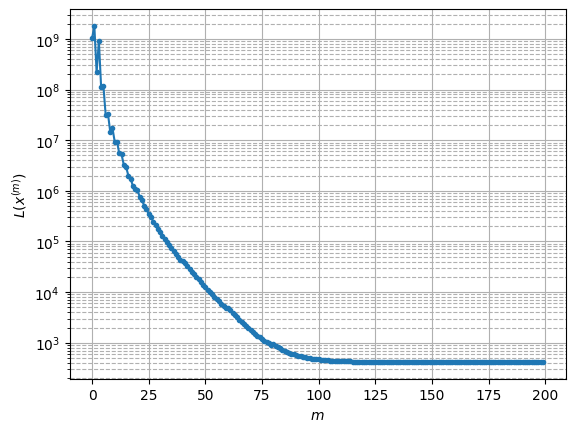

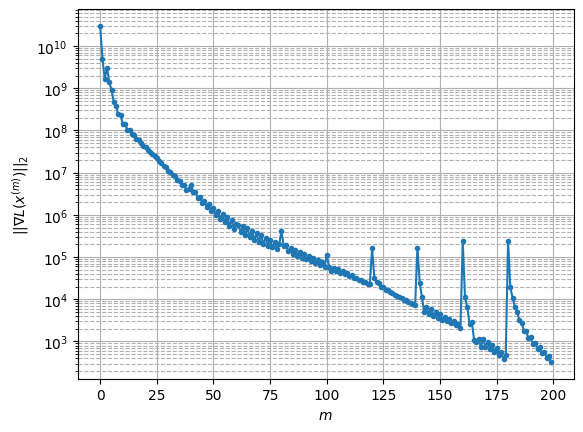

Windows:   3%|▎         | 10/296 [07:07<3:23:52, 42.77s/it]

Before applying the algorithm
Cost function: 421.1921682539746
Gradient norm: 33778.531447589754
Global relative error: 1.5578587202085197
Position relative errors: 0.02073458776096628 m, 0.8557864543927809 m, 0.7781167648279104 m, 1.0433863421636334 m

Iteration 1
Cost function: 420.9860616432339 (-0.05%)
Gradient norm: 10672.811672312793 (-68.40%)
Global relative error: 1.5710567543850606 (0.85%)
Position relative errors: 0.022501643197261292 m, 0.6886136108478697 m, 0.6737125811615955 m, 1.2408194051121515 m

Iteration 2
Cost function: 420.9092257378084 (-0.02%)
Gradient norm: 12347.147506267514 (15.69%)
Global relative error: 1.6608372354091068 (5.71%)
Position relative errors: 0.02246606770847828 m, 0.8387080995732019 m, 0.8307697153487935 m, 1.1680168253673515 m

Iteration 3
Cost function: 420.86222289408244 (-0.01%)
Gradient norm: 7988.4076590838495 (-35.30%)
Global relative error: 1.6859694201024678 (1.51%)
Position relative errors: 0.022541501227212653 m, 0.7935639922355491 m,

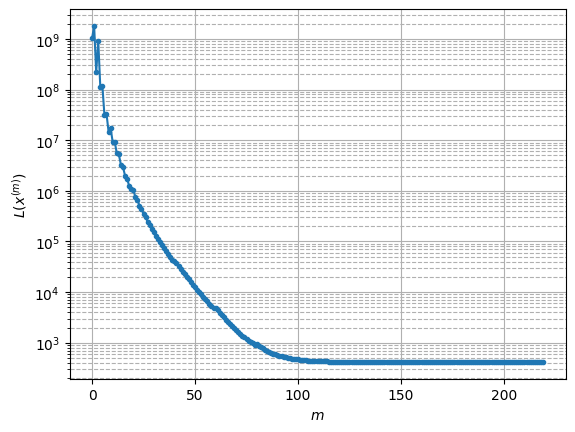

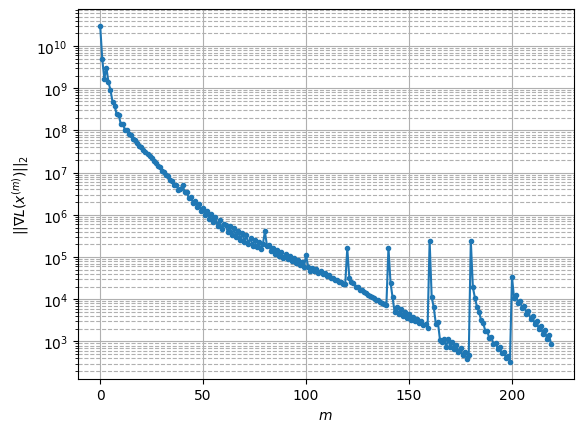

Windows:   4%|▎         | 11/296 [07:50<3:23:54, 42.93s/it]

Before applying the algorithm
Cost function: 418.2669065933822
Gradient norm: 89904.6312514143
Global relative error: 2.0508055952502082
Position relative errors: 0.021980491163254453 m, 1.067734687664847 m, 1.0330055798383164 m, 1.4135630684669962 m

Iteration 1
Cost function: 417.91633520617995 (-0.08%)
Gradient norm: 20315.746390984215 (-77.40%)
Global relative error: 2.170842396494938 (5.85%)
Position relative errors: 0.01602107526339488 m, 1.1957038196244103 m, 1.0647553349474124 m, 1.465908022669389 m

Iteration 2
Cost function: 417.85824656040324 (-0.01%)
Gradient norm: 8028.47353393041 (-60.48%)
Global relative error: 2.1923535420873335 (0.99%)
Position relative errors: 0.016028651471154995 m, 1.200409085362522 m, 1.0521794924764019 m, 1.502694663535615 m

Iteration 3
Cost function: 417.83745221917144 (-0.00%)
Gradient norm: 4454.289580157789 (-44.52%)
Global relative error: 2.242675760606556 (2.30%)
Position relative errors: 0.01603511423440047 m, 1.2421261616273418 m, 1.09187

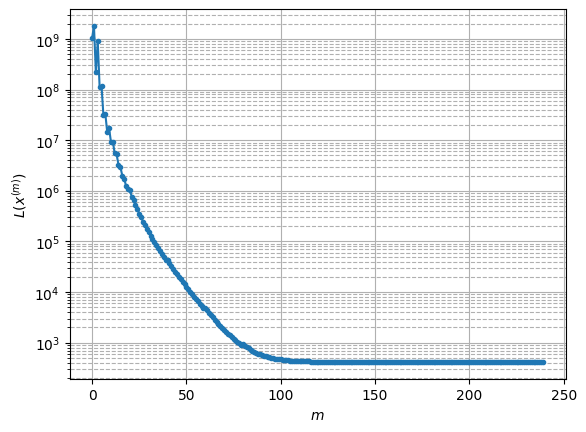

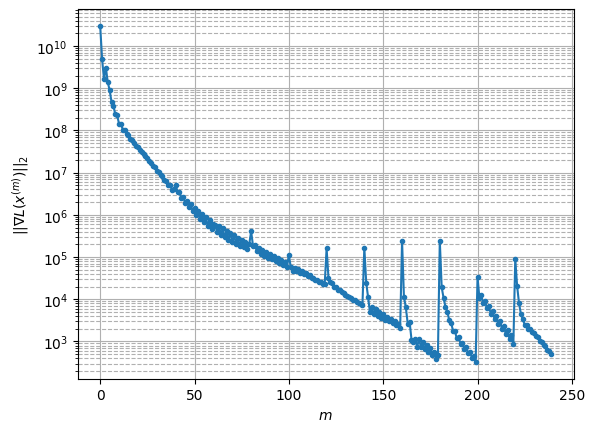

Windows:   4%|▍         | 12/296 [08:34<3:24:34, 43.22s/it]

Before applying the algorithm
Cost function: 416.2772705342583
Gradient norm: 104517.9150621129
Global relative error: 2.384536609780676
Position relative errors: 0.015691881859846206 m, 1.3696408594202993 m, 1.1524038796179854 m, 1.5753780254715848 m

Iteration 1
Cost function: 415.9081691760063 (-0.09%)
Gradient norm: 20416.69641177056 (-80.47%)
Global relative error: 2.337524116917279 (-1.97%)
Position relative errors: 0.014995063007712221 m, 1.2978888126966872 m, 1.2144280417741313 m, 1.5180387023439015 m

Iteration 2
Cost function: 415.85195239516844 (-0.01%)
Gradient norm: 4969.176244913693 (-75.66%)
Global relative error: 2.3690240800656435 (1.35%)
Position relative errors: 0.015179886450052239 m, 1.3012498815240716 m, 1.1980179747455482 m, 1.5759265271325915 m

Iteration 3
Cost function: 415.8354650706415 (-0.00%)
Gradient norm: 3141.977055405581 (-36.77%)
Global relative error: 2.3740872654606004 (0.21%)
Position relative errors: 0.01519094437291063 m, 1.3123374210123124 m, 1.

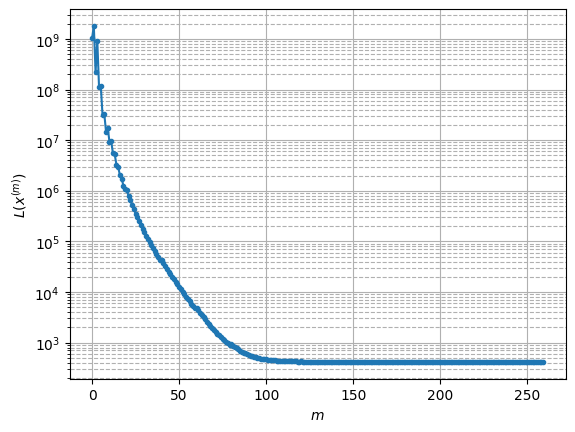

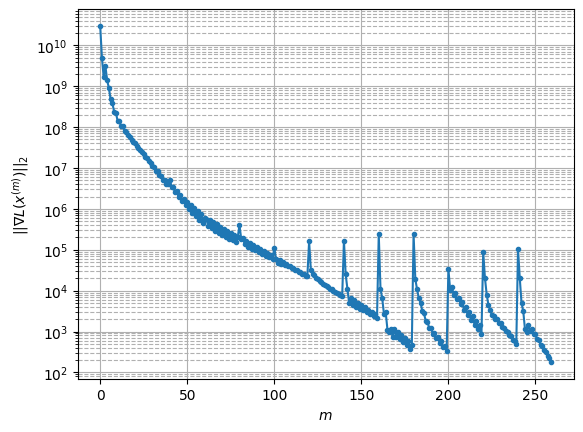

Windows:   4%|▍         | 13/296 [09:17<3:23:27, 43.14s/it]

Before applying the algorithm
Cost function: 418.62843584411337
Gradient norm: 314812.4554261333
Global relative error: 2.3869335343406686
Position relative errors: 0.01471124284142629 m, 1.344174765665611 m, 1.224601153371472 m, 1.5462146193668853 m

Iteration 1
Cost function: 418.4291596511221 (-0.05%)
Gradient norm: 13513.81376327264 (-95.71%)
Global relative error: 2.328182466760521 (-2.46%)
Position relative errors: 0.011968431546505185 m, 1.3158947724323178 m, 1.2423565489082604 m, 1.4646705304257344 m

Iteration 2
Cost function: 418.40365222875465 (-0.01%)
Gradient norm: 6314.734606842014 (-53.27%)
Global relative error: 2.2743675311752005 (-2.31%)
Position relative errors: 0.011938062737747477 m, 1.2760182201206358 m, 1.1816933832216467 m, 1.4655994302022617 m

Iteration 3
Cost function: 418.38781226998424 (-0.00%)
Gradient norm: 4542.21374945296 (-28.07%)
Global relative error: 2.240238910034124 (-1.50%)
Position relative errors: 0.011907446352844096 m, 1.2606523683439332 m, 1

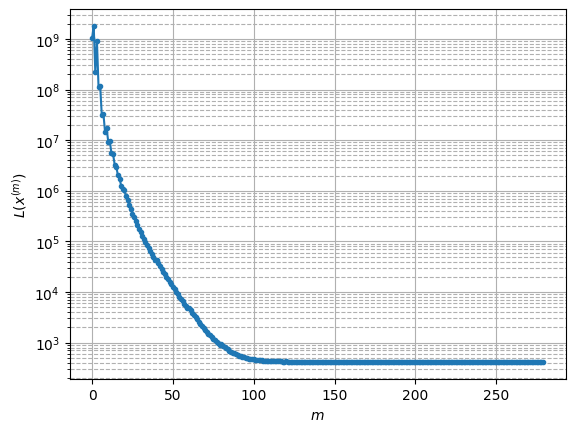

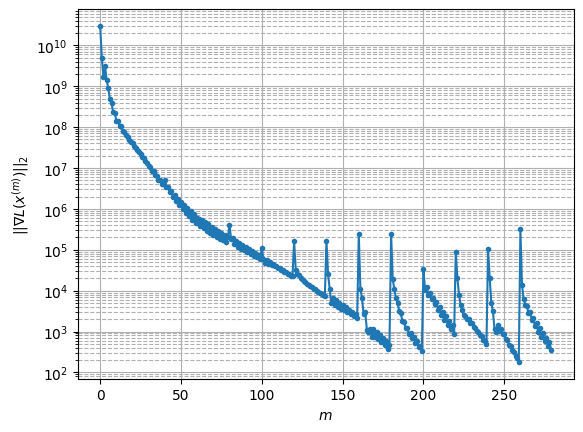

Windows:   5%|▍         | 14/296 [09:57<3:18:55, 42.33s/it]

Before applying the algorithm
Cost function: 420.41221185415327
Gradient norm: 27437.979839952528
Global relative error: 2.0230701002335043
Position relative errors: 0.011088700652270711 m, 1.1637957174338556 m, 1.0324085228568807 m, 1.2932131530359867 m

Iteration 1
Cost function: 420.1133897983954 (-0.07%)
Gradient norm: 13286.855931033311 (-51.57%)
Global relative error: 1.911060774294859 (-5.54%)
Position relative errors: 0.01238127612734157 m, 1.1831708433861323 m, 0.9703169021451021 m, 1.1448102524940122 m

Iteration 2
Cost function: 419.9886468983438 (-0.03%)
Gradient norm: 6649.635707763671 (-49.95%)
Global relative error: 1.7822794578180472 (-6.74%)
Position relative errors: 0.01221697487529513 m, 1.0958103406309998 m, 0.8641041766308759 m, 1.1085545528982301 m

Iteration 3
Cost function: 419.9069859143524 (-0.02%)
Gradient norm: 5445.093739792252 (-18.11%)
Global relative error: 1.6946586373371388 (-4.92%)
Position relative errors: 0.012086535885536733 m, 1.0593837486678013 m

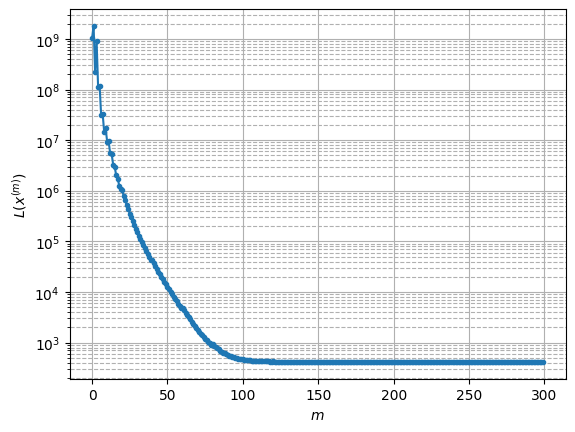

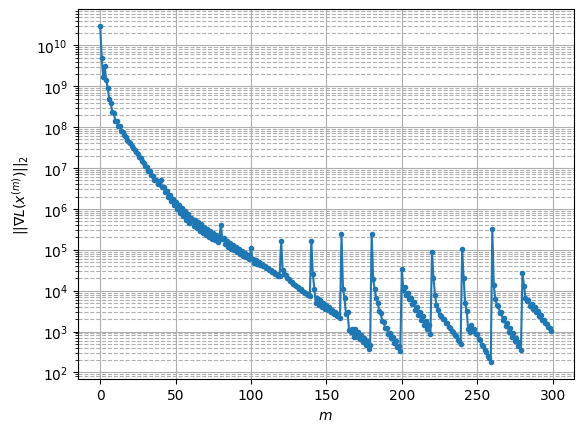

Windows:   5%|▌         | 15/296 [10:39<3:17:50, 42.24s/it]

Before applying the algorithm
Cost function: 421.48991296492636
Gradient norm: 102299.83441559192
Global relative error: 1.2575605041219933
Position relative errors: 0.010966978015653571 m, 0.8277527862952059 m, 0.5201487508686516 m, 0.7909534463996601 m

Iteration 1
Cost function: 421.21340658614605 (-0.07%)
Gradient norm: 16477.698447970677 (-83.89%)
Global relative error: 1.2653993522757097 (0.62%)
Position relative errors: 0.007341310652551178 m, 0.9799123603133675 m, 0.44389533307330786 m, 0.6662650651616495 m

Iteration 2
Cost function: 421.1509653396464 (-0.01%)
Gradient norm: 8367.314673445573 (-49.22%)
Global relative error: 1.2023562885589356 (-4.98%)
Position relative errors: 0.007336450375786378 m, 0.90383109814789 m, 0.42304380000934055 m, 0.6706183067012796 m

Iteration 3
Cost function: 421.1211558283166 (-0.01%)
Gradient norm: 4078.6871166374367 (-51.25%)
Global relative error: 1.1738315093916647 (-2.37%)
Position relative errors: 0.007366785474111795 m, 0.91551554665576

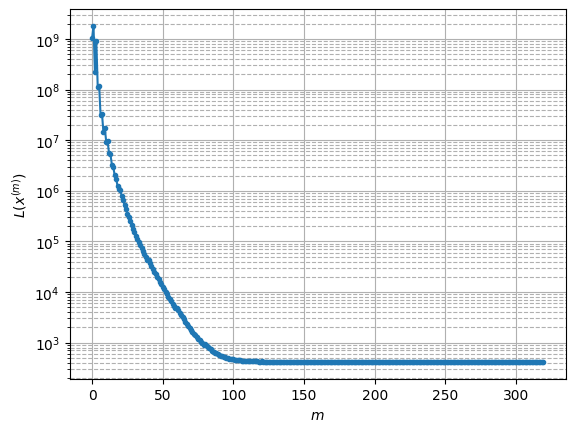

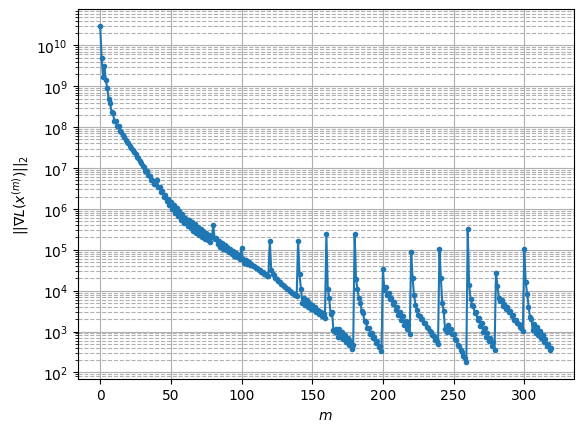

Windows:   5%|▌         | 16/296 [11:20<3:15:39, 41.93s/it]

Before applying the algorithm
Cost function: 421.27821616219734
Gradient norm: 57650.54658707801
Global relative error: 1.064640237019695
Position relative errors: 0.007024571105049436 m, 0.8544886542628296 m, 0.328520075466055 m, 0.5434446126183051 m

Iteration 1
Cost function: 421.02339575310555 (-0.06%)
Gradient norm: 28247.14542347103 (-51.00%)
Global relative error: 1.0806281119091672 (1.50%)
Position relative errors: 0.006122381719799449 m, 0.8147897237866417 m, 0.43502473739402797 m, 0.5608828976496745 m

Iteration 2
Cost function: 420.9167565288344 (-0.03%)
Gradient norm: 21100.451451710323 (-25.30%)
Global relative error: 1.0331861036348462 (-4.39%)
Position relative errors: 0.006101879359505887 m, 0.7987923586578581 m, 0.3352931899788601 m, 0.5629780151174965 m

Iteration 3
Cost function: 420.8587651852499 (-0.01%)
Gradient norm: 14212.044884974519 (-32.65%)
Global relative error: 1.0424340551389977 (0.90%)
Position relative errors: 0.006178793670925455 m, 0.7834971577405133 

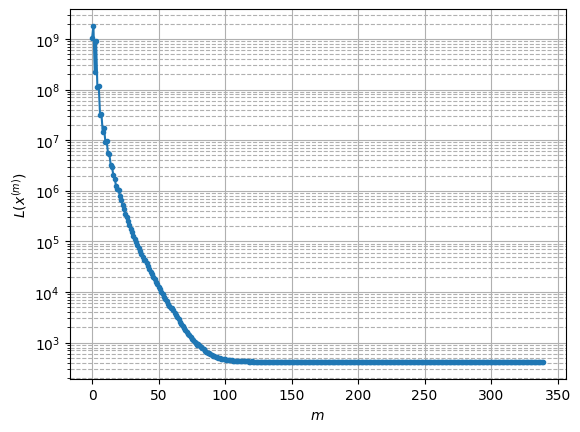

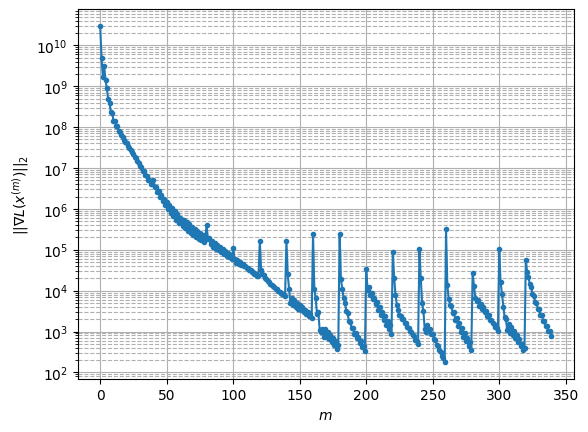

Windows:   6%|▌         | 17/296 [12:05<3:18:41, 42.73s/it]

Before applying the algorithm
Cost function: 421.76479744289855
Gradient norm: 233673.9193270042
Global relative error: 0.9574540531212911
Position relative errors: 0.005599700464039456 m, 0.7171107206325223 m, 0.2865162828927255 m, 0.5659914505237261 m

Iteration 1
Cost function: 421.47460192434045 (-0.07%)
Gradient norm: 13025.01875042554 (-94.43%)
Global relative error: 0.8478534809959416 (-11.45%)
Position relative errors: 0.00515467415758464 m, 0.6040527272128323 m, 0.18730890808434067 m, 0.5646797598182717 m

Iteration 2
Cost function: 421.4135126441481 (-0.01%)
Gradient norm: 8874.472187227513 (-31.87%)
Global relative error: 0.8109102514452814 (-4.36%)
Position relative errors: 0.0053078038336153875 m, 0.5935363916615091 m, 0.21884142650086635 m, 0.5073154277070236 m

Iteration 3
Cost function: 421.3830704634591 (-0.01%)
Gradient norm: 6398.405318651563 (-27.90%)
Global relative error: 0.7701575407054378 (-5.03%)
Position relative errors: 0.005319786981882081 m, 0.5620441143016

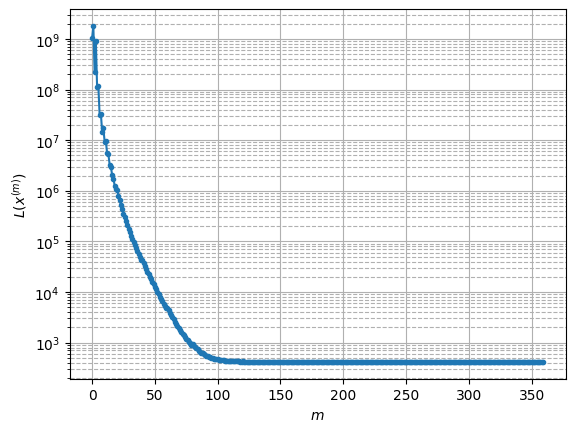

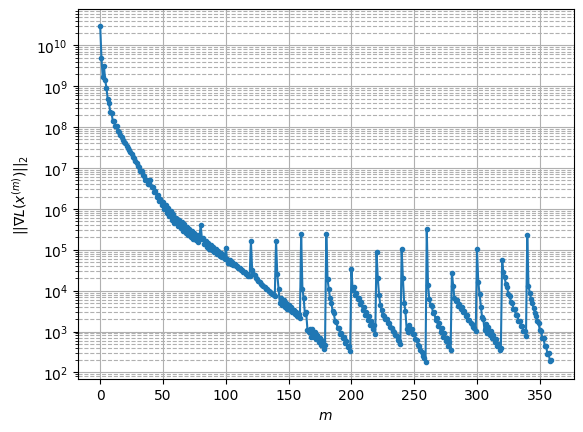

Windows:   6%|▌         | 18/296 [12:46<3:15:48, 42.26s/it]

Before applying the algorithm
Cost function: 421.3789002495659
Gradient norm: 43232.3980336532
Global relative error: 0.7299539638717828
Position relative errors: 0.005387027521181662 m, 0.5611441527765553 m, 0.1399152363049856 m, 0.44535750317791034 m

Iteration 1
Cost function: 421.08308983141853 (-0.07%)
Gradient norm: 13471.327030398166 (-68.84%)
Global relative error: 0.8267811785721771 (13.26%)
Position relative errors: 0.017245227144333564 m, 0.6507488381795401 m, 0.13030057128701 m, 0.49276375080004503 m

Iteration 2
Cost function: 421.05697505527473 (-0.01%)
Gradient norm: 10021.990563537407 (-25.61%)
Global relative error: 0.8491261440688691 (2.70%)
Position relative errors: 0.017044761005915395 m, 0.6671100295385584 m, 0.12426954418817159 m, 0.5101418398750104 m

Iteration 3
Cost function: 421.0446900221988 (-0.00%)
Gradient norm: 6588.507220682372 (-34.26%)
Global relative error: 0.8570225742276544 (0.93%)
Position relative errors: 0.01694961259845967 m, 0.6654881161911016 

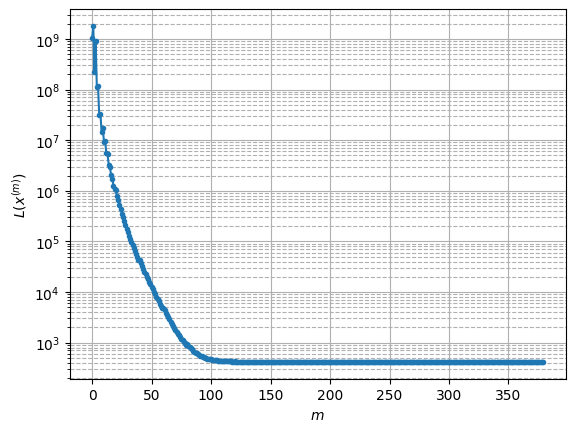

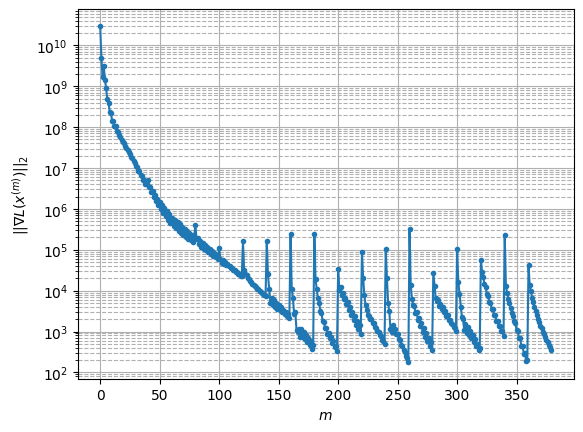

Windows:   6%|▋         | 19/296 [13:27<3:13:33, 41.92s/it]

Before applying the algorithm
Cost function: 421.8856469283911
Gradient norm: 199980.34473578786
Global relative error: 0.8699358980676893
Position relative errors: 0.016479835879971608 m, 0.674070276315215 m, 0.11608375403223496 m, 0.5372796953280391 m

Iteration 1
Cost function: 421.75911190026517 (-0.03%)
Gradient norm: 6283.310175414819 (-96.86%)
Global relative error: 0.8757983196651142 (0.67%)
Position relative errors: 0.021944028304957678 m, 0.6528229646452336 m, 0.08325168473863286 m, 0.5774349856492524 m

Iteration 2
Cost function: 421.7439398076044 (-0.00%)
Gradient norm: 4989.263245171088 (-20.59%)
Global relative error: 0.8811895943677186 (0.62%)
Position relative errors: 0.021805794206502967 m, 0.6569492434271262 m, 0.1163771731724354 m, 0.5752324582630414 m

Iteration 3
Cost function: 421.73726780586907 (-0.00%)
Gradient norm: 2595.2625281171136 (-47.98%)
Global relative error: 0.8872923767347455 (0.69%)
Position relative errors: 0.02173581825409641 m, 0.6552789140530013 

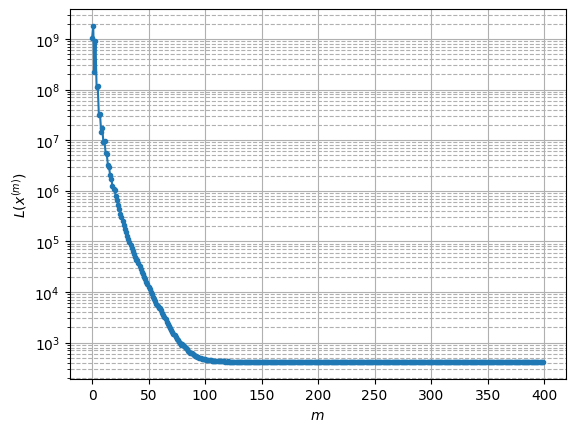

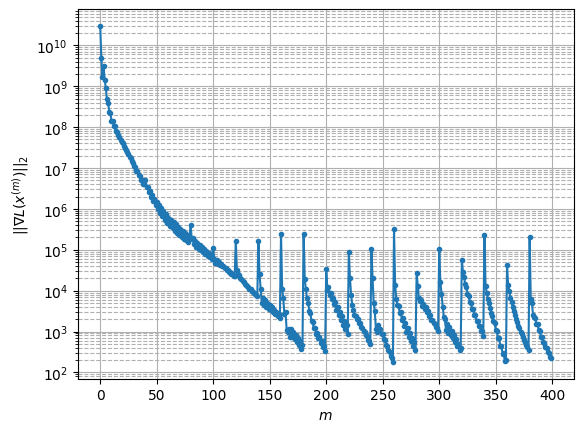

Windows:   7%|▋         | 20/296 [14:09<3:13:17, 42.02s/it]

Before applying the algorithm
Cost function: 425.506320531938
Gradient norm: 71436.11446316827
Global relative error: 0.8959460015672485
Position relative errors: 0.021395293497301727 m, 0.6718676589745776 m, 0.1226851237240532 m, 0.579484709889265 m

Iteration 1
Cost function: 424.9899527187383 (-0.12%)
Gradient norm: 29816.842409936802 (-58.26%)
Global relative error: 0.8263042209747001 (-7.77%)
Position relative errors: 0.017771881705602323 m, 0.7017381488051578 m, 0.11579011552663282 m, 0.4202591573201045 m

Iteration 2
Cost function: 424.81452816620083 (-0.04%)
Gradient norm: 21055.3438253629 (-29.38%)
Global relative error: 0.7646268669390736 (-7.46%)
Position relative errors: 0.017849480521247366 m, 0.6174543216324234 m, 0.09796415389712909 m, 0.43987201398379966 m

Iteration 3
Cost function: 424.7368678271194 (-0.02%)
Gradient norm: 10741.699564620418 (-48.98%)
Global relative error: 0.7444047380206938 (-2.64%)
Position relative errors: 0.017941338876533666 m, 0.613296530277219

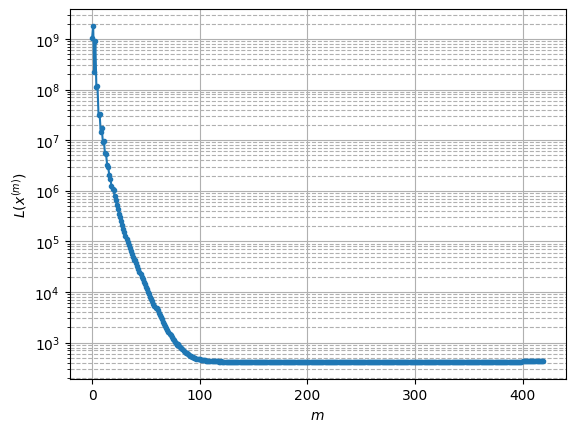

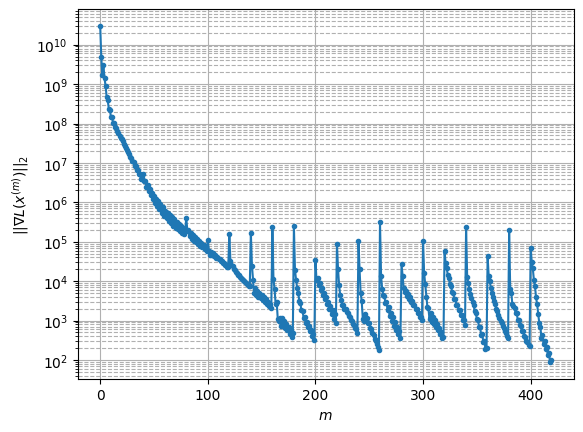

Windows:   7%|▋         | 21/296 [14:49<3:08:57, 41.23s/it]

Before applying the algorithm
Cost function: 431.49032489288055
Gradient norm: 136150.792778698
Global relative error: 0.7179954760497176
Position relative errors: 0.017824488972727145 m, 0.589801255812837 m, 0.13446487254739983 m, 0.38633080942083897 m

Iteration 1
Cost function: 431.1368000403772 (-0.08%)
Gradient norm: 54659.47236915018 (-59.85%)
Global relative error: 0.6541224704011728 (-8.90%)
Position relative errors: 0.017495634269194302 m, 0.5380279465875127 m, 0.17727881084199604 m, 0.32659794503975914 m

Iteration 2
Cost function: 431.04191366630596 (-0.02%)
Gradient norm: 32294.318691562534 (-40.92%)
Global relative error: 0.6702696068317742 (2.47%)
Position relative errors: 0.017401189280896005 m, 0.527288526703498 m, 0.1586598360833182 m, 0.38177246033889367 m

Iteration 3
Cost function: 431.0022297914034 (-0.01%)
Gradient norm: 19323.377374492167 (-40.16%)
Global relative error: 0.6657169078700118 (-0.68%)
Position relative errors: 0.017349055587863826 m, 0.5386987510744

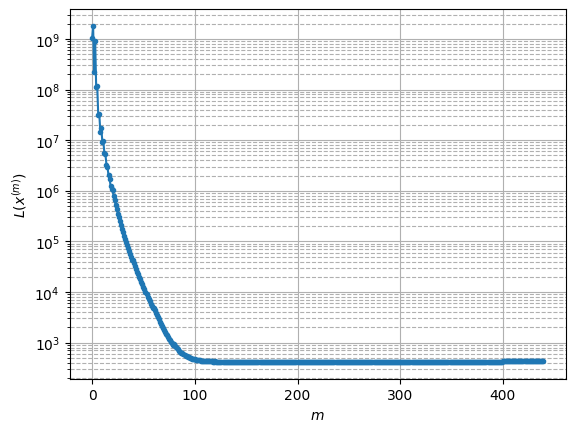

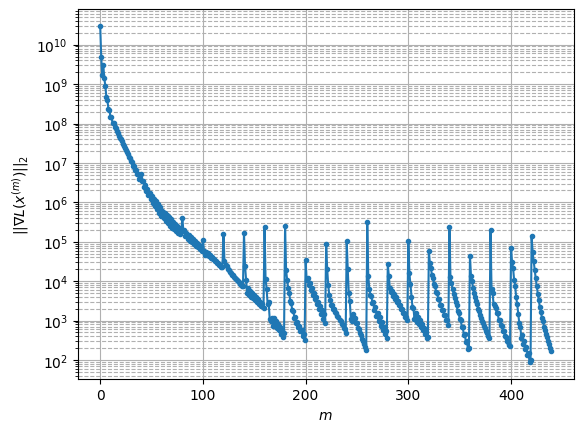

Windows:   7%|▋         | 22/296 [15:32<3:10:53, 41.80s/it]

Before applying the algorithm
Cost function: 432.7699389751646
Gradient norm: 177721.7611871028
Global relative error: 0.6906681923384634
Position relative errors: 0.016960410423451217 m, 0.5730011673703026 m, 0.16676566316535618 m, 0.34726288186668264 m

Iteration 1
Cost function: 432.4816756248142 (-0.07%)
Gradient norm: 29581.449471982687 (-83.36%)
Global relative error: 0.629822453247267 (-8.81%)
Position relative errors: 0.022498791079562815 m, 0.5095216839243428 m, 0.14046335918543168 m, 0.3417975103970737 m

Iteration 2
Cost function: 432.4198358012548 (-0.01%)
Gradient norm: 26635.08647191935 (-9.96%)
Global relative error: 0.6303040711750449 (0.08%)
Position relative errors: 0.022564836143283893 m, 0.5109154095619439 m, 0.11370362313221426 m, 0.3504406393882751 m

Iteration 3
Cost function: 432.38805993855044 (-0.01%)
Gradient norm: 13341.642602477772 (-49.91%)
Global relative error: 0.6258319050787866 (-0.71%)
Position relative errors: 0.022644136636605996 m, 0.52135904772071

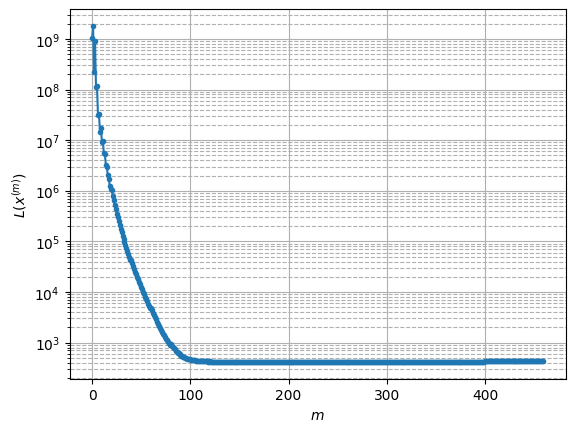

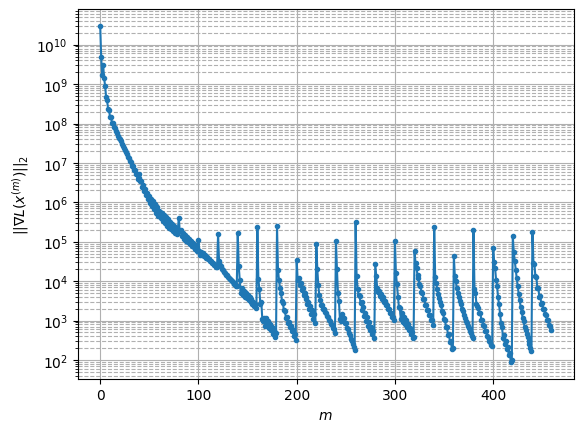

Windows:   8%|▊         | 23/296 [16:15<3:12:27, 42.30s/it]

Before applying the algorithm
Cost function: 429.32196192472
Gradient norm: 90987.53317932184
Global relative error: 0.7171045215876979
Position relative errors: 0.022434111073855234 m, 0.6221536174026868 m, 0.11481179557460695 m, 0.33686273432007785 m

Iteration 1
Cost function: 428.9411753903351 (-0.09%)
Gradient norm: 30495.748087333486 (-66.48%)
Global relative error: 0.831040839214324 (15.89%)
Position relative errors: 0.030305750336096143 m, 0.7858009987237925 m, 0.15160309444324355 m, 0.22190377649785895 m

Iteration 2
Cost function: 428.885123229263 (-0.01%)
Gradient norm: 12768.94463761684 (-58.13%)
Global relative error: 0.7617871074868535 (-8.33%)
Position relative errors: 0.030387405963733946 m, 0.7121433776634941 m, 0.14053860455745976 m, 0.22911677258295007 m

Iteration 3
Cost function: 428.86754539516346 (-0.00%)
Gradient norm: 10172.867612181273 (-20.33%)
Global relative error: 0.776216390908838 (1.89%)
Position relative errors: 0.030547056447976957 m, 0.730165900688488

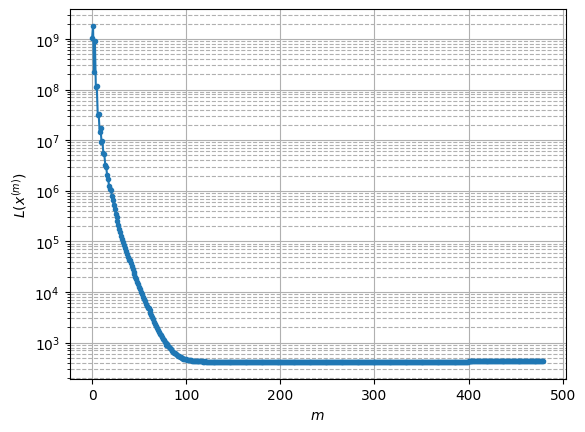

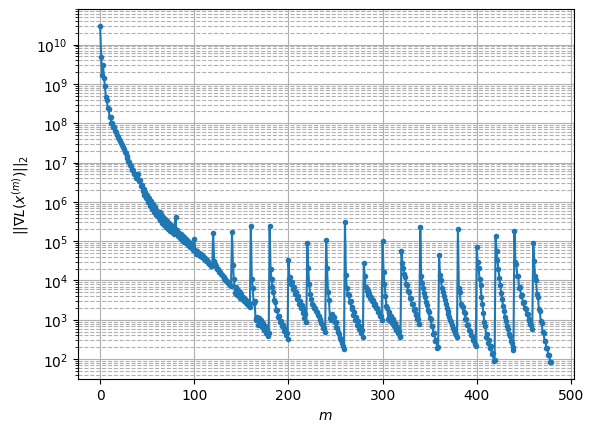

Windows:   8%|▊         | 24/296 [16:59<3:13:45, 42.74s/it]

Before applying the algorithm
Cost function: 432.97775409702285
Gradient norm: 132688.245604839
Global relative error: 0.8147151229205775
Position relative errors: 0.029993998225593822 m, 0.7661160881175572 m, 0.16244417190881705 m, 0.222568595276575 m

Iteration 1
Cost function: 432.2469052693076 (-0.17%)
Gradient norm: 25021.776162809743 (-81.14%)
Global relative error: 0.7202684774327556 (-11.59%)
Position relative errors: 0.04923685529013698 m, 0.6315276882233221 m, 0.18877916174769466 m, 0.28617300580153054 m

Iteration 2
Cost function: 432.2098149655046 (-0.01%)
Gradient norm: 10261.588580413238 (-58.99%)
Global relative error: 0.7334103586851627 (1.82%)
Position relative errors: 0.04945608417221308 m, 0.6597812645868616 m, 0.18524658182588 m, 0.25654357329769784 m

Iteration 3
Cost function: 432.19710176867864 (-0.00%)
Gradient norm: 10044.05445411884 (-2.12%)
Global relative error: 0.7183778207274897 (-2.05%)
Position relative errors: 0.04955282469605167 m, 0.641211105330108 m,

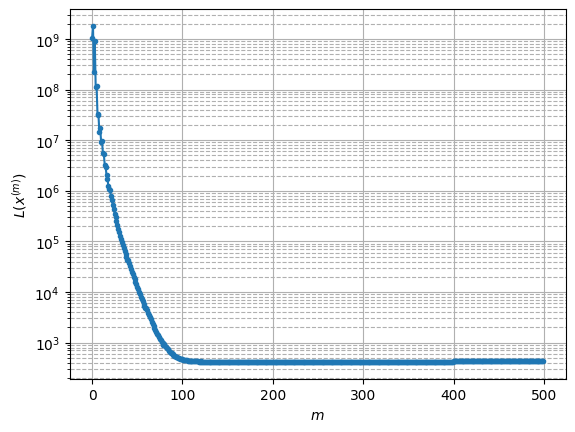

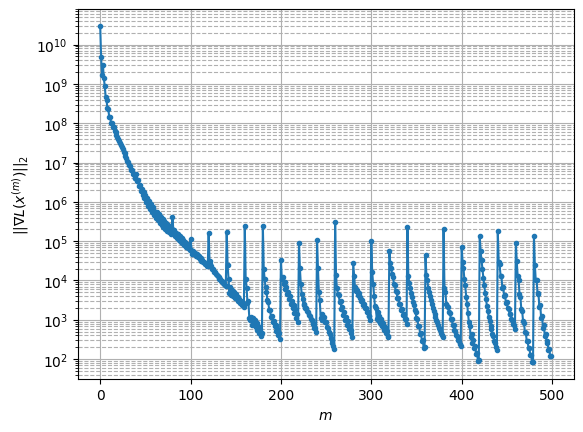

Windows:   8%|▊         | 25/296 [17:40<3:09:54, 42.05s/it]

Before applying the algorithm
Cost function: 428.7865272245624
Gradient norm: 61583.85188513795
Global relative error: 0.7859216964150425
Position relative errors: 0.04810777911034008 m, 0.7039847562491324 m, 0.22021118836938294 m, 0.26696238140623507 m

Iteration 1
Cost function: 428.4964697774146 (-0.07%)
Gradient norm: 8387.340277487034 (-86.38%)
Global relative error: 0.7817918269185408 (-0.53%)
Position relative errors: 0.045292646924482836 m, 0.7261407743096726 m, 0.2644128632584415 m, 0.10931645289397798 m

Iteration 2
Cost function: 428.4395263188896 (-0.01%)
Gradient norm: 3709.6094710037983 (-55.77%)
Global relative error: 0.7795772711766421 (-0.28%)
Position relative errors: 0.045627133317175536 m, 0.7368899082795227 m, 0.22927446287198594 m, 0.10041357247224458 m

Iteration 3
Cost function: 428.41743577315515 (-0.01%)
Gradient norm: 4573.061222264999 (23.28%)
Global relative error: 0.7594276388806014 (-2.58%)
Position relative errors: 0.04583037939656626 m, 0.70738262228106

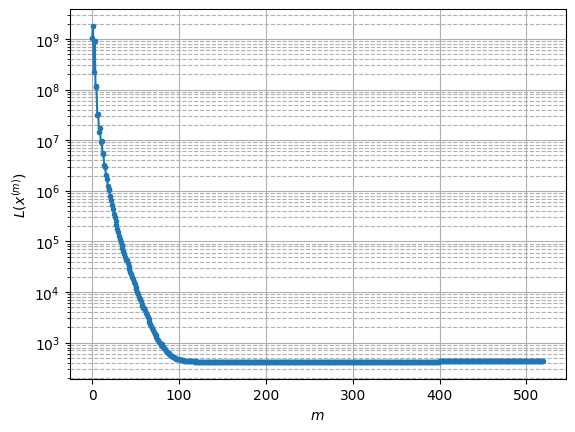

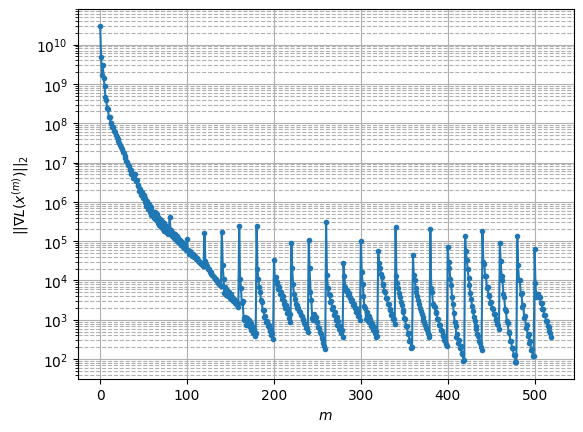

Windows:   9%|▉         | 26/296 [18:15<3:00:23, 40.09s/it]

Before applying the algorithm
Cost function: 424.5109896176561
Gradient norm: 100197.88494260969
Global relative error: 0.7622538230653952
Position relative errors: 0.04443068254589884 m, 0.7193642557189158 m, 0.23007255535631344 m, 0.09292972434583485 m

Iteration 1
Cost function: 424.1953193708791 (-0.07%)
Gradient norm: 25553.24962318806 (-74.50%)
Global relative error: 0.7405684307464976 (-2.84%)
Position relative errors: 0.05600514618594267 m, 0.6650548124459522 m, 0.2790053738063083 m, 0.15862100348921868 m

Iteration 2
Cost function: 424.14838963774054 (-0.01%)
Gradient norm: 14776.587411511417 (-42.17%)
Global relative error: 0.7519978739422584 (1.54%)
Position relative errors: 0.0564081725595377 m, 0.6886872505388512 m, 0.28125186813995606 m, 0.09446546086284448 m

Iteration 3
Cost function: 424.1299992132112 (-0.00%)
Gradient norm: 13387.684690404658 (-9.40%)
Global relative error: 0.7647703105329573 (1.70%)
Position relative errors: 0.05656444221143177 m, 0.689915306716934 m

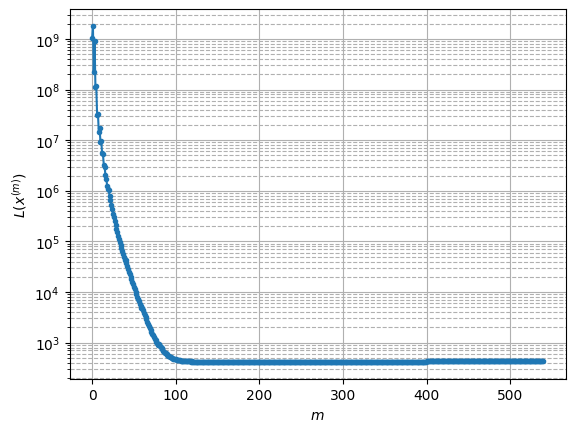

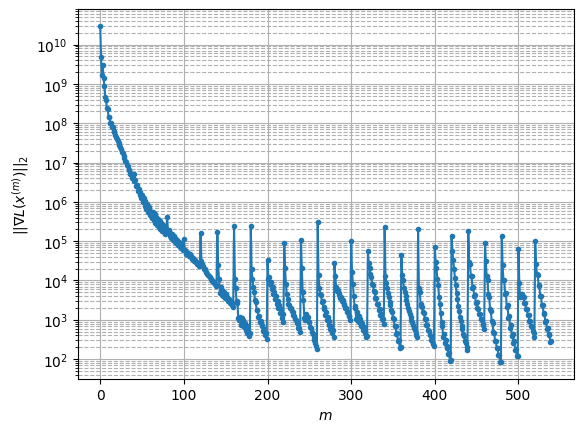

Windows:   9%|▉         | 27/296 [18:51<2:53:34, 38.72s/it]

Before applying the algorithm
Cost function: 421.7508015198578
Gradient norm: 28451.729263061443
Global relative error: 0.8626946153812493
Position relative errors: 0.05458282007055068 m, 0.7816349241395998 m, 0.3446081036539737 m, 0.10748276762518429 m

Iteration 1
Cost function: 421.4941505831454 (-0.06%)
Gradient norm: 18627.273573796076 (-34.53%)
Global relative error: 0.8405273231028852 (-2.57%)
Position relative errors: 0.043702391687363173 m, 0.7558031937357002 m, 0.35666803661201585 m, 0.07825379428861297 m

Iteration 2
Cost function: 421.4468779217472 (-0.01%)
Gradient norm: 15172.546500294031 (-18.55%)
Global relative error: 0.8294094391395106 (-1.32%)
Position relative errors: 0.04410367020888241 m, 0.7486912623082187 m, 0.3467213019047619 m, 0.07224007820588317 m

Iteration 3
Cost function: 421.4254810750693 (-0.01%)
Gradient norm: 10224.839740349706 (-32.61%)
Global relative error: 0.8313813312717466 (0.24%)
Position relative errors: 0.04428229232918652 m, 0.74509428159629

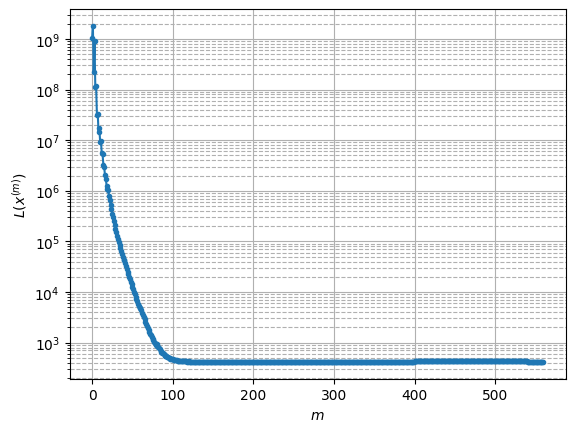

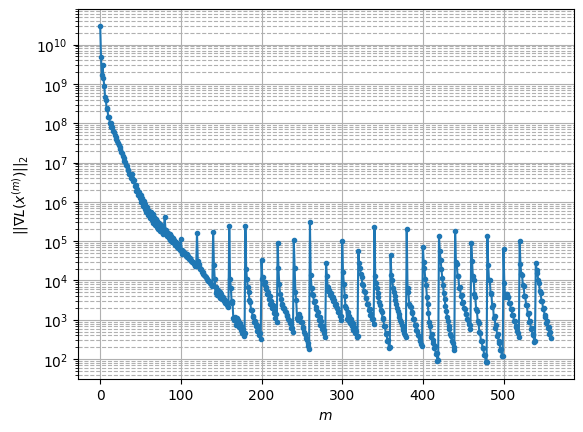

Windows:   9%|▉         | 28/296 [19:25<2:47:36, 37.52s/it]

Before applying the algorithm
Cost function: 422.5970997443739
Gradient norm: 212574.04250083843
Global relative error: 0.8053606656242479
Position relative errors: 0.04271666436377321 m, 0.7292268557592222 m, 0.3350685729861426 m, 0.05231470876213882 m

Iteration 1
Cost function: 422.116276920169 (-0.11%)
Gradient norm: 15634.411570252236 (-92.65%)
Global relative error: 0.8334918481289597 (3.49%)
Position relative errors: 0.02807189089077947 m, 0.7111497487348343 m, 0.3930852451158997 m, 0.18349204077095466 m

Iteration 2
Cost function: 422.0644573358783 (-0.01%)
Gradient norm: 8125.9264592890695 (-48.03%)
Global relative error: 0.8076650830692457 (-3.10%)
Position relative errors: 0.028050297368840658 m, 0.6873154083493765 m, 0.39935507608130716 m, 0.14017091463765208 m

Iteration 3
Cost function: 422.04503714035326 (-0.00%)
Gradient norm: 5055.748600376221 (-37.78%)
Global relative error: 0.8240287818838512 (2.03%)
Position relative errors: 0.0280959816063074 m, 0.7004294692835138 

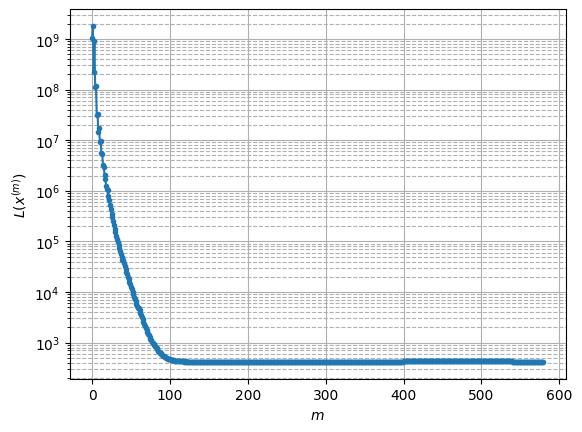

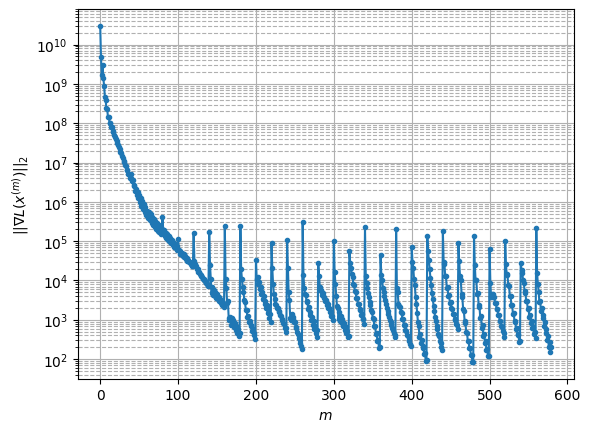

Windows:  10%|▉         | 29/296 [20:07<2:51:55, 38.63s/it]

Before applying the algorithm
Cost function: 430.3191439963538
Gradient norm: 157118.75874102215
Global relative error: 0.8234782397877055
Position relative errors: 0.026806862180313834 m, 0.7120026777917343 m, 0.38128947856292345 m, 0.1583273527244539 m

Iteration 1
Cost function: 429.2057355713218 (-0.26%)
Gradient norm: 38544.403870738824 (-75.47%)
Global relative error: 0.6752376239125667 (-18.00%)
Position relative errors: 0.02708179938378867 m, 0.6022712906898737 m, 0.24708937166800765 m, 0.17727855720884433 m

Iteration 2
Cost function: 429.08399799365736 (-0.03%)
Gradient norm: 28336.64140679483 (-26.48%)
Global relative error: 0.7838174534794455 (16.08%)
Position relative errors: 0.027393428193845718 m, 0.7236583200996167 m, 0.2563265331644409 m, 0.15567185851731905 m

Iteration 3
Cost function: 429.03991978143733 (-0.01%)
Gradient norm: 19616.656748508925 (-30.77%)
Global relative error: 0.7080202787530481 (-9.67%)
Position relative errors: 0.02751059857810441 m, 0.6382431479

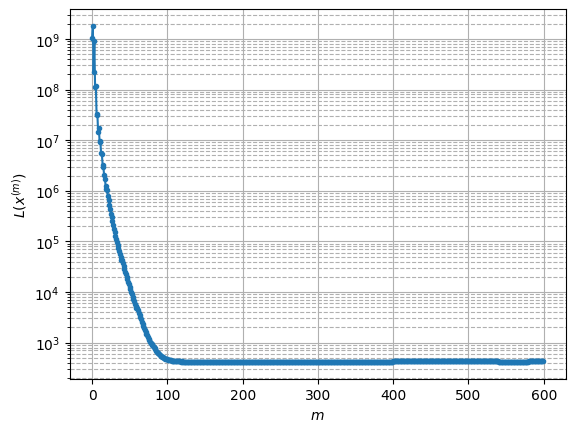

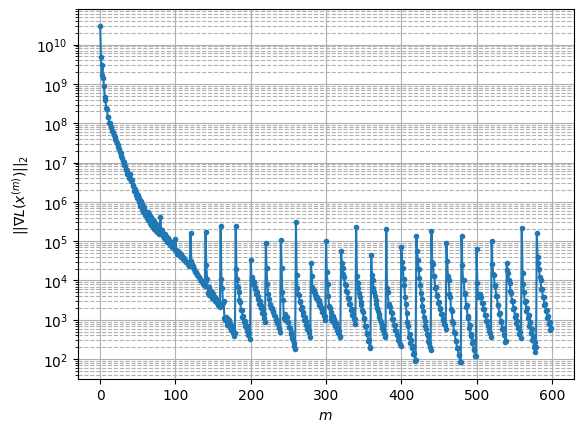

Windows:  10%|█         | 30/296 [20:50<2:57:16, 39.99s/it]

Before applying the algorithm
Cost function: 431.1760653132272
Gradient norm: 164240.43820513767
Global relative error: 0.6742919182902811
Position relative errors: 0.026374108690748244 m, 0.5904564307048789 m, 0.2336739343194122 m, 0.225234888441812 m

Iteration 1
Cost function: 430.55091479460174 (-0.14%)
Gradient norm: 66918.14847659327 (-59.26%)
Global relative error: 0.8756939156987615 (29.87%)
Position relative errors: 0.02964497155920939 m, 0.748437967241168 m, 0.33949823438353877 m, 0.30090116325529775 m

Iteration 2
Cost function: 430.42203663565243 (-0.03%)
Gradient norm: 46340.786714421774 (-30.75%)
Global relative error: 0.7610980633617482 (-13.09%)
Position relative errors: 0.030037212568187394 m, 0.6375652146437825 m, 0.34186272975739496 m, 0.23453695087166726 m

Iteration 3
Cost function: 430.3611242907152 (-0.01%)
Gradient norm: 33034.571786743756 (-28.71%)
Global relative error: 0.8495447338252653 (11.62%)
Position relative errors: 0.03032033885050175 m, 0.700438929012

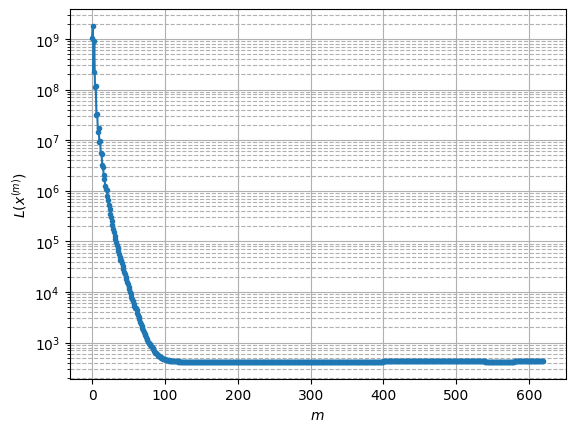

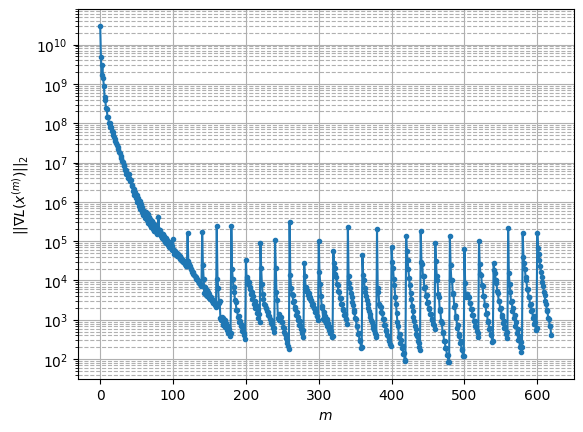

Windows:  10%|█         | 31/296 [21:31<2:58:17, 40.37s/it]

Before applying the algorithm
Cost function: 431.58806289407903
Gradient norm: 116646.43137533942
Global relative error: 0.8194810237254373
Position relative errors: 0.029054156653646367 m, 0.6563174909026774 m, 0.3698195078871116 m, 0.3212246458690325 m

Iteration 1
Cost function: 431.4970431291677 (-0.02%)
Gradient norm: 3154.8309086266036 (-97.30%)
Global relative error: 0.7759815984977715 (-5.31%)
Position relative errors: 0.032699267588179315 m, 0.6115291966814581 m, 0.36234600646782045 m, 0.309540054277443 m

Iteration 2
Cost function: 431.47429999051246 (-0.01%)
Gradient norm: 5751.0482188116885 (82.29%)
Global relative error: 0.736427466233444 (-5.10%)
Position relative errors: 0.032392429624276686 m, 0.5733562606228675 m, 0.34642132947189624 m, 0.30418825700299296 m

Iteration 3
Cost function: 431.46429576570614 (-0.00%)
Gradient norm: 1676.3205984557203 (-70.85%)
Global relative error: 0.7295357620877609 (-0.94%)
Position relative errors: 0.03220762754540845 m, 0.561804310617

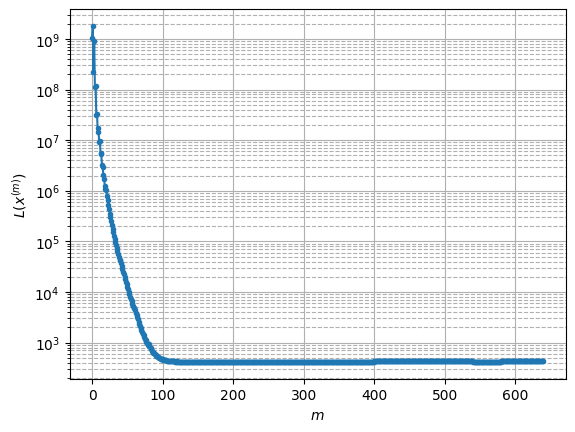

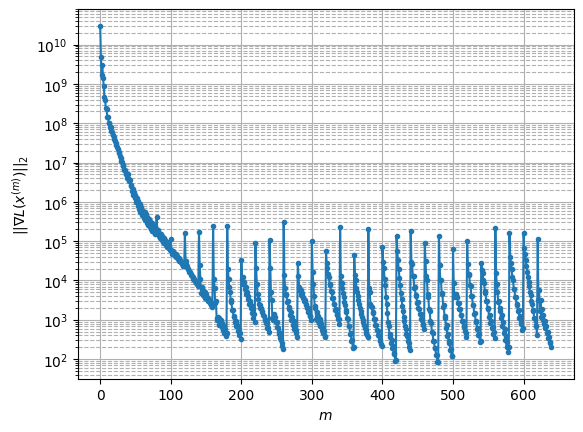

Windows:  11%|█         | 32/296 [22:14<3:01:09, 41.17s/it]

Before applying the algorithm
Cost function: 431.7261035851004
Gradient norm: 69567.88023624918
Global relative error: 0.6980477762707886
Position relative errors: 0.030148788597700437 m, 0.5094510651727647 m, 0.32313746949228284 m, 0.34986164389274593 m

Iteration 1
Cost function: 430.86446081578464 (-0.20%)
Gradient norm: 28184.912890977594 (-59.49%)
Global relative error: 0.688772518168538 (-1.33%)
Position relative errors: 0.012984217534949268 m, 0.5280511066119065 m, 0.4351355033179282 m, 0.07783180688975826 m

Iteration 2
Cost function: 430.7415016145285 (-0.03%)
Gradient norm: 15927.94391434956 (-43.49%)
Global relative error: 0.6379232005826235 (-7.38%)
Position relative errors: 0.012865053404108125 m, 0.5125681813156462 m, 0.3739320236716236 m, 0.06502975679160056 m

Iteration 3
Cost function: 430.69494687251307 (-0.01%)
Gradient norm: 14863.022656685618 (-6.69%)
Global relative error: 0.6737868197576111 (5.62%)
Position relative errors: 0.012828997420326586 m, 0.5362220141914

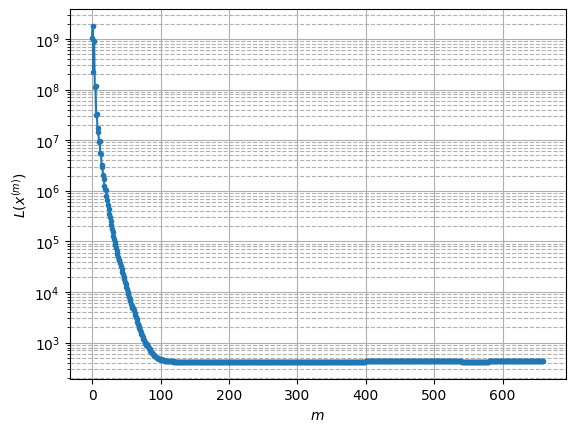

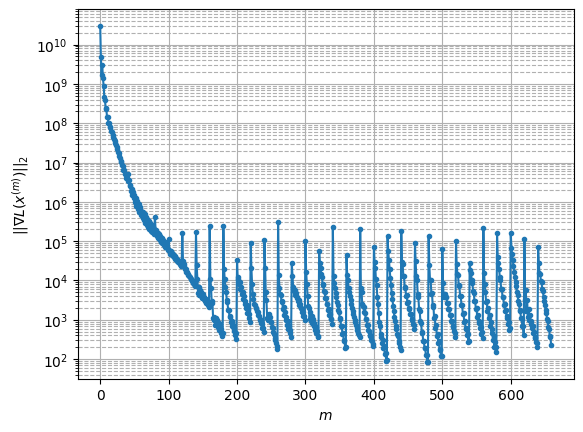

Windows:  11%|█         | 33/296 [22:54<2:59:16, 40.90s/it]

Before applying the algorithm
Cost function: 431.6122407256726
Gradient norm: 77572.5031454617
Global relative error: 0.7213215992019364
Position relative errors: 0.011973644209255037 m, 0.6220988917218565 m, 0.3514792806061756 m, 0.09806352121785064 m

Iteration 1
Cost function: 431.111938933186 (-0.12%)
Gradient norm: 57477.38087924636 (-25.90%)
Global relative error: 0.6731584133087628 (-6.68%)
Position relative errors: 0.015318024566697622 m, 0.42435412946392903 m, 0.36977972254141284 m, 0.3689091462203452 m

Iteration 2
Cost function: 430.9638987206259 (-0.03%)
Gradient norm: 41199.71102441764 (-28.32%)
Global relative error: 0.6352443042686885 (-5.63%)
Position relative errors: 0.014915483590670813 m, 0.5397917361380711 m, 0.2952852762960715 m, 0.15730255700359275 m

Iteration 3
Cost function: 430.89857942943155 (-0.02%)
Gradient norm: 33640.40113115263 (-18.35%)
Global relative error: 0.6314554396849597 (-0.60%)
Position relative errors: 0.014661259125746118 m, 0.451626234877214

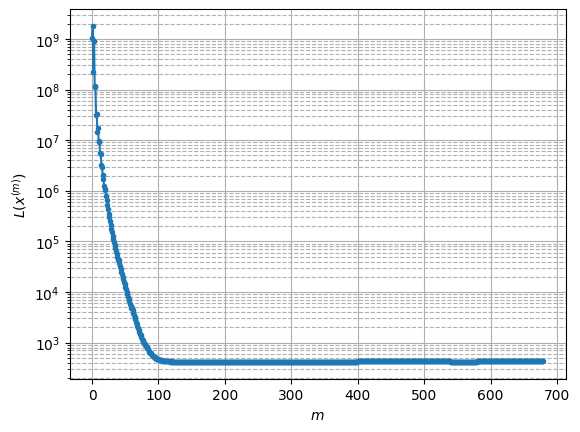

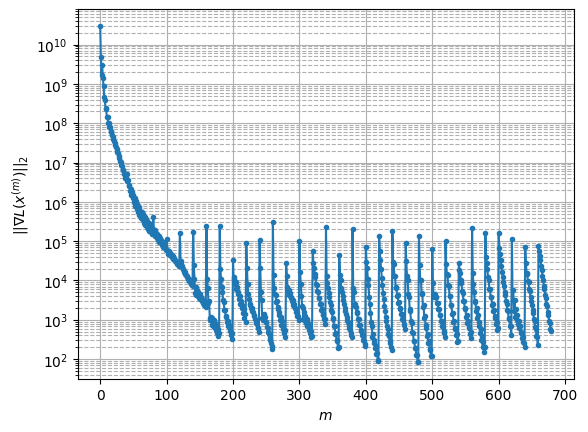

Windows:  11%|█▏        | 34/296 [23:38<3:02:31, 41.80s/it]

Before applying the algorithm
Cost function: 436.0590328827839
Gradient norm: 68170.3446086863
Global relative error: 0.6063228628448261
Position relative errors: 0.013407707614531502 m, 0.48510427443904314 m, 0.2966685211831506 m, 0.210021628644686 m

Iteration 1
Cost function: 435.7411624346746 (-0.07%)
Gradient norm: 51272.813559494585 (-24.79%)
Global relative error: 0.45235401456570146 (-25.39%)
Position relative errors: 0.016475727183241643 m, 0.29931160935905354 m, 0.24598637407057508 m, 0.23292887857475453 m

Iteration 2
Cost function: 435.64046185794217 (-0.02%)
Gradient norm: 27195.49449997418 (-46.96%)
Global relative error: 0.5080006161969163 (12.30%)
Position relative errors: 0.016165820168839086 m, 0.4095428119277331 m, 0.23504782894201015 m, 0.18662894107516687 m

Iteration 3
Cost function: 435.59704380206483 (-0.01%)
Gradient norm: 23579.975776103816 (-13.29%)
Global relative error: 0.4877354589955464 (-3.99%)
Position relative errors: 0.0159536861604864 m, 0.3597202103

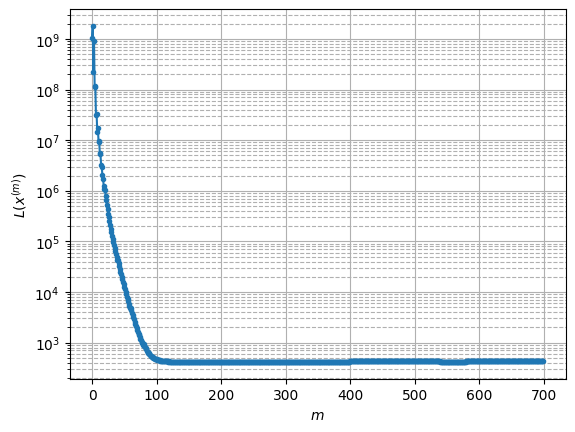

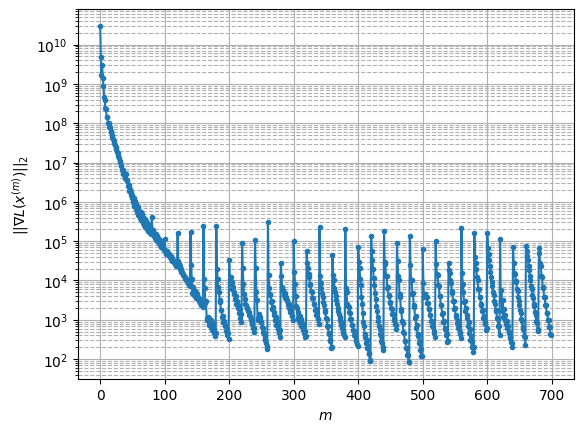

Windows:  12%|█▏        | 35/296 [24:21<3:02:53, 42.04s/it]

Before applying the algorithm
Cost function: 438.37475841272527
Gradient norm: 94389.864577773
Global relative error: 0.49524521660115955
Position relative errors: 0.014560102166854256 m, 0.391624054669291 m, 0.238075569124877 m, 0.18709952712636102 m

Iteration 1
Cost function: 437.8490643226333 (-0.12%)
Gradient norm: 31120.174932764352 (-67.03%)
Global relative error: 0.5764992543323877 (16.41%)
Position relative errors: 0.010905682100914945 m, 0.48456953441943784 m, 0.29543526792204433 m, 0.10070990420303517 m

Iteration 2
Cost function: 437.816339706738 (-0.01%)
Gradient norm: 21278.588275329286 (-31.62%)
Global relative error: 0.5951958577141733 (3.24%)
Position relative errors: 0.010908463097087685 m, 0.5325489206747767 m, 0.26160026152926114 m, 0.045778620874303524 m

Iteration 3
Cost function: 437.80654961992025 (-0.00%)
Gradient norm: 14437.781535372978 (-32.15%)
Global relative error: 0.5978880175103596 (0.45%)
Position relative errors: 0.010917712694729935 m, 0.517224022682

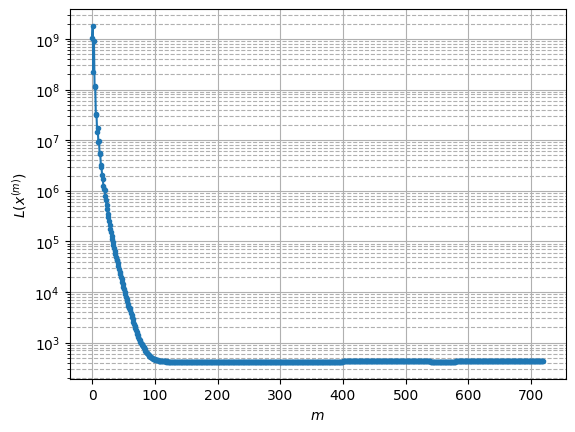

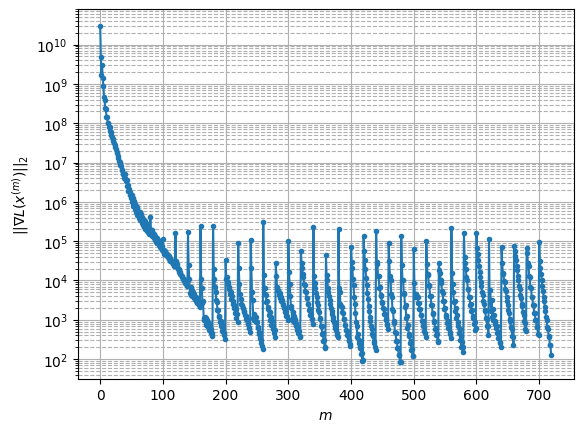

Windows:  12%|█▏        | 36/296 [25:02<3:00:33, 41.67s/it]

Before applying the algorithm
Cost function: 438.0352214737168
Gradient norm: 111277.55834992992
Global relative error: 0.6394394767173358
Position relative errors: 0.011013199366520603 m, 0.5795916166960856 m, 0.23844903327498423 m, 0.12639888501036892 m

Iteration 1
Cost function: 437.54347910023654 (-0.11%)
Gradient norm: 37655.013758846435 (-66.16%)
Global relative error: 0.6556380138944853 (2.53%)
Position relative errors: 0.013328234166258536 m, 0.5426233665210177 m, 0.3326721446870122 m, 0.15675502354303272 m

Iteration 2
Cost function: 437.48384991928697 (-0.01%)
Gradient norm: 26118.358040521456 (-30.64%)
Global relative error: 0.7345804358321774 (12.04%)
Position relative errors: 0.013362498851185126 m, 0.6640923436225258 m, 0.3049593402455865 m, 0.0735552117034749 m

Iteration 3
Cost function: 437.46240584427727 (-0.00%)
Gradient norm: 21032.1814880752 (-19.47%)
Global relative error: 0.6991510270160826 (-4.82%)
Position relative errors: 0.013379601945287537 m, 0.60464285652

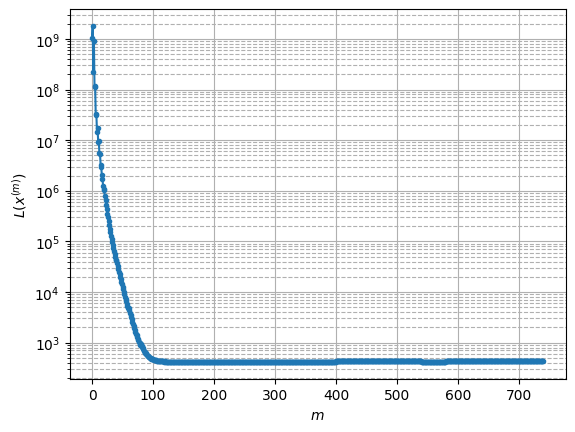

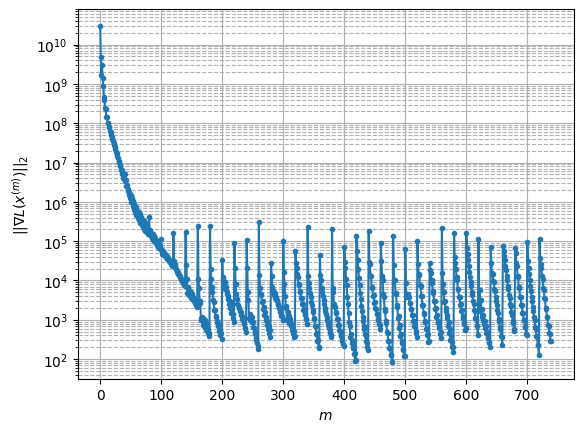

Windows:  12%|█▎        | 37/296 [25:44<3:00:55, 41.91s/it]

Before applying the algorithm
Cost function: 433.5544975932458
Gradient norm: 111986.15154944231
Global relative error: 0.7294624078905397
Position relative errors: 0.013531114306266639 m, 0.6467191318148561 m, 0.32646003768917836 m, 0.08431909726975213 m

Iteration 1
Cost function: 433.1891929951993 (-0.08%)
Gradient norm: 20575.606618878013 (-81.63%)
Global relative error: 0.7489584929531258 (2.67%)
Position relative errors: 0.00918269585567866 m, 0.6251726606711595 m, 0.3760216927290959 m, 0.16917631598774244 m

Iteration 2
Cost function: 433.1344447562422 (-0.01%)
Gradient norm: 13929.47618678749 (-32.30%)
Global relative error: 0.7820090902025736 (4.41%)
Position relative errors: 0.009123118831118451 m, 0.6530274352312321 m, 0.4145967857382353 m, 0.11453785731570726 m

Iteration 3
Cost function: 433.11070176003966 (-0.01%)
Gradient norm: 11300.180613983415 (-18.88%)
Global relative error: 0.7571699624198435 (-3.18%)
Position relative errors: 0.009083654076913113 m, 0.6106250392644

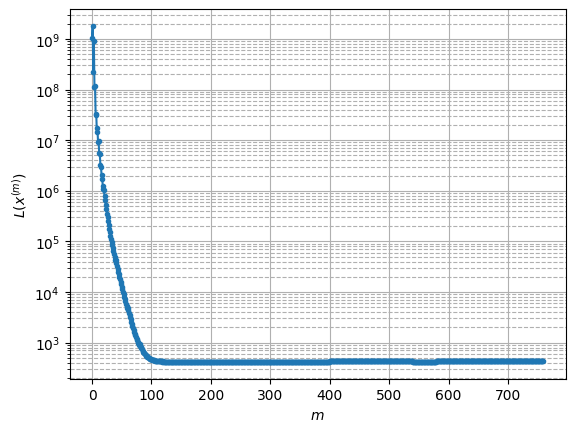

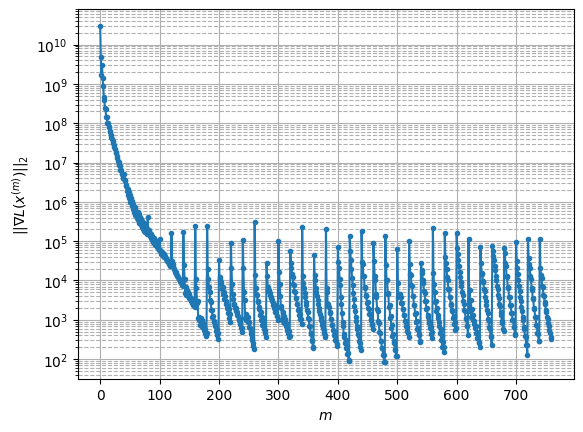

Windows:  13%|█▎        | 38/296 [26:27<3:01:33, 42.22s/it]

Before applying the algorithm
Cost function: 435.904071885553
Gradient norm: 249014.01646135835
Global relative error: 0.7676048141928521
Position relative errors: 0.008393286442059378 m, 0.537042659816692 m, 0.5259823698250586 m, 0.1551572281943533 m

Iteration 1
Cost function: 435.67918200733965 (-0.05%)
Gradient norm: 18233.362698858775 (-92.68%)
Global relative error: 0.7786332603040592 (1.44%)
Position relative errors: 0.008832520050360214 m, 0.5081794415002755 m, 0.5315444754371363 m, 0.25574410310741097 m

Iteration 2
Cost function: 435.6601352205718 (-0.00%)
Gradient norm: 9973.189974105559 (-45.30%)
Global relative error: 0.7933736748396509 (1.89%)
Position relative errors: 0.008804660183385967 m, 0.5482850889902551 m, 0.5206492848018839 m, 0.24014831326663416 m

Iteration 3
Cost function: 435.6544333213891 (-0.00%)
Gradient norm: 6590.533029496818 (-33.92%)
Global relative error: 0.7874744897018903 (-0.74%)
Position relative errors: 0.008823833957715084 m, 0.5410355253411822 

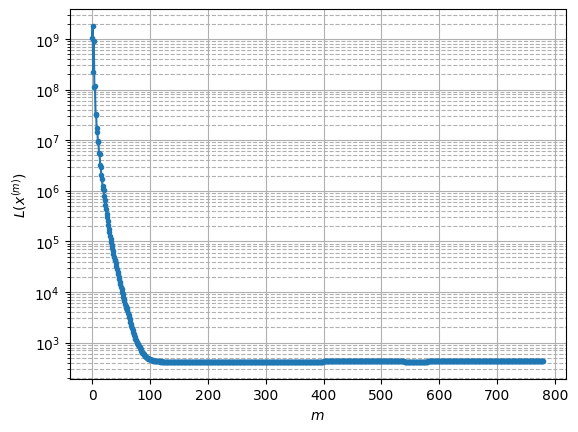

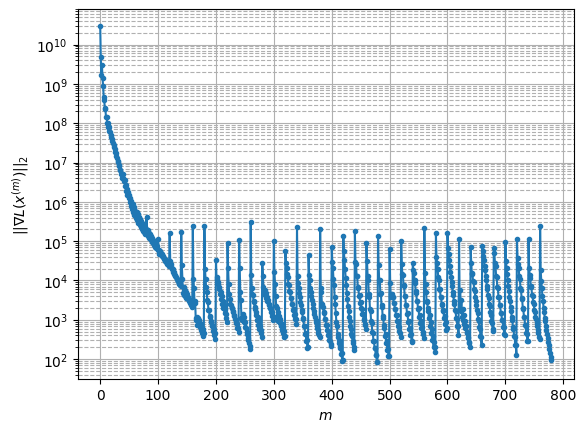

Windows:  13%|█▎        | 39/296 [27:10<3:02:20, 42.57s/it]

Before applying the algorithm
Cost function: 434.7462394490494
Gradient norm: 332624.1544018941
Global relative error: 0.7821443295560636
Position relative errors: 0.008767576562049987 m, 0.5905439564409072 m, 0.4808015976034046 m, 0.1782119948855591 m

Iteration 1
Cost function: 434.29392484328474 (-0.10%)
Gradient norm: 4575.576967964791 (-98.62%)
Global relative error: 0.7788277539786921 (-0.42%)
Position relative errors: 0.008163008974852776 m, 0.5131449762655008 m, 0.4828060405022794 m, 0.3317912063128386 m

Iteration 2
Cost function: 434.243610265321 (-0.01%)
Gradient norm: 6862.706757668308 (49.99%)
Global relative error: 0.7751703389460787 (-0.47%)
Position relative errors: 0.008078703363358364 m, 0.5189011182252999 m, 0.5097342633859656 m, 0.2678343175241192 m

Iteration 3
Cost function: 434.22649949809676 (-0.00%)
Gradient norm: 5104.804479445807 (-25.62%)
Global relative error: 0.7853876844164192 (1.32%)
Position relative errors: 0.00806834398353309 m, 0.5151926027682006 m, 

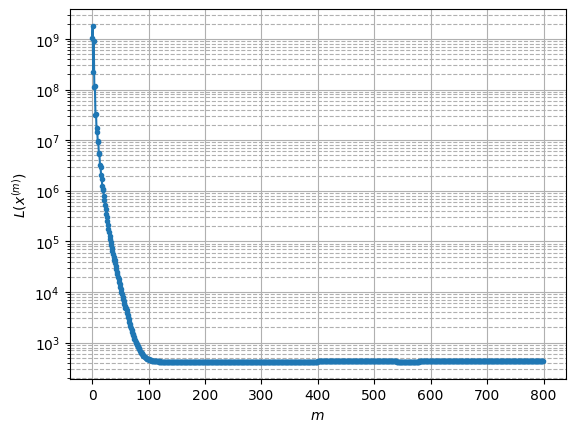

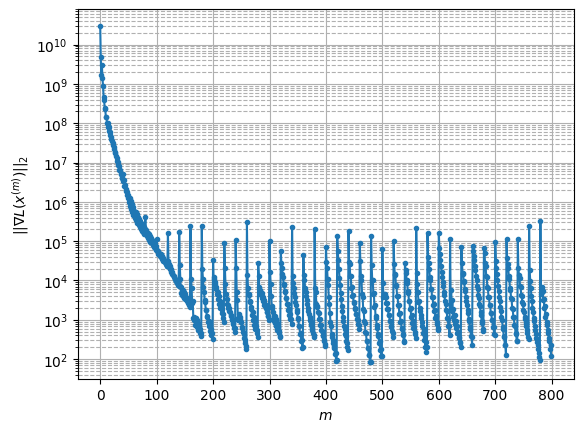

Windows:  14%|█▎        | 40/296 [27:52<3:00:38, 42.34s/it]

Before applying the algorithm
Cost function: 432.9578899837178
Gradient norm: 205261.04030941398
Global relative error: 0.7680843452428885
Position relative errors: 0.008294055064954065 m, 0.48772016239492744 m, 0.5217723184684366 m, 0.2824290227374096 m

Iteration 1
Cost function: 432.5778885232117 (-0.09%)
Gradient norm: 22953.93273761546 (-88.82%)
Global relative error: 0.8499348390953131 (10.66%)
Position relative errors: 0.007745126303444145 m, 0.606345251682748 m, 0.54057614505143 m, 0.24990178996589013 m

Iteration 2
Cost function: 432.54091314487886 (-0.01%)
Gradient norm: 10852.494601352302 (-52.72%)
Global relative error: 0.7742347032722587 (-8.91%)
Position relative errors: 0.0076671594502859975 m, 0.5351521711057914 m, 0.5121528813395209 m, 0.22514669172849888 m

Iteration 3
Cost function: 432.531769519092 (-0.00%)
Gradient norm: 5054.581469907957 (-53.42%)
Global relative error: 0.8129203022417845 (5.00%)
Position relative errors: 0.007662667075035232 m, 0.5751940362937739

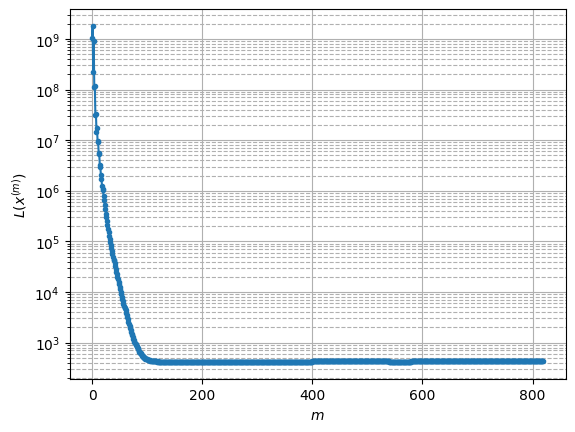

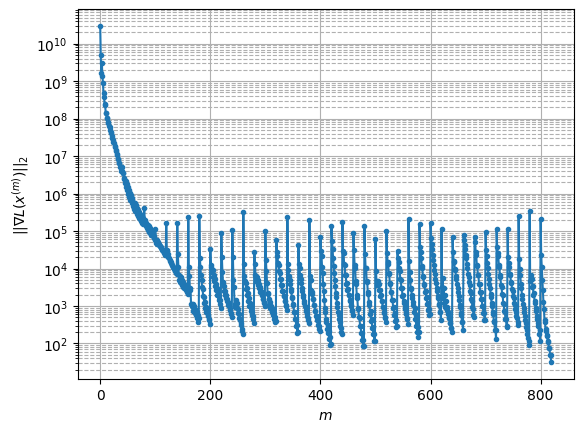

Windows:  14%|█▍        | 41/296 [28:33<2:57:45, 41.83s/it]

Before applying the algorithm
Cost function: 433.42281785302407
Gradient norm: 230124.46877761124
Global relative error: 0.7818610688562158
Position relative errors: 0.008187368251077857 m, 0.5794231440181227 m, 0.49147682442938834 m, 0.1842768639146005 m

Iteration 1
Cost function: 432.90641511080975 (-0.12%)
Gradient norm: 23515.494821310247 (-89.78%)
Global relative error: 0.7618767883719798 (-2.56%)
Position relative errors: 0.013753626710217627 m, 0.6171137779879674 m, 0.4330546709429787 m, 0.10908871221450685 m

Iteration 2
Cost function: 432.8551239838694 (-0.01%)
Gradient norm: 15153.559247025936 (-35.56%)
Global relative error: 0.7162655252167653 (-5.99%)
Position relative errors: 0.01406101327793869 m, 0.5465149940975222 m, 0.4576793691304186 m, 0.06847352666453808 m

Iteration 3
Cost function: 432.83762043686465 (-0.00%)
Gradient norm: 9816.08013473184 (-35.22%)
Global relative error: 0.7518562171409389 (4.97%)
Position relative errors: 0.014288223615714257 m, 0.587228221456

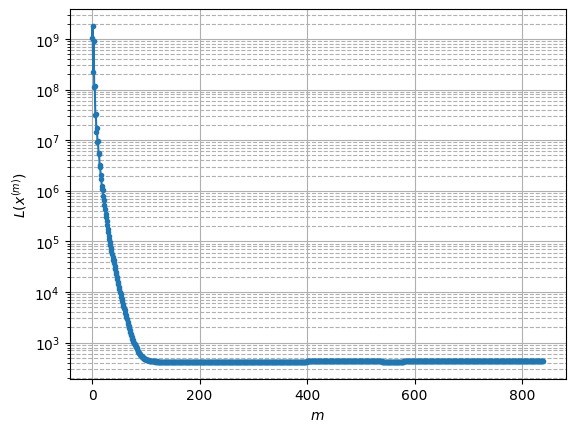

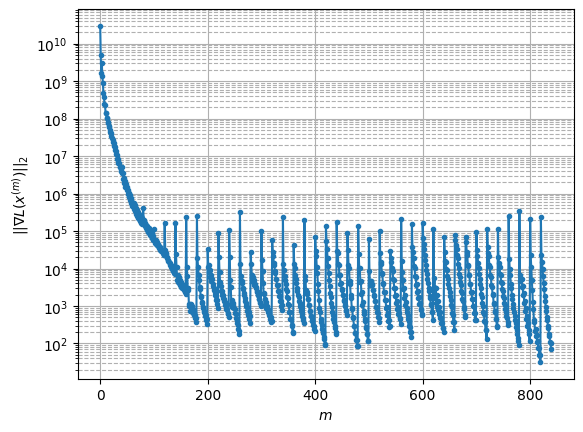

Windows:  14%|█▍        | 42/296 [29:07<2:47:44, 39.62s/it]

Before applying the algorithm
Cost function: 436.74450843594826
Gradient norm: 165691.5193168073
Global relative error: 0.7313832469697688
Position relative errors: 0.014829271828757823 m, 0.5521754356187906 m, 0.4754353257896217 m, 0.06135344494922578 m

Iteration 1
Cost function: 436.55462801284347 (-0.04%)
Gradient norm: 16645.161621154875 (-89.95%)
Global relative error: 0.7530817998592351 (2.97%)
Position relative errors: 0.018463349278481034 m, 0.5821843680058165 m, 0.47158671009851666 m, 0.0738765017598383 m

Iteration 2
Cost function: 436.53385224291105 (-0.00%)
Gradient norm: 10360.192743646336 (-37.76%)
Global relative error: 0.7793707929263951 (3.49%)
Position relative errors: 0.01866360646869273 m, 0.5992675633413378 m, 0.48503223398128326 m, 0.11265725123157272 m

Iteration 3
Cost function: 436.5272944697482 (-0.00%)
Gradient norm: 8608.534825663333 (-16.91%)
Global relative error: 0.7716415140248601 (-0.99%)
Position relative errors: 0.018703536072649067 m, 0.587136062309

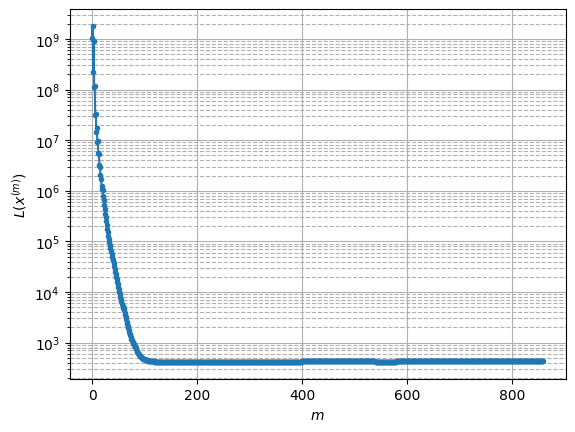

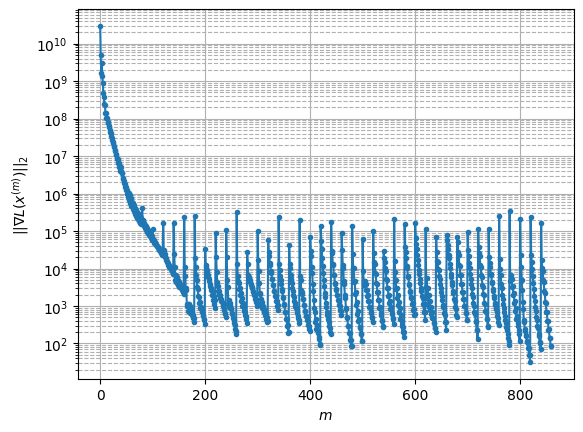

Windows:  15%|█▍        | 43/296 [29:42<2:40:42, 38.11s/it]

Before applying the algorithm
Cost function: 441.05630809673045
Gradient norm: 146532.10814711754
Global relative error: 0.7595748232350885
Position relative errors: 0.018638742897897805 m, 0.578560553120675 m, 0.48338398077690525 m, 0.09062609589159197 m

Iteration 1
Cost function: 440.8637742030224 (-0.04%)
Gradient norm: 10813.324500148867 (-92.62%)
Global relative error: 0.7720539236448617 (1.64%)
Position relative errors: 0.02643183981728258 m, 0.5963530983408448 m, 0.4570350121259739 m, 0.17564033513163427 m

Iteration 2
Cost function: 440.85370227684075 (-0.00%)
Gradient norm: 5887.868573868688 (-45.55%)
Global relative error: 0.7619866939103039 (-1.30%)
Position relative errors: 0.02647705360820358 m, 0.5815758267200332 m, 0.4684484188812414 m, 0.14915517141901694 m

Iteration 3
Cost function: 440.8501262151312 (-0.00%)
Gradient norm: 3824.7454663071376 (-35.04%)
Global relative error: 0.7726561976840793 (1.40%)
Position relative errors: 0.026518430037593597 m, 0.58980615859323

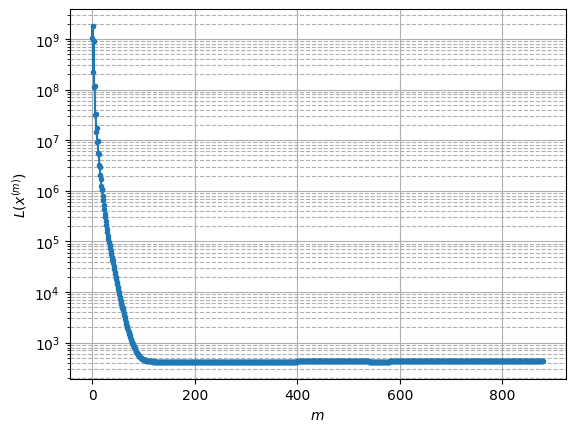

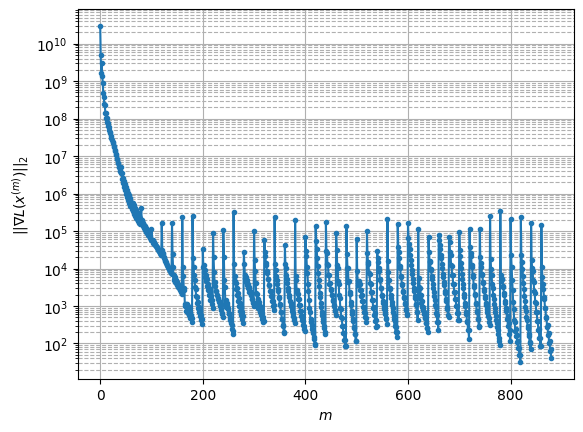

Windows:  15%|█▍        | 44/296 [30:17<2:35:33, 37.04s/it]

Before applying the algorithm
Cost function: 441.41656294241653
Gradient norm: 238983.63148524959
Global relative error: 0.7423614164254958
Position relative errors: 0.02598238355887134 m, 0.5630414632543358 m, 0.4602830583666485 m, 0.14679275403697192 m

Iteration 1
Cost function: 441.3107253319789 (-0.02%)
Gradient norm: 12711.479271276168 (-94.68%)
Global relative error: 0.740213894285847 (-0.29%)
Position relative errors: 0.02375132883428163 m, 0.589398652360409 m, 0.4316514742865263 m, 0.11678045809036677 m

Iteration 2
Cost function: 441.2956252489923 (-0.00%)
Gradient norm: 6925.5182418122595 (-45.52%)
Global relative error: 0.7303035040681223 (-1.34%)
Position relative errors: 0.02370931385510968 m, 0.5735016767195228 m, 0.43724698214117325 m, 0.11265402161875161 m

Iteration 3
Cost function: 441.2901845901962 (-0.00%)
Gradient norm: 4813.311358010901 (-30.50%)
Global relative error: 0.7330752279264743 (0.38%)
Position relative errors: 0.02362504321961278 m, 0.583335245790111 m

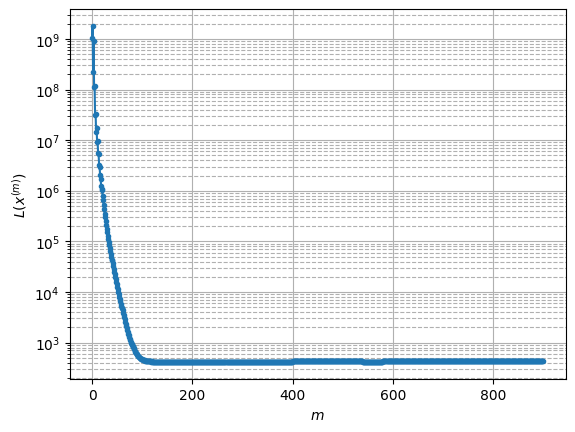

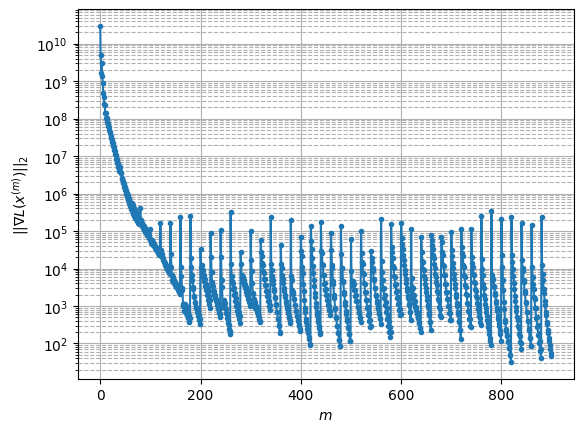

Windows:  15%|█▌        | 45/296 [30:52<2:32:56, 36.56s/it]

Before applying the algorithm
Cost function: 441.4137459918507
Gradient norm: 98103.02272527682
Global relative error: 0.7062781392298623
Position relative errors: 0.02315537638086357 m, 0.5873609059055575 m, 0.3858224569463548 m, 0.06663197030385709 m

Iteration 1
Cost function: 441.19917983824416 (-0.05%)
Gradient norm: 24551.46421900694 (-74.97%)
Global relative error: 0.67510336210189 (-4.41%)
Position relative errors: 0.024664184712831296 m, 0.5650161352820894 m, 0.3647572789518271 m, 0.05351895414483039 m

Iteration 2
Cost function: 441.18094230271726 (-0.00%)
Gradient norm: 12778.44344117825 (-47.95%)
Global relative error: 0.6567105105941061 (-2.72%)
Position relative errors: 0.024549162682905232 m, 0.5443675289138745 m, 0.35994315832930807 m, 0.06906629003635713 m

Iteration 3
Cost function: 441.1748421529419 (-0.00%)
Gradient norm: 9053.461228607443 (-29.15%)
Global relative error: 0.665881118179314 (1.40%)
Position relative errors: 0.02449636566737085 m, 0.5572141851155046 m

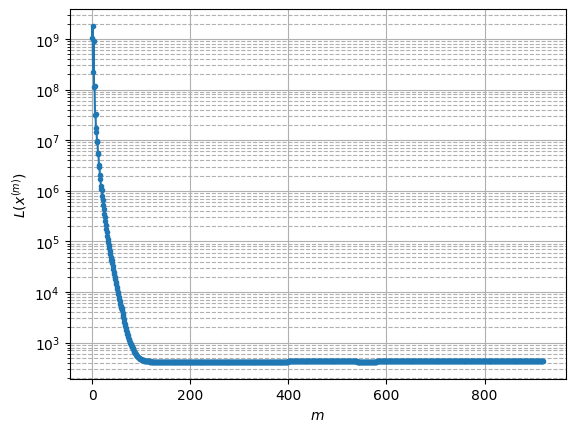

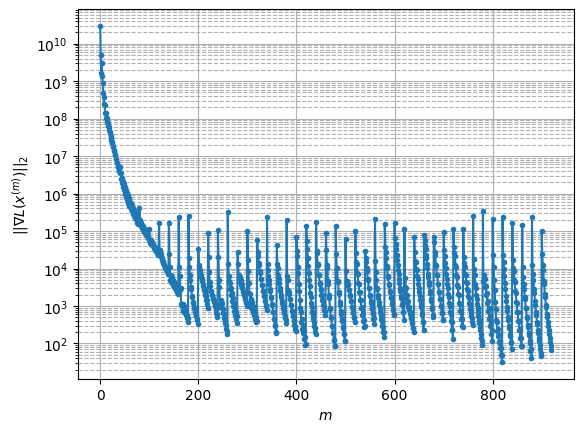

Windows:  16%|█▌        | 46/296 [31:29<2:32:43, 36.65s/it]

Before applying the algorithm
Cost function: 442.47685401218763
Gradient norm: 109770.67114126383
Global relative error: 0.6475423313442243
Position relative errors: 0.023954148047411736 m, 0.5492840276577707 m, 0.32620585759431525 m, 0.10302110749636947 m

Iteration 1
Cost function: 441.77471858031316 (-0.16%)
Gradient norm: 39710.09485293745 (-63.82%)
Global relative error: 0.6642966461282872 (2.59%)
Position relative errors: 0.026613093464311108 m, 0.41743489882683843 m, 0.32361159833070446 m, 0.4020010509856807 m

Iteration 2
Cost function: 441.6961295053497 (-0.02%)
Gradient norm: 16180.73569756917 (-59.25%)
Global relative error: 0.664561302432333 (0.04%)
Position relative errors: 0.02637722877903696 m, 0.4563276280221514 m, 0.3106660700987724 m, 0.3690489248022877 m

Iteration 3
Cost function: 441.6774485569119 (-0.00%)
Gradient norm: 11296.009972687958 (-30.19%)
Global relative error: 0.6709298957325543 (0.96%)
Position relative errors: 0.026339442919055718 m, 0.452702240498164

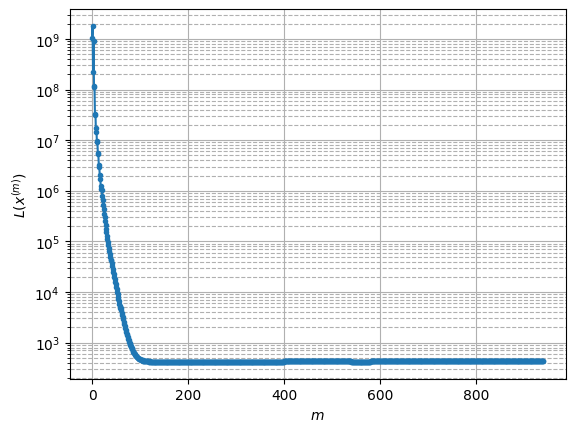

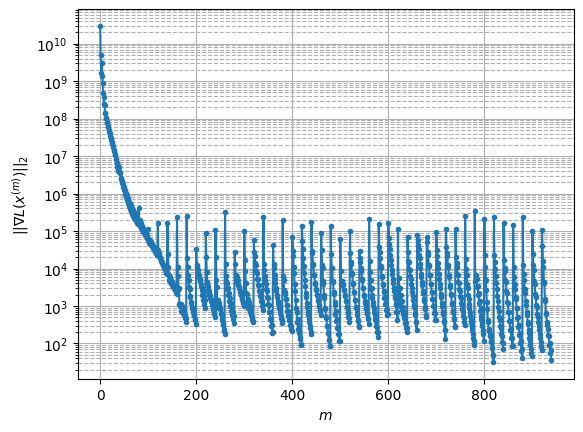

Windows:  16%|█▌        | 47/296 [32:04<2:30:47, 36.34s/it]

Before applying the algorithm
Cost function: 444.94727809462944
Gradient norm: 262932.39308300393
Global relative error: 0.7511735135011345
Position relative errors: 0.025635741278305944 m, 0.5167955630629022 m, 0.24051112014387158 m, 0.4885495824309696 m

Iteration 1
Cost function: 444.590462038208 (-0.08%)
Gradient norm: 28072.912619902443 (-89.32%)
Global relative error: 0.8748327406258117 (16.46%)
Position relative errors: 0.03045276424573142 m, 0.4935021309872704 m, 0.2509349279717615 m, 0.6766770311421906 m

Iteration 2
Cost function: 444.5611227995328 (-0.01%)
Gradient norm: 10159.69002840183 (-63.81%)
Global relative error: 0.8647848770738361 (-1.15%)
Position relative errors: 0.030597624754415735 m, 0.5101128635521724 m, 0.24789338505535824 m, 0.6521119007755071 m

Iteration 3
Cost function: 444.55406663161693 (-0.00%)
Gradient norm: 5679.970427931408 (-44.09%)
Global relative error: 0.8822098979280941 (2.01%)
Position relative errors: 0.03061107091982349 m, 0.5117014825375948

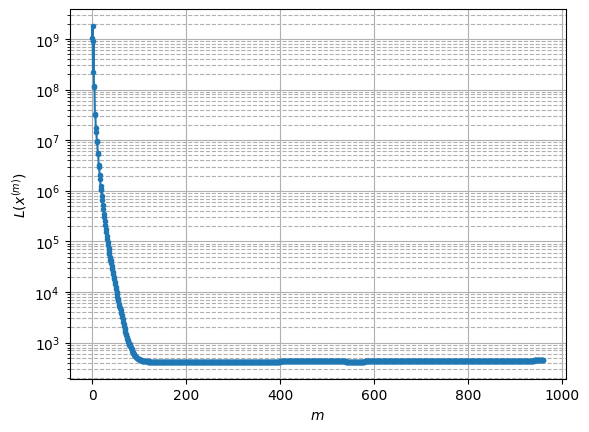

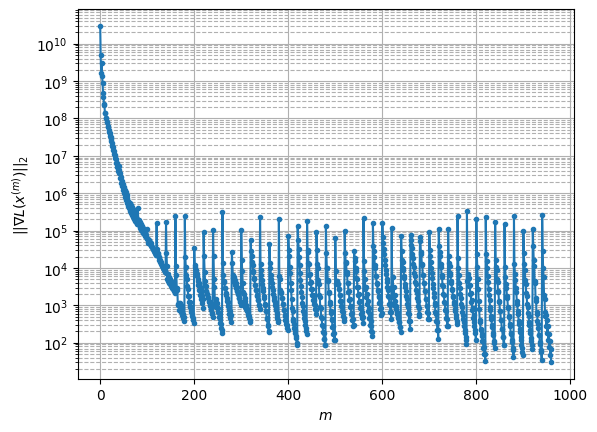

Windows:  16%|█▌        | 48/296 [32:39<2:28:33, 35.94s/it]

Before applying the algorithm
Cost function: 444.87472621066394
Gradient norm: 299677.6700416616
Global relative error: 0.92412920627494
Position relative errors: 0.029865730290310078 m, 0.5418374117745794 m, 0.23328365730803877 m, 0.7107132640773429 m

Iteration 1
Cost function: 444.499351428274 (-0.08%)
Gradient norm: 18928.897218463568 (-93.68%)
Global relative error: 0.9961082083557995 (7.79%)
Position relative errors: 0.037369823205310806 m, 0.4426365028903975 m, 0.20841364600982043 m, 0.8668743702692205 m

Iteration 2
Cost function: 444.46463102238187 (-0.01%)
Gradient norm: 10739.107670881524 (-43.27%)
Global relative error: 1.0033960787247593 (0.73%)
Position relative errors: 0.037455012965679525 m, 0.46144964993023246 m, 0.2136300411969043 m, 0.8641913358771136 m

Iteration 3
Cost function: 444.45177549753913 (-0.00%)
Gradient norm: 7673.371174528254 (-28.55%)
Global relative error: 1.0197345242141551 (1.63%)
Position relative errors: 0.037620445767631946 m, 0.4627469623445256

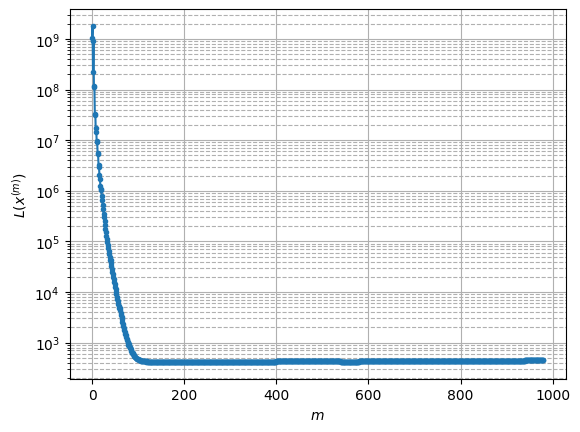

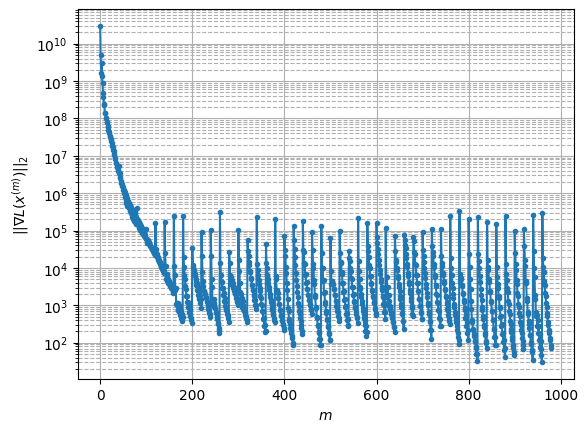

Windows:  17%|█▋        | 49/296 [33:15<2:27:27, 35.82s/it]

Before applying the algorithm
Cost function: 447.1905664429758
Gradient norm: 272936.4637759397
Global relative error: 1.0690001239477123
Position relative errors: 0.036625613095879445 m, 0.4863434172766507 m, 0.23899902742993023 m, 0.9207436373569886 m

Iteration 1
Cost function: 446.8854034885474 (-0.07%)
Gradient norm: 19996.29519057134 (-92.67%)
Global relative error: 1.1787618280226406 (10.27%)
Position relative errors: 0.039006849341654166 m, 0.41450120669350793 m, 0.24459219028773466 m, 1.0753234943714098 m

Iteration 2
Cost function: 446.83810608914723 (-0.01%)
Gradient norm: 11487.234900876441 (-42.55%)
Global relative error: 1.1512838365672902 (-2.33%)
Position relative errors: 0.038980157965939816 m, 0.42488383584429956 m, 0.2414909837554682 m, 1.041676600512186 m

Iteration 3
Cost function: 446.8202800731429 (-0.00%)
Gradient norm: 7738.210800899961 (-32.64%)
Global relative error: 1.1614703862203613 (0.88%)
Position relative errors: 0.03917364000429437 m, 0.401169934845684

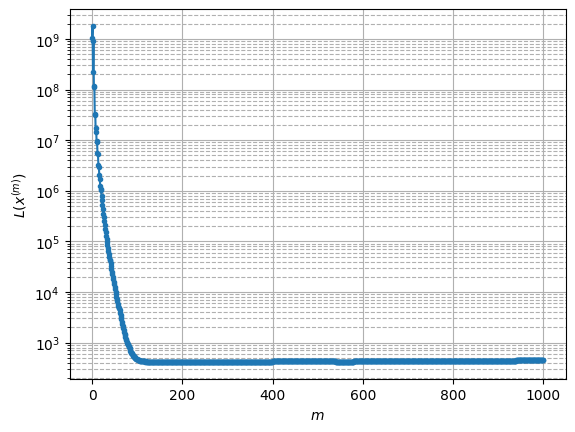

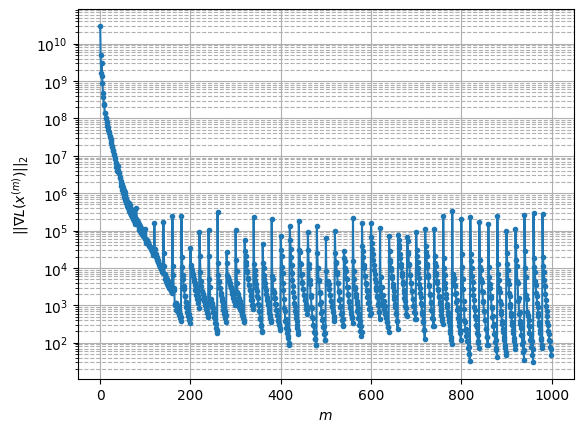

Windows:  17%|█▋        | 50/296 [33:50<2:26:04, 35.63s/it]

Before applying the algorithm
Cost function: 452.082263895282
Gradient norm: 102915.9736025368
Global relative error: 1.1404509391962288
Position relative errors: 0.03816047879590456 m, 0.3652487243591218 m, 0.25756031221210574 m, 1.0485358593246963 m

Iteration 1
Cost function: 451.7529867617536 (-0.07%)
Gradient norm: 24488.532596104513 (-76.21%)
Global relative error: 0.9283725470702139 (-18.60%)
Position relative errors: 0.04071642432279197 m, 0.2621591200390471 m, 0.3659294290411114 m, 0.8109163540283313 m

Iteration 2
Cost function: 451.7011448308773 (-0.01%)
Gradient norm: 11971.417017546477 (-51.11%)
Global relative error: 0.9266317938896371 (-0.19%)
Position relative errors: 0.040644493811121875 m, 0.26313331828916947 m, 0.3168453151656443 m, 0.8290740308900696 m

Iteration 3
Cost function: 451.68392777328927 (-0.00%)
Gradient norm: 7937.954801543592 (-33.69%)
Global relative error: 0.8856008730580143 (-4.43%)
Position relative errors: 0.040702205766790824 m, 0.237298859936367

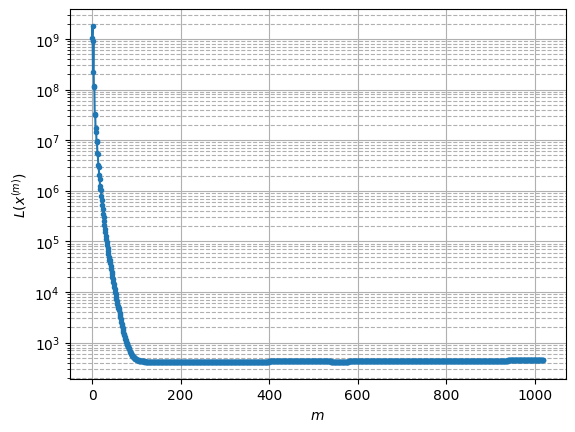

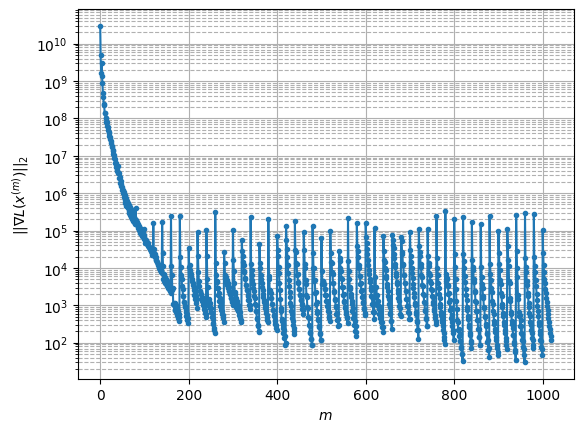

Windows:  17%|█▋        | 51/296 [34:25<2:24:06, 35.29s/it]

Before applying the algorithm
Cost function: 457.2992440014537
Gradient norm: 77914.6888259079
Global relative error: 0.7959798745610723
Position relative errors: 0.03969134915534062 m, 0.1761481679370575 m, 0.3157466881404804 m, 0.7080140002587685 m

Iteration 1
Cost function: 456.7315124100432 (-0.12%)
Gradient norm: 35469.24519863853 (-54.48%)
Global relative error: 0.9522976827256555 (19.64%)
Position relative errors: 0.028125204990846368 m, 0.1405898803659688 m, 0.36656187104388194 m, 0.8671482663128015 m

Iteration 2
Cost function: 456.6792593036649 (-0.01%)
Gradient norm: 14094.490840582726 (-60.26%)
Global relative error: 0.9526494275557729 (0.04%)
Position relative errors: 0.028028595359938277 m, 0.12749492997741577 m, 0.35373566632015097 m, 0.8748547574817815 m

Iteration 3
Cost function: 456.66248432166907 (-0.00%)
Gradient norm: 9341.516465899684 (-33.72%)
Global relative error: 0.9998634383703152 (4.96%)
Position relative errors: 0.028087835217929236 m, 0.11835597786678376

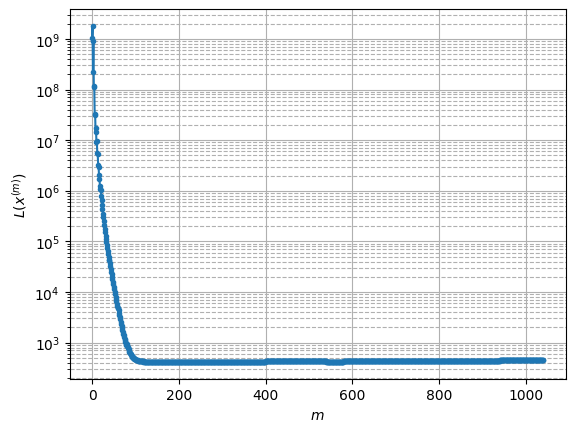

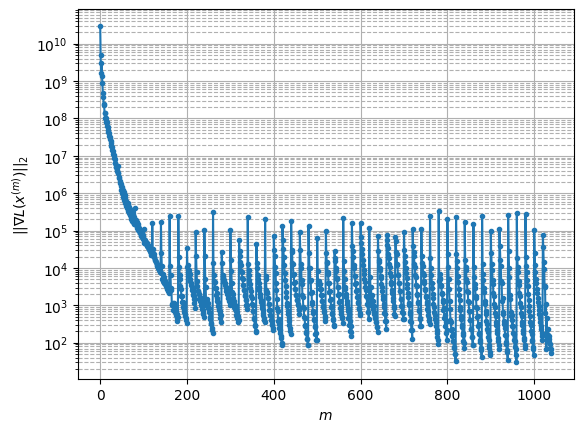

Windows:  18%|█▊        | 52/296 [35:00<2:23:13, 35.22s/it]

Before applying the algorithm
Cost function: 456.25422388311915
Gradient norm: 367181.4194194098
Global relative error: 1.1077872051148703
Position relative errors: 0.027407905625915767 m, 0.11132468044337167 m, 0.42979558973840787 m, 1.0145557255767466 m

Iteration 1
Cost function: 456.0056728905725 (-0.05%)
Gradient norm: 9909.881275624368 (-97.30%)
Global relative error: 1.1615619921114688 (4.85%)
Position relative errors: 0.02185685073793595 m, 0.11009874817838256 m, 0.44293421069561684 m, 1.067911709172258 m

Iteration 2
Cost function: 455.9814545258056 (-0.01%)
Gradient norm: 4211.471969066845 (-57.50%)
Global relative error: 1.128575736156507 (-2.84%)
Position relative errors: 0.02150426833913386 m, 0.09050882863711643 m, 0.4008427095519095 m, 1.0508822101459165 m

Iteration 3
Cost function: 455.97384540026854 (-0.00%)
Gradient norm: 1883.063054440636 (-55.29%)
Global relative error: 1.1252549945934576 (-0.29%)
Position relative errors: 0.021565063909995585 m, 0.0925886161422775

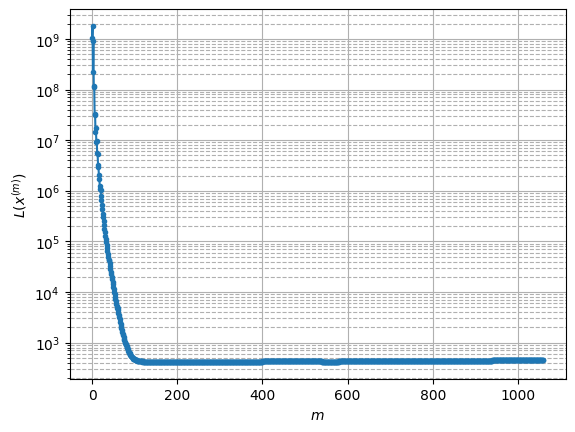

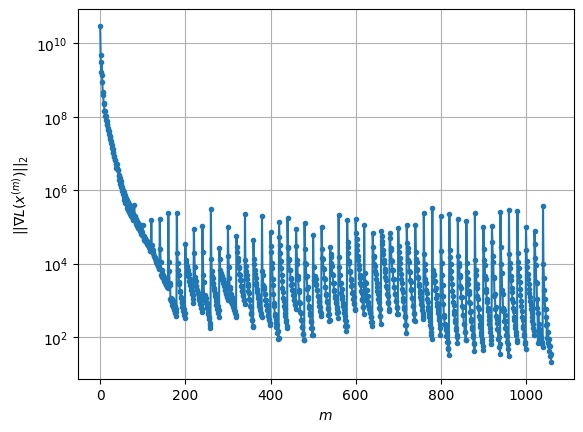

Windows:  18%|█▊        | 53/296 [35:37<2:25:01, 35.81s/it]

Before applying the algorithm
Cost function: 458.3577760515403
Gradient norm: 405481.4366480398
Global relative error: 1.1098855257776497
Position relative errors: 0.021368529745257672 m, 0.08534585003053416 m, 0.3970622266516446 m, 1.03268891224217 m

Iteration 1
Cost function: 457.56246556218457 (-0.17%)
Gradient norm: 15964.631480000699 (-96.06%)
Global relative error: 1.2465005017780768 (12.31%)
Position relative errors: 0.010805277308101892 m, 0.07852304819008603 m, 0.2910490723782659 m, 1.2094504899256266 m

Iteration 2
Cost function: 457.5129986431753 (-0.01%)
Gradient norm: 8167.179473747803 (-48.84%)
Global relative error: 1.2957482413670642 (3.95%)
Position relative errors: 0.010893193035058243 m, 0.08213220732559216 m, 0.3040671573359282 m, 1.2568378552245387 m

Iteration 3
Cost function: 457.49875219171156 (-0.00%)
Gradient norm: 3067.4986486367566 (-62.44%)
Global relative error: 1.2617196325840465 (-2.63%)
Position relative errors: 0.010881855662172746 m, 0.05519549845994

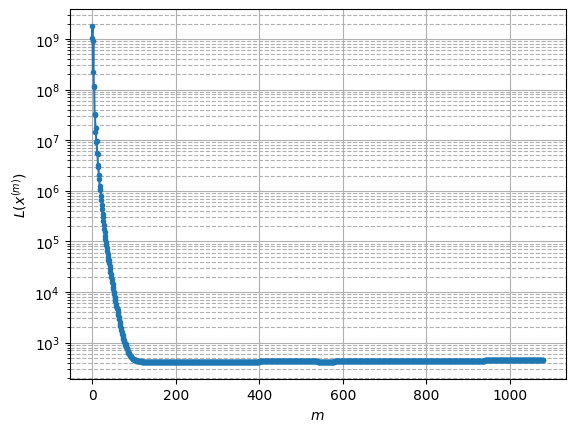

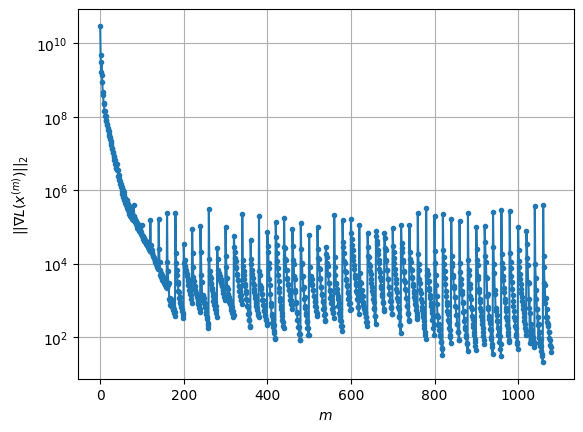

Windows:  18%|█▊        | 54/296 [36:12<2:23:17, 35.53s/it]

Before applying the algorithm
Cost function: 459.9198243896771
Gradient norm: 130334.93329263089
Global relative error: 1.2721465614324512
Position relative errors: 0.011816439729957903 m, 0.0784773008992207 m, 0.2952022201863947 m, 1.2348738136606154 m

Iteration 1
Cost function: 459.72268186974435 (-0.04%)
Gradient norm: 24986.455271282863 (-80.83%)
Global relative error: 1.1886395513861483 (-6.56%)
Position relative errors: 0.010378355716646992 m, 0.09778488019627589 m, 0.246858924621498 m, 1.158556926252279 m

Iteration 2
Cost function: 459.6862498391972 (-0.01%)
Gradient norm: 10949.72756338674 (-56.18%)
Global relative error: 1.1412411062503607 (-3.99%)
Position relative errors: 0.010426458800729742 m, 0.06843471061830589 m, 0.24113848923109427 m, 1.1133241174540451 m

Iteration 3
Cost function: 459.6708564552452 (-0.00%)
Gradient norm: 6132.08662621608 (-44.00%)
Global relative error: 1.1210424512566297 (-1.77%)
Position relative errors: 0.010491156949441928 m, 0.057438556286050

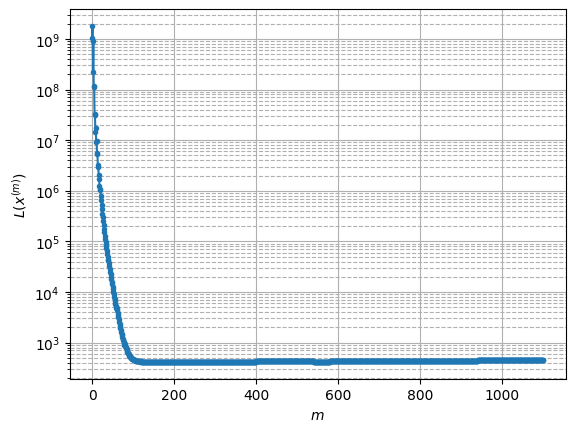

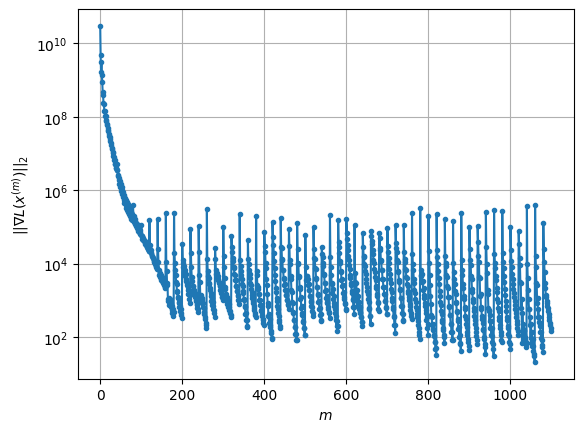

Windows:  19%|█▊        | 55/296 [36:47<2:22:55, 35.58s/it]

Before applying the algorithm
Cost function: 457.3832104636103
Gradient norm: 45027.53254113508
Global relative error: 1.0448638988479166
Position relative errors: 0.011546867225745229 m, 0.09887453337774588 m, 0.24067966084300205 m, 1.0118811814599877 m

Iteration 1
Cost function: 457.0659100524816 (-0.07%)
Gradient norm: 14378.331663710858 (-68.07%)
Global relative error: 0.9824278442987024 (-5.98%)
Position relative errors: 0.012067869167088515 m, 0.1655036701136905 m, 0.26573202055380685 m, 0.9311353411606411 m

Iteration 2
Cost function: 457.04477746335226 (-0.00%)
Gradient norm: 7494.552129434202 (-47.88%)
Global relative error: 0.9829986001934604 (0.06%)
Position relative errors: 0.01207720510037113 m, 0.18327574650683692 m, 0.2574451853145778 m, 0.9307370727178047 m

Iteration 3
Cost function: 457.035006156309 (-0.00%)
Gradient norm: 4747.082648446283 (-36.66%)
Global relative error: 0.9605899894147284 (-2.28%)
Position relative errors: 0.01203631537515545 m, 0.2167611407489078

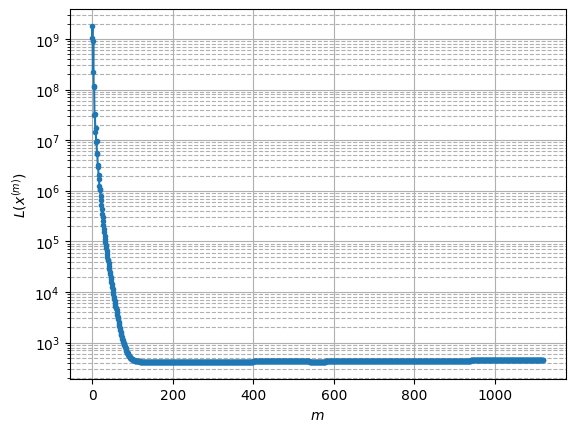

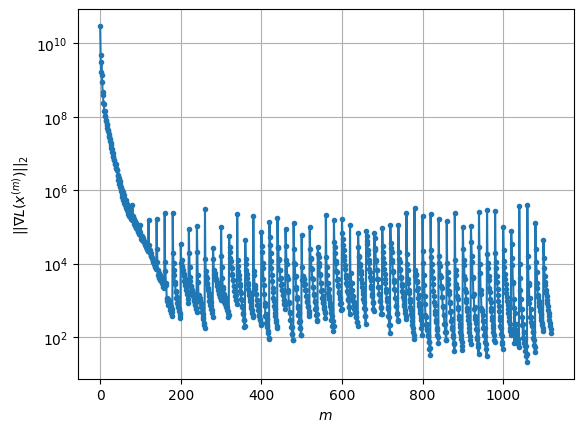

Windows:  19%|█▉        | 56/296 [37:26<2:25:22, 36.34s/it]

Before applying the algorithm
Cost function: 454.1650058265368
Gradient norm: 141196.08793692154
Global relative error: 0.9329018610472167
Position relative errors: 0.011676581276754073 m, 0.3166135546060166 m, 0.27475442900793884 m, 0.8333273947312676 m

Iteration 1
Cost function: 454.087426381195 (-0.02%)
Gradient norm: 9347.380248447602 (-93.38%)
Global relative error: 0.9037765686383358 (-3.12%)
Position relative errors: 0.013937309117956502 m, 0.24141807014219202 m, 0.2935773918497086 m, 0.8198454848844594 m

Iteration 2
Cost function: 454.0787659535778 (-0.00%)
Gradient norm: 4848.977588374642 (-48.12%)
Global relative error: 0.8934128092871165 (-1.15%)
Position relative errors: 0.014028682068061002 m, 0.23538615695666054 m, 0.2821575245920267 m, 0.8142292816226228 m

Iteration 3
Cost function: 454.07513019766805 (-0.00%)
Gradient norm: 1853.07651871226 (-61.78%)
Global relative error: 0.8945082151350263 (0.12%)
Position relative errors: 0.014061318910662141 m, 0.2244758752297043

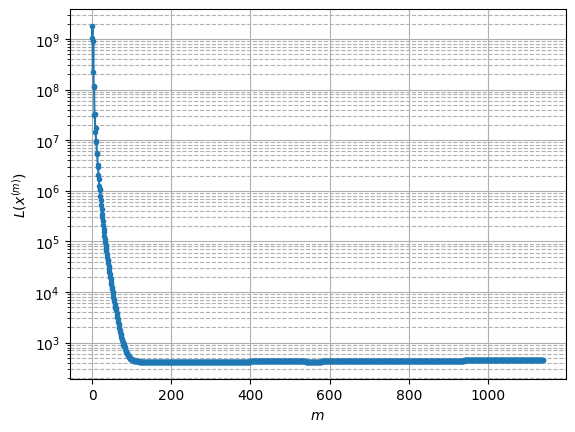

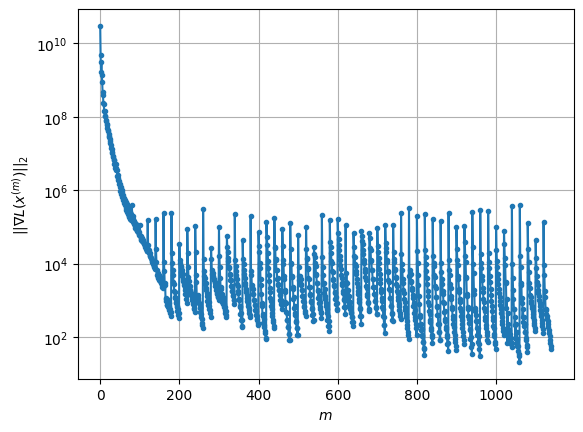

Windows:  19%|█▉        | 57/296 [38:03<2:25:54, 36.63s/it]

Before applying the algorithm
Cost function: 454.2506802008257
Gradient norm: 83171.7325923106
Global relative error: 0.9114907166148127
Position relative errors: 0.013926257182701693 m, 0.19509841998515876 m, 0.2562559798909347 m, 0.8525785195878818 m

Iteration 1
Cost function: 454.0744723783087 (-0.04%)
Gradient norm: 16860.432944660486 (-79.73%)
Global relative error: 0.8167597801910254 (-10.39%)
Position relative errors: 0.02238986371337509 m, 0.2697813160971384 m, 0.25044932726224056 m, 0.7287576843545722 m

Iteration 2
Cost function: 454.0471883082894 (-0.01%)
Gradient norm: 8639.5558965389 (-48.76%)
Global relative error: 0.8597093544895191 (5.26%)
Position relative errors: 0.022142505794107183 m, 0.276951908296528 m, 0.2684146469960952 m, 0.7680236879259739 m

Iteration 3
Cost function: 454.03684665507495 (-0.00%)
Gradient norm: 5124.2365337980955 (-40.69%)
Global relative error: 0.8381129056736696 (-2.51%)
Position relative errors: 0.022113023625577884 m, 0.29776057250018473 

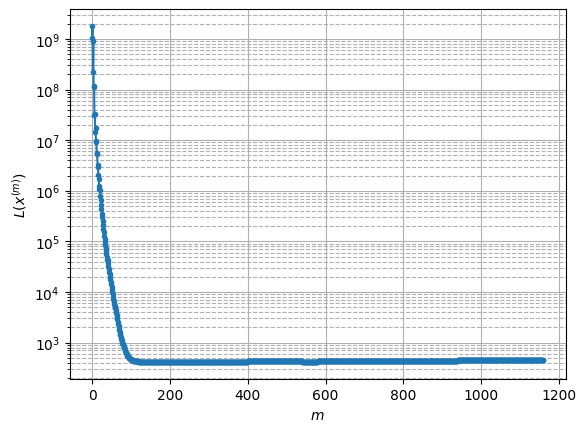

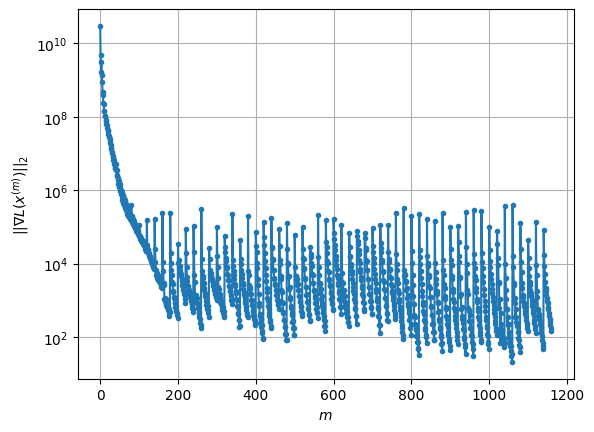

Windows:  20%|█▉        | 58/296 [38:41<2:27:08, 37.10s/it]

Before applying the algorithm
Cost function: 450.8848773682693
Gradient norm: 132029.2675264466
Global relative error: 0.8443956402840471
Position relative errors: 0.02109780590544924 m, 0.35836288710500486 m, 0.29169895001752455 m, 0.7064318362091627 m

Iteration 1
Cost function: 450.4738798813652 (-0.09%)
Gradient norm: 18051.737832284784 (-86.33%)
Global relative error: 0.8019364573753788 (-5.03%)
Position relative errors: 0.03276992704603929 m, 0.4288310458849849 m, 0.37644413768026525 m, 0.5625134336055874 m

Iteration 2
Cost function: 450.42732457254857 (-0.01%)
Gradient norm: 9090.142081668677 (-49.64%)
Global relative error: 0.7192156622129042 (-10.32%)
Position relative errors: 0.032456422659362584 m, 0.3309089402120583 m, 0.3654146196282693 m, 0.5226744686236219 m

Iteration 3
Cost function: 450.4117318590694 (-0.00%)
Gradient norm: 4739.835083588174 (-47.86%)
Global relative error: 0.7681415204521579 (6.80%)
Position relative errors: 0.03249302035919208 m, 0.3775356148893304

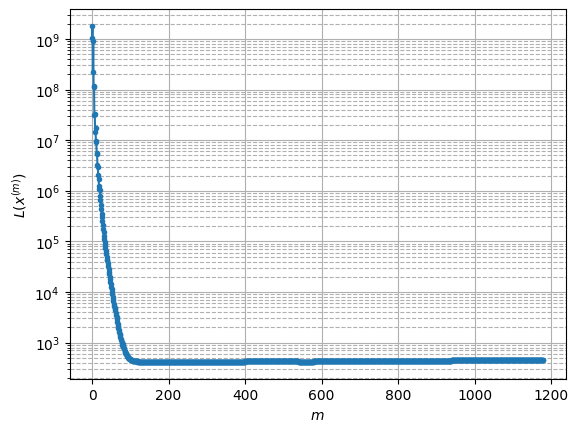

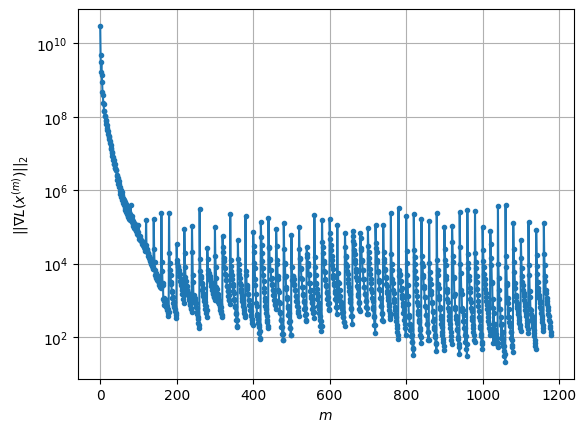

Windows:  20%|█▉        | 59/296 [39:20<2:28:05, 37.49s/it]

Before applying the algorithm
Cost function: 450.5272367146227
Gradient norm: 124365.42864183802
Global relative error: 0.7469638040824573
Position relative errors: 0.03082783368127026 m, 0.3639258901057969 m, 0.39003619450296045 m, 0.5219518433455952 m

Iteration 1
Cost function: 450.4728494106424 (-0.01%)
Gradient norm: 4819.269189983629 (-96.12%)
Global relative error: 0.736224874133414 (-1.44%)
Position relative errors: 0.029843148200643113 m, 0.3977303487758959 m, 0.386169250978114 m, 0.4835491779074568 m

Iteration 2
Cost function: 450.4669528070105 (-0.00%)
Gradient norm: 2371.7739252703536 (-50.79%)
Global relative error: 0.7525289997592807 (2.21%)
Position relative errors: 0.029731715466392264 m, 0.3757137051184462 m, 0.39372171785712146 m, 0.518881293943389 m

Iteration 3
Cost function: 450.4647310761811 (-0.00%)
Gradient norm: 1086.1032202232843 (-54.21%)
Global relative error: 0.7524571685403115 (-0.01%)
Position relative errors: 0.029675039656556053 m, 0.37241211796123225 

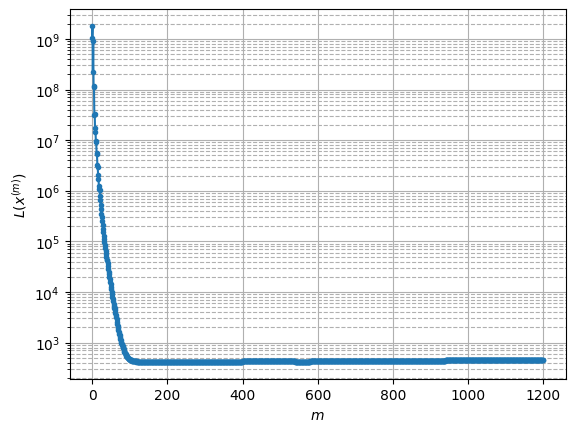

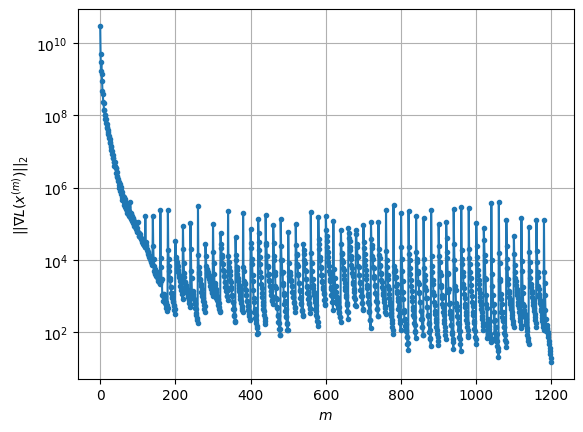

Windows:  20%|██        | 60/296 [39:58<2:28:18, 37.70s/it]

Before applying the algorithm
Cost function: 450.8139917785168
Gradient norm: 131120.1609074218
Global relative error: 0.7550870262139516
Position relative errors: 0.028357061880803794 m, 0.346005787799486 m, 0.4001274452843016 m, 0.5380797151885436 m

Iteration 1
Cost function: 450.5571870695653 (-0.06%)
Gradient norm: 32042.788918774633 (-75.56%)
Global relative error: 0.8013348825616323 (6.12%)
Position relative errors: 0.029906476820111192 m, 0.4056446890475741 m, 0.37620757777227476 m, 0.5789325499471871 m

Iteration 2
Cost function: 450.46708107067315 (-0.02%)
Gradient norm: 12608.69729239058 (-60.65%)
Global relative error: 0.7170783516476693 (-10.51%)
Position relative errors: 0.030317060631566372 m, 0.3613670289884761 m, 0.3378307642505933 m, 0.5182335637622096 m

Iteration 3
Cost function: 450.42651455416444 (-0.01%)
Gradient norm: 8772.579664621844 (-30.42%)
Global relative error: 0.7380352232300993 (2.92%)
Position relative errors: 0.03060988022881256 m, 0.3777993977889542 

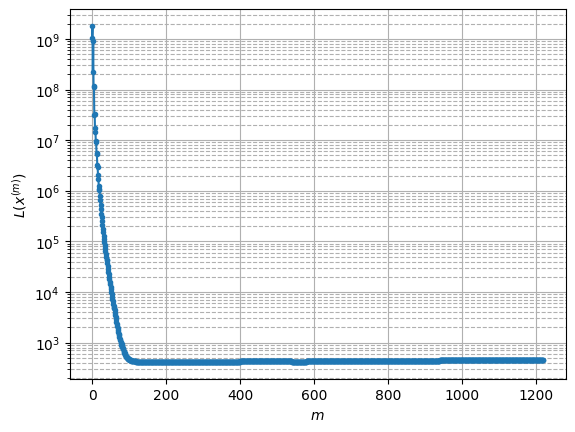

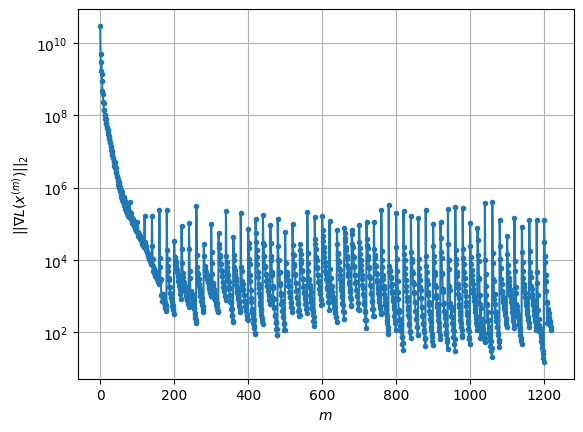

Windows:  21%|██        | 61/296 [40:39<2:31:36, 38.71s/it]

Before applying the algorithm
Cost function: 448.01521721530696
Gradient norm: 63999.7563960114
Global relative error: 0.6949995906773642
Position relative errors: 0.030126717761743582 m, 0.36087024352891084 m, 0.2739480267282917 m, 0.5261573303415522 m

Iteration 1
Cost function: 447.22327633008484 (-0.18%)
Gradient norm: 33158.58868049866 (-48.19%)
Global relative error: 0.7583369605406163 (9.11%)
Position relative errors: 0.04222386362921187 m, 0.39850346863186487 m, 0.43064023664486106 m, 0.4785763445074924 m

Iteration 2
Cost function: 447.124091224318 (-0.02%)
Gradient norm: 18727.491739330864 (-43.52%)
Global relative error: 0.5731567835064418 (-24.42%)
Position relative errors: 0.04253900450322274 m, 0.27120694114799854 m, 0.36691531676624756 m, 0.34426498219436424 m

Iteration 3
Cost function: 447.0915537714347 (-0.01%)
Gradient norm: 7360.392798519942 (-60.70%)
Global relative error: 0.6659337793388027 (16.19%)
Position relative errors: 0.04259546699298575 m, 0.34739396245231

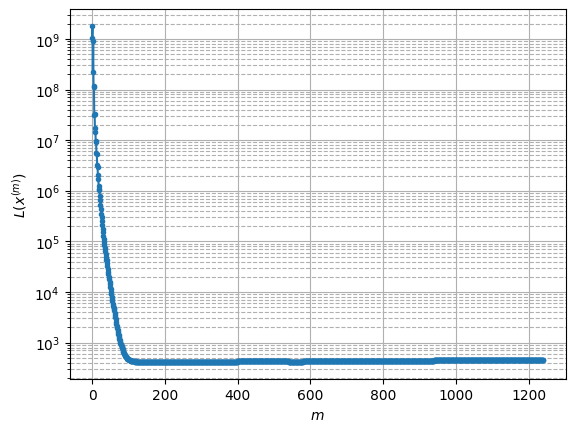

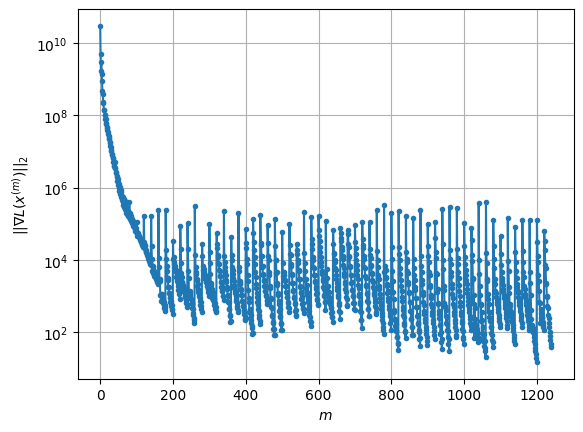

Windows:  21%|██        | 62/296 [41:16<2:29:32, 38.35s/it]

Before applying the algorithm
Cost function: 448.7771412589532
Gradient norm: 308117.37862684013
Global relative error: 0.5990344157898445
Position relative errors: 0.04119914958424041 m, 0.3276560414379087 m, 0.3591061299601261 m, 0.3476038014605116 m

Iteration 1
Cost function: 448.5353424728648 (-0.05%)
Gradient norm: 8895.778524146246 (-97.11%)
Global relative error: 0.5938533763433703 (-0.86%)
Position relative errors: 0.04494051078480075 m, 0.38052885473954007 m, 0.33593062289453773 m, 0.304942686522928 m

Iteration 2
Cost function: 448.520150550164 (-0.00%)
Gradient norm: 4240.09686192024 (-52.34%)
Global relative error: 0.6346451219800403 (6.87%)
Position relative errors: 0.04497314427436359 m, 0.38869455114059626 m, 0.3345644413159571 m, 0.37112592085046336 m

Iteration 3
Cost function: 448.51558894829697 (-0.00%)
Gradient norm: 1113.1460170817584 (-73.75%)
Global relative error: 0.6144949973026265 (-3.18%)
Position relative errors: 0.04487565285083223 m, 0.3850451826054956 m,

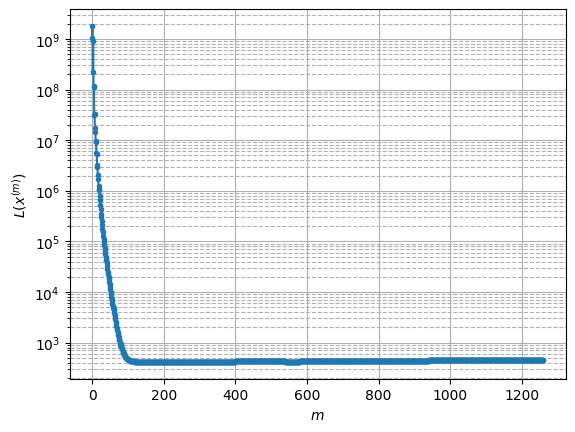

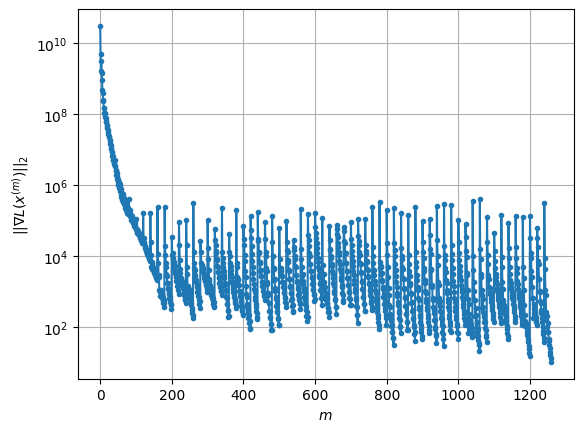

Windows:  21%|██▏       | 63/296 [41:54<2:28:10, 38.15s/it]

Before applying the algorithm
Cost function: 447.5431740887125
Gradient norm: 35787.396556319494
Global relative error: 0.6049903212352492
Position relative errors: 0.043013907124584444 m, 0.3849228539970806 m, 0.339281693514834 m, 0.31762374065231186 m

Iteration 1
Cost function: 447.28825353669566 (-0.06%)
Gradient norm: 11615.657583922843 (-67.54%)
Global relative error: 0.5135794559559967 (-15.11%)
Position relative errors: 0.0423447733124548 m, 0.37844367549366004 m, 0.2984190429638561 m, 0.17232748594954847 m

Iteration 2
Cost function: 447.2064854681751 (-0.02%)
Gradient norm: 9735.783155231975 (-16.18%)
Global relative error: 0.5667641008912112 (10.36%)
Position relative errors: 0.0427499207027623 m, 0.4167713754003843 m, 0.27315817541056153 m, 0.26660777403424885 m

Iteration 3
Cost function: 447.16800097271016 (-0.01%)
Gradient norm: 4458.251553457555 (-54.21%)
Global relative error: 0.5485023737088892 (-3.22%)
Position relative errors: 0.042946902706812166 m, 0.4197028112273

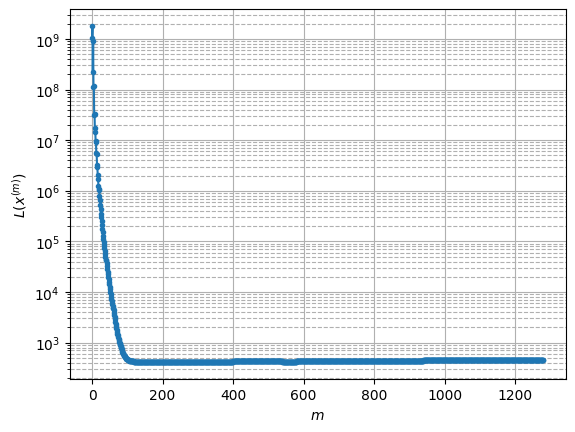

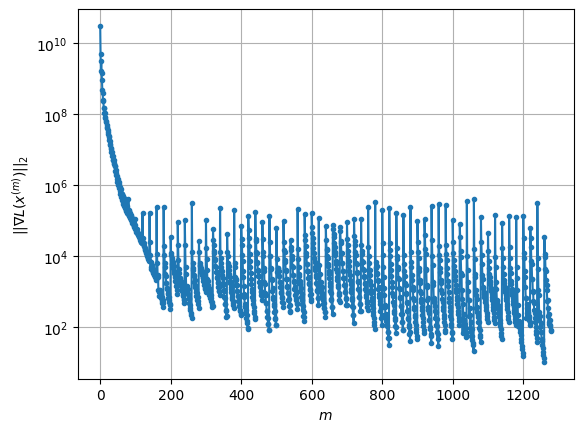

Windows:  22%|██▏       | 64/296 [42:32<2:26:52, 37.99s/it]

Before applying the algorithm
Cost function: 443.2468969770475
Gradient norm: 46188.10427385659
Global relative error: 0.5750239241662917
Position relative errors: 0.04197480764454625 m, 0.44535922478877926 m, 0.25886247537415763 m, 0.25206246506286506 m

Iteration 1
Cost function: 443.158427848894 (-0.02%)
Gradient norm: 7192.443449418635 (-84.43%)
Global relative error: 0.5963372613492994 (3.71%)
Position relative errors: 0.04178677685391289 m, 0.4684691073158663 m, 0.29899914593006427 m, 0.21215000713048 m

Iteration 2
Cost function: 443.1512699958706 (-0.00%)
Gradient norm: 3547.272126589556 (-50.68%)
Global relative error: 0.5825888292983731 (-2.31%)
Position relative errors: 0.041710472911582856 m, 0.4580601851037683 m, 0.29118814691812817 m, 0.20750844601391946 m

Iteration 3
Cost function: 443.1489774006132 (-0.00%)
Gradient norm: 2471.0635684146714 (-30.34%)
Global relative error: 0.5873538607356851 (0.82%)
Position relative errors: 0.041703625920720674 m, 0.46332671572039397 

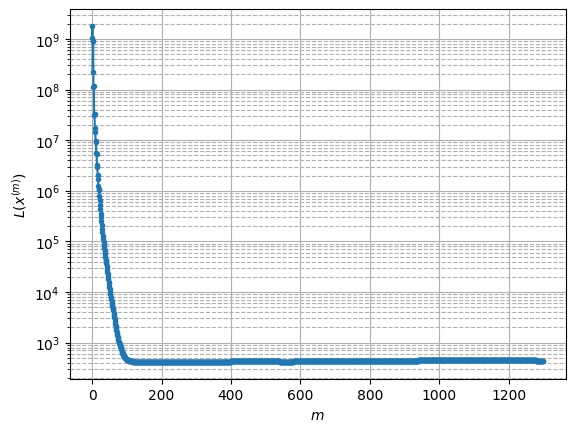

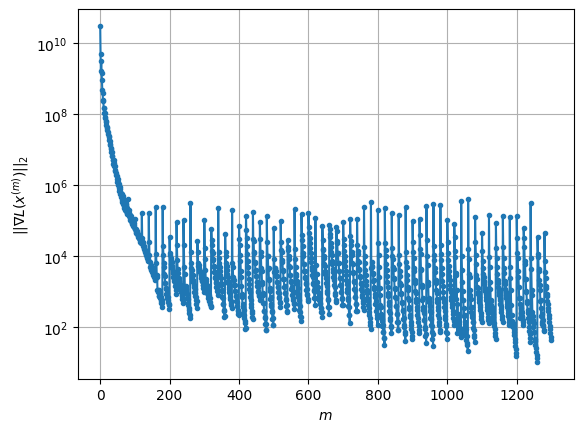

Windows:  22%|██▏       | 65/296 [43:09<2:25:51, 37.88s/it]

Before applying the algorithm
Cost function: 442.46936266437194
Gradient norm: 341976.6302272817
Global relative error: 0.5730064024006155
Position relative errors: 0.040224164345720584 m, 0.4521933661120561 m, 0.30687253644419954 m, 0.16753559189083903 m

Iteration 1
Cost function: 441.96744155300394 (-0.11%)
Gradient norm: 11747.945889540917 (-96.56%)
Global relative error: 0.6036638345060937 (5.35%)
Position relative errors: 0.03160084362183783 m, 0.44362790878109964 m, 0.3982024778157811 m, 0.08966665618789946 m

Iteration 2
Cost function: 441.9289931293859 (-0.01%)
Gradient norm: 5927.543415528231 (-49.54%)
Global relative error: 0.5927501798958401 (-1.81%)
Position relative errors: 0.03165946927173945 m, 0.4407087506030209 m, 0.3691654013463822 m, 0.14086416477166208 m

Iteration 3
Cost function: 441.9169942542632 (-0.00%)
Gradient norm: 2418.5274795551295 (-59.20%)
Global relative error: 0.5914702476233857 (-0.22%)
Position relative errors: 0.031573964882444724 m, 0.431104628639

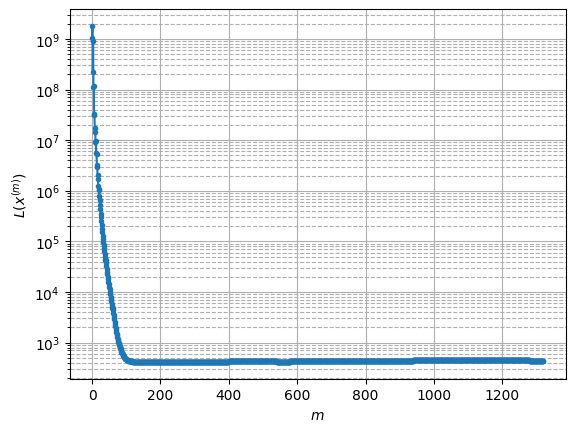

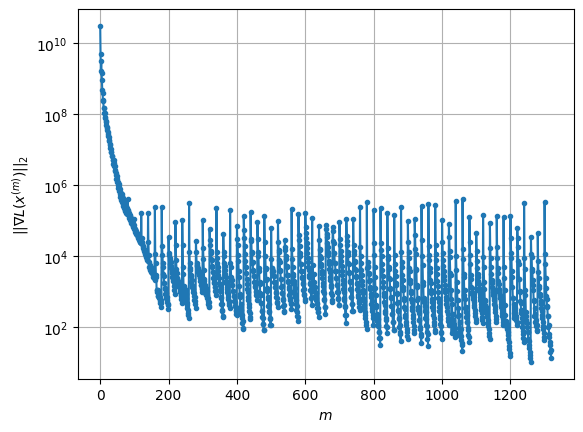

Windows:  22%|██▏       | 66/296 [43:48<2:25:53, 38.06s/it]

Before applying the algorithm
Cost function: 440.54204237675026
Gradient norm: 166369.6484269633
Global relative error: 0.5847747409938019
Position relative errors: 0.03126394104698676 m, 0.4064175273284338 m, 0.40389650693462575 m, 0.1125879589375165 m

Iteration 1
Cost function: 440.19032897045804 (-0.08%)
Gradient norm: 20721.445989216056 (-87.54%)
Global relative error: 0.5018306128044198 (-14.18%)
Position relative errors: 0.032038715861841975 m, 0.3279568866619924 m, 0.35975274050088857 m, 0.11759833081073645 m

Iteration 2
Cost function: 440.09346235762314 (-0.02%)
Gradient norm: 10197.276559006077 (-50.79%)
Global relative error: 0.5897705411672701 (17.52%)
Position relative errors: 0.03220095831490205 m, 0.41007562826367294 m, 0.38686445647165707 m, 0.17019362355733633 m

Iteration 3
Cost function: 440.0498950655943 (-0.01%)
Gradient norm: 7492.933482092531 (-26.52%)
Global relative error: 0.5811092506449389 (-1.47%)
Position relative errors: 0.032445625597638396 m, 0.39206884

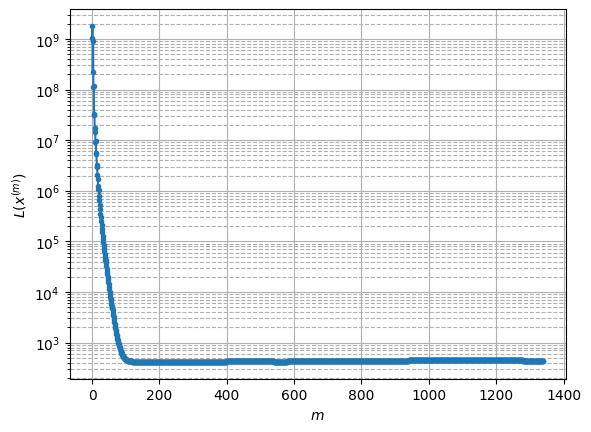

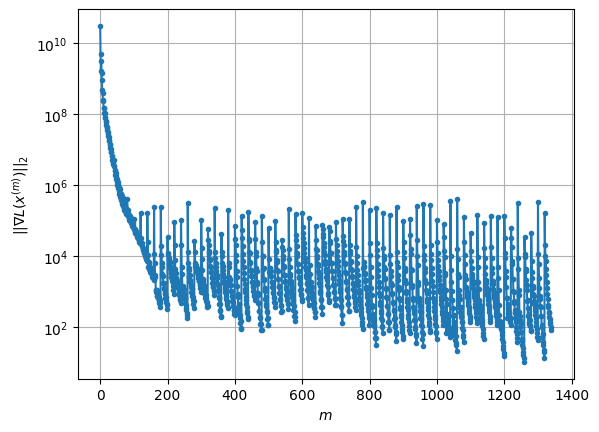

Windows:  23%|██▎       | 67/296 [44:26<2:25:04, 38.01s/it]

Before applying the algorithm
Cost function: 438.78981333899617
Gradient norm: 94029.31216796566
Global relative error: 0.6395280393626791
Position relative errors: 0.03232704301433074 m, 0.40439492280264067 m, 0.447791565840601 m, 0.2095186172594195 m

Iteration 1
Cost function: 438.5505734732853 (-0.05%)
Gradient norm: 15244.03570359422 (-83.79%)
Global relative error: 0.6846170206440112 (7.05%)
Position relative errors: 0.03428852782477717 m, 0.4156607056304348 m, 0.4784395125794331 m, 0.25660511062886593 m

Iteration 2
Cost function: 438.5068162422573 (-0.01%)
Gradient norm: 7393.439155858648 (-51.50%)
Global relative error: 0.6698883632180038 (-2.15%)
Position relative errors: 0.034218769849251214 m, 0.3885034400448009 m, 0.46016083827667437 m, 0.2913694517796604 m

Iteration 3
Cost function: 438.49292943824815 (-0.00%)
Gradient norm: 4360.474542163828 (-41.02%)
Global relative error: 0.6720562678585297 (0.32%)
Position relative errors: 0.03412167323593572 m, 0.3833298118473815 m,

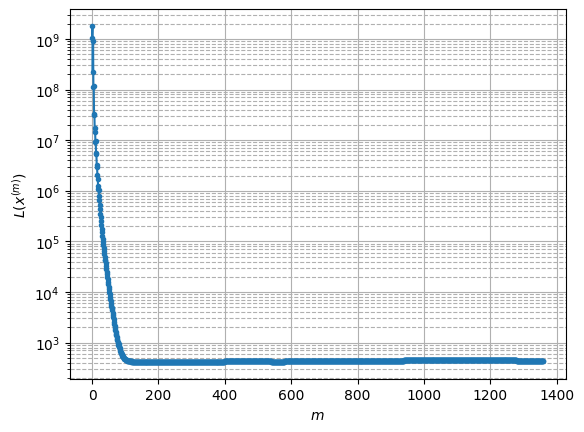

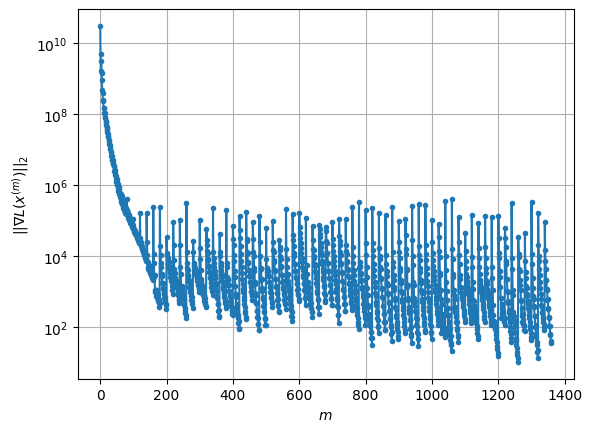

Windows:  23%|██▎       | 68/296 [45:07<2:27:58, 38.94s/it]

Before applying the algorithm
Cost function: 439.04913644332663
Gradient norm: 48482.71033954536
Global relative error: 0.6747598961843682
Position relative errors: 0.03343925242381161 m, 0.33886529488551836 m, 0.4955806771234777 m, 0.3061901667570429 m

Iteration 1
Cost function: 438.859649617897 (-0.04%)
Gradient norm: 5659.88624732354 (-88.33%)
Global relative error: 0.6735182350506745 (-0.18%)
Position relative errors: 0.03527064750048225 m, 0.3067279203977757 m, 0.5129847268138998 m, 0.30845909287067286 m

Iteration 2
Cost function: 438.83535183367167 (-0.01%)
Gradient norm: 5540.612784920399 (-2.11%)
Global relative error: 0.7078977647898871 (5.10%)
Position relative errors: 0.03536995607933383 m, 0.3277696720171946 m, 0.5398782909570743 m, 0.3177519084397559 m

Iteration 3
Cost function: 438.8241671923233 (-0.00%)
Gradient norm: 2721.418256588251 (-50.88%)
Global relative error: 0.7203221435971856 (1.76%)
Position relative errors: 0.03549229596052417 m, 0.32397708694833083 m, 0.

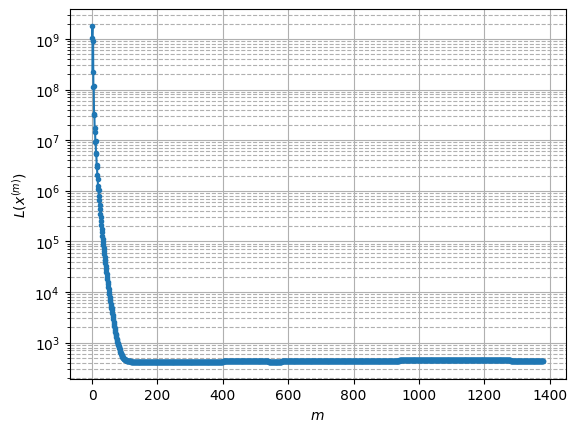

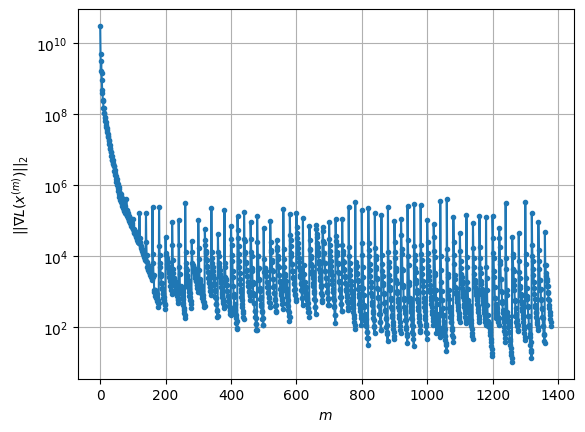

Windows:  23%|██▎       | 69/296 [45:45<2:26:44, 38.79s/it]

Before applying the algorithm
Cost function: 439.6813766948478
Gradient norm: 327869.6149228686
Global relative error: 0.7814387733565226
Position relative errors: 0.034543185867119755 m, 0.31595157667966584 m, 0.6005242406339281 m, 0.38600278046925 m

Iteration 1
Cost function: 438.47647011208693 (-0.27%)
Gradient norm: 28547.023757800103 (-91.29%)
Global relative error: 0.9962826890186575 (27.49%)
Position relative errors: 0.023922353162388547 m, 0.3307577004286821 m, 0.835531184876039 m, 0.42952676604125545 m

Iteration 2
Cost function: 438.337560768025 (-0.03%)
Gradient norm: 9984.727502116284 (-65.02%)
Global relative error: 0.9366638534336166 (-5.98%)
Position relative errors: 0.023906140722681327 m, 0.2957655534047128 m, 0.7350766527446793 m, 0.4989509862907867 m

Iteration 3
Cost function: 438.29192494591797 (-0.01%)
Gradient norm: 4698.031654542777 (-52.95%)
Global relative error: 0.9490155766996192 (1.32%)
Position relative errors: 0.023908004520947584 m, 0.3052755015776752 m

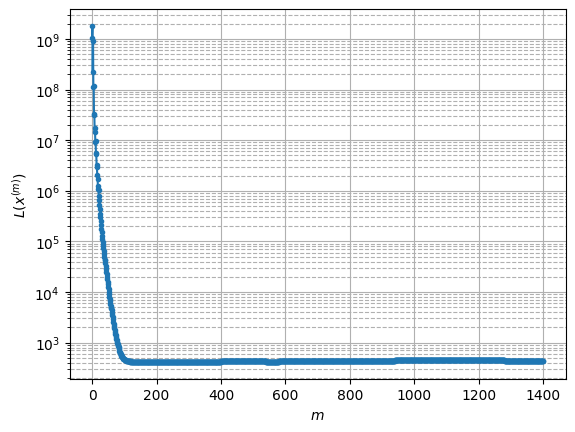

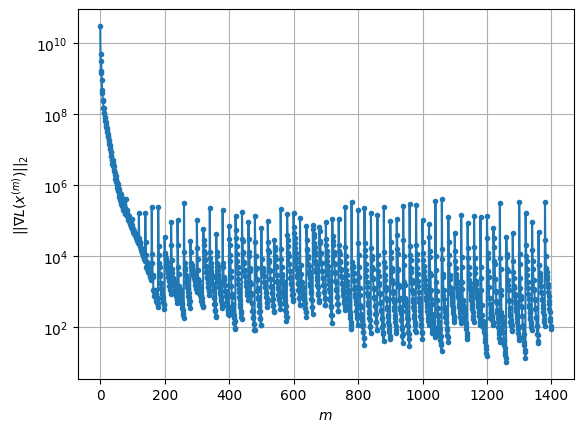

Windows:  24%|██▎       | 70/296 [46:24<2:25:49, 38.71s/it]

Before applying the algorithm
Cost function: 439.11378624563105
Gradient norm: 145175.74307358524
Global relative error: 0.9312582407788208
Position relative errors: 0.02381208766888644 m, 0.27120109044182716 m, 0.7486227854855588 m, 0.4823772337650954 m

Iteration 1
Cost function: 438.8639663013605 (-0.06%)
Gradient norm: 18660.716925844656 (-87.15%)
Global relative error: 0.8541721213911883 (-8.28%)
Position relative errors: 0.026931852138153453 m, 0.2545719988799833 m, 0.7312037928834465 m, 0.3597469908500425 m

Iteration 2
Cost function: 438.8379810800613 (-0.01%)
Gradient norm: 8671.462783613222 (-53.53%)
Global relative error: 0.8602189804315021 (0.71%)
Position relative errors: 0.026966567767052058 m, 0.26182237705845607 m, 0.7423346960787811 m, 0.3458856809373802 m

Iteration 3
Cost function: 438.83116310059523 (-0.00%)
Gradient norm: 3253.5700301358725 (-62.48%)
Global relative error: 0.8555025666480213 (-0.55%)
Position relative errors: 0.02696890349257125 m, 0.26502132840727

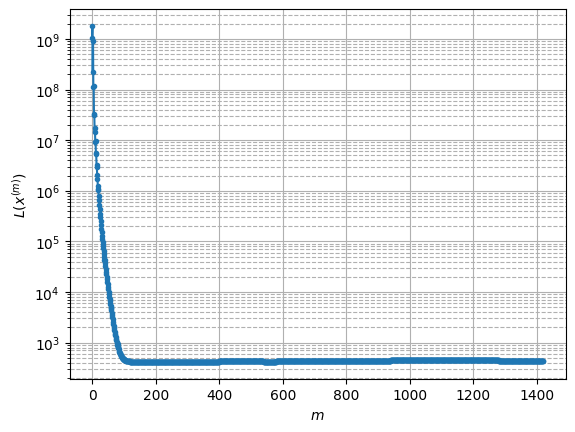

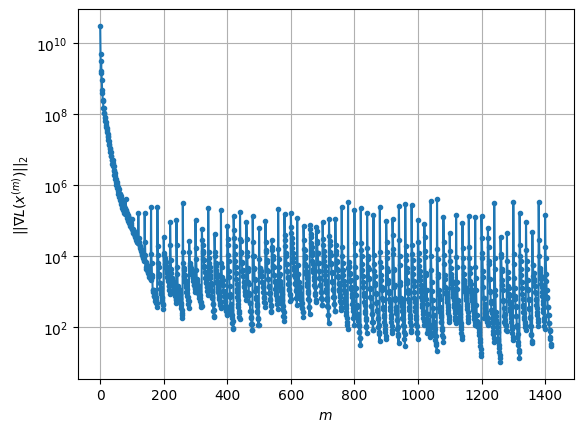

Windows:  24%|██▍       | 71/296 [47:02<2:24:36, 38.56s/it]

Before applying the algorithm
Cost function: 439.5663019255527
Gradient norm: 23205.451306607636
Global relative error: 0.8452349814352451
Position relative errors: 0.026935212403742095 m, 0.24248495889144114 m, 0.731349860427349 m, 0.3464453147310636 m

Iteration 1
Cost function: 439.44216706639645 (-0.03%)
Gradient norm: 8913.186709361898 (-61.59%)
Global relative error: 0.8852766200970056 (4.74%)
Position relative errors: 0.029108680695113458 m, 0.2502967554946964 m, 0.7755860883972029 m, 0.34450581718515105 m

Iteration 2
Cost function: 439.42544889187013 (-0.00%)
Gradient norm: 5022.250909621531 (-43.65%)
Global relative error: 0.8682446200952041 (-1.92%)
Position relative errors: 0.029090823644486914 m, 0.23196503777537575 m, 0.7556931306438256 m, 0.35794084915386637 m

Iteration 3
Cost function: 439.41992157989733 (-0.00%)
Gradient norm: 4249.953146365906 (-15.38%)
Global relative error: 0.8778487587594627 (1.11%)
Position relative errors: 0.029089746981597334 m, 0.2345851443306

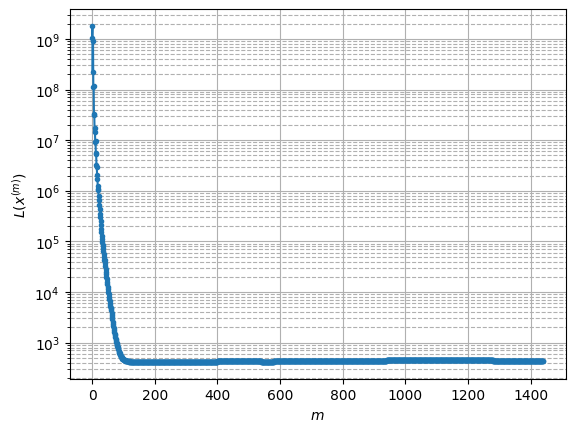

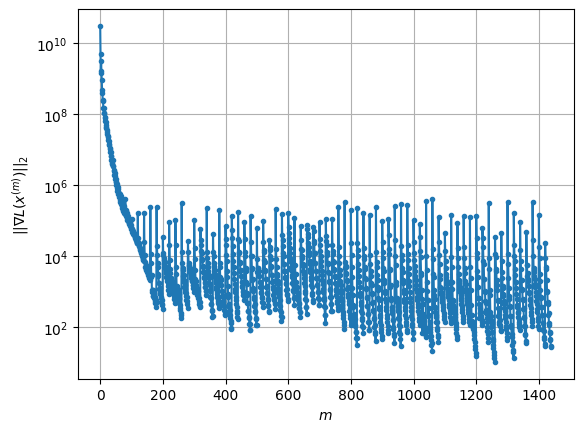

Windows:  24%|██▍       | 72/296 [47:40<2:23:43, 38.50s/it]

Before applying the algorithm
Cost function: 440.44629288228066
Gradient norm: 88251.8017203975
Global relative error: 0.8897849439027421
Position relative errors: 0.028863289401219617 m, 0.20603008023669891 m, 0.7701491852384746 m, 0.39408750660717945 m

Iteration 1
Cost function: 439.96936174273276 (-0.11%)
Gradient norm: 32467.278251316457 (-63.21%)
Global relative error: 0.8101927379239082 (-8.95%)
Position relative errors: 0.03002860695612302 m, 0.1818456928335022 m, 0.726803825799153 m, 0.30691678703102787 m

Iteration 2
Cost function: 439.91371295600567 (-0.01%)
Gradient norm: 13954.61524202053 (-57.02%)
Global relative error: 0.8179455985047749 (0.96%)
Position relative errors: 0.030070105554602277 m, 0.18230600922534412 m, 0.7269522049753644 m, 0.32624356228272944 m

Iteration 3
Cost function: 439.896558368733 (-0.00%)
Gradient norm: 8003.613382794206 (-42.65%)
Global relative error: 0.8171155567332925 (-0.10%)
Position relative errors: 0.030064703358821568 m, 0.16086527478205

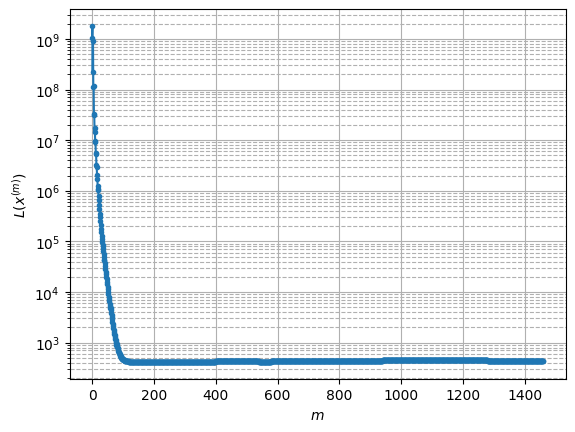

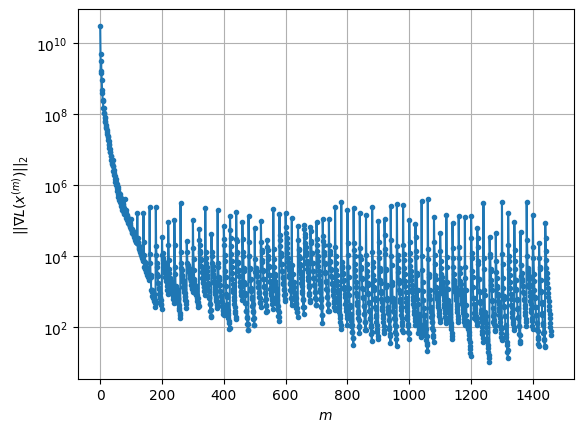

Windows:  25%|██▍       | 73/296 [48:19<2:23:50, 38.70s/it]

Before applying the algorithm
Cost function: 441.22620449498373
Gradient norm: 50137.92749239213
Global relative error: 0.8324466450003564
Position relative errors: 0.029822487750188607 m, 0.15659965707540638 m, 0.7342078061388755 m, 0.3584587597558545 m

Iteration 1
Cost function: 441.0130965061898 (-0.05%)
Gradient norm: 25095.007609678374 (-49.95%)
Global relative error: 0.8623582795287369 (3.59%)
Position relative errors: 0.030788723688017897 m, 0.2043038397864578 m, 0.8026034313284619 m, 0.23832903241477993 m

Iteration 2
Cost function: 440.9978562322829 (-0.00%)
Gradient norm: 12659.30022686225 (-49.55%)
Global relative error: 0.8535148962354876 (-1.03%)
Position relative errors: 0.030773148132763703 m, 0.19831940825373234 m, 0.7857329802635407 m, 0.26614469085168474 m

Iteration 3
Cost function: 440.99276306841944 (-0.00%)
Gradient norm: 8664.382944893718 (-31.56%)
Global relative error: 0.8735594798593597 (2.35%)
Position relative errors: 0.03078668760066123 m, 0.21294133705830

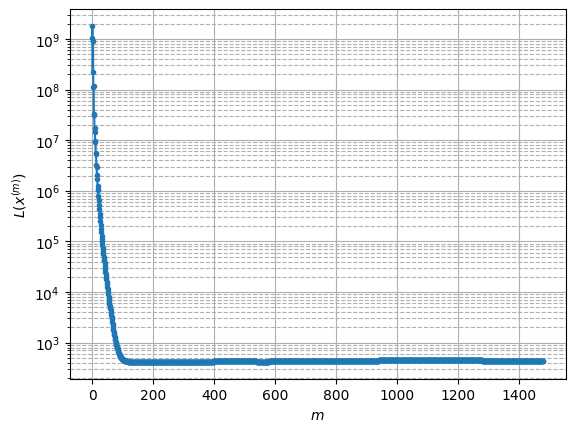

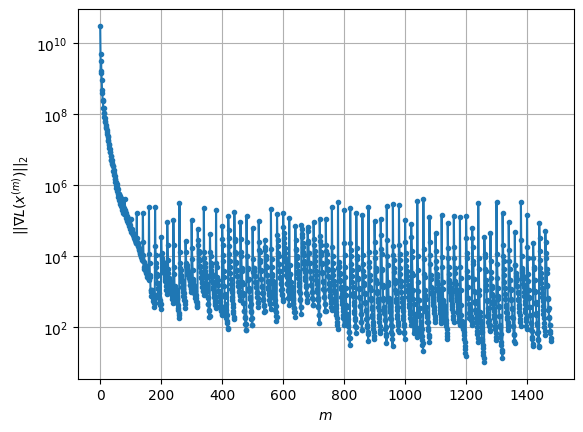

Windows:  25%|██▌       | 74/296 [48:58<2:22:50, 38.61s/it]

Before applying the algorithm
Cost function: 442.72608517777326
Gradient norm: 51333.91117684702
Global relative error: 0.9177975207986454
Position relative errors: 0.030268105239461354 m, 0.26138673902099785 m, 0.8267707975894087 m, 0.29926970786802276 m

Iteration 1
Cost function: 442.43335764483965 (-0.07%)
Gradient norm: 12561.371643077002 (-75.53%)
Global relative error: 1.0013594041857006 (9.10%)
Position relative errors: 0.031492428396210075 m, 0.31840443136064456 m, 0.8673277741208415 m, 0.3848238096070181 m

Iteration 2
Cost function: 442.39700241612996 (-0.01%)
Gradient norm: 6699.308701404049 (-46.67%)
Global relative error: 1.0143086956005352 (1.29%)
Position relative errors: 0.03159213321736782 m, 0.3341723942418388 m, 0.8677541777642769 m, 0.4039243476941001 m

Iteration 3
Cost function: 442.38558395767876 (-0.00%)
Gradient norm: 2602.122022489651 (-61.16%)
Global relative error: 1.0399401004234508 (2.53%)
Position relative errors: 0.03157516035195843 m, 0.329049427820649

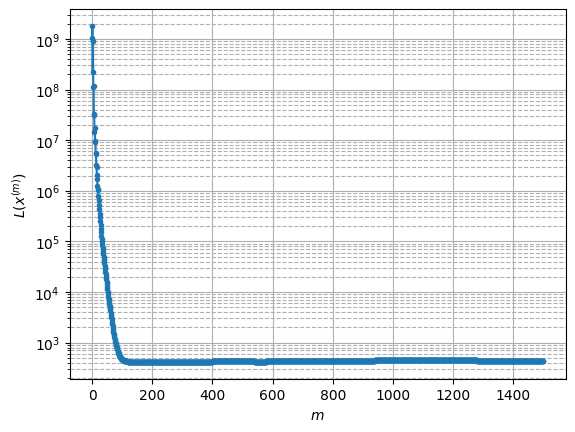

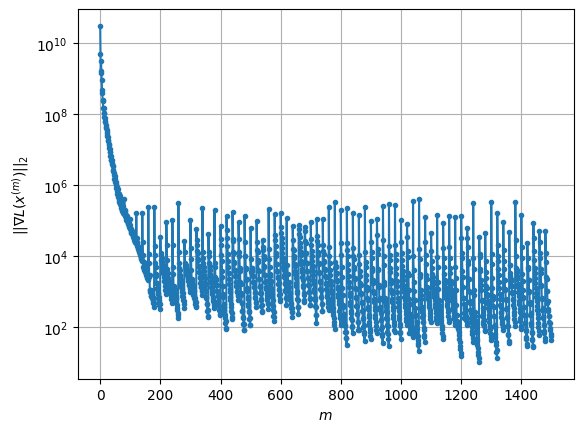

Windows:  25%|██▌       | 75/296 [49:39<2:25:07, 39.40s/it]

Before applying the algorithm
Cost function: 441.78915847760675
Gradient norm: 78702.3588049373
Global relative error: 1.111627959007112
Position relative errors: 0.03090923338129049 m, 0.38006607736690795 m, 0.9316604954594258 m, 0.4715073735001776 m

Iteration 1
Cost function: 441.5103671390053 (-0.06%)
Gradient norm: 11386.763294433273 (-85.53%)
Global relative error: 1.0862901835733019 (-2.28%)
Position relative errors: 0.021271680554769645 m, 0.41075443896392383 m, 0.8850661483096977 m, 0.4769821464742196 m

Iteration 2
Cost function: 441.4966851054964 (-0.00%)
Gradient norm: 5040.892016176139 (-55.73%)
Global relative error: 1.0922748991779068 (0.55%)
Position relative errors: 0.021264071221084018 m, 0.3987925234247198 m, 0.9014497603783255 m, 0.47006870456407146 m

Iteration 3
Cost function: 441.49389642173685 (-0.00%)
Gradient norm: 2179.532543693753 (-56.76%)
Global relative error: 1.0843539349740565 (-0.73%)
Position relative errors: 0.021262105864353908 m, 0.4016890196288674

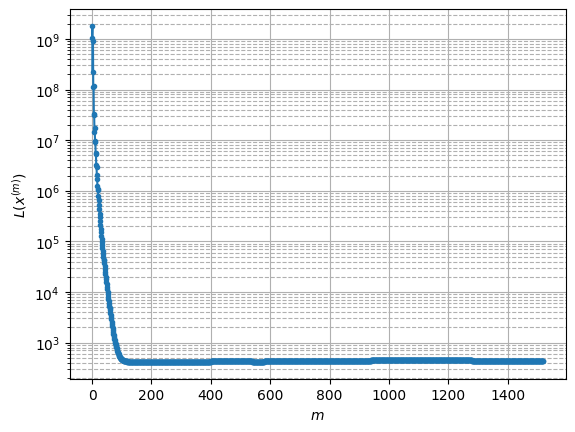

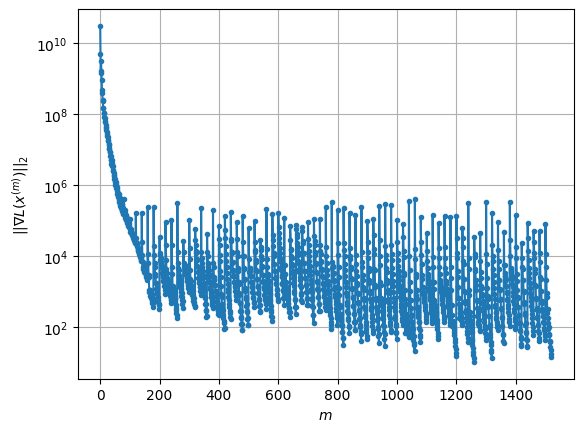

Windows:  26%|██▌       | 76/296 [50:17<2:22:42, 38.92s/it]

Before applying the algorithm
Cost function: 444.9336874824292
Gradient norm: 156318.7710042234
Global relative error: 1.087059999014537
Position relative errors: 0.02054048923143569 m, 0.4139781910415252 m, 0.892853648730625 m, 0.4612065815674045 m

Iteration 1
Cost function: 444.26536500360874 (-0.15%)
Gradient norm: 36311.35436258429 (-76.77%)
Global relative error: 1.1421218758040645 (5.07%)
Position relative errors: 0.01960619801746174 m, 0.4088168933313727 m, 0.9784161785860879 m, 0.4238252511993505 m

Iteration 2
Cost function: 444.0847266691155 (-0.04%)
Gradient norm: 22581.683805654517 (-37.81%)
Global relative error: 1.1619587547870764 (1.74%)
Position relative errors: 0.019490239967708052 m, 0.43388083759080953 m, 0.9684990959002192 m, 0.47278356938968086 m

Iteration 3
Cost function: 444.0113809002677 (-0.02%)
Gradient norm: 15428.896385139298 (-31.68%)
Global relative error: 1.2026175348967745 (3.50%)
Position relative errors: 0.01939050339504192 m, 0.44640117668825435 m, 

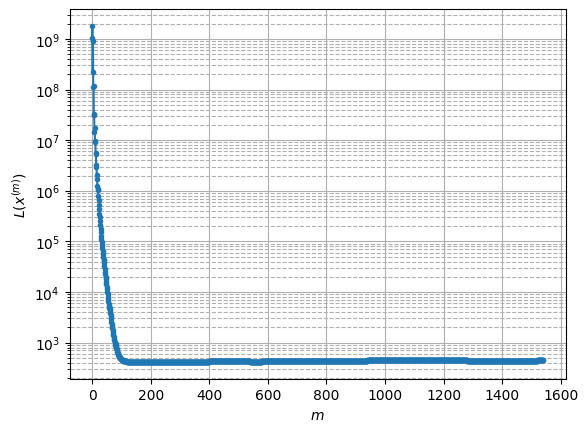

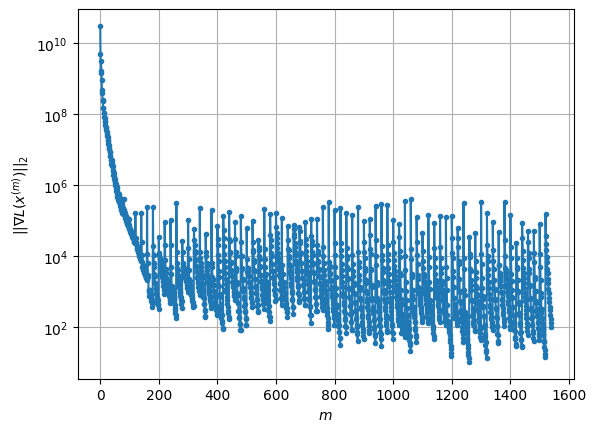

Windows:  26%|██▌       | 77/296 [50:55<2:21:10, 38.68s/it]

Before applying the algorithm
Cost function: 443.50651011358167
Gradient norm: 334043.0016246669
Global relative error: 1.3621856830916106
Position relative errors: 0.018294600091788092 m, 0.5801463023536072 m, 1.0745989098079587 m, 0.6032257208927279 m

Iteration 1
Cost function: 443.18209180886276 (-0.07%)
Gradient norm: 26200.864895400737 (-92.16%)
Global relative error: 1.35160781989119 (-0.78%)
Position relative errors: 0.025239674848251827 m, 0.5993152596410064 m, 1.1114540738477428 m, 0.48134866295441464 m

Iteration 2
Cost function: 443.15305662378273 (-0.01%)
Gradient norm: 12135.563854753338 (-53.68%)
Global relative error: 1.3388238758720163 (-0.95%)
Position relative errors: 0.02538930172437255 m, 0.602289166478238 m, 1.0916675332802868 m, 0.4871482301407894 m

Iteration 3
Cost function: 443.1424938329238 (-0.00%)
Gradient norm: 9030.467177821174 (-25.59%)
Global relative error: 1.3424962708898522 (0.27%)
Position relative errors: 0.02545868061572706 m, 0.6139165753942617 m

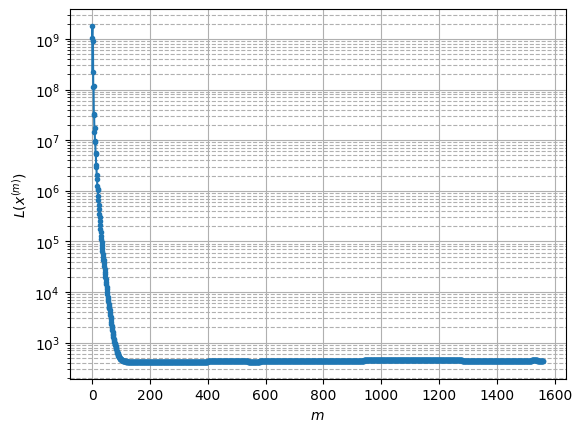

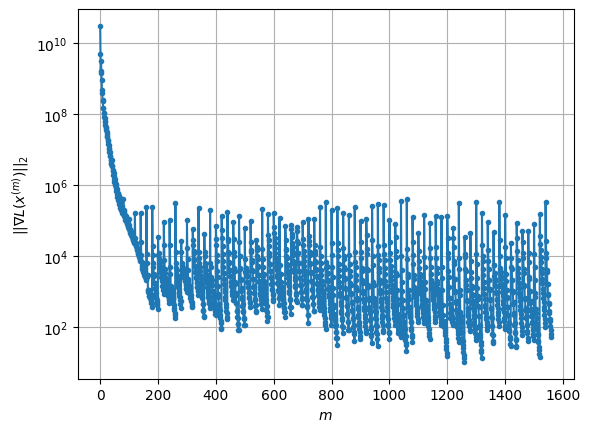

Windows:  26%|██▋       | 78/296 [51:33<2:19:37, 38.43s/it]

Before applying the algorithm
Cost function: 440.89792595557674
Gradient norm: 93876.8682648178
Global relative error: 1.3991015845381884
Position relative errors: 0.024664925393318535 m, 0.681474540061034 m, 1.1148229294823913 m, 0.49963813407790464 m

Iteration 1
Cost function: 440.6552889143787 (-0.06%)
Gradient norm: 4757.6564137332125 (-94.93%)
Global relative error: 1.4693135005995126 (5.02%)
Position relative errors: 0.031547675756284206 m, 0.6781922790231071 m, 1.1753219362745084 m, 0.5626362710484091 m

Iteration 2
Cost function: 440.61891198185185 (-0.01%)
Gradient norm: 9510.25115827091 (99.89%)
Global relative error: 1.513747136590708 (3.02%)
Position relative errors: 0.03151943718983339 m, 0.7305742603121341 m, 1.1766465828402701 m, 0.6100820296249336 m

Iteration 3
Cost function: 440.60346714727785 (-0.00%)
Gradient norm: 4323.26923231223 (-54.54%)
Global relative error: 1.5512103755779476 (2.47%)
Position relative errors: 0.03159616475484499 m, 0.7432361728650114 m, 1.20

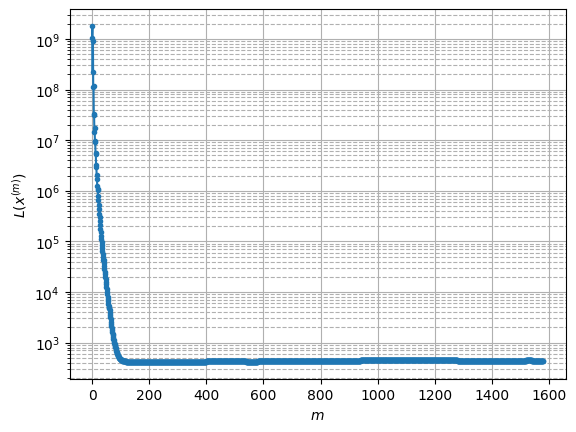

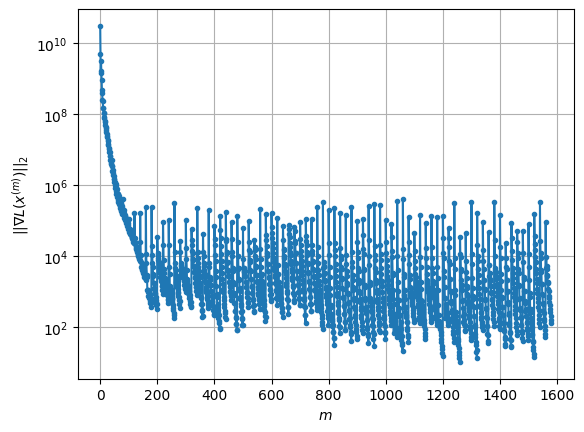

Windows:  27%|██▋       | 79/296 [52:11<2:18:39, 38.34s/it]

Before applying the algorithm
Cost function: 439.27319205577595
Gradient norm: 68840.3790788382
Global relative error: 1.7417830400091712
Position relative errors: 0.03054247486016221 m, 0.8955242530280638 m, 1.294839640994973 m, 0.744513983375388 m

Iteration 1
Cost function: 439.0321542407535 (-0.05%)
Gradient norm: 4752.417465618198 (-93.10%)
Global relative error: 1.7386337299695716 (-0.18%)
Position relative errors: 0.02286215805752351 m, 0.9351296504771963 m, 1.266981532061988 m, 0.7366233745078813 m

Iteration 2
Cost function: 439.02241800727694 (-0.00%)
Gradient norm: 2760.798011359513 (-41.91%)
Global relative error: 1.7371778042390316 (-0.08%)
Position relative errors: 0.02287270251311281 m, 0.9280504254462641 m, 1.2838028803068398 m, 0.7126256055361183 m

Iteration 3
Cost function: 439.02038833990696 (-0.00%)
Gradient norm: 1670.1603823797598 (-39.50%)
Global relative error: 1.735185942112093 (-0.11%)
Position relative errors: 0.02284645875518275 m, 0.9292526183089465 m, 1.2

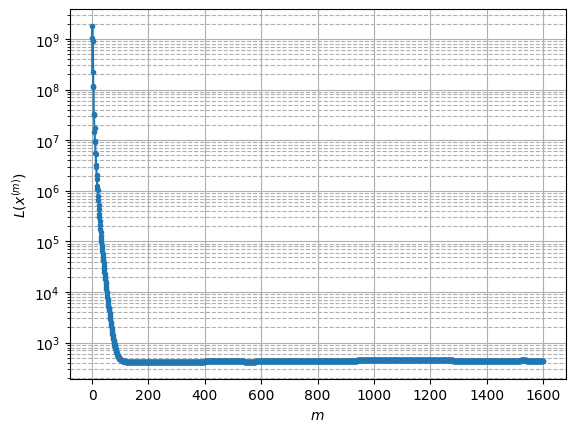

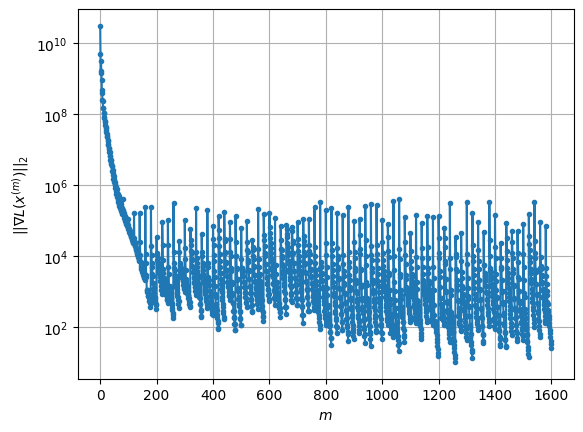

Windows:  27%|██▋       | 80/296 [52:50<2:18:36, 38.50s/it]

Before applying the algorithm
Cost function: 440.0166967956172
Gradient norm: 73800.80462780611
Global relative error: 1.7557460170773311
Position relative errors: 0.02199185000306235 m, 0.9640388241867363 m, 1.2804468268023896 m, 0.7164110459977326 m

Iteration 1
Cost function: 439.6629893953183 (-0.08%)
Gradient norm: 11249.94118912023 (-84.76%)
Global relative error: 1.745683458404518 (-0.57%)
Position relative errors: 0.022109309979456607 m, 0.9996147702909 m, 1.2501601656362995 m, 0.6962691348747889 m

Iteration 2
Cost function: 439.6153341989642 (-0.01%)
Gradient norm: 5084.5087921366185 (-54.80%)
Global relative error: 1.72698908135715 (-1.07%)
Position relative errors: 0.021998389093326323 m, 0.9498560443084629 m, 1.2495882752119294 m, 0.7199367942535079 m

Iteration 3
Cost function: 439.5987703989455 (-0.00%)
Gradient norm: 2112.0700913274422 (-58.46%)
Global relative error: 1.7135880903354328 (-0.78%)
Position relative errors: 0.021937189748194114 m, 0.9566376261831444 m, 1.2

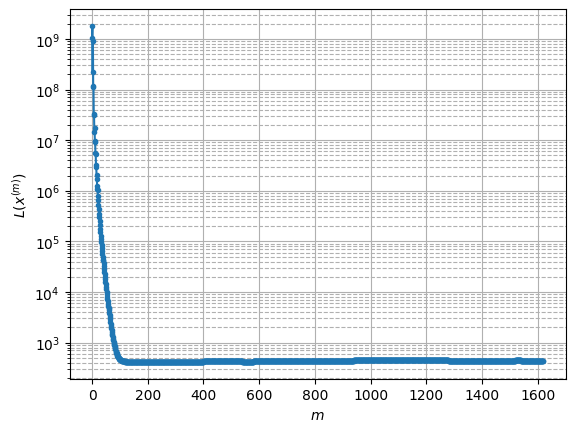

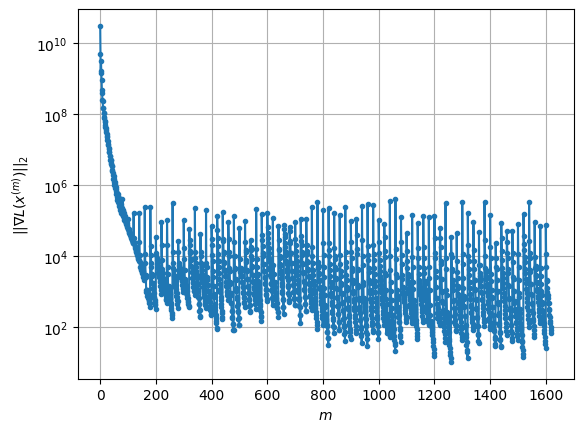

Windows:  27%|██▋       | 81/296 [53:31<2:21:09, 39.40s/it]

Before applying the algorithm
Cost function: 438.1086487662543
Gradient norm: 33700.23506165823
Global relative error: 1.6680242745276708
Position relative errors: 0.020916858487439856 m, 0.9482013910960746 m, 1.2067075501313982 m, 0.653175013422317 m

Iteration 1
Cost function: 437.7568249589063 (-0.08%)
Gradient norm: 22243.280564026027 (-34.00%)
Global relative error: 1.720531298896205 (3.15%)
Position relative errors: 0.024487854529598327 m, 0.9928442916603055 m, 1.3113037094425466 m, 0.5043512251684774 m

Iteration 2
Cost function: 437.71596162800125 (-0.01%)
Gradient norm: 10872.163459118656 (-51.12%)
Global relative error: 1.7300794022097783 (0.55%)
Position relative errors: 0.02459806341065 m, 1.0167902511736633 m, 1.2994652220723073 m, 0.5197081212462116 m

Iteration 3
Cost function: 437.7031583396755 (-0.00%)
Gradient norm: 8543.419653721632 (-21.42%)
Global relative error: 1.7589610493898427 (1.67%)
Position relative errors: 0.02463662204018694 m, 1.0364245229415547 m, 1.321

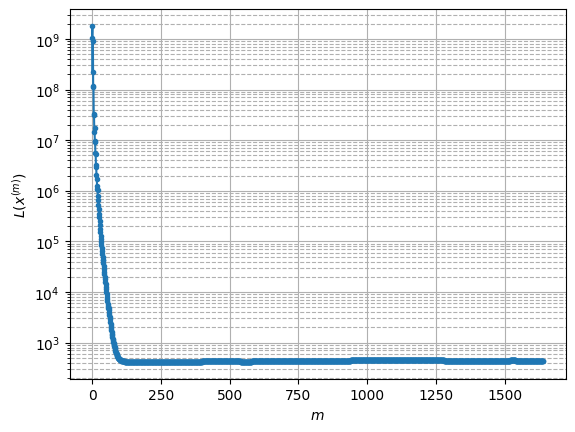

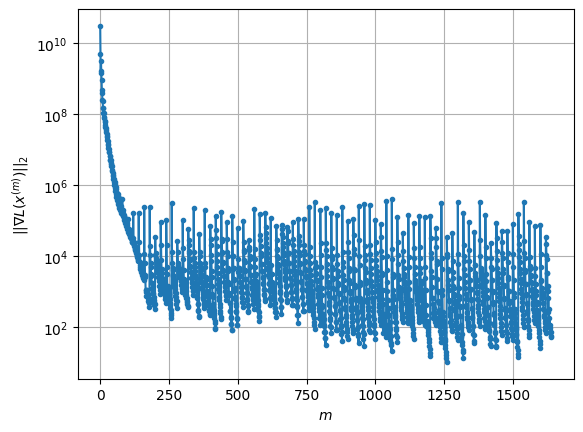

Windows:  28%|██▊       | 82/296 [54:10<2:20:08, 39.29s/it]

Before applying the algorithm
Cost function: 437.63470900259387
Gradient norm: 53717.12573534943
Global relative error: 1.888442563898568
Position relative errors: 0.023781050117730525 m, 1.155260952524226 m, 1.373106230334614 m, 0.5878778264500735 m

Iteration 1
Cost function: 437.28138207554946 (-0.08%)
Gradient norm: 25160.68181437273 (-53.16%)
Global relative error: 1.9054684231263668 (0.90%)
Position relative errors: 0.02083430145523645 m, 1.1832420309429874 m, 1.3398554399015203 m, 0.6596214718885475 m

Iteration 2
Cost function: 437.23594501496683 (-0.01%)
Gradient norm: 14859.820359947413 (-40.94%)
Global relative error: 1.9018908374428622 (-0.19%)
Position relative errors: 0.020856054296988058 m, 1.1868829679201987 m, 1.3486856767989177 m, 0.6237856928715402 m

Iteration 3
Cost function: 437.2248178773928 (-0.00%)
Gradient norm: 7480.011006264435 (-49.66%)
Global relative error: 1.891956411152472 (-0.52%)
Position relative errors: 0.02087025020315013 m, 1.1692948321858874 m, 1

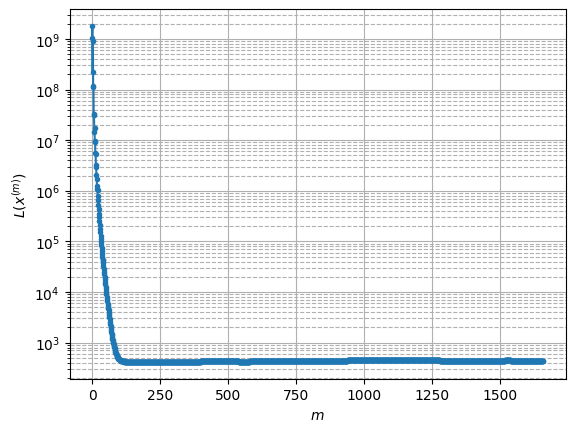

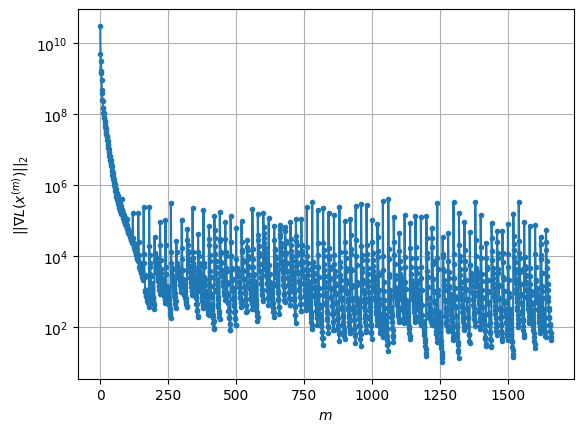

Windows:  28%|██▊       | 83/296 [54:48<2:18:07, 38.91s/it]

Before applying the algorithm
Cost function: 441.1102188966534
Gradient norm: 456394.3531350418
Global relative error: 1.8756260120238322
Position relative errors: 0.019947265906019626 m, 1.1979767748175907 m, 1.3133306647362513 m, 0.5979869880262852 m

Iteration 1
Cost function: 440.7235882371864 (-0.09%)
Gradient norm: 13623.17271715324 (-97.02%)
Global relative error: 1.9106874008277452 (1.87%)
Position relative errors: 0.01866026047975587 m, 1.3547746652342865 m, 1.265519929734109 m, 0.4619763218942735 m

Iteration 2
Cost function: 440.7016308274501 (-0.00%)
Gradient norm: 10289.617849444812 (-24.47%)
Global relative error: 1.9079475236784458 (-0.14%)
Position relative errors: 0.018611357622397382 m, 1.3019364341439388 m, 1.294619186638212 m, 0.5184970116785975 m

Iteration 3
Cost function: 440.69325933624395 (-0.00%)
Gradient norm: 6652.241723996887 (-35.35%)
Global relative error: 1.93298931003379 (1.31%)
Position relative errors: 0.01857056829172015 m, 1.3505787431494711 m, 1.28

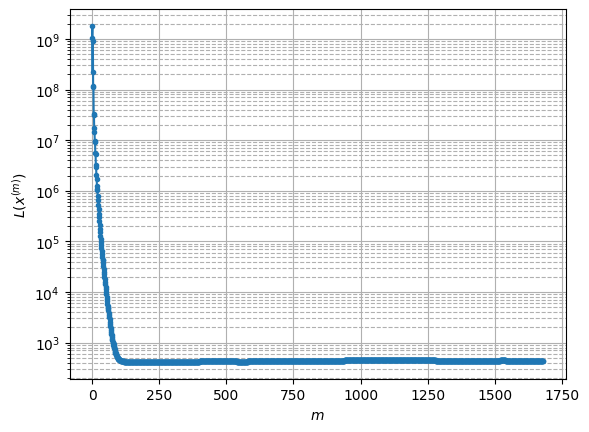

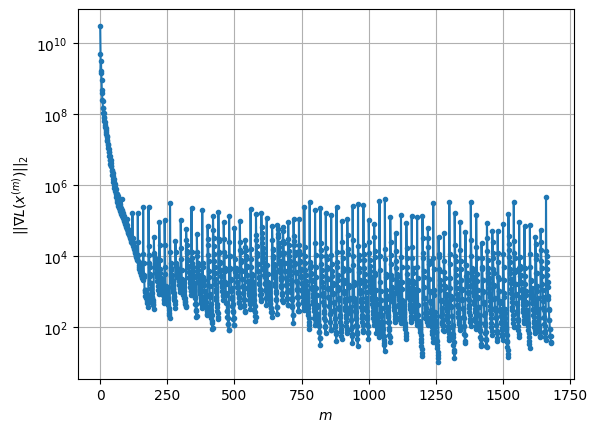

Windows:  28%|██▊       | 84/296 [55:26<2:16:40, 38.68s/it]

Before applying the algorithm
Cost function: 445.72732477547373
Gradient norm: 195562.12360334306
Global relative error: 2.0086745000011557
Position relative errors: 0.017946024745971026 m, 1.4258062346206035 m, 1.3035925065432472 m, 0.5497030901461236 m

Iteration 1
Cost function: 445.2601112244042 (-0.10%)
Gradient norm: 33034.667226143494 (-83.11%)
Global relative error: 2.036868442547329 (1.40%)
Position relative errors: 0.01970535164963444 m, 1.4546554373664593 m, 1.3515346268352155 m, 0.4536251916124722 m

Iteration 2
Cost function: 445.198152234237 (-0.01%)
Gradient norm: 15445.22062537309 (-53.25%)
Global relative error: 2.027944097728137 (-0.44%)
Position relative errors: 0.019908420067160433 m, 1.4326899641284974 m, 1.3588259938623075 m, 0.46168351776507405 m

Iteration 3
Cost function: 445.1804232181108 (-0.00%)
Gradient norm: 11189.423536701916 (-27.55%)
Global relative error: 2.0480184871242035 (0.99%)
Position relative errors: 0.020007091446948927 m, 1.4657090923587544 m,

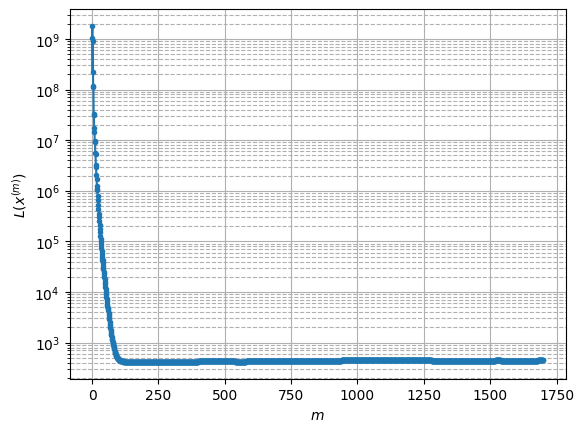

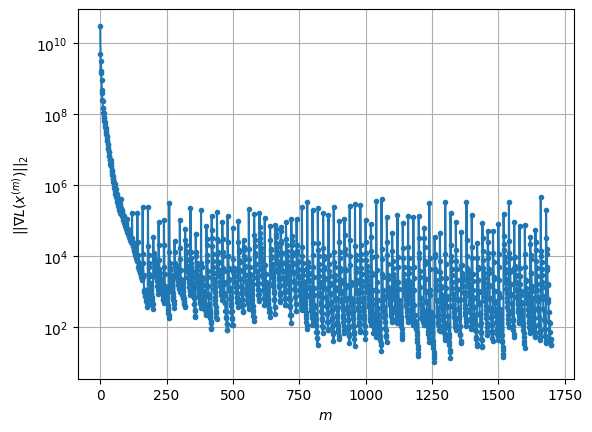

Windows:  29%|██▊       | 85/296 [56:05<2:15:52, 38.64s/it]

Before applying the algorithm
Cost function: 445.802383732243
Gradient norm: 37923.60962351343
Global relative error: 2.100760375214876
Position relative errors: 0.020051847764981073 m, 1.523870459205282 m, 1.364152368659743 m, 0.47926888455280175 m

Iteration 1
Cost function: 445.49082584235344 (-0.07%)
Gradient norm: 8815.0078624269 (-76.76%)
Global relative error: 2.1000714759792443 (-0.03%)
Position relative errors: 0.026435842253986964 m, 1.4154585273121556 m, 1.4731269554049702 m, 0.4857725659558829 m

Iteration 2
Cost function: 445.46940395744343 (-0.00%)
Gradient norm: 6006.651096576064 (-31.86%)
Global relative error: 2.1191297523922916 (0.91%)
Position relative errors: 0.026576280427506007 m, 1.4785452036040228 m, 1.4485060663036422 m, 0.4535839243584019 m

Iteration 3
Cost function: 445.4634570815208 (-0.00%)
Gradient norm: 3363.5140254817024 (-44.00%)
Global relative error: 2.121577200059835 (0.12%)
Position relative errors: 0.026702901095373717 m, 1.4579699773205188 m, 1.4

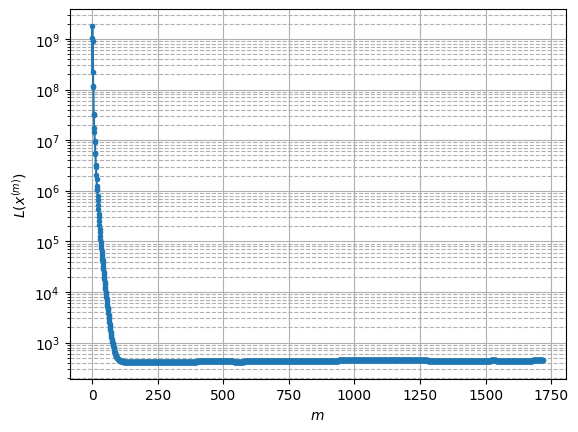

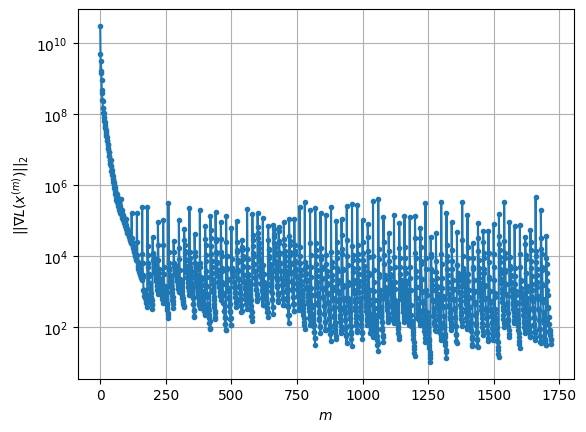

Windows:  29%|██▉       | 86/296 [56:45<2:16:59, 39.14s/it]

Before applying the algorithm
Cost function: 446.9884299846291
Gradient norm: 64646.877387568566
Global relative error: 2.173991988031111
Position relative errors: 0.027113797063231925 m, 1.5272890509875383 m, 1.4645542369041227 m, 0.49797046245930665 m

Iteration 1
Cost function: 446.6759277816668 (-0.07%)
Gradient norm: 28301.215070985338 (-56.22%)
Global relative error: 2.15781964513214 (-0.74%)
Position relative errors: 0.028195327099280916 m, 1.455770227376786 m, 1.4411238778460254 m, 0.6777059561115758 m

Iteration 2
Cost function: 446.61693443781763 (-0.01%)
Gradient norm: 14039.338449828801 (-50.39%)
Global relative error: 2.191065194806917 (1.54%)
Position relative errors: 0.02807108446478715 m, 1.5171854552533715 m, 1.4575577739260637 m, 0.6112707752725854 m

Iteration 3
Cost function: 446.60003285795307 (-0.00%)
Gradient norm: 8897.290432163567 (-36.63%)
Global relative error: 2.1923882603235123 (0.06%)
Position relative errors: 0.027953574700340753 m, 1.4866609559409927 m, 

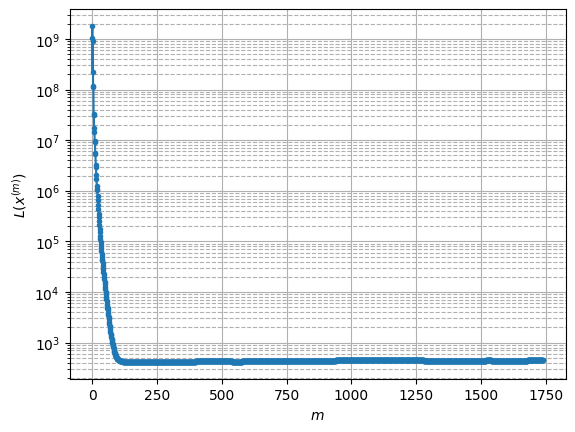

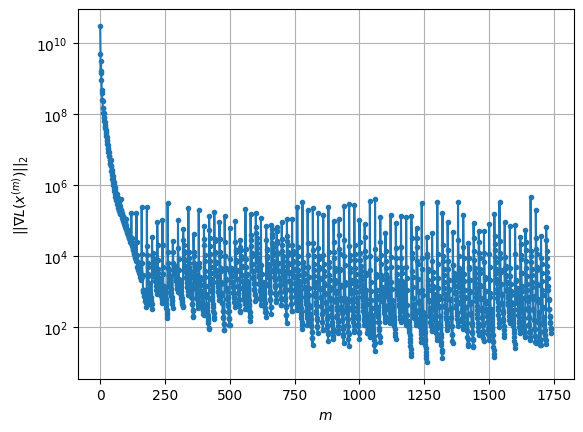

Windows:  29%|██▉       | 87/296 [57:23<2:15:14, 38.83s/it]

Before applying the algorithm
Cost function: 444.17851106028985
Gradient norm: 327113.8408874648
Global relative error: 2.2708880370076616
Position relative errors: 0.02799912432245114 m, 1.568043053340291 m, 1.4802897346115562 m, 0.7114291562430559 m

Iteration 1
Cost function: 443.5941528547778 (-0.13%)
Gradient norm: 11414.780108074947 (-96.51%)
Global relative error: 2.3618017875499824 (4.00%)
Position relative errors: 0.01939464084120926 m, 1.567854780007298 m, 1.4590730162586452 m, 0.9953232694985251 m

Iteration 2
Cost function: 443.50031948809965 (-0.02%)
Gradient norm: 16854.521305653874 (47.66%)
Global relative error: 2.4753308209786087 (4.81%)
Position relative errors: 0.019703497464773862 m, 1.6834796639370422 m, 1.5008891059318075 m, 1.019853967240467 m

Iteration 3
Cost function: 443.4560242180656 (-0.01%)
Gradient norm: 4812.743022001289 (-71.45%)
Global relative error: 2.549409216240121 (2.99%)
Position relative errors: 0.019964409547384845 m, 1.7005530263725646 m, 1.54

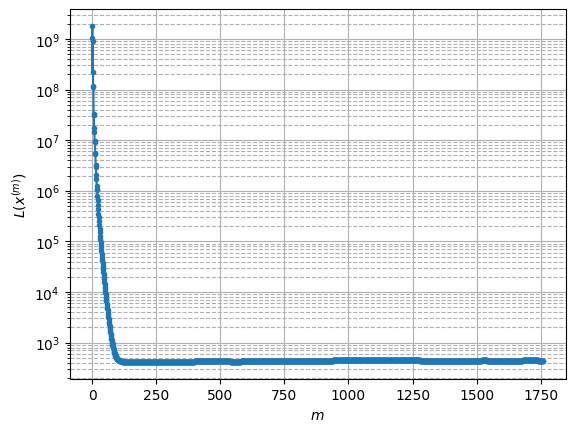

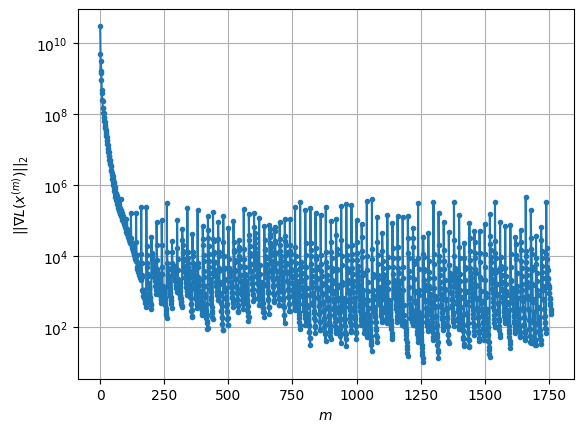

Windows:  30%|██▉       | 88/296 [58:03<2:14:58, 38.94s/it]

Before applying the algorithm
Cost function: 442.29970363068395
Gradient norm: 124595.2323351238
Global relative error: 2.9576868117854955
Position relative errors: 0.02136276509466237 m, 2.0017375893137763 m, 1.712690455628754 m, 1.3443185837901956 m

Iteration 1
Cost function: 441.62941559225936 (-0.15%)
Gradient norm: 18022.761271663203 (-85.53%)
Global relative error: 2.8915780322335123 (-2.24%)
Position relative errors: 0.024579404808015688 m, 2.04003262746499 m, 1.798215896868855 m, 0.9824995981622392 m

Iteration 2
Cost function: 441.5722077708026 (-0.01%)
Gradient norm: 16133.262593440546 (-10.48%)
Global relative error: 2.8126023955517008 (-2.73%)
Position relative errors: 0.024639423796552297 m, 1.9562314403302352 m, 1.7656571645011234 m, 0.98271974223929 m

Iteration 3
Cost function: 441.5568925830103 (-0.00%)
Gradient norm: 7133.417713571767 (-55.78%)
Global relative error: 2.780629970623925 (-1.14%)
Position relative errors: 0.024628354592508138 m, 1.9673518545540691 m, 1.

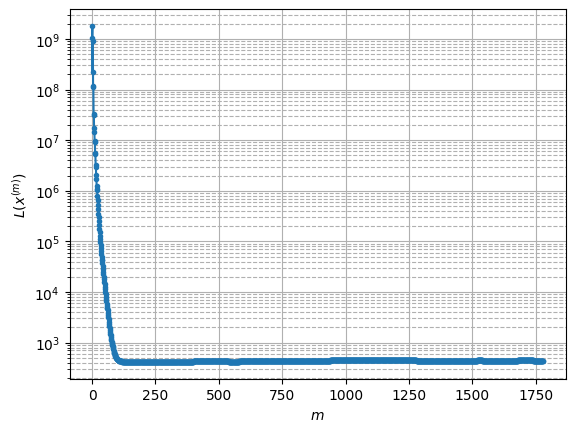

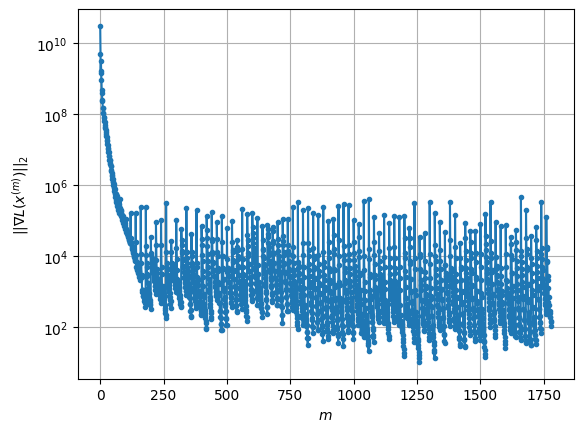

Windows:  30%|███       | 89/296 [58:41<2:14:02, 38.85s/it]

Before applying the algorithm
Cost function: 444.13995772815474
Gradient norm: 391692.5784484717
Global relative error: 2.551672143588338
Position relative errors: 0.025639748916033826 m, 1.8232887986344937 m, 1.5907621044515698 m, 0.8096090098255249 m

Iteration 1
Cost function: 443.58677656285164 (-0.12%)
Gradient norm: 20306.654791375007 (-94.82%)
Global relative error: 2.5319546404920388 (-0.77%)
Position relative errors: 0.02253377297247046 m, 1.756454963035029 m, 1.4617757868911931 m, 1.0901208510230906 m

Iteration 2
Cost function: 443.5382059150808 (-0.01%)
Gradient norm: 13007.782852466484 (-35.94%)
Global relative error: 2.5339309719759697 (0.08%)
Position relative errors: 0.022477329486280832 m, 1.7719944560874654 m, 1.4856591719802619 m, 1.0359308906555176 m

Iteration 3
Cost function: 443.5239807016257 (-0.00%)
Gradient norm: 6614.977958732273 (-49.15%)
Global relative error: 2.5218142938499946 (-0.48%)
Position relative errors: 0.02243653383105103 m, 1.748412799745906 m, 

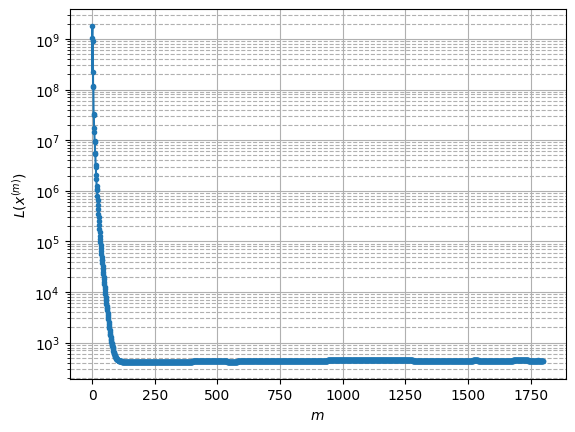

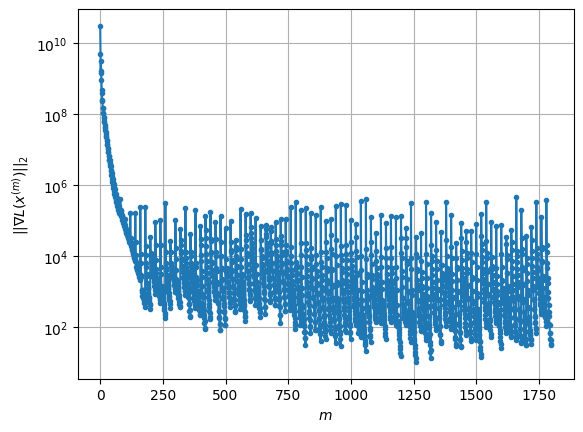

Windows:  30%|███       | 90/296 [59:20<2:12:54, 38.71s/it]

Before applying the algorithm
Cost function: 445.43313518418285
Gradient norm: 100385.61053790402
Global relative error: 2.4357018278778058
Position relative errors: 0.023618487405459 m, 1.7170296124581 m, 1.4037346747492832 m, 1.0066891180677466 m

Iteration 1
Cost function: 445.0118169083154 (-0.09%)
Gradient norm: 42216.287795688564 (-57.95%)
Global relative error: 2.374010968711559 (-2.53%)
Position relative errors: 0.026170067682404347 m, 1.5526764622065128 m, 1.4205007828577672 m, 1.0984605942029912 m

Iteration 2
Cost function: 444.95457130675504 (-0.01%)
Gradient norm: 20397.24358042479 (-51.68%)
Global relative error: 2.360791131319184 (-0.56%)
Position relative errors: 0.026230191009925723 m, 1.6380116393158275 m, 1.3668573103516635 m, 1.0105765117586964 m

Iteration 3
Cost function: 444.9406832261809 (-0.00%)
Gradient norm: 10899.630831474971 (-46.56%)
Global relative error: 2.3210289128635453 (-1.68%)
Position relative errors: 0.026315543820034922 m, 1.5564116527348721 m, 1

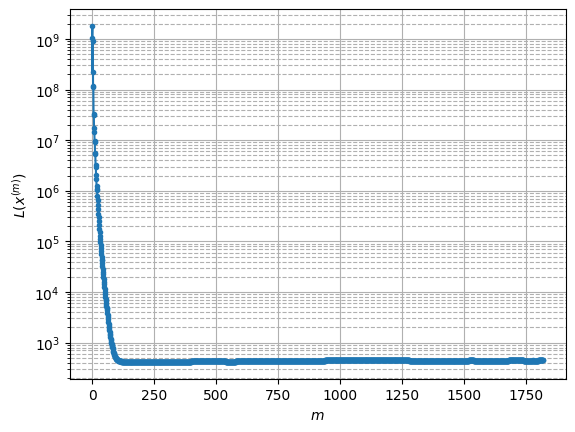

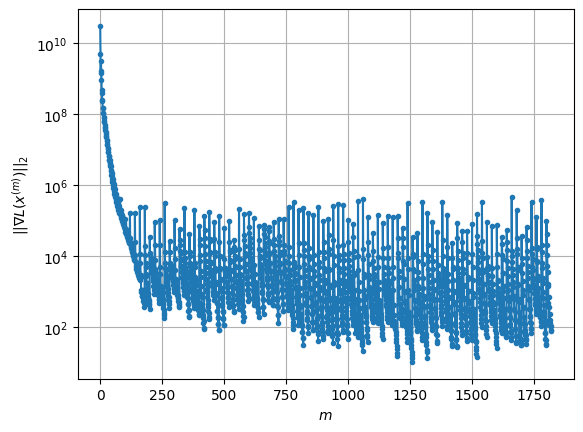

Windows:  31%|███       | 91/296 [1:00:00<2:13:46, 39.15s/it]

Before applying the algorithm
Cost function: 444.7552309391602
Gradient norm: 192603.54860748543
Global relative error: 2.1519909656414775
Position relative errors: 0.02747650738479332 m, 1.4935190114616672 m, 1.2430336205757608 m, 0.9244336199943582 m

Iteration 1
Cost function: 444.5475826404909 (-0.05%)
Gradient norm: 18285.434634068093 (-90.51%)
Global relative error: 2.1619735740805286 (0.46%)
Position relative errors: 0.023452362045274344 m, 1.5349058970487433 m, 1.1902208399111471 m, 0.9492190662856932 m

Iteration 2
Cost function: 444.5260016635734 (-0.00%)
Gradient norm: 7644.889551878009 (-58.19%)
Global relative error: 2.1847794234562756 (1.05%)
Position relative errors: 0.023458550012404693 m, 1.5338318639707467 m, 1.201304314504852 m, 0.9884015028353496 m

Iteration 3
Cost function: 444.5216462146963 (-0.00%)
Gradient norm: 3021.584741996492 (-60.48%)
Global relative error: 2.1941088265770023 (0.43%)
Position relative errors: 0.02353136938797419 m, 1.5472327850837193 m, 1.

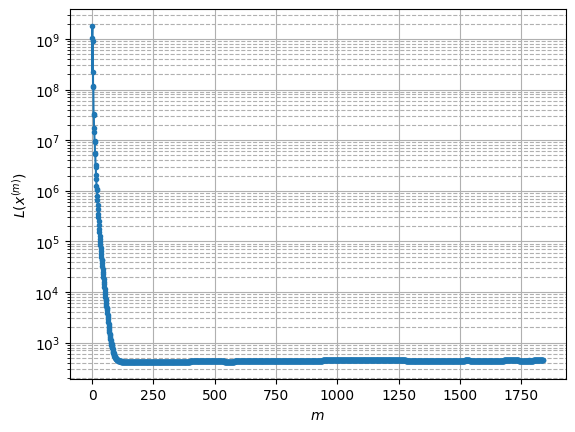

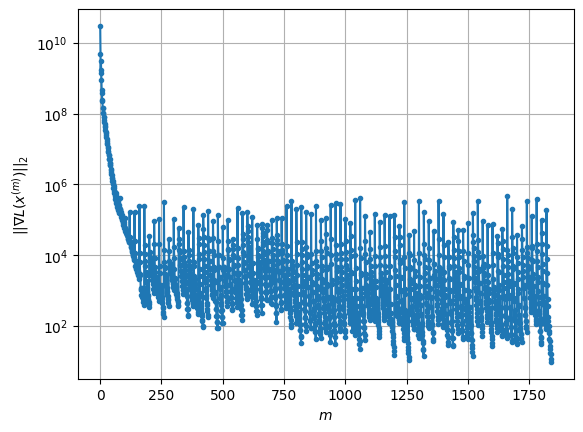

Windows:  31%|███       | 92/296 [1:00:38<2:12:26, 38.96s/it]

Before applying the algorithm
Cost function: 441.77600277490217
Gradient norm: 98847.73342352248
Global relative error: 2.2000838770413584
Position relative errors: 0.024635609015563005 m, 1.5713044691068583 m, 1.1664333505798836 m, 1.0050852781124533 m

Iteration 1
Cost function: 441.3845815842286 (-0.09%)
Gradient norm: 20011.18755246627 (-79.76%)
Global relative error: 2.135836758878832 (-2.92%)
Position relative errors: 0.02584103521989444 m, 1.6608420868429608 m, 1.154316898965524 m, 0.6857737483056329 m

Iteration 2
Cost function: 441.2904734048618 (-0.02%)
Gradient norm: 9160.824904183934 (-54.22%)
Global relative error: 2.0529949157040273 (-3.88%)
Position relative errors: 0.025250809308264444 m, 1.560491264831352 m, 1.126506992015963 m, 0.7141415323489235 m

Iteration 3
Cost function: 441.25523130261246 (-0.01%)
Gradient norm: 4998.06081643986 (-45.44%)
Global relative error: 2.0204832429178143 (-1.58%)
Position relative errors: 0.02490880978370387 m, 1.5637010206649322 m, 1.1

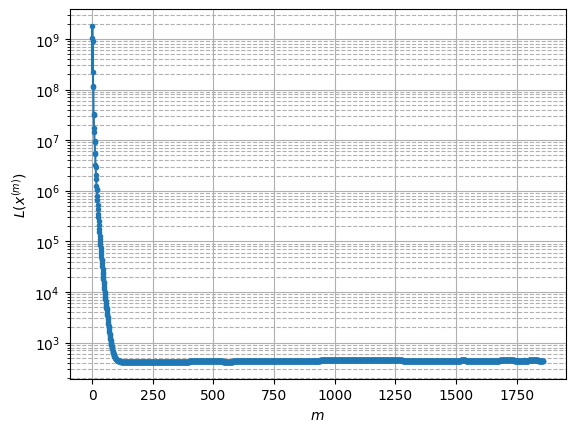

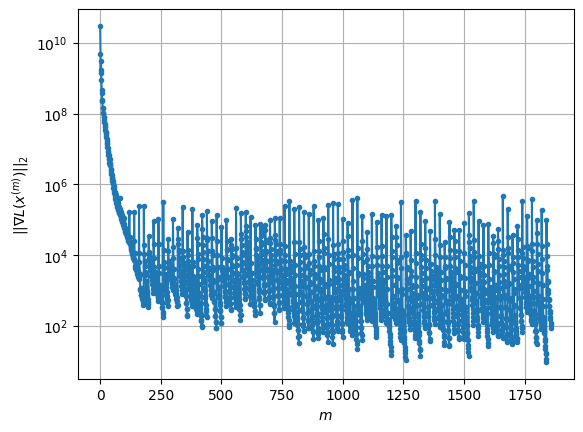

Windows:  31%|███▏      | 93/296 [1:01:17<2:11:01, 38.72s/it]

Before applying the algorithm
Cost function: 440.8684131493013
Gradient norm: 387192.64487717435
Global relative error: 1.795815928922103
Position relative errors: 0.025234815845656386 m, 1.421451612598042 m, 0.9472945736218704 m, 0.5535563300025711 m

Iteration 1
Cost function: 440.55919865459543 (-0.07%)
Gradient norm: 10359.198180931564 (-97.32%)
Global relative error: 1.795615468718838 (-0.01%)
Position relative errors: 0.020461356459860715 m, 1.4286945638225248 m, 0.9613129713787877 m, 0.5084522526999898 m

Iteration 2
Cost function: 440.5546913419669 (-0.00%)
Gradient norm: 5022.5461970340975 (-51.52%)
Global relative error: 1.7843517515687695 (-0.63%)
Position relative errors: 0.020432716881645146 m, 1.4184688020307887 m, 0.9509145681883735 m, 0.5169135926625517 m

Iteration 3
Cost function: 440.5534764984616 (-0.00%)
Gradient norm: 2794.665416670011 (-44.36%)
Global relative error: 1.7795300961185945 (-0.27%)
Position relative errors: 0.02042965255538524 m, 1.4165011725567247 m

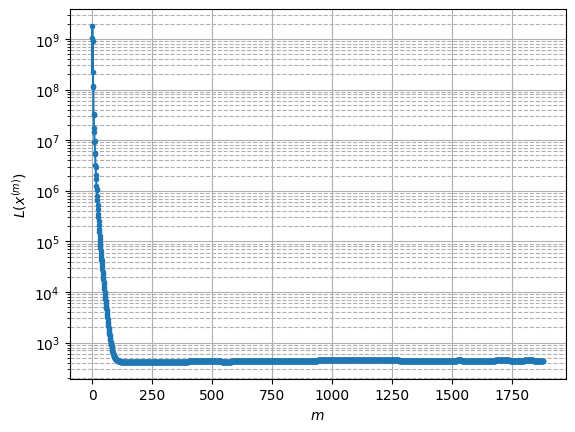

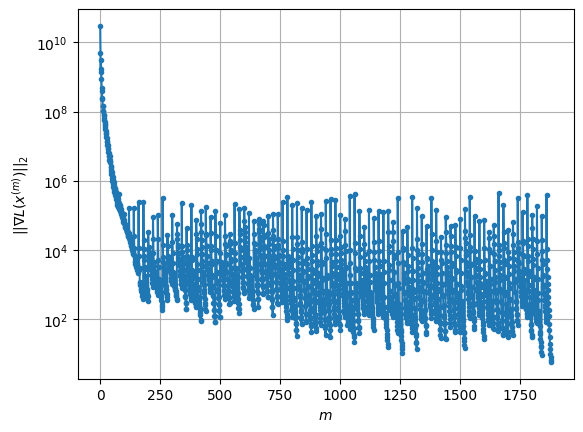

Windows:  32%|███▏      | 94/296 [1:01:55<2:10:25, 38.74s/it]

Before applying the algorithm
Cost function: 441.2688945814776
Gradient norm: 111776.50512283486
Global relative error: 1.6956255646915206
Position relative errors: 0.021712856134507297 m, 1.3784572088642728 m, 0.8631436928615783 m, 0.47907335733918893 m

Iteration 1
Cost function: 440.50034409278487 (-0.17%)
Gradient norm: 34443.38653062975 (-69.19%)
Global relative error: 1.9099257961808864 (12.64%)
Position relative errors: 0.019252826220988107 m, 1.700297741548988 m, 0.7727467633738365 m, 0.3991160387418375 m

Iteration 2
Cost function: 440.4150990152991 (-0.02%)
Gradient norm: 19235.569288646864 (-44.15%)
Global relative error: 1.7767636343916444 (-6.97%)
Position relative errors: 0.01911349133018066 m, 1.5118796147022293 m, 0.8265471707320194 m, 0.43308336396877306 m

Iteration 3
Cost function: 440.3964293987614 (-0.00%)
Gradient norm: 9439.227992984546 (-50.93%)
Global relative error: 1.8405757773239753 (3.59%)
Position relative errors: 0.019101139532106102 m, 1.6099427632876777

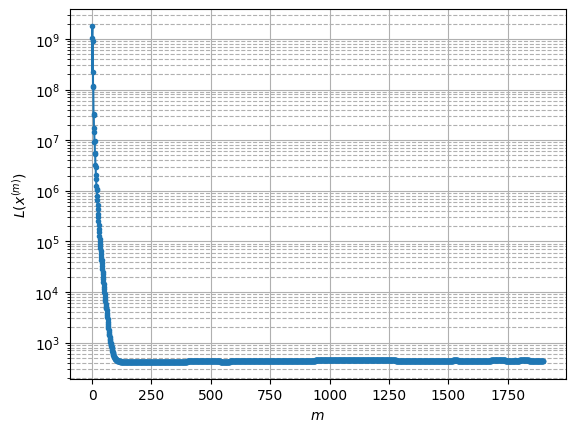

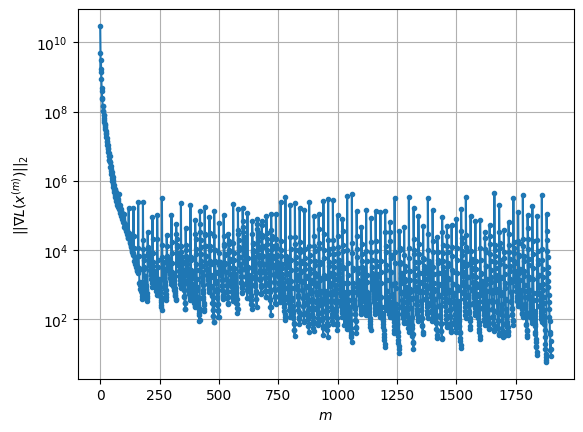

Windows:  32%|███▏      | 95/296 [1:02:36<2:11:39, 39.30s/it]

Before applying the algorithm
Cost function: 440.99918676446725
Gradient norm: 159104.66081599146
Global relative error: 1.771116207933583
Position relative errors: 0.020181271950026426 m, 1.556337984630564 m, 0.7362727624320039 m, 0.4149183359943261 m

Iteration 1
Cost function: 440.4644701834882 (-0.12%)
Gradient norm: 11048.132072103668 (-93.06%)
Global relative error: 1.9484527509377487 (10.01%)
Position relative errors: 0.01885645518250453 m, 1.6654501959055095 m, 0.857373078196136 m, 0.5360010167450516 m

Iteration 2
Cost function: 440.3976797591326 (-0.02%)
Gradient norm: 6878.728265284975 (-37.74%)
Global relative error: 1.919455284675548 (-1.49%)
Position relative errors: 0.018836821166743456 m, 1.6566521859936516 m, 0.8592350229261025 m, 0.4485198221141235 m

Iteration 3
Cost function: 440.37778837581357 (-0.00%)
Gradient norm: 4566.8080242579945 (-33.61%)
Global relative error: 1.9478930902923068 (1.48%)
Position relative errors: 0.018819026132435114 m, 1.6859577353479431 m,

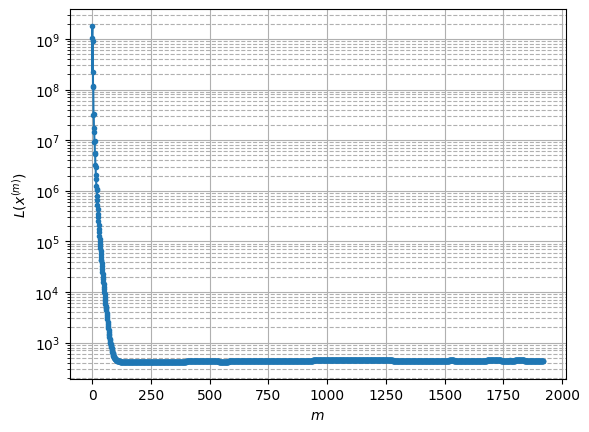

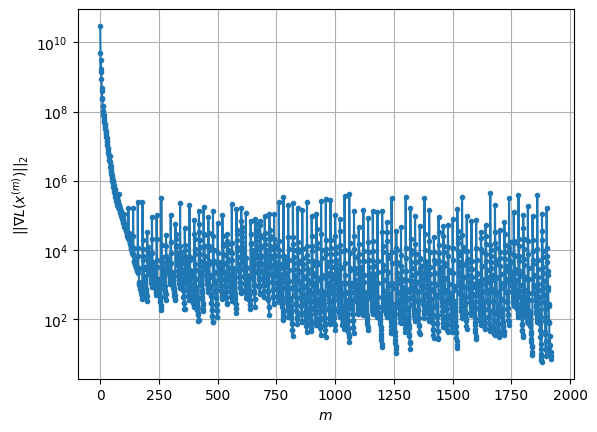

Windows:  32%|███▏      | 96/296 [1:03:14<2:09:43, 38.92s/it]

Before applying the algorithm
Cost function: 436.54493315388225
Gradient norm: 80945.64452155337
Global relative error: 1.890086525693961
Position relative errors: 0.01954257402064116 m, 1.664117485853095 m, 0.7991922342335868 m, 0.40502744508325245 m

Iteration 1
Cost function: 436.12052521695034 (-0.10%)
Gradient norm: 15170.097166310974 (-81.26%)
Global relative error: 1.895319691597941 (0.28%)
Position relative errors: 0.019976359542702358 m, 1.5608919221105992 m, 0.9746210769752499 m, 0.45339294671844116 m

Iteration 2
Cost function: 436.0502209070386 (-0.02%)
Gradient norm: 5177.260800601988 (-65.87%)
Global relative error: 1.9273155904058252 (1.69%)
Position relative errors: 0.019796589592626913 m, 1.6342249533971576 m, 0.9406182899913578 m, 0.3983677369668306 m

Iteration 3
Cost function: 436.0324222068941 (-0.00%)
Gradient norm: 2673.7697986605303 (-48.36%)
Global relative error: 1.9315222274215127 (0.22%)
Position relative errors: 0.01973292329112099 m, 1.6181460389369515 m, 

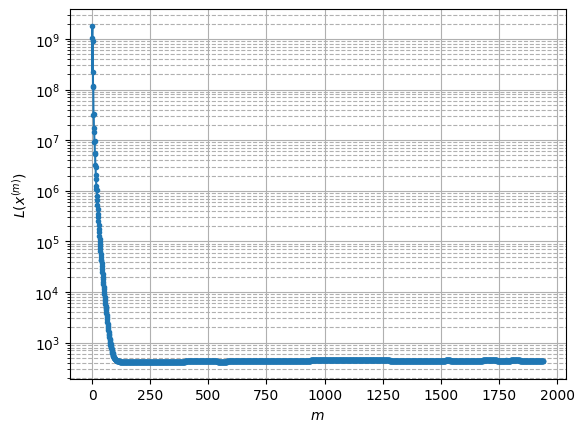

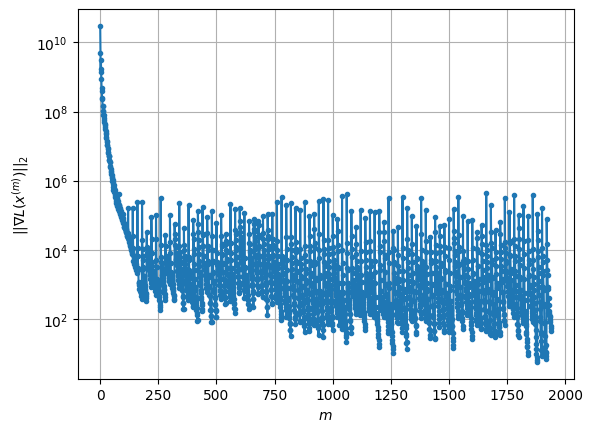

Windows:  33%|███▎      | 97/296 [1:03:54<2:09:54, 39.17s/it]

Before applying the algorithm
Cost function: 434.14336715209413
Gradient norm: 89139.82017892545
Global relative error: 1.896587526418717
Position relative errors: 0.019585065577218477 m, 1.6149887836633767 m, 0.9252146504336053 m, 0.3639320900713267 m

Iteration 1
Cost function: 432.9355914604143 (-0.28%)
Gradient norm: 25377.952748995944 (-71.53%)
Global relative error: 1.9580285114686509 (3.24%)
Position relative errors: 0.020164150978724385 m, 1.681320611255915 m, 0.8017428685688158 m, 0.6031878818633579 m

Iteration 2
Cost function: 432.7361837948773 (-0.05%)
Gradient norm: 8048.205694366911 (-68.29%)
Global relative error: 2.115420366090957 (8.04%)
Position relative errors: 0.0198980747857173 m, 1.8150907751576817 m, 0.9149605241037139 m, 0.5855744922317746 m

Iteration 3
Cost function: 432.6774597915273 (-0.01%)
Gradient norm: 6531.54926208697 (-18.84%)
Global relative error: 2.198631996458744 (3.93%)
Position relative errors: 0.01971859183354924 m, 1.8514035080318416 m, 0.95744

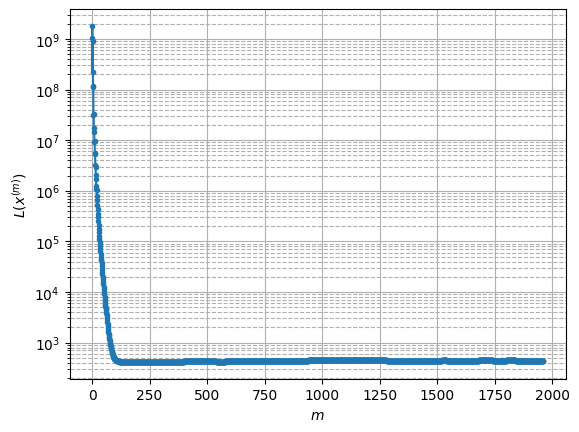

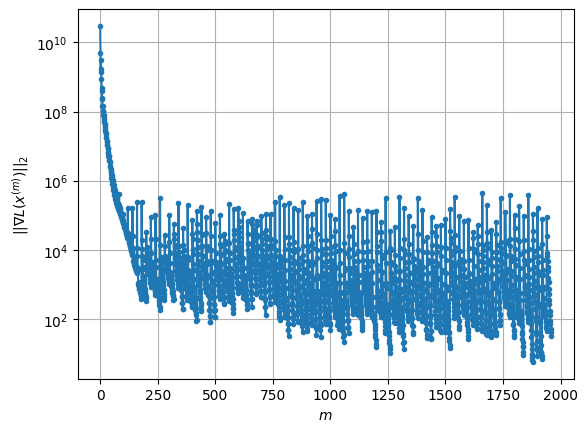

Windows:  33%|███▎      | 98/296 [1:04:32<2:08:23, 38.91s/it]

Before applying the algorithm
Cost function: 429.06145437430047
Gradient norm: 63215.56699196612
Global relative error: 2.381829965673672
Position relative errors: 0.019109507796153172 m, 1.9893514994143326 m, 1.0067437132316532 m, 0.8376714016178832 m

Iteration 1
Cost function: 428.3491414349946 (-0.17%)
Gradient norm: 21823.83978141602 (-65.48%)
Global relative error: 2.4661825648984306 (3.54%)
Position relative errors: 0.02098025851064539 m, 2.091863936066552 m, 0.7878441024287206 m, 1.0416429026272749 m

Iteration 2
Cost function: 428.2743196950836 (-0.02%)
Gradient norm: 8605.072638077572 (-60.57%)
Global relative error: 2.470911872969895 (0.19%)
Position relative errors: 0.02105321509428694 m, 2.0907747040279197 m, 0.8561386304087234 m, 1.000323391846525 m

Iteration 3
Cost function: 428.2600987787202 (-0.00%)
Gradient norm: 3105.7185865670103 (-63.91%)
Global relative error: 2.491996633326074 (0.85%)
Position relative errors: 0.021032680573933985 m, 2.101847942227116 m, 0.84465

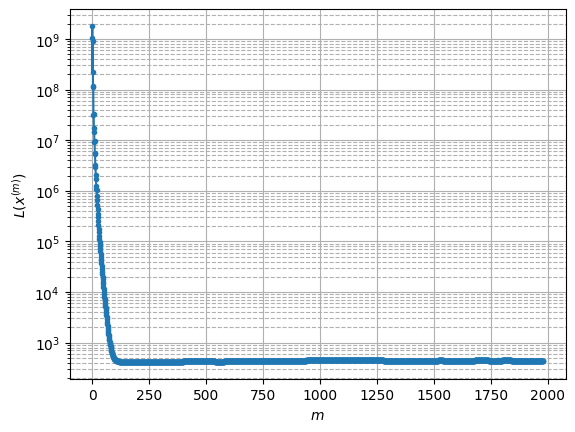

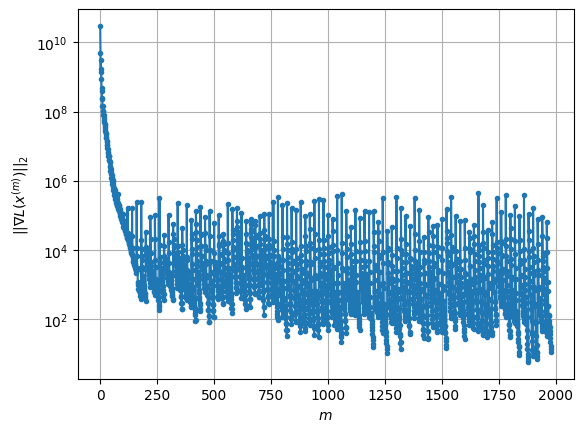

Windows:  33%|███▎      | 99/296 [1:05:10<2:06:51, 38.64s/it]

Before applying the algorithm
Cost function: 431.33621805784514
Gradient norm: 73548.60180486861
Global relative error: 2.445535332052092
Position relative errors: 0.019988748629890044 m, 2.0792493064540793 m, 0.7777701287506602 m, 1.0256880178000698 m

Iteration 1
Cost function: 431.029161055588 (-0.07%)
Gradient norm: 23595.435801809563 (-67.92%)
Global relative error: 2.428219149770661 (-0.71%)
Position relative errors: 0.02123415281835561 m, 2.1775025208273324 m, 0.8062625837151893 m, 0.7100825396604676 m

Iteration 2
Cost function: 430.9848801216947 (-0.01%)
Gradient norm: 9248.23819289766 (-60.80%)
Global relative error: 2.3366209097306543 (-3.77%)
Position relative errors: 0.02135496972678296 m, 2.065552347851718 m, 0.7926347994900635 m, 0.7513729312582265 m

Iteration 3
Cost function: 430.9704449548816 (-0.00%)
Gradient norm: 6106.734796514317 (-33.97%)
Global relative error: 2.3191347359706675 (-0.75%)
Position relative errors: 0.02138126692563803 m, 2.0795961544223007 m, 0.76

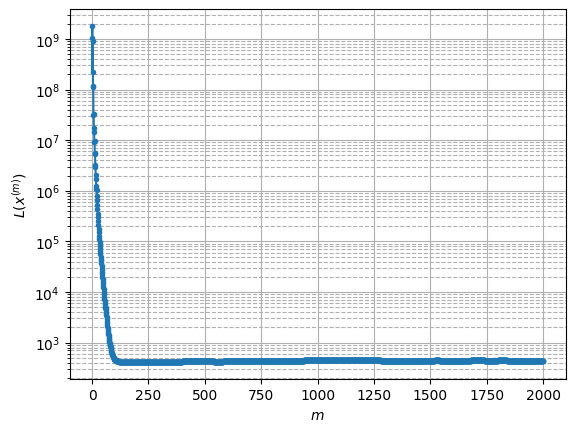

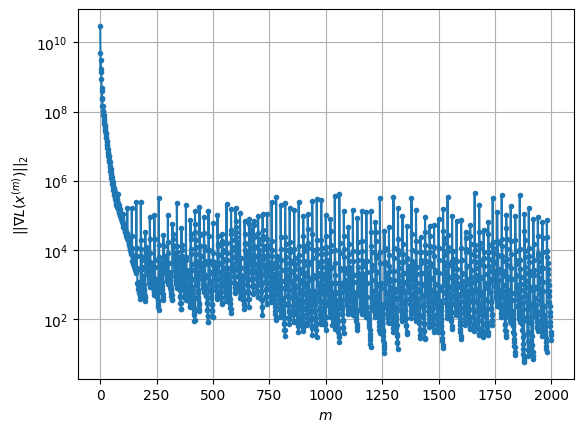

Windows:  34%|███▍      | 100/296 [1:05:50<2:07:24, 39.00s/it]

Before applying the algorithm
Cost function: 432.07382009136467
Gradient norm: 197282.44167798193
Global relative error: 2.085923156466979
Position relative errors: 0.020324733095788066 m, 1.912293488249142 m, 0.60968212305096 m, 0.5675208133692821 m

Iteration 1
Cost function: 431.8047695673711 (-0.06%)
Gradient norm: 11900.995419945355 (-93.97%)
Global relative error: 2.124305814693945 (1.84%)
Position relative errors: 0.027373748000943096 m, 2.0147260077271785 m, 0.5842234911628572 m, 0.3338919665814018 m

Iteration 2
Cost function: 431.76968804592497 (-0.01%)
Gradient norm: 6030.663860357451 (-49.33%)
Global relative error: 2.032476165677521 (-4.32%)
Position relative errors: 0.027641257808036605 m, 1.9105512078802405 m, 0.5789020410994882 m, 0.38060178095660707 m

Iteration 3
Cost function: 431.7582223870136 (-0.00%)
Gradient norm: 3975.4145213547467 (-34.08%)
Global relative error: 2.0491020784911145 (0.82%)
Position relative errors: 0.02777291002566105 m, 1.9416812127201397 m, 0

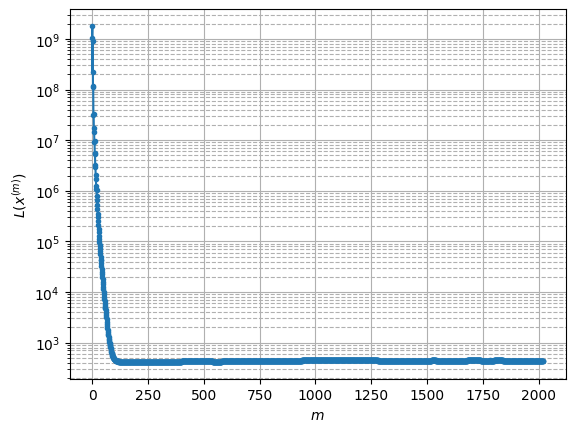

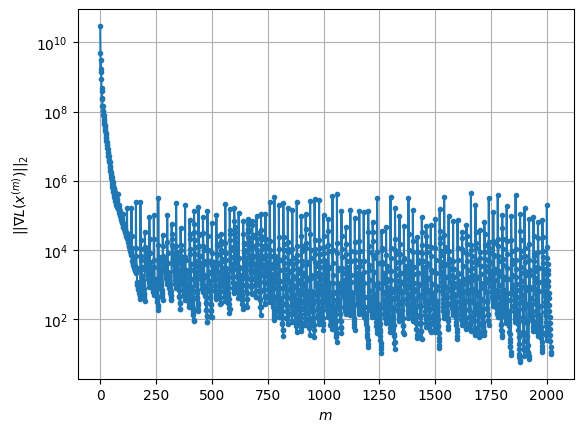

Windows:  34%|███▍      | 101/296 [1:06:27<2:05:17, 38.55s/it]

Before applying the algorithm
Cost function: 433.69240629359564
Gradient norm: 64656.20718090059
Global relative error: 1.921360288650755
Position relative errors: 0.026249291543845837 m, 1.843039943107708 m, 0.4494484478174678 m, 0.3035319382802062 m

Iteration 1
Cost function: 433.4452295892104 (-0.06%)
Gradient norm: 16005.552174864928 (-75.25%)
Global relative error: 1.7683682394467297 (-7.96%)
Position relative errors: 0.022699888207573602 m, 1.6547966613068328 m, 0.4108647241328621 m, 0.46844926096192446 m

Iteration 2
Cost function: 433.4141306208424 (-0.01%)
Gradient norm: 6853.39955154764 (-57.18%)
Global relative error: 1.8160178680917332 (2.69%)
Position relative errors: 0.02275734473471177 m, 1.7292867364809585 m, 0.3929167755080774 m, 0.39061791156842024 m

Iteration 3
Cost function: 433.40433058863783 (-0.00%)
Gradient norm: 3682.546839163853 (-46.27%)
Global relative error: 1.7743642040813437 (-2.29%)
Position relative errors: 0.022854743244078633 m, 1.676185177205966 m,

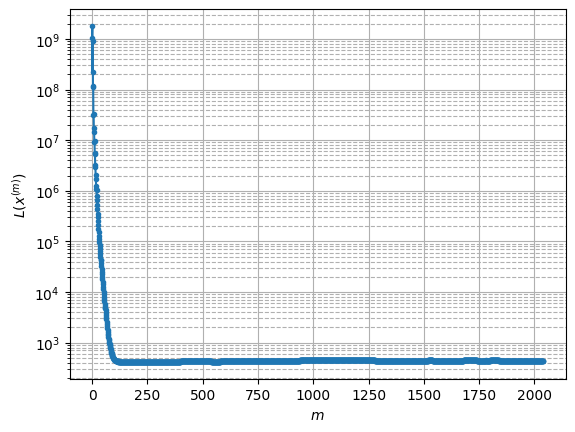

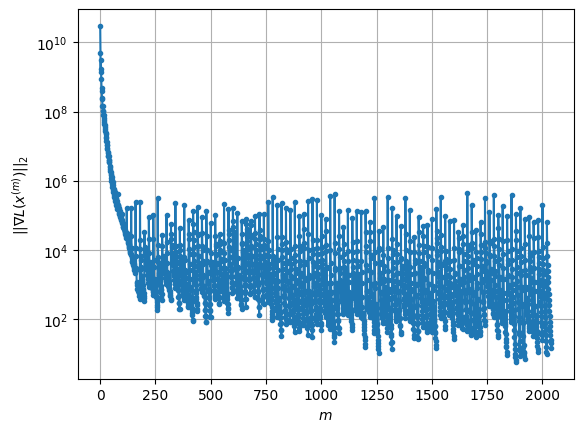

Windows:  34%|███▍      | 102/296 [1:07:04<2:03:15, 38.12s/it]

Before applying the algorithm
Cost function: 435.6889176049845
Gradient norm: 224937.06597648966
Global relative error: 1.6699770318325577
Position relative errors: 0.021812173971346122 m, 1.6047601434079113 m, 0.29802411644796123 m, 0.3525183229433718 m

Iteration 1
Cost function: 435.2855551815559 (-0.09%)
Gradient norm: 16109.92916559197 (-92.84%)
Global relative error: 1.7026265853070754 (1.96%)
Position relative errors: 0.01896650180639978 m, 1.6292352130468755 m, 0.3183472306402303 m, 0.37791482786258723 m

Iteration 2
Cost function: 435.2249406880045 (-0.01%)
Gradient norm: 10167.111157005871 (-36.89%)
Global relative error: 1.6752353939174036 (-1.61%)
Position relative errors: 0.019112838922478524 m, 1.60103106495852 m, 0.326879236196058 m, 0.368635372224833 m

Iteration 3
Cost function: 435.2040195834281 (-0.00%)
Gradient norm: 7752.036243401215 (-23.75%)
Global relative error: 1.6904042910112458 (0.91%)
Position relative errors: 0.019257957809051075 m, 1.6113840013856946 m, 0

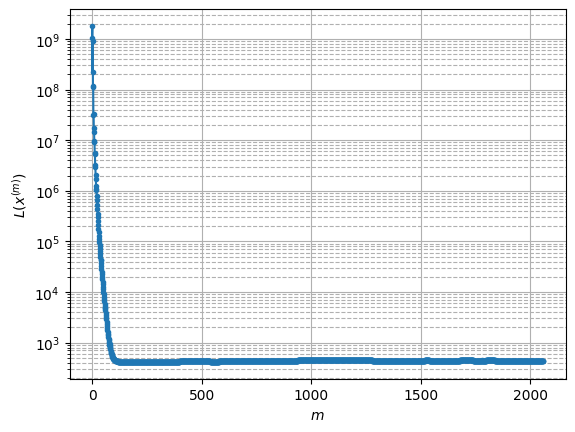

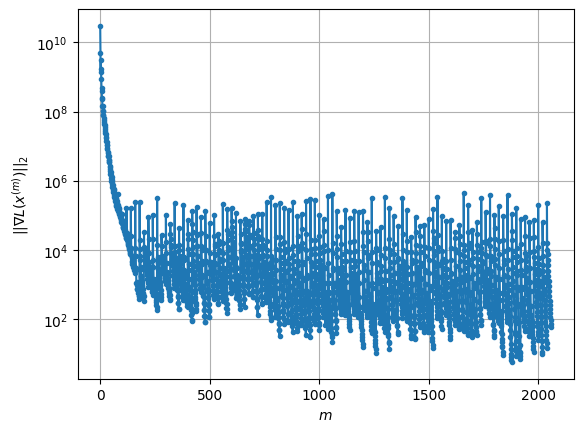

Windows:  35%|███▍      | 103/296 [1:07:41<2:01:03, 37.63s/it]

Before applying the algorithm
Cost function: 433.8511095703371
Gradient norm: 42669.00695439096
Global relative error: 1.6221602542045104
Position relative errors: 0.01840089455049936 m, 1.5529258443020075 m, 0.26433849489178235 m, 0.3867877847340469 m

Iteration 1
Cost function: 433.6132599076294 (-0.05%)
Gradient norm: 17862.16707067194 (-58.14%)
Global relative error: 1.6601704971918156 (2.34%)
Position relative errors: 0.018302576415801658 m, 1.6053362899090062 m, 0.3236709519386789 m, 0.27195021590613133 m

Iteration 2
Cost function: 433.60146581901336 (-0.00%)
Gradient norm: 6813.876713904658 (-61.85%)
Global relative error: 1.637251721880873 (-1.38%)
Position relative errors: 0.018305431022928285 m, 1.5788397963585845 m, 0.3196583951821931 m, 0.29212126828546064 m

Iteration 3
Cost function: 433.5998336033466 (-0.00%)
Gradient norm: 2617.709107343557 (-61.58%)
Global relative error: 1.6573034128368802 (1.22%)
Position relative errors: 0.018306193003345884 m, 1.6004000885211231 m

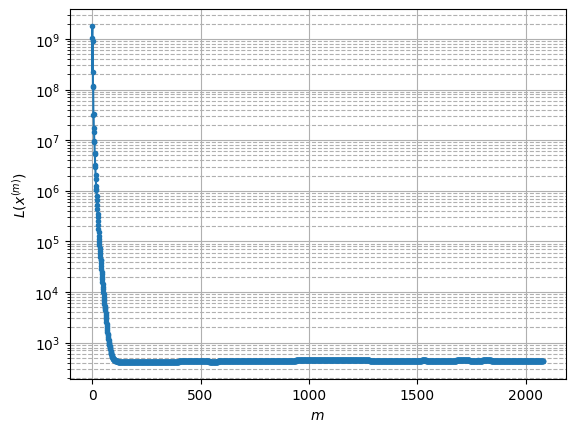

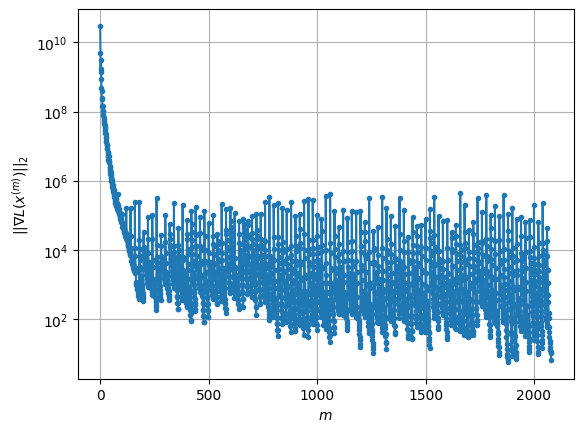

Windows:  35%|███▌      | 104/296 [1:08:19<2:01:05, 37.84s/it]

Before applying the algorithm
Cost function: 438.28610909629714
Gradient norm: 127419.11755442391
Global relative error: 1.5503486446659012
Position relative errors: 0.0175741106487105 m, 1.510438287376966 m, 0.23002507983756504 m, 0.26254433836312924 m

Iteration 1
Cost function: 437.3351269489997 (-0.22%)
Gradient norm: 47374.026713330546 (-62.82%)
Global relative error: 1.486817644363351 (-4.10%)
Position relative errors: 0.016604063712354903 m, 1.403715945391111 m, 0.2702189445284588 m, 0.4085430052024661 m

Iteration 2
Cost function: 437.24632448785536 (-0.02%)
Gradient norm: 20660.92986411834 (-56.39%)
Global relative error: 1.5665282441571848 (5.36%)
Position relative errors: 0.01659928294886373 m, 1.516785395289882 m, 0.24000203906785372 m, 0.3090139043628807 m

Iteration 3
Cost function: 437.2247349455358 (-0.00%)
Gradient norm: 9768.70223412866 (-52.72%)
Global relative error: 1.5348483122988152 (-2.02%)
Position relative errors: 0.016565555252225264 m, 1.4626315356352535 m, 

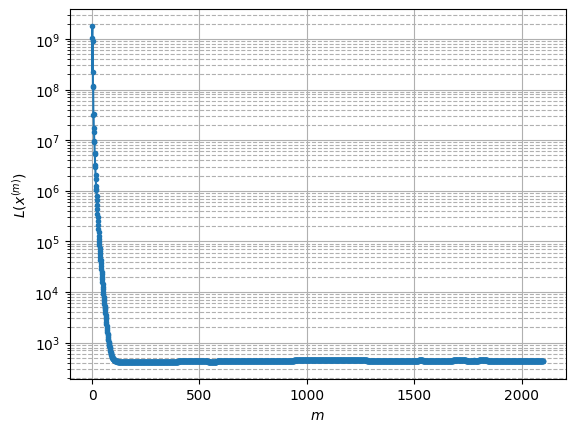

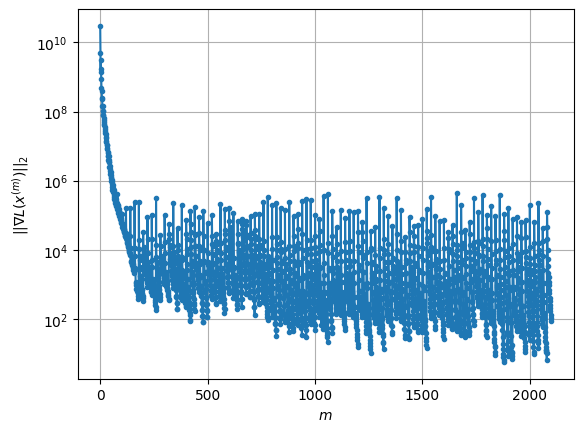

Windows:  35%|███▌      | 105/296 [1:08:56<1:59:25, 37.52s/it]

Before applying the algorithm
Cost function: 438.79074938755497
Gradient norm: 233481.08892650093
Global relative error: 1.459043497201464
Position relative errors: 0.016861071070826673 m, 1.4006259248731636 m, 0.1642403740182065 m, 0.37388398084921015 m

Iteration 1
Cost function: 438.20464582416236 (-0.13%)
Gradient norm: 14498.45194881726 (-93.79%)
Global relative error: 1.575937568714343 (8.01%)
Position relative errors: 0.02096115781550621 m, 1.537176476360006 m, 0.3154138127048489 m, 0.14399748442216012 m

Iteration 2
Cost function: 438.0709928227909 (-0.03%)
Gradient norm: 12290.197292664698 (-15.23%)
Global relative error: 1.5318454797539083 (-2.80%)
Position relative errors: 0.020289060855631685 m, 1.4816349991931952 m, 0.32937321287371485 m, 0.20591841011585826 m

Iteration 3
Cost function: 438.01876781865286 (-0.01%)
Gradient norm: 7615.498236378927 (-38.04%)
Global relative error: 1.5757616565178116 (2.87%)
Position relative errors: 0.020058128204257803 m, 1.517174618487672

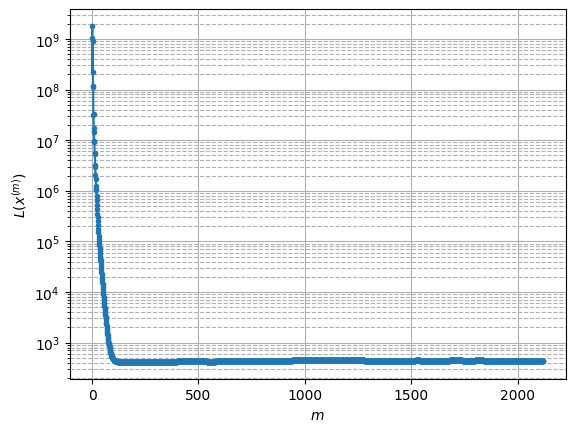

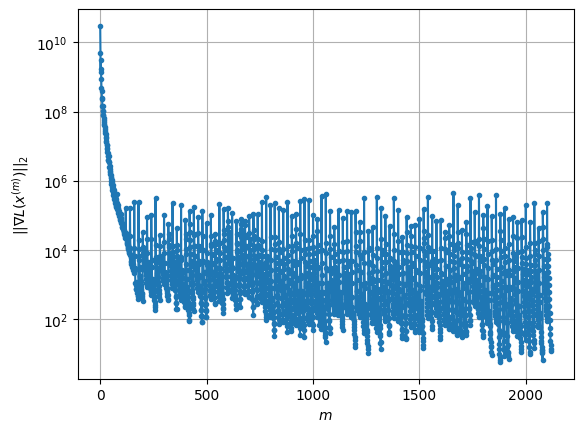

Windows:  36%|███▌      | 106/296 [1:09:33<1:58:20, 37.37s/it]

Before applying the algorithm
Cost function: 436.9863917181966
Gradient norm: 279910.95013059274
Global relative error: 1.5335298062377636
Position relative errors: 0.02007412473559052 m, 1.4557507886383247 m, 0.4194176521394389 m, 0.23702347215049555 m

Iteration 1
Cost function: 436.5480665330673 (-0.10%)
Gradient norm: 22143.54916318027 (-92.09%)
Global relative error: 1.551137326391757 (1.15%)
Position relative errors: 0.024541642380150913 m, 1.4033300164452858 m, 0.5356084977188916 m, 0.3862694757441189 m

Iteration 2
Cost function: 436.50408288662607 (-0.01%)
Gradient norm: 11498.199678481993 (-48.07%)
Global relative error: 1.5946529938859553 (2.81%)
Position relative errors: 0.024549694621902297 m, 1.4788436557068603 m, 0.4798205912612431 m, 0.3536953339521539 m

Iteration 3
Cost function: 436.4918003229396 (-0.00%)
Gradient norm: 5983.858741485669 (-47.96%)
Global relative error: 1.5749989758284162 (-1.23%)
Position relative errors: 0.024581637128875195 m, 1.4422109535863659 m

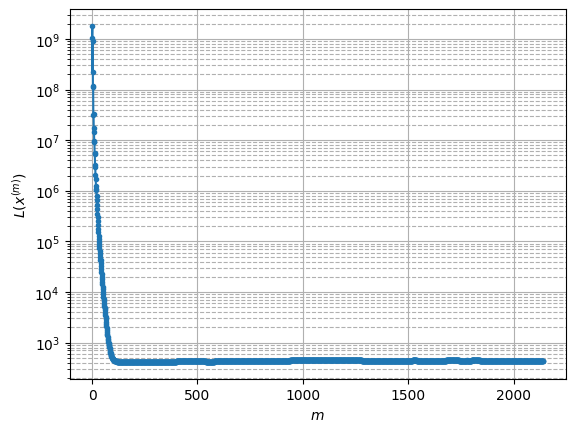

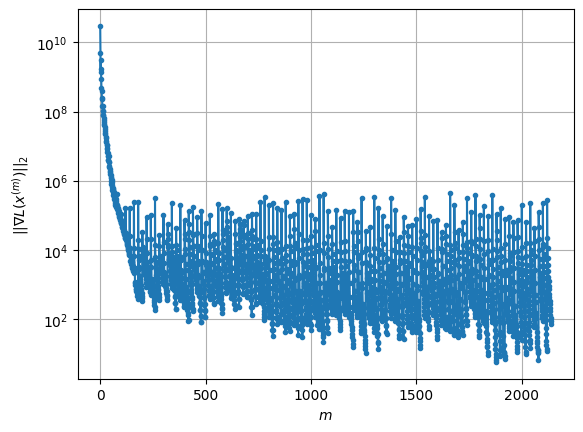

Windows:  36%|███▌      | 107/296 [1:10:09<1:56:19, 36.93s/it]

Before applying the algorithm
Cost function: 433.7611309044567
Gradient norm: 185440.26100660846
Global relative error: 1.4876218090851026
Position relative errors: 0.02506505423509059 m, 1.3393058478037898 m, 0.5147306353727366 m, 0.39203858653731716 m

Iteration 1
Cost function: 433.4394123670461 (-0.07%)
Gradient norm: 27878.889178936148 (-84.97%)
Global relative error: 1.5571283817380905 (4.67%)
Position relative errors: 0.021056147980168055 m, 1.3814791802767308 m, 0.5262792804916475 m, 0.4886124915667041 m

Iteration 2
Cost function: 433.39096116704906 (-0.01%)
Gradient norm: 14620.902020526473 (-47.56%)
Global relative error: 1.5113320840836981 (-2.94%)
Position relative errors: 0.02120817710622756 m, 1.3458153922322889 m, 0.5342271329079714 m, 0.43249134507636516 m

Iteration 3
Cost function: 433.3761252524363 (-0.00%)
Gradient norm: 8681.321396972471 (-40.62%)
Global relative error: 1.499276870927096 (-0.80%)
Position relative errors: 0.021192272728661227 m, 1.330099982986499 

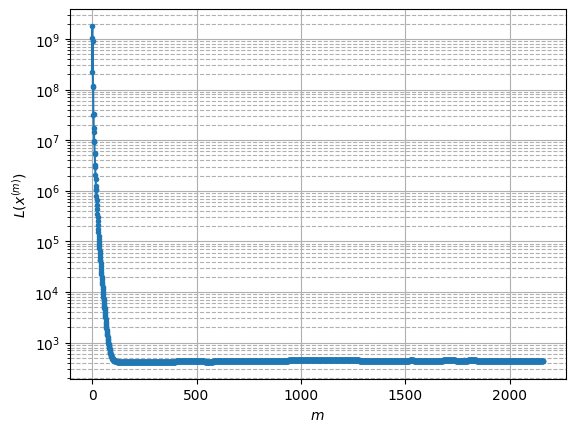

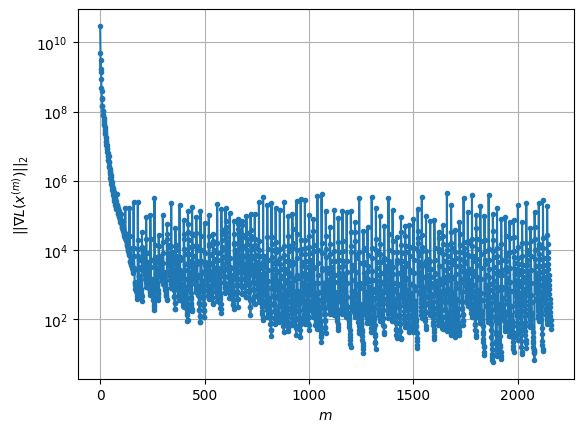

Windows:  36%|███▋      | 108/296 [1:10:48<1:57:30, 37.50s/it]

Before applying the algorithm
Cost function: 434.2383417749617
Gradient norm: 286317.3466393416
Global relative error: 1.345705468130172
Position relative errors: 0.021716101890833745 m, 1.1312633726876913 m, 0.6210856410657153 m, 0.38070867389295177 m

Iteration 1
Cost function: 433.7749956070991 (-0.11%)
Gradient norm: 21638.09993938488 (-92.44%)
Global relative error: 1.3479091925255384 (0.16%)
Position relative errors: 0.03794641459467867 m, 1.0829163661424732 m, 0.6080361587861993 m, 0.5224891869771752 m

Iteration 2
Cost function: 433.73663683134913 (-0.01%)
Gradient norm: 13190.22994009385 (-39.04%)
Global relative error: 1.4233291269892416 (5.60%)
Position relative errors: 0.03792277783240458 m, 1.1893649047834327 m, 0.5878402057633774 m, 0.514075919647409 m

Iteration 3
Cost function: 433.71907421300676 (-0.00%)
Gradient norm: 8487.917550573213 (-35.65%)
Global relative error: 1.4345122833578776 (0.79%)
Position relative errors: 0.037891257674575435 m, 1.181820885218493 m, 0.5

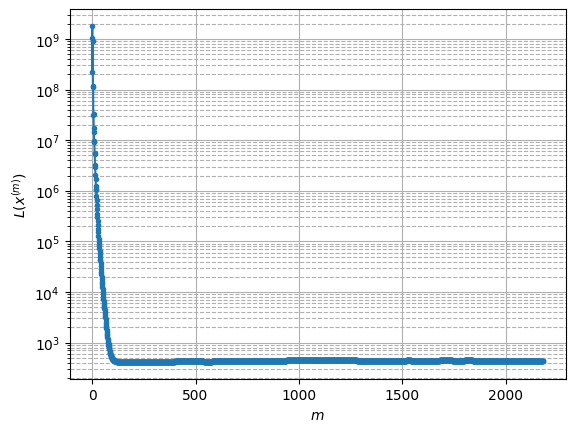

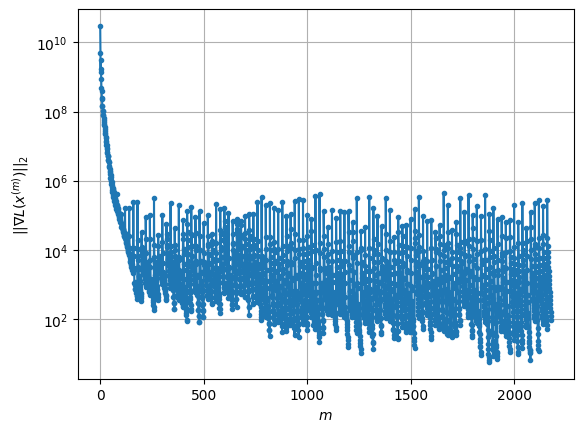

Windows:  37%|███▋      | 109/296 [1:11:24<1:55:51, 37.18s/it]

Before applying the algorithm
Cost function: 433.6710803446134
Gradient norm: 39294.19473273801
Global relative error: 1.461421053846022
Position relative errors: 0.03746246304615179 m, 1.1561842517003664 m, 0.605575879787904 m, 0.6563951860051306 m

Iteration 1
Cost function: 433.45722430693763 (-0.05%)
Gradient norm: 15376.945560507374 (-60.87%)
Global relative error: 1.3915578326927702 (-4.78%)
Position relative errors: 0.03139812939916446 m, 1.1603908122439697 m, 0.6005467472797833 m, 0.4777810807367236 m

Iteration 2
Cost function: 433.4072775657835 (-0.01%)
Gradient norm: 9259.465179752904 (-39.78%)
Global relative error: 1.3776568982836999 (-1.00%)
Position relative errors: 0.031025210262715378 m, 1.1159821719744916 m, 0.6481658342734048 m, 0.4810729552753469 m

Iteration 3
Cost function: 433.38878129176635 (-0.00%)
Gradient norm: 4753.266400570156 (-48.67%)
Global relative error: 1.3948423956676612 (1.25%)
Position relative errors: 0.030797506599394592 m, 1.138436919112912 m, 0

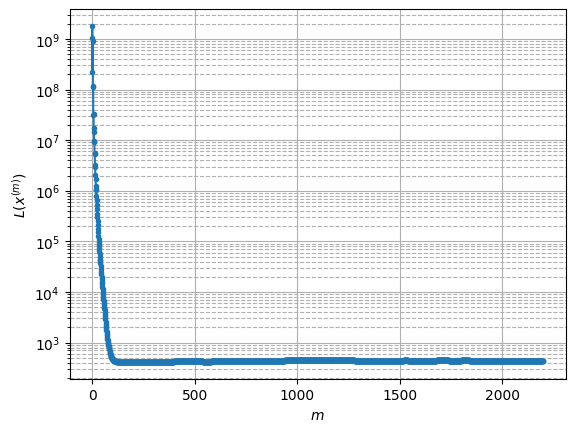

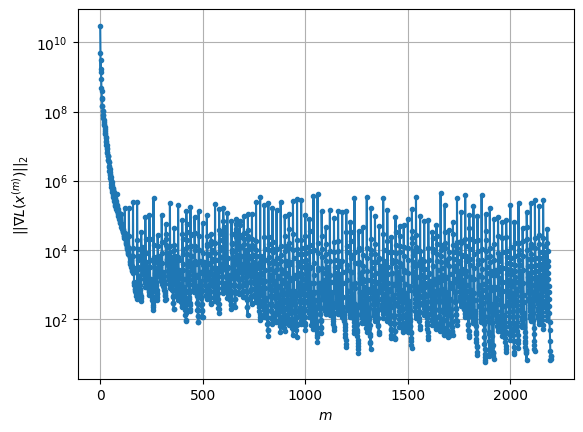

Windows:  37%|███▋      | 110/296 [1:12:01<1:54:41, 37.00s/it]

Before applying the algorithm
Cost function: 433.61004547707086
Gradient norm: 87008.86461775965
Global relative error: 1.3290365715336083
Position relative errors: 0.030117665814141693 m, 0.9921738122352446 m, 0.7642338463425423 m, 0.4438003330126152 m

Iteration 1
Cost function: 433.31107591388223 (-0.07%)
Gradient norm: 19122.908145781807 (-78.02%)
Global relative error: 1.26805352870637 (-4.59%)
Position relative errors: 0.03506158392666018 m, 1.0036216044272877 m, 0.7062792176771115 m, 0.31722751522127546 m

Iteration 2
Cost function: 433.26760755867616 (-0.01%)
Gradient norm: 12811.189088655088 (-33.01%)
Global relative error: 1.2200528802850577 (-3.79%)
Position relative errors: 0.035008670420662885 m, 0.9277060851472779 m, 0.7360481272329438 m, 0.2913548278759133 m

Iteration 3
Cost function: 433.2496810289974 (-0.00%)
Gradient norm: 9239.594259358757 (-27.88%)
Global relative error: 1.2241914365982836 (0.34%)
Position relative errors: 0.03496492011966577 m, 0.9254668633269907 

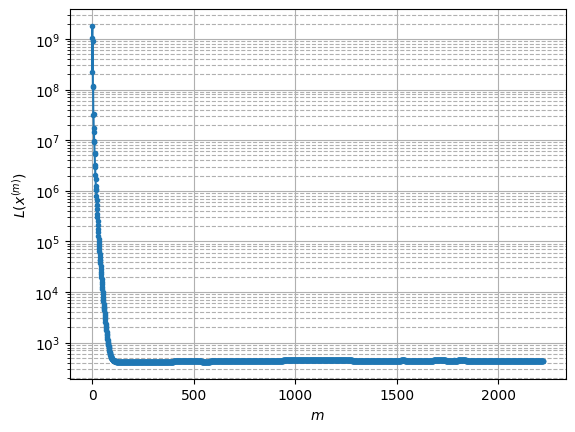

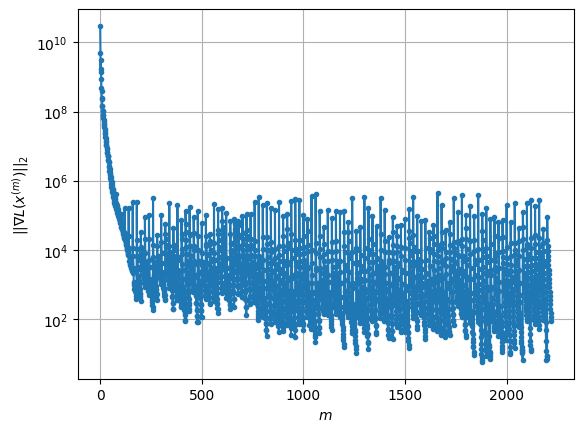

Windows:  38%|███▊      | 111/296 [1:12:37<1:53:15, 36.73s/it]

Before applying the algorithm
Cost function: 432.2690306620169
Gradient norm: 124787.1214875334
Global relative error: 1.1278396832204018
Position relative errors: 0.034300679162048736 m, 0.6891170862020642 m, 0.8718236828776802 m, 0.18941194770517536 m

Iteration 1
Cost function: 431.9911965158229 (-0.06%)
Gradient norm: 12541.50842490166 (-89.95%)
Global relative error: 1.131312828444441 (0.31%)
Position relative errors: 0.0425341158582047 m, 0.6437887470456605 m, 0.9018762269249874 m, 0.2240647875070311 m

Iteration 2
Cost function: 431.9694405019911 (-0.01%)
Gradient norm: 8927.858127111136 (-28.81%)
Global relative error: 1.1496568991742044 (1.62%)
Position relative errors: 0.04237817974254274 m, 0.663453557497253 m, 0.914028392027242 m, 0.2104431838114789 m

Iteration 3
Cost function: 431.9624357878872 (-0.00%)
Gradient norm: 5263.517531128774 (-41.04%)
Global relative error: 1.1489081758772086 (-0.07%)
Position relative errors: 0.042309476071885115 m, 0.6637937588941228 m, 0.911

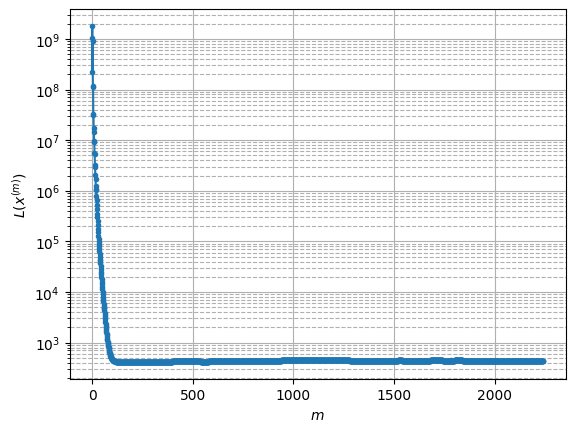

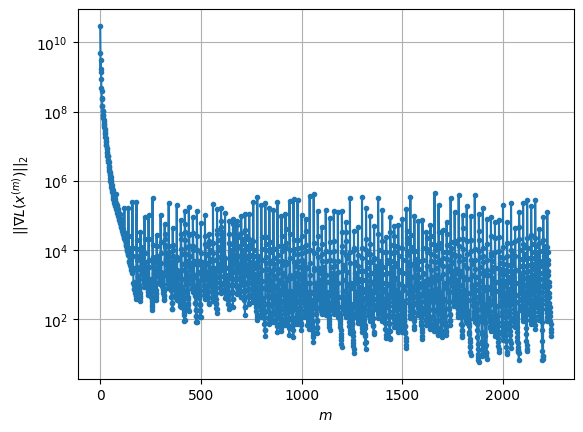

Windows:  38%|███▊      | 112/296 [1:13:13<1:52:10, 36.58s/it]

Before applying the algorithm
Cost function: 432.2589174783737
Gradient norm: 138711.46211234137
Global relative error: 1.1399246468112396
Position relative errors: 0.04113301973840618 m, 0.5247165201078884 m, 0.9913315774121215 m, 0.19914688387739507 m

Iteration 1
Cost function: 431.9643511782264 (-0.07%)
Gradient norm: 17727.963457219237 (-87.22%)
Global relative error: 1.1313637857306258 (-0.75%)
Position relative errors: 0.048468765903117626 m, 0.6387139609086219 m, 0.9217911200704604 m, 0.1413122883709123 m

Iteration 2
Cost function: 431.92349293043696 (-0.01%)
Gradient norm: 11885.380058970568 (-32.96%)
Global relative error: 1.0881725447191877 (-3.82%)
Position relative errors: 0.0487360868055413 m, 0.5911196821458021 m, 0.9002061944364254 m, 0.1481209526086396 m

Iteration 3
Cost function: 431.90756119733305 (-0.00%)
Gradient norm: 8557.677755041334 (-28.00%)
Global relative error: 1.0998003942747834 (1.07%)
Position relative errors: 0.04886256483760534 m, 0.6150630199430539 

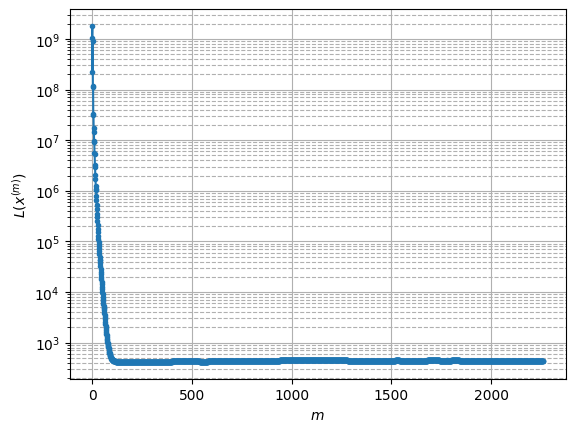

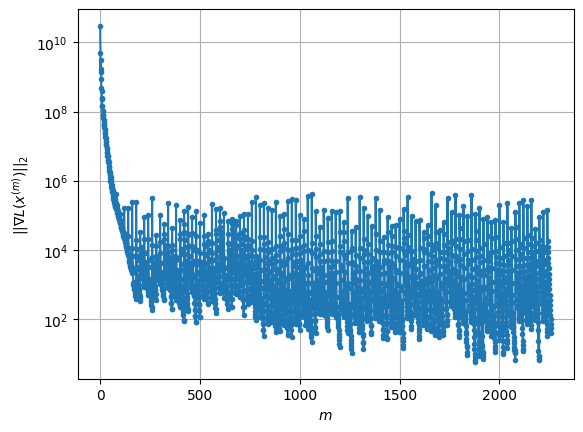

Windows:  38%|███▊      | 113/296 [1:13:52<1:53:39, 37.26s/it]

Before applying the algorithm
Cost function: 431.5813034854204
Gradient norm: 126946.68103085397
Global relative error: 1.0800074215739266
Position relative errors: 0.04760018194234774 m, 0.4617704014949394 m, 0.9617830704653317 m, 0.1608764607378801 m

Iteration 1
Cost function: 431.3115813372918 (-0.06%)
Gradient norm: 18654.277734972147 (-85.31%)
Global relative error: 1.1645987559222821 (7.83%)
Position relative errors: 0.03875784105658804 m, 0.5343224050990916 m, 1.0191665960171215 m, 0.17486045016966512 m

Iteration 2
Cost function: 431.2798879543825 (-0.01%)
Gradient norm: 6902.973508599711 (-63.00%)
Global relative error: 1.1436057773740878 (-1.80%)
Position relative errors: 0.03864848446729452 m, 0.507011349448669 m, 1.0126680338051033 m, 0.15418252858856507 m

Iteration 3
Cost function: 431.2688542707295 (-0.00%)
Gradient norm: 4030.945429979091 (-41.61%)
Global relative error: 1.161391944762303 (1.56%)
Position relative errors: 0.03850928479091955 m, 0.525427774912693 m, 1.0

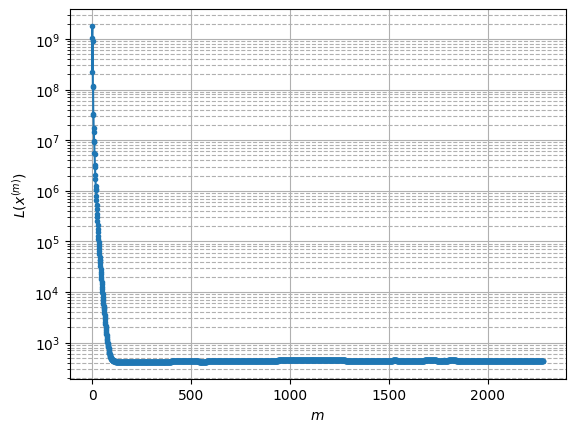

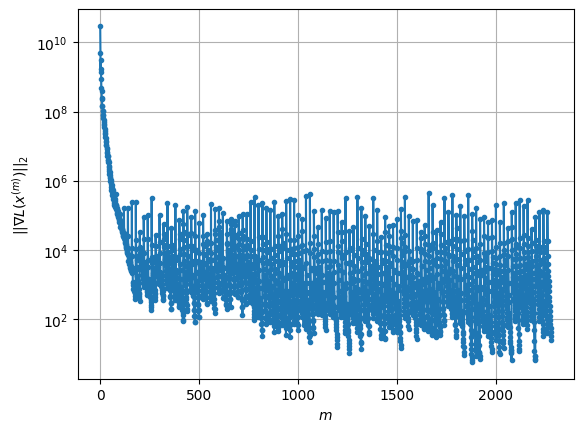

Windows:  39%|███▊      | 114/296 [1:14:28<1:51:51, 36.88s/it]

Before applying the algorithm
Cost function: 430.9280303497728
Gradient norm: 215925.95952660905
Global relative error: 1.192834042364409
Position relative errors: 0.036982263987225227 m, 0.38704549658791454 m, 1.117828279695664 m, 0.1487578981222945 m

Iteration 1
Cost function: 430.6628931821211 (-0.06%)
Gradient norm: 22276.704274304673 (-89.68%)
Global relative error: 1.1307888548970022 (-5.20%)
Position relative errors: 0.042895249080479425 m, 0.45782220939611634 m, 1.0210576472433817 m, 0.15707050445730322 m

Iteration 2
Cost function: 430.623321299401 (-0.01%)
Gradient norm: 11907.742120039276 (-46.55%)
Global relative error: 1.1327526054300596 (0.17%)
Position relative errors: 0.04286815694945011 m, 0.4882779155048541 m, 1.0064813873343514 m, 0.17279429668594046 m

Iteration 3
Cost function: 430.6047668798352 (-0.00%)
Gradient norm: 8997.004231799558 (-24.44%)
Global relative error: 1.1355239743966823 (0.24%)
Position relative errors: 0.04279229538997426 m, 0.5312564914563771 m

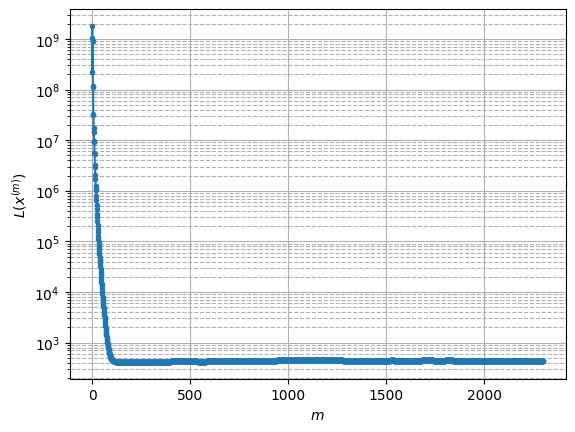

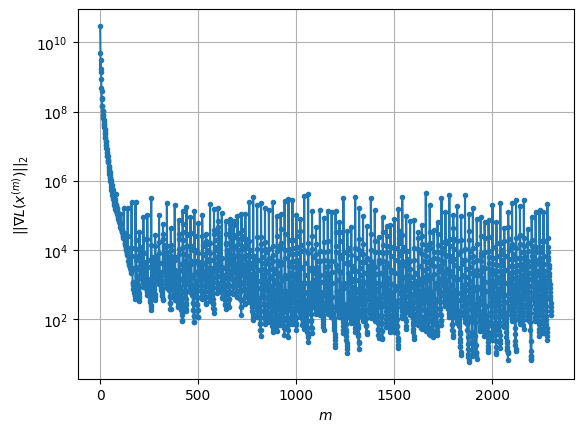

Windows:  39%|███▉      | 115/296 [1:15:03<1:49:12, 36.20s/it]

Before applying the algorithm
Cost function: 432.87983864392885
Gradient norm: 56747.62464879829
Global relative error: 1.1494956140559347
Position relative errors: 0.040828869054918074 m, 0.46057915998178467 m, 1.022794667026272 m, 0.24782445467738717 m

Iteration 1
Cost function: 432.4861755286088 (-0.09%)
Gradient norm: 26010.742843382526 (-54.16%)
Global relative error: 1.1420328556338926 (-0.65%)
Position relative errors: 0.03744242913058854 m, 0.5456934000739541 m, 0.9745044553696647 m, 0.2353331692868347 m

Iteration 2
Cost function: 432.439118613514 (-0.01%)
Gradient norm: 12276.384367216626 (-52.80%)
Global relative error: 1.1386651179784297 (-0.29%)
Position relative errors: 0.03736616967029648 m, 0.5564431569720113 m, 0.9679935556411086 m, 0.22024126626293616 m

Iteration 3
Cost function: 432.42481022845647 (-0.00%)
Gradient norm: 7973.907899842704 (-35.05%)
Global relative error: 1.1429775899121442 (0.38%)
Position relative errors: 0.03731345742548628 m, 0.5579561630128161 

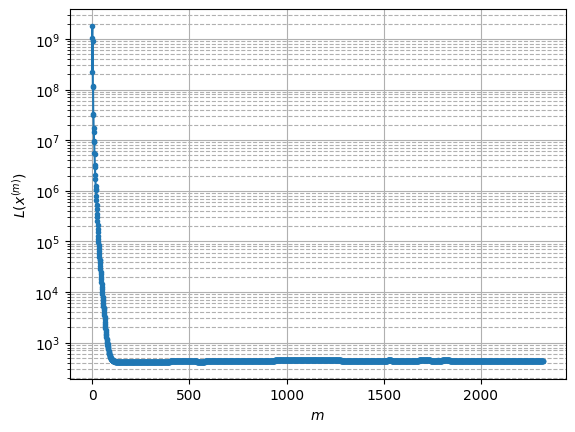

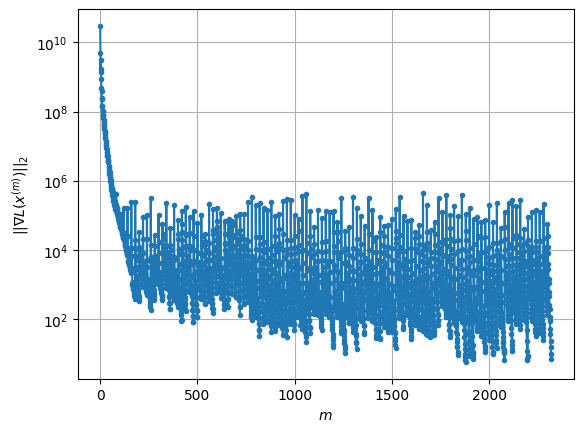

Windows:  39%|███▉      | 116/296 [1:15:38<1:47:48, 35.94s/it]

Before applying the algorithm
Cost function: 431.74414708210986
Gradient norm: 141913.17505333398
Global relative error: 1.1726547590148793
Position relative errors: 0.0355287476899306 m, 0.4378846860506861 m, 1.064492673013595 m, 0.2212546033342961 m

Iteration 1
Cost function: 431.31109509607995 (-0.10%)
Gradient norm: 16790.759441856622 (-88.17%)
Global relative error: 1.142840863990904 (-2.54%)
Position relative errors: 0.03721438345092808 m, 0.504706654959552 m, 0.9803524398086665 m, 0.29810125317885205 m

Iteration 2
Cost function: 431.213958967593 (-0.02%)
Gradient norm: 10153.172733017009 (-39.53%)
Global relative error: 1.150962183539503 (0.71%)
Position relative errors: 0.03694107511845985 m, 0.539399415972746 m, 0.9748433532474067 m, 0.2864635786947588 m

Iteration 3
Cost function: 431.1718706688243 (-0.01%)
Gradient norm: 7607.2078796340975 (-25.08%)
Global relative error: 1.1700579539866123 (1.66%)
Position relative errors: 0.03665345216452058 m, 0.5719981897964741 m, 0.96

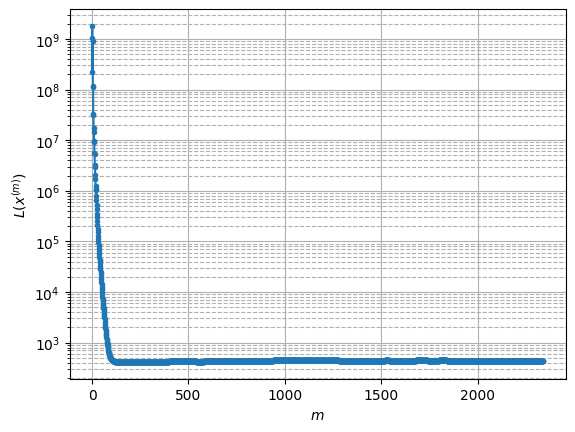

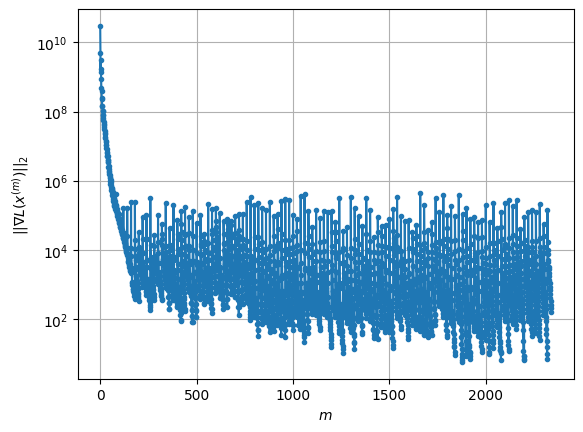

Windows:  40%|███▉      | 117/296 [1:16:16<1:49:10, 36.60s/it]

Before applying the algorithm
Cost function: 431.4125681184288
Gradient norm: 107971.47150169493
Global relative error: 1.200809985165985
Position relative errors: 0.03432907339668511 m, 0.5262866480490572 m, 0.9928048423366402 m, 0.4220309673513897 m

Iteration 1
Cost function: 431.2275413821065 (-0.04%)
Gradient norm: 24729.577794794663 (-77.10%)
Global relative error: 1.1677713222804855 (-2.75%)
Position relative errors: 0.04114075699111425 m, 0.5029911593765382 m, 0.9726245793059881 m, 0.4037111125193246 m

Iteration 2
Cost function: 431.1925659055869 (-0.01%)
Gradient norm: 13037.648405203781 (-47.28%)
Global relative error: 1.169121505217365 (0.12%)
Position relative errors: 0.041313643697129455 m, 0.49539701603338565 m, 0.9743033947597737 m, 0.4128405597318472 m

Iteration 3
Cost function: 431.1784856411771 (-0.00%)
Gradient norm: 9076.407437170834 (-30.38%)
Global relative error: 1.1560414942864647 (-1.12%)
Position relative errors: 0.04143345922212607 m, 0.48968747955408604 m,

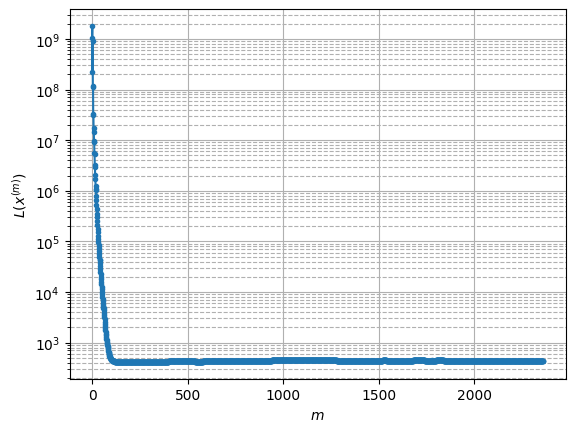

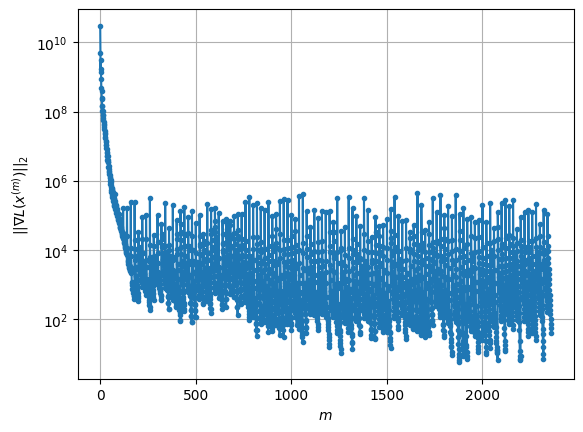

Windows:  40%|███▉      | 118/296 [1:16:51<1:47:14, 36.15s/it]

Before applying the algorithm
Cost function: 430.0787313270817
Gradient norm: 176614.2571894134
Global relative error: 1.1694448152424874
Position relative errors: 0.0396923125944459 m, 0.3873208372402447 m, 1.0443746547502983 m, 0.35394216899537223 m

Iteration 1
Cost function: 429.4743366641704 (-0.14%)
Gradient norm: 28636.921470928974 (-83.79%)
Global relative error: 1.3681266005304242 (16.99%)
Position relative errors: 0.04936150905806441 m, 0.49932656672130193 m, 1.1355869524801439 m, 0.5748338418721093 m

Iteration 2
Cost function: 429.39692784046787 (-0.02%)
Gradient norm: 15462.433833296756 (-46.01%)
Global relative error: 1.2768616899528042 (-6.67%)
Position relative errors: 0.049421488290370554 m, 0.48475759952012887 m, 1.09348884655049 m, 0.4440838931555137 m

Iteration 3
Cost function: 429.3686106108167 (-0.01%)
Gradient norm: 12723.048379627864 (-17.72%)
Global relative error: 1.3182935730170187 (3.24%)
Position relative errors: 0.04928026201489427 m, 0.48761760646833036 

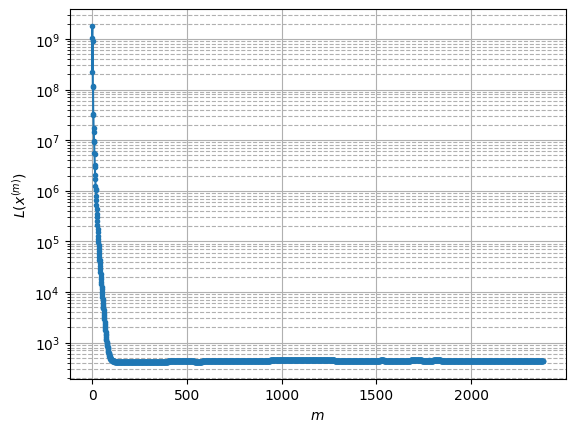

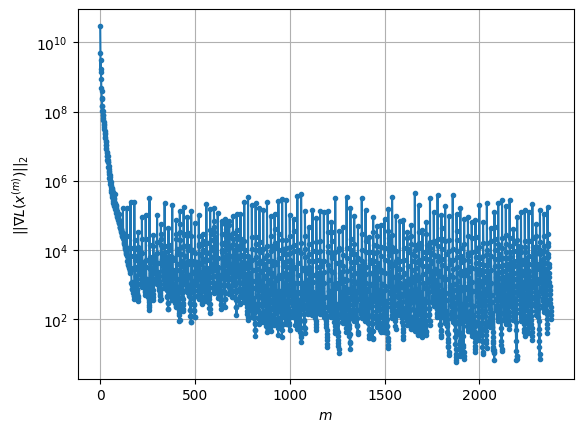

Windows:  40%|████      | 119/296 [1:17:27<1:46:25, 36.08s/it]

Before applying the algorithm
Cost function: 429.2891518574404
Gradient norm: 48072.28123886323
Global relative error: 1.3441500393105454
Position relative errors: 0.04672656856508024 m, 0.4654526212367591 m, 1.182019715630236 m, 0.43671879045805806 m

Iteration 1
Cost function: 429.00384620505656 (-0.07%)
Gradient norm: 34414.04512036261 (-28.41%)
Global relative error: 1.519491387054027 (13.04%)
Position relative errors: 0.04097658552925316 m, 0.43487415316581024 m, 1.3076547266993266 m, 0.6388135484721549 m

Iteration 2
Cost function: 428.92674119764814 (-0.02%)
Gradient norm: 18629.008938865372 (-45.87%)
Global relative error: 1.4376226716669904 (-5.39%)
Position relative errors: 0.041096369798488984 m, 0.44738030022745834 m, 1.2416967761351396 m, 0.5684138142144755 m

Iteration 3
Cost function: 428.89257135758504 (-0.01%)
Gradient norm: 16067.767428757423 (-13.75%)
Global relative error: 1.4763144567185527 (2.69%)
Position relative errors: 0.041038582114544545 m, 0.430457197028904

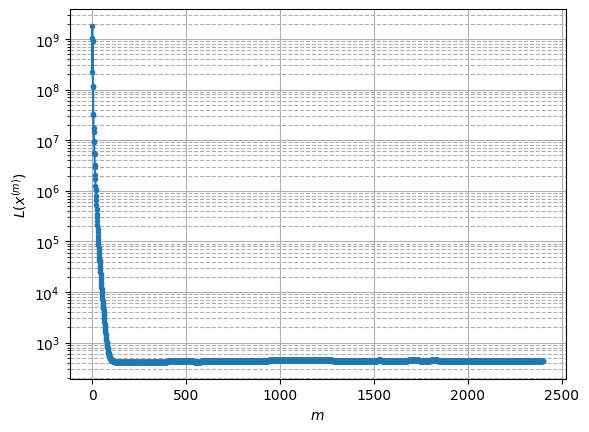

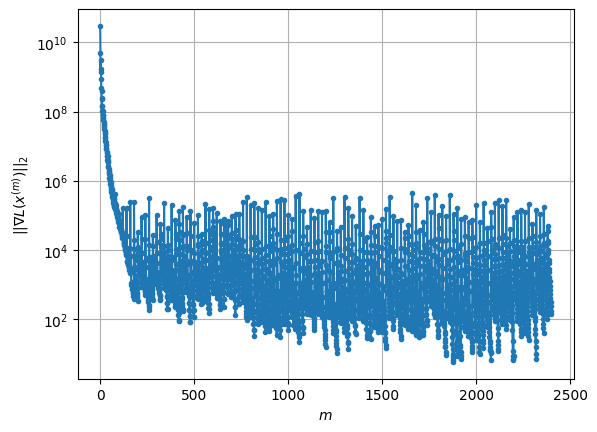

Windows:  41%|████      | 120/296 [1:18:03<1:45:22, 35.92s/it]

Before applying the algorithm
Cost function: 440.2492831951336
Gradient norm: 106039.96430963985
Global relative error: 1.4912585376922254
Position relative errors: 0.03879551482204575 m, 0.44322605008672133 m, 1.3030858299875232 m, 0.5725808339211331 m

Iteration 1
Cost function: 438.8943624331301 (-0.31%)
Gradient norm: 31472.623202001625 (-70.32%)
Global relative error: 1.3162127111375823 (-11.74%)
Position relative errors: 0.04717224524336948 m, 0.4263623869236881 m, 1.1253115462586822 m, 0.5310998146858805 m

Iteration 2
Cost function: 438.56995082204486 (-0.07%)
Gradient norm: 28743.630136263488 (-8.67%)
Global relative error: 1.4049545154572702 (6.74%)
Position relative errors: 0.04758865276544078 m, 0.32946737821581173 m, 1.2048597131765089 m, 0.6413931384367743 m

Iteration 3
Cost function: 438.43744373198183 (-0.03%)
Gradient norm: 16158.771641452817 (-43.78%)
Global relative error: 1.352610324087074 (-3.73%)
Position relative errors: 0.048040497137379824 m, 0.332269403863460

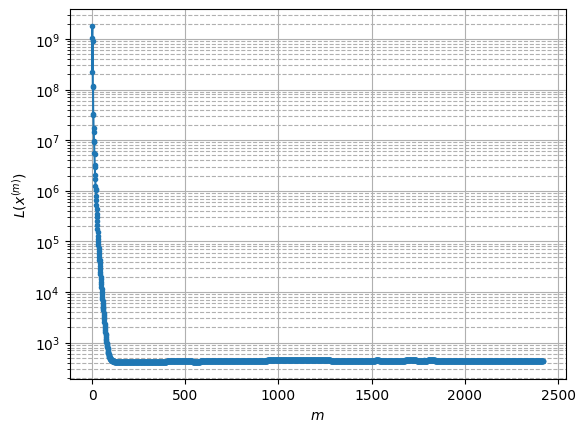

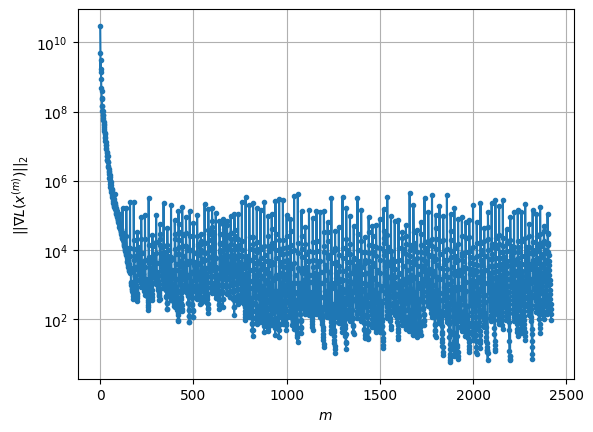

Windows:  41%|████      | 121/296 [1:18:41<1:47:04, 36.71s/it]

Before applying the algorithm
Cost function: 435.0999822336594
Gradient norm: 265046.80212204915
Global relative error: 1.4029135888829862
Position relative errors: 0.04591081432502836 m, 0.37053759960731686 m, 1.169939235635071 m, 0.678228927443318 m

Iteration 1
Cost function: 434.4238209889133 (-0.16%)
Gradient norm: 26685.79587018144 (-89.93%)
Global relative error: 0.9977976236904744 (-28.88%)
Position relative errors: 0.056948633415906655 m, 0.39701343593177085 m, 0.8715341094350472 m, 0.2741495972760378 m

Iteration 2
Cost function: 434.3055987229518 (-0.03%)
Gradient norm: 11478.73213431922 (-56.99%)
Global relative error: 1.1471900562491955 (14.97%)
Position relative errors: 0.056797087402929367 m, 0.4023439362608203 m, 0.994326756947292 m, 0.40279709354647686 m

Iteration 3
Cost function: 434.2628327833393 (-0.01%)
Gradient norm: 10420.597081719878 (-9.22%)
Global relative error: 1.0581188985071561 (-7.76%)
Position relative errors: 0.05691319870269934 m, 0.3959343537477524 m

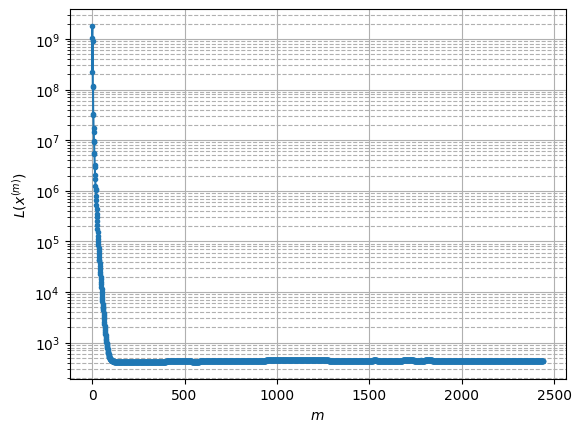

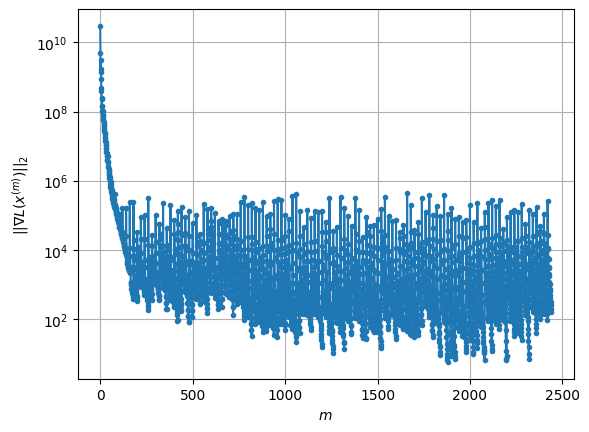

Windows:  41%|████      | 122/296 [1:19:17<1:45:19, 36.32s/it]

Before applying the algorithm
Cost function: 431.9689554261814
Gradient norm: 178036.72067212473
Global relative error: 1.1449709360629656
Position relative errors: 0.05356918465499867 m, 0.5269613140700473 m, 0.9571666246043075 m, 0.33797523585277234 m

Iteration 1
Cost function: 431.6232787840548 (-0.08%)
Gradient norm: 18117.749486492878 (-89.82%)
Global relative error: 1.1197690511217928 (-2.20%)
Position relative errors: 0.044372381958333824 m, 0.5610405705443171 m, 0.9138636094726864 m, 0.31936699392151224 m

Iteration 2
Cost function: 431.5412679071215 (-0.02%)
Gradient norm: 11214.461979870808 (-38.10%)
Global relative error: 1.237733229673993 (10.53%)
Position relative errors: 0.04443796940782366 m, 0.6412865798354551 m, 1.0201672389723333 m, 0.27930977308193494 m

Iteration 3
Cost function: 431.50396201539314 (-0.01%)
Gradient norm: 10465.733591589431 (-6.68%)
Global relative error: 1.2658636437153632 (2.27%)
Position relative errors: 0.04456696687028436 m, 0.6723475037673381

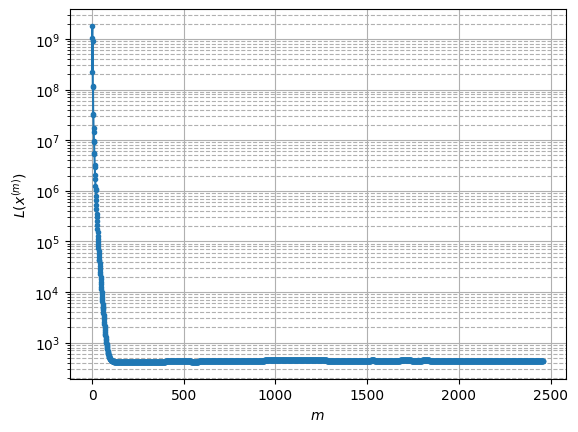

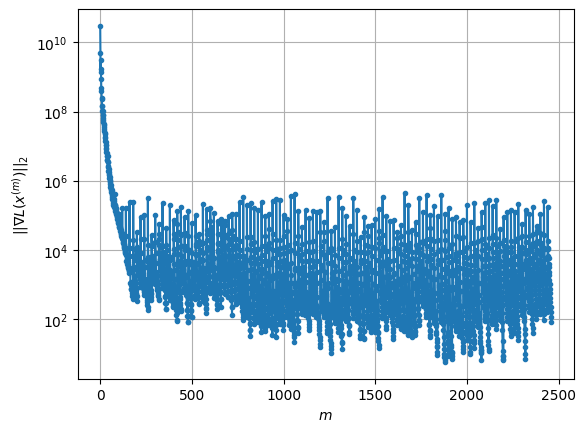

Windows:  42%|████▏     | 123/296 [1:19:53<1:45:05, 36.45s/it]

Before applying the algorithm
Cost function: 434.18153329869136
Gradient norm: 170485.05096053577
Global relative error: 1.5584632912637815
Position relative errors: 0.0420956527813131 m, 0.9361567891418258 m, 1.171703343923401 m, 0.4216068813361027 m

Iteration 1
Cost function: 433.71962611793924 (-0.11%)
Gradient norm: 24058.508141023307 (-85.89%)
Global relative error: 1.5728413371308159 (0.92%)
Position relative errors: 0.0380253317979181 m, 1.134190309802694 m, 1.0590058458001104 m, 0.2539651549329595 m

Iteration 2
Cost function: 433.6394976613799 (-0.02%)
Gradient norm: 10378.230492080282 (-56.86%)
Global relative error: 1.452780649466149 (-7.63%)
Position relative errors: 0.038061031894438636 m, 0.9713642670157441 m, 1.0379417547962824 m, 0.2970634363771136 m

Iteration 3
Cost function: 433.6151077957277 (-0.01%)
Gradient norm: 5940.374642941138 (-42.76%)
Global relative error: 1.4515950115278209 (-0.08%)
Position relative errors: 0.03812677990985008 m, 0.9989405588814398 m, 1.

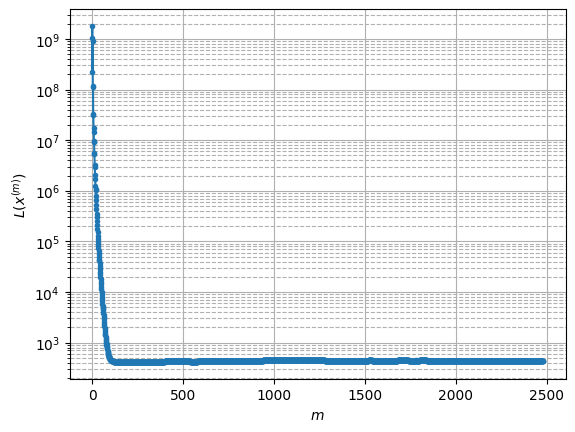

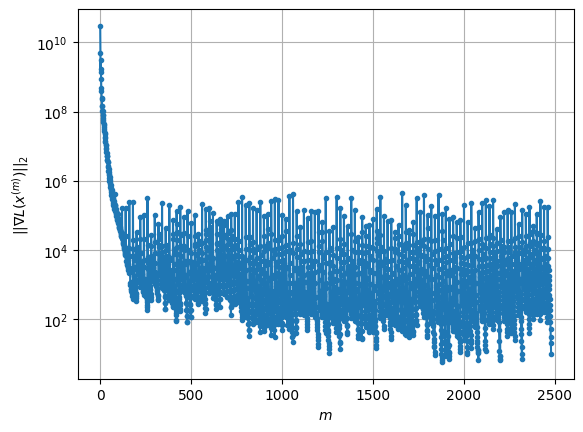

Windows:  42%|████▏     | 124/296 [1:20:29<1:43:38, 36.15s/it]

Before applying the algorithm
Cost function: 432.24304433109904
Gradient norm: 72729.22529607813
Global relative error: 1.4322507325714526
Position relative errors: 0.03579508561107944 m, 1.0056111637585359 m, 0.972679884416677 m, 0.3044620288927535 m

Iteration 1
Cost function: 431.3654488077479 (-0.20%)
Gradient norm: 12805.123166228237 (-82.39%)
Global relative error: 1.4369727542777628 (0.33%)
Position relative errors: 0.03773920070039481 m, 1.2209403307382274 m, 0.6940096453115954 m, 0.30185855433860664 m

Iteration 2
Cost function: 431.2700879651913 (-0.02%)
Gradient norm: 5332.296118253328 (-58.36%)
Global relative error: 1.3749071557321688 (-4.32%)
Position relative errors: 0.037823211633272215 m, 1.1287516565411921 m, 0.6769925959072496 m, 0.39564753711011696 m

Iteration 3
Cost function: 431.22392795449514 (-0.01%)
Gradient norm: 2147.3412932287006 (-59.73%)
Global relative error: 1.32717028188214 (-3.47%)
Position relative errors: 0.037952813456273916 m, 1.0881886793454265 m

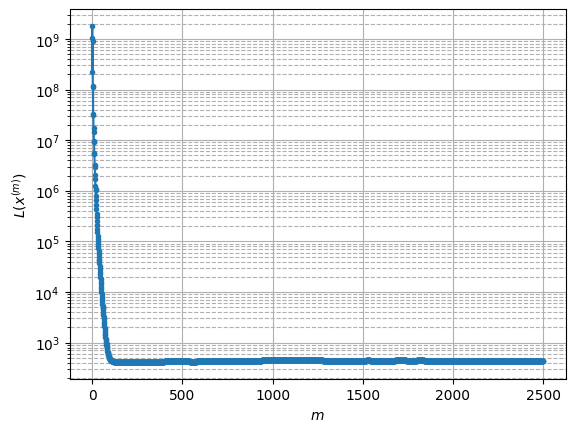

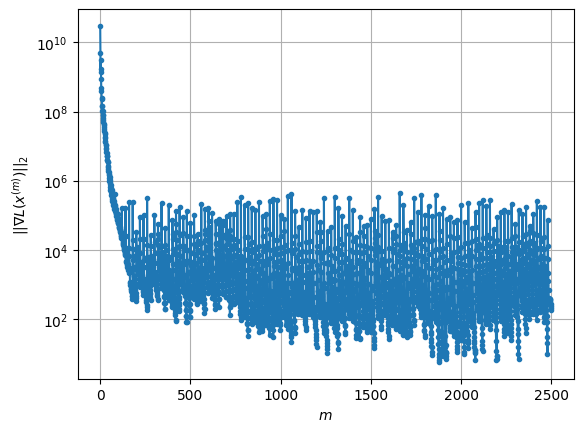

Windows:  42%|████▏     | 125/296 [1:21:06<1:43:41, 36.38s/it]

Before applying the algorithm
Cost function: 435.7751732682743
Gradient norm: 331934.1519402987
Global relative error: 1.2626058054689437
Position relative errors: 0.035711297212778534 m, 1.0159623441583552 m, 0.5114703379948602 m, 0.5469143989789068 m

Iteration 1
Cost function: 435.05845683694594 (-0.16%)
Gradient norm: 32103.427081891492 (-90.33%)
Global relative error: 1.4226840839656016 (12.68%)
Position relative errors: 0.04686021391861533 m, 1.3050334469438574 m, 0.3047883495881163 m, 0.4752093061612891 m

Iteration 2
Cost function: 434.95148574922877 (-0.02%)
Gradient norm: 17262.66210676339 (-46.23%)
Global relative error: 1.3725166234006856 (-3.53%)
Position relative errors: 0.04685895879290983 m, 1.2223375515194084 m, 0.43529751325712945 m, 0.4449848925063821 m

Iteration 3
Cost function: 434.91915503224834 (-0.01%)
Gradient norm: 7516.727561054526 (-56.46%)
Global relative error: 1.42125695724254 (3.55%)
Position relative errors: 0.047048741402911015 m, 1.2879718961777928 m

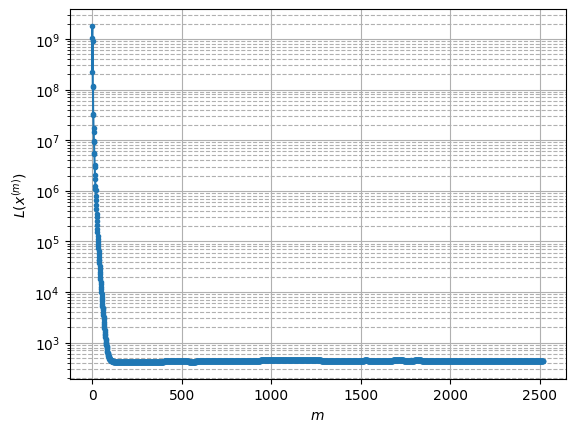

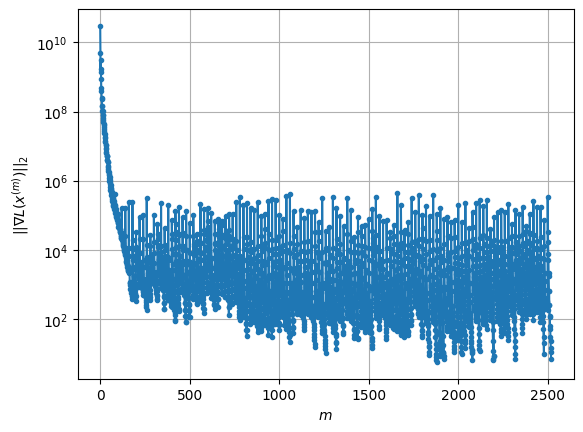

Windows:  43%|████▎     | 126/296 [1:21:42<1:42:53, 36.32s/it]

Before applying the algorithm
Cost function: 438.09886568882666
Gradient norm: 98244.2877180909
Global relative error: 1.4715533544467516
Position relative errors: 0.0442781335024342 m, 1.3362301419258378 m, 0.4036335473219177 m, 0.46376313341781444 m

Iteration 1
Cost function: 437.95876226494886 (-0.03%)
Gradient norm: 7881.665230239656 (-91.98%)
Global relative error: 1.5712424689141937 (6.77%)
Position relative errors: 0.04538200135917456 m, 1.4184815785742113 m, 0.39000112059556674 m, 0.5500465864520657 m

Iteration 2
Cost function: 437.9283792728256 (-0.01%)
Gradient norm: 6064.248287396783 (-23.06%)
Global relative error: 1.4873468614114023 (-5.34%)
Position relative errors: 0.04549961013675678 m, 1.3322923025036641 m, 0.34630691763138366 m, 0.5614248649970667 m

Iteration 3
Cost function: 437.91389689521077 (-0.00%)
Gradient norm: 5340.08015483208 (-11.94%)
Global relative error: 1.5039102210365298 (1.11%)
Position relative errors: 0.04558871851923096 m, 1.333029510277251 m, 0.

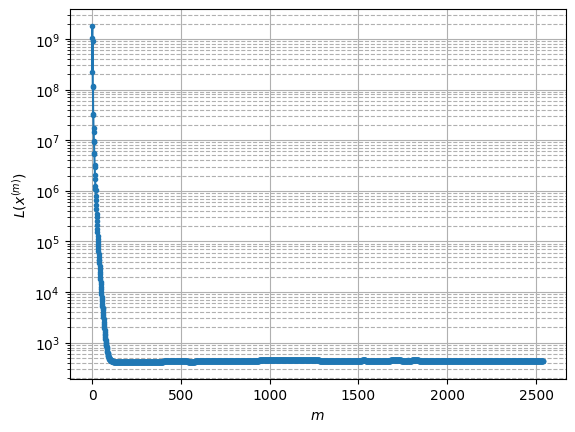

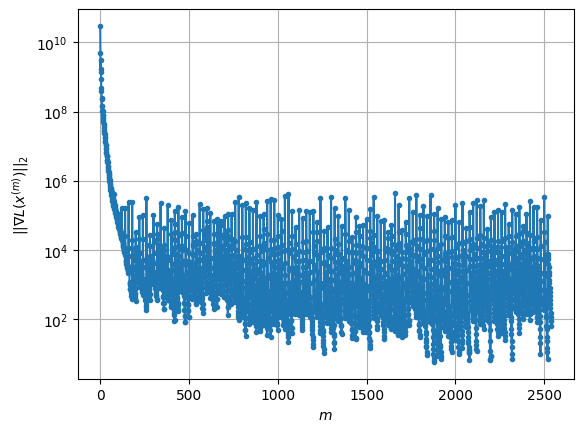

Windows:  43%|████▎     | 127/296 [1:22:18<1:41:58, 36.21s/it]

Before applying the algorithm
Cost function: 439.3808643852427
Gradient norm: 211151.6446570716
Global relative error: 1.4773788457738235
Position relative errors: 0.04282303602447912 m, 1.2769145634905403 m, 0.2854944637968953 m, 0.6846863092801447 m

Iteration 1
Cost function: 439.08715917010693 (-0.07%)
Gradient norm: 17006.29069875242 (-91.95%)
Global relative error: 1.6306471506385183 (10.37%)
Position relative errors: 0.04316911808732061 m, 1.387229188666855 m, 0.22675691133152776 m, 0.8254221372321997 m

Iteration 2
Cost function: 439.0331002265922 (-0.01%)
Gradient norm: 11800.906828589745 (-30.61%)
Global relative error: 1.4668487172006024 (-10.04%)
Position relative errors: 0.04307772623390218 m, 1.1929915534211526 m, 0.18233367776466922 m, 0.8326546866419914 m

Iteration 3
Cost function: 439.01172834572077 (-0.00%)
Gradient norm: 7822.547572486343 (-33.71%)
Global relative error: 1.542928119623443 (5.19%)
Position relative errors: 0.04307631522825162 m, 1.2249675374073794 m,

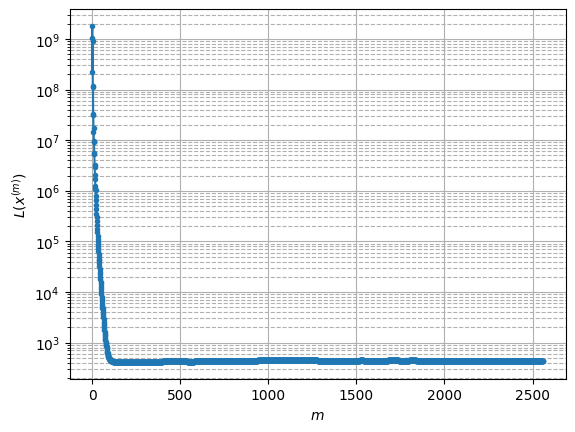

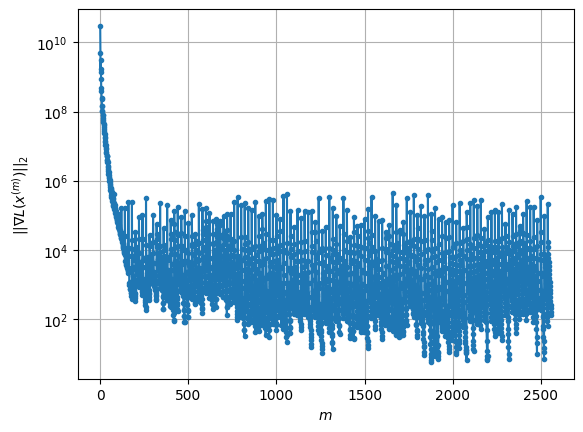

Windows:  43%|████▎     | 128/296 [1:22:54<1:40:58, 36.06s/it]

Before applying the algorithm
Cost function: 442.57629214094715
Gradient norm: 381069.76853441994
Global relative error: 1.5268466946840118
Position relative errors: 0.04029073491031168 m, 1.1214303385006774 m, 0.15563313252512767 m, 1.023625244392897 m

Iteration 1
Cost function: 442.02826381177636 (-0.12%)
Gradient norm: 36395.924940208926 (-90.45%)
Global relative error: 1.7368124580179112 (13.75%)
Position relative errors: 0.03461385137628326 m, 1.3083059789624847 m, 0.3443587733359989 m, 1.0886093507707775 m

Iteration 2
Cost function: 441.9420580262276 (-0.02%)
Gradient norm: 14341.840944516402 (-60.59%)
Global relative error: 1.6449071218413378 (-5.29%)
Position relative errors: 0.03434446674132952 m, 1.1618042955515901 m, 0.32479136948027587 m, 1.1177029245024872 m

Iteration 3
Cost function: 441.90951517940715 (-0.01%)
Gradient norm: 11181.232465654924 (-22.04%)
Global relative error: 1.7095848243372773 (3.93%)
Position relative errors: 0.03425769173029668 m, 1.176949289855693

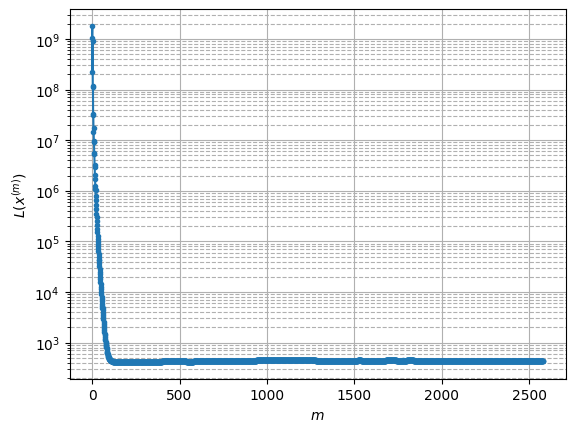

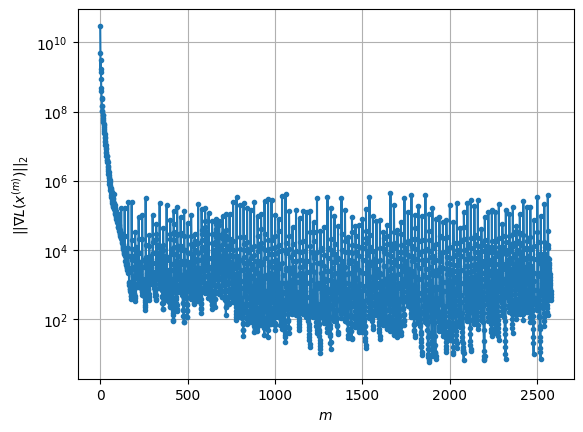

Windows:  44%|████▎     | 129/296 [1:23:32<1:41:58, 36.64s/it]

Before applying the algorithm
Cost function: 441.9800737006622
Gradient norm: 89969.26261130118
Global relative error: 1.7610629428060474
Position relative errors: 0.031779237941051766 m, 1.132919108295197 m, 0.474002221485298 m, 1.26180320413743 m

Iteration 1
Cost function: 441.3191818651162 (-0.15%)
Gradient norm: 33067.21147907349 (-63.25%)
Global relative error: 1.36131681468703 (-22.70%)
Position relative errors: 0.025636029643851227 m, 0.9043222385812211 m, 0.6094425308597411 m, 0.8144356173387476 m

Iteration 2
Cost function: 441.1661690186811 (-0.03%)
Gradient norm: 23985.993174923802 (-27.46%)
Global relative error: 1.6152965090609048 (18.66%)
Position relative errors: 0.025808289084345647 m, 1.1770216116880872 m, 0.5433590169991961 m, 0.9632736061742306 m

Iteration 3
Cost function: 441.10151706313263 (-0.01%)
Gradient norm: 18529.074994683764 (-22.75%)
Global relative error: 1.466251210814349 (-9.23%)
Position relative errors: 0.02585469784061227 m, 1.0787134753138459 m, 0.

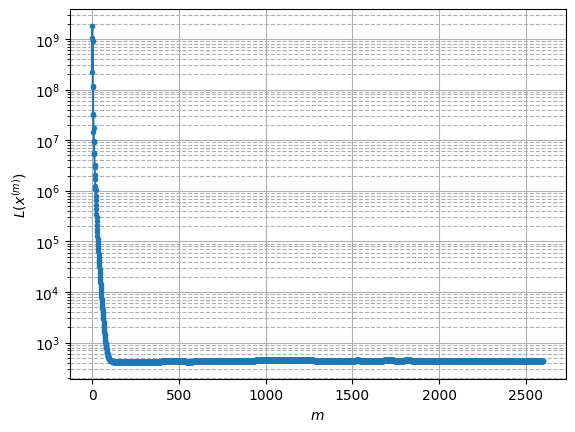

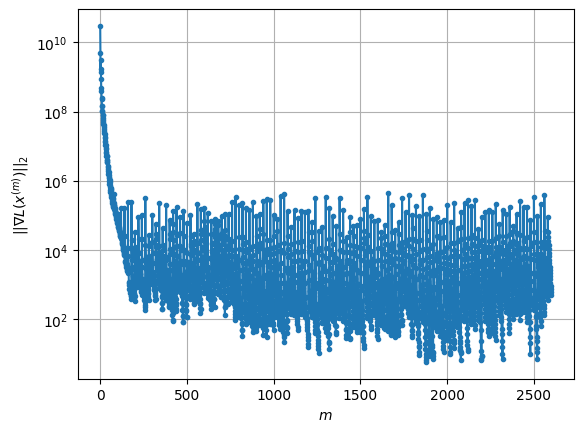

Windows:  44%|████▍     | 130/296 [1:24:07<1:40:31, 36.33s/it]

Before applying the algorithm
Cost function: 438.0796457171622
Gradient norm: 79051.31803558572
Global relative error: 1.6145217683766486
Position relative errors: 0.024185367257253166 m, 1.2706150522610165 m, 0.582705874985965 m, 0.8075179187805971 m

Iteration 1
Cost function: 437.3335295747891 (-0.17%)
Gradient norm: 31529.375404392154 (-60.12%)
Global relative error: 2.3245844758826473 (43.98%)
Position relative errors: 0.021706312157022047 m, 1.8685049355186987 m, 0.487744482759512 m, 1.2938374218771433 m

Iteration 2
Cost function: 437.1386083129293 (-0.04%)
Gradient norm: 21037.449561401165 (-33.28%)
Global relative error: 1.9077332916684244 (-17.93%)
Position relative errors: 0.02173508602405539 m, 1.5317714400331044 m, 0.5326404953216987 m, 1.0044616137193574 m

Iteration 3
Cost function: 437.0735653207837 (-0.01%)
Gradient norm: 14158.204516983305 (-32.70%)
Global relative error: 2.169688503555647 (13.73%)
Position relative errors: 0.021790916790247413 m, 1.7517806629481318 m

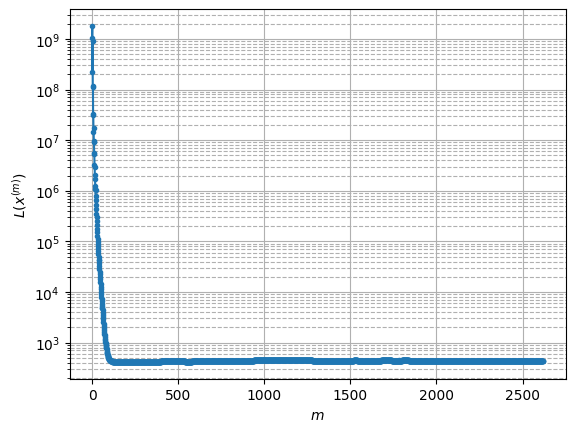

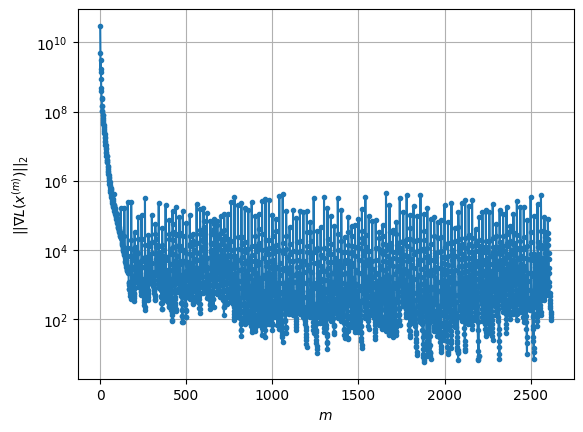

Windows:  44%|████▍     | 131/296 [1:24:43<1:39:23, 36.14s/it]

Before applying the algorithm
Cost function: 432.2276069905858
Gradient norm: 78652.41751530312
Global relative error: 2.1107576560465837
Position relative errors: 0.02067310528567828 m, 1.7098584399092887 m, 0.5313279169854666 m, 1.1175618597985881 m

Iteration 1
Cost function: 431.91232819242373 (-0.07%)
Gradient norm: 13413.30560581744 (-82.95%)
Global relative error: 2.381221643119564 (12.81%)
Position relative errors: 0.02295112168754244 m, 2.045882215835599 m, 0.5058090468340126 m, 1.108247248611852 m

Iteration 2
Cost function: 431.84021002510144 (-0.02%)
Gradient norm: 8524.730271026378 (-36.45%)
Global relative error: 2.298191334850672 (-3.49%)
Position relative errors: 0.02317312522573925 m, 2.043078881928985 m, 0.4795652599409951 m, 0.9364781377534243 m

Iteration 3
Cost function: 431.81474724781276 (-0.01%)
Gradient norm: 3417.3494087185027 (-59.91%)
Global relative error: 2.3799339380091546 (3.56%)
Position relative errors: 0.0233647340422529 m, 2.1320263781940247 m, 0.476

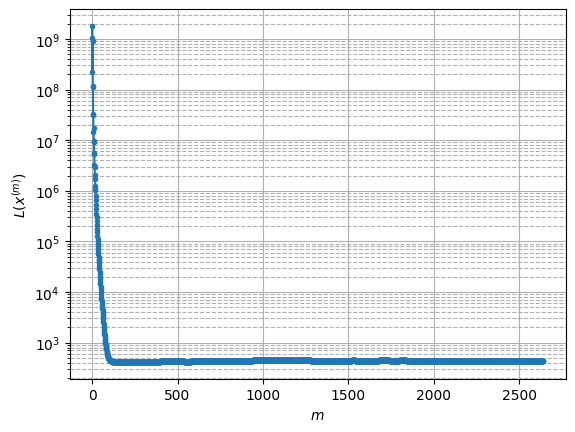

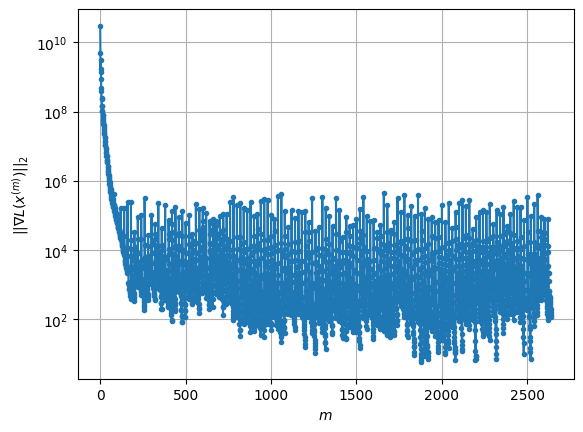

Windows:  45%|████▍     | 132/296 [1:25:19<1:38:51, 36.17s/it]

Before applying the algorithm
Cost function: 428.4290585219202
Gradient norm: 102718.64713079236
Global relative error: 2.4048535669202535
Position relative errors: 0.022094231153283433 m, 2.167467829999984 m, 0.49114608653531644 m, 0.9185262246288192 m

Iteration 1
Cost function: 427.70893955111256 (-0.17%)
Gradient norm: 32739.98999113569 (-68.13%)
Global relative error: 3.100940755454016 (28.95%)
Position relative errors: 0.022046961147181382 m, 2.6883242222927155 m, 0.4635284273778541 m, 1.4742459523854006 m

Iteration 2
Cost function: 427.5545559550374 (-0.04%)
Gradient norm: 23252.879849005847 (-28.98%)
Global relative error: 2.7528908867910986 (-11.22%)
Position relative errors: 0.021866569035811707 m, 2.423889400418457 m, 0.4617708438484242 m, 1.2204332820009653 m

Iteration 3
Cost function: 427.5036105830837 (-0.01%)
Gradient norm: 13721.942761673186 (-40.99%)
Global relative error: 2.967200301354437 (7.78%)
Position relative errors: 0.021758152252462755 m, 2.60331376515696 m,

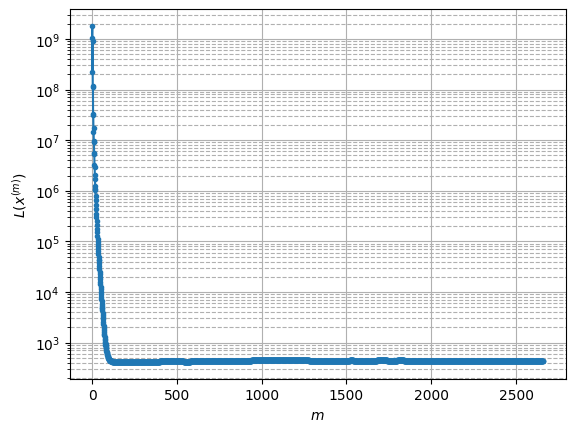

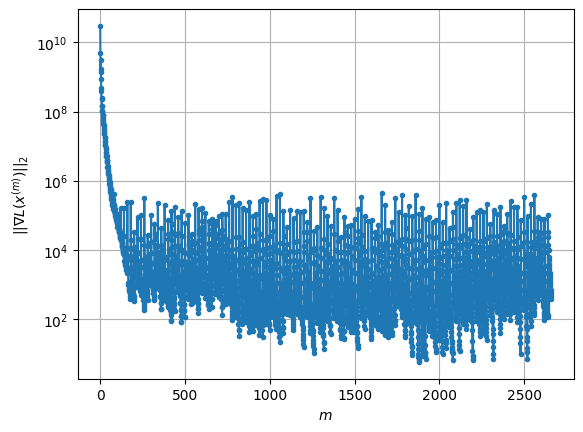

Windows:  45%|████▍     | 133/296 [1:25:57<1:40:00, 36.81s/it]

Before applying the algorithm
Cost function: 429.5605474626421
Gradient norm: 204216.92150820297
Global relative error: 2.9483743076563607
Position relative errors: 0.020259356999964114 m, 2.650441236024766 m, 0.4444259491773681 m, 1.212496208037975 m

Iteration 1
Cost function: 428.9233713443929 (-0.15%)
Gradient norm: 44718.185565956504 (-78.10%)
Global relative error: 2.847077743766752 (-3.44%)
Position relative errors: 0.015877026904793833 m, 2.4824136660865244 m, 0.37451102133017705 m, 1.3427445288146393 m

Iteration 2
Cost function: 428.8288142263292 (-0.02%)
Gradient norm: 24417.433435359748 (-45.40%)
Global relative error: 2.7741647079779566 (-2.56%)
Position relative errors: 0.015884699543795146 m, 2.3308457096044997 m, 0.4055955431807834 m, 1.4485811855339954 m

Iteration 3
Cost function: 428.7973020918477 (-0.01%)
Gradient norm: 16368.885811458751 (-32.96%)
Global relative error: 2.8035841093567315 (1.06%)
Position relative errors: 0.015862479629031315 m, 2.3217078289905637 

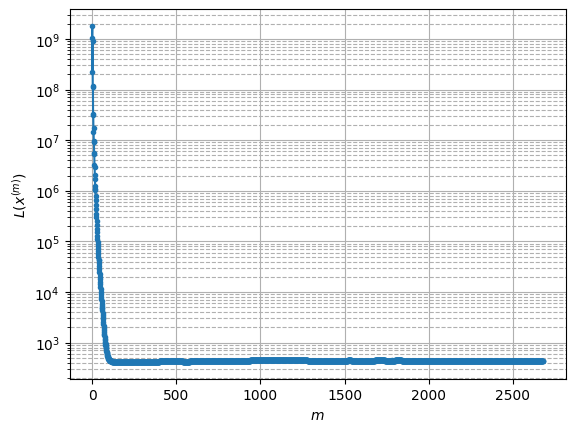

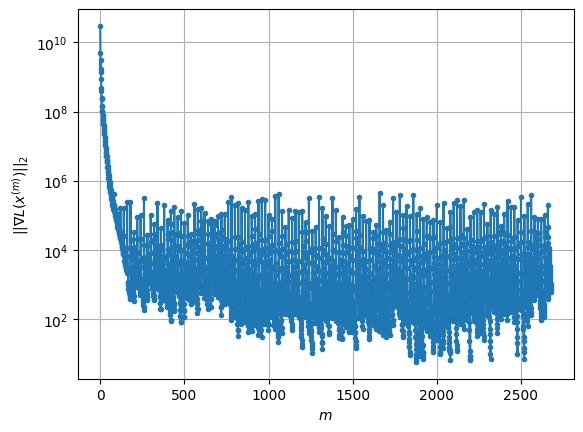

Windows:  45%|████▌     | 134/296 [1:26:33<1:38:43, 36.57s/it]

Before applying the algorithm
Cost function: 432.7223992128758
Gradient norm: 264284.37040591205
Global relative error: 2.7339537903122544
Position relative errors: 0.015594468129435426 m, 2.1537939398453427 m, 0.4524485988267223 m, 1.6219498338469924 m

Iteration 1
Cost function: 432.1121814761147 (-0.14%)
Gradient norm: 33843.00176135957 (-87.19%)
Global relative error: 2.27752610884045 (-16.69%)
Position relative errors: 0.014408257402435343 m, 1.6441186642958574 m, 0.3594876395021537 m, 1.5344574093218495 m

Iteration 2
Cost function: 432.00071669163725 (-0.03%)
Gradient norm: 13115.873334121461 (-61.24%)
Global relative error: 2.4961979363777065 (9.60%)
Position relative errors: 0.014569581667296815 m, 1.746440611516445 m, 0.3576949827330529 m, 1.747223752914347 m

Iteration 3
Cost function: 431.96130781367197 (-0.01%)
Gradient norm: 11118.189450111795 (-15.23%)
Global relative error: 2.3714700873938726 (-5.00%)
Position relative errors: 0.014690158023850522 m, 1.621056985898173 m

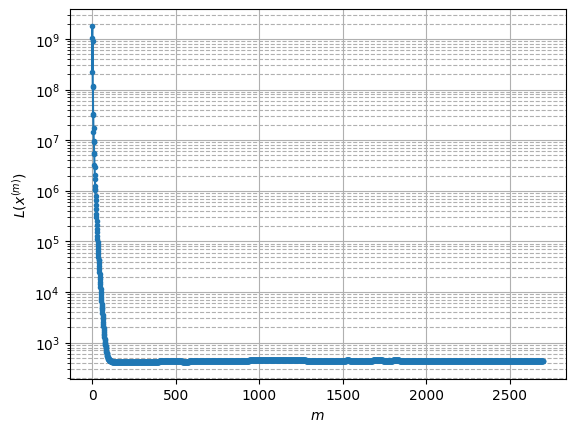

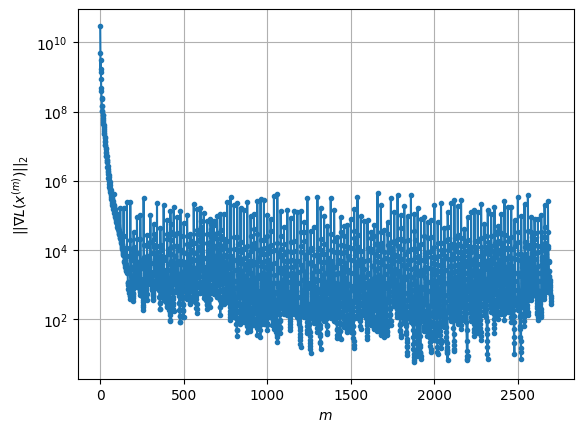

Windows:  46%|████▌     | 135/296 [1:27:09<1:37:41, 36.41s/it]

Before applying the algorithm
Cost function: 435.3883239991213
Gradient norm: 35336.36188829295
Global relative error: 2.4065031554600966
Position relative errors: 0.015324575271520804 m, 1.6671291233251868 m, 0.35257927430968833 m, 1.6992323217835243 m

Iteration 1
Cost function: 435.1235508033565 (-0.06%)
Gradient norm: 7952.246792260016 (-77.50%)
Global relative error: 2.4300215963499348 (0.98%)
Position relative errors: 0.016015126784629904 m, 1.880994652390895 m, 0.3785004339225612 m, 1.4910883749540564 m

Iteration 2
Cost function: 435.0877474858435 (-0.01%)
Gradient norm: 6596.4687611637155 (-17.05%)
Global relative error: 2.4323692766939606 (0.10%)
Position relative errors: 0.015951938052038556 m, 1.964262704052152 m, 0.36964834929089463 m, 1.3860726811224915 m

Iteration 3
Cost function: 435.07484464647894 (-0.00%)
Gradient norm: 5826.317720711109 (-11.68%)
Global relative error: 2.455289066108579 (0.94%)
Position relative errors: 0.01590985376831197 m, 2.0259893288720643 m, 0

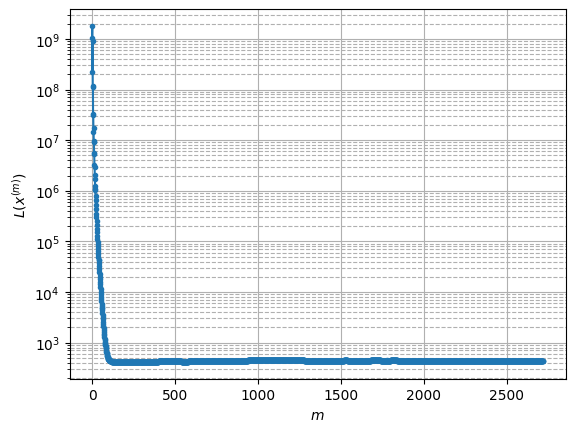

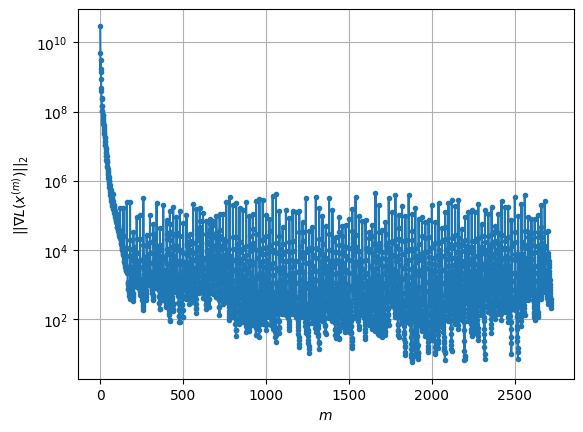

Windows:  46%|████▌     | 136/296 [1:27:46<1:36:51, 36.32s/it]

Before applying the algorithm
Cost function: 435.64263322737924
Gradient norm: 48108.21506608188
Global relative error: 2.470726315474941
Position relative errors: 0.01628724521572594 m, 2.119265038681043 m, 0.3788101010809672 m, 1.212205119280408 m

Iteration 1
Cost function: 435.2628293140934 (-0.09%)
Gradient norm: 11852.920176008744 (-75.36%)
Global relative error: 2.271520338787511 (-8.06%)
Position relative errors: 0.01701848498537046 m, 2.064891943847914 m, 0.23588799285481055 m, 0.91656560202496 m

Iteration 2
Cost function: 435.20299377454955 (-0.01%)
Gradient norm: 11467.502805710514 (-3.25%)
Global relative error: 2.4234597329172423 (6.69%)
Position relative errors: 0.01697440837868033 m, 2.2202183353908707 m, 0.24972592614400219 m, 0.9386883387479025 m

Iteration 3
Cost function: 435.18607118189664 (-0.00%)
Gradient norm: 6621.765024664012 (-42.26%)
Global relative error: 2.3676295931925533 (-2.30%)
Position relative errors: 0.016992312320364033 m, 2.1984609729182907 m, 0.2

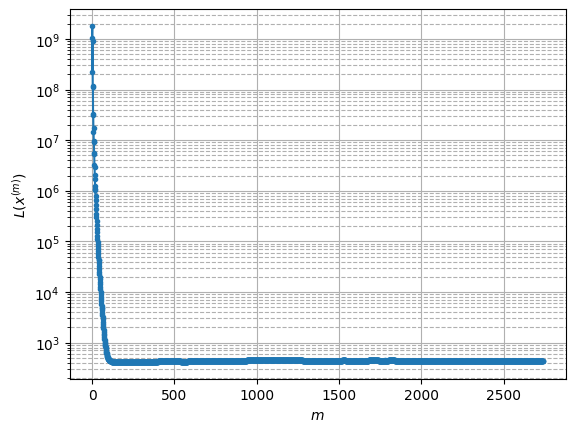

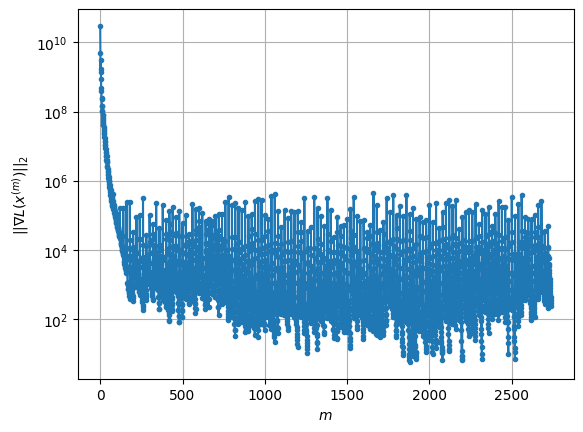

Windows:  46%|████▋     | 137/296 [1:28:23<1:37:10, 36.67s/it]

Before applying the algorithm
Cost function: 436.89490938371756
Gradient norm: 101303.11590516087
Global relative error: 2.378075160455749
Position relative errors: 0.017689551038667563 m, 2.223511060281432 m, 0.23792168282857745 m, 0.8089002049912644 m

Iteration 1
Cost function: 436.47348725828283 (-0.10%)
Gradient norm: 17293.95785847782 (-82.93%)
Global relative error: 2.1242204140393723 (-10.67%)
Position relative errors: 0.02219014891211575 m, 1.9576665328536376 m, 0.21312793715322279 m, 0.7962019462216446 m

Iteration 2
Cost function: 436.41762878153986 (-0.01%)
Gradient norm: 5967.524073509664 (-65.49%)
Global relative error: 2.1387503768585305 (0.68%)
Position relative errors: 0.02230689612131443 m, 1.9094367201351206 m, 0.21686079080518988 m, 0.9384975587345405 m

Iteration 3
Cost function: 436.4011880167026 (-0.00%)
Gradient norm: 3514.1111503695333 (-41.11%)
Global relative error: 2.0899626173395136 (-2.28%)
Position relative errors: 0.02242447016866417 m, 1.846613519620709

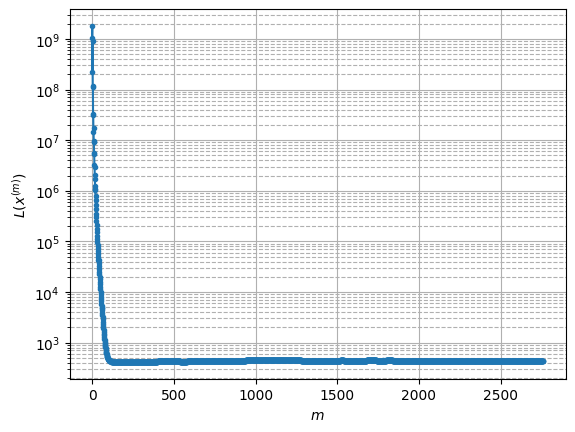

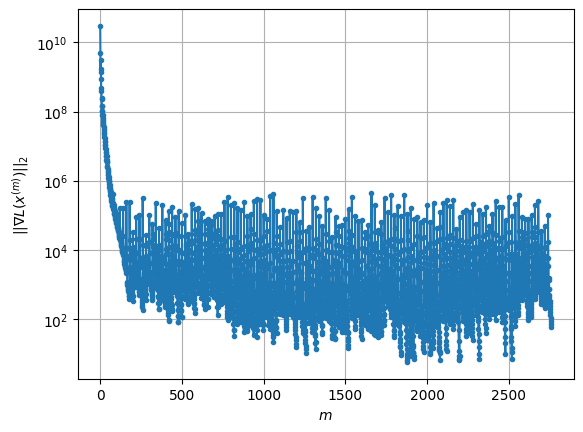

Windows:  47%|████▋     | 138/296 [1:28:59<1:36:04, 36.48s/it]

Before applying the algorithm
Cost function: 438.1152375360638
Gradient norm: 64288.889834208254
Global relative error: 2.051808162057134
Position relative errors: 0.02355316543209173 m, 1.7921296627524135 m, 0.2337200775562694 m, 0.9710856870909866 m

Iteration 1
Cost function: 437.7857294148815 (-0.08%)
Gradient norm: 20486.93417744887 (-68.13%)
Global relative error: 2.0366618856189227 (-0.74%)
Position relative errors: 0.03226086140413078 m, 1.8545019697592635 m, 0.19312357070909092 m, 0.8188257418310194 m

Iteration 2
Cost function: 437.76138619094814 (-0.01%)
Gradient norm: 9676.785648816302 (-52.77%)
Global relative error: 2.0365787987418513 (-0.00%)
Position relative errors: 0.032238540993433526 m, 1.8725445527469364 m, 0.19238762981522947 m, 0.776644573442468 m

Iteration 3
Cost function: 437.75230003159794 (-0.00%)
Gradient norm: 8418.473798915084 (-13.00%)
Global relative error: 2.061904539678342 (1.24%)
Position relative errors: 0.03222751547658566 m, 1.9049696087968906 m, 

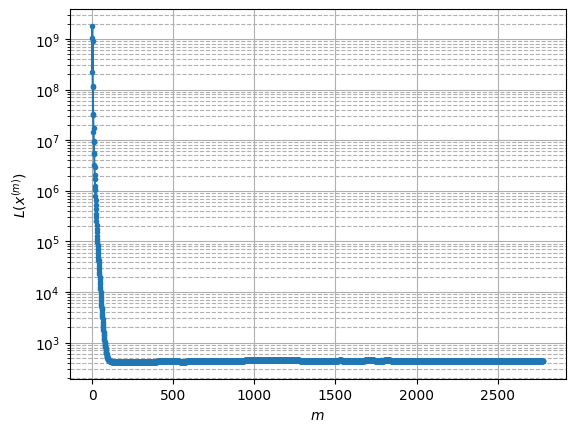

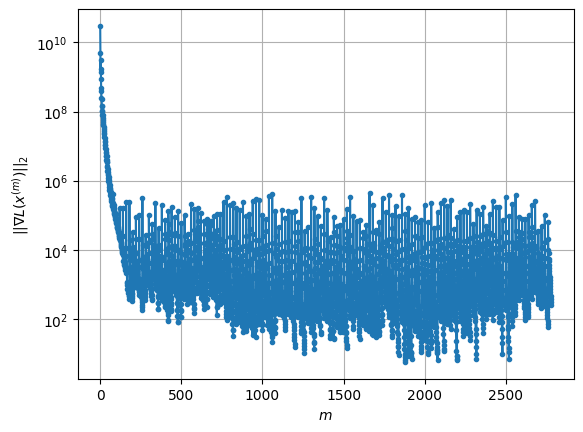

Windows:  47%|████▋     | 139/296 [1:29:35<1:35:15, 36.41s/it]

Before applying the algorithm
Cost function: 436.3462139650036
Gradient norm: 229040.04368144268
Global relative error: 2.017077340852265
Position relative errors: 0.03272598042327849 m, 1.8798335359588623 m, 0.17898043949205136 m, 0.7083224389129684 m

Iteration 1
Cost function: 436.15535937981235 (-0.04%)
Gradient norm: 14164.124582256556 (-93.82%)
Global relative error: 1.937732997988703 (-3.93%)
Position relative errors: 0.022969343139439064 m, 1.8141414054190328 m, 0.12106886438468173 m, 0.6697114876261773 m

Iteration 2
Cost function: 436.1387145404772 (-0.00%)
Gradient norm: 9431.910601046678 (-33.41%)
Global relative error: 1.9430129264688307 (0.27%)
Position relative errors: 0.022967278784987027 m, 1.8126753488933247 m, 0.13008780615799578 m, 0.687063015340929 m

Iteration 3
Cost function: 436.13028454889417 (-0.00%)
Gradient norm: 8117.404059875958 (-13.94%)
Global relative error: 1.9322829298644946 (-0.55%)
Position relative errors: 0.0229589454987976 m, 1.7987840390990129 m

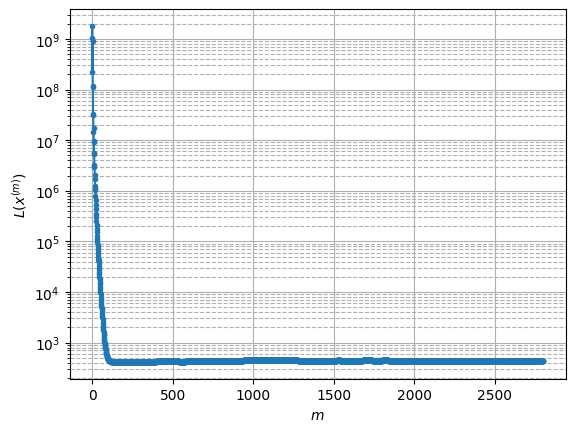

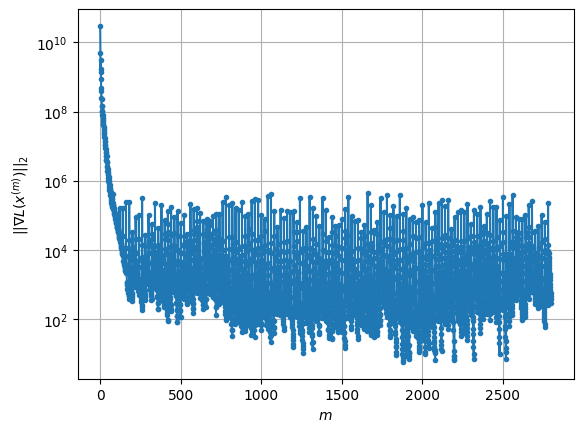

Windows:  47%|████▋     | 140/296 [1:30:14<1:36:06, 36.96s/it]

Before applying the algorithm
Cost function: 434.93374946800253
Gradient norm: 155774.2825560456
Global relative error: 1.8588211838203923
Position relative errors: 0.02356172908749416 m, 1.7254897063782646 m, 0.12986303243055664 m, 0.67858695854097 m

Iteration 1
Cost function: 434.5728463732596 (-0.08%)
Gradient norm: 17401.302658861743 (-88.83%)
Global relative error: 1.9025182412754191 (2.35%)
Position relative errors: 0.034271252756772466 m, 1.759781014696736 m, 0.19408287160299126 m, 0.6956305997202032 m

Iteration 2
Cost function: 434.5411910829155 (-0.01%)
Gradient norm: 7276.9610181422795 (-58.18%)
Global relative error: 1.8946294476286454 (-0.41%)
Position relative errors: 0.034431312046698526 m, 1.7637470693861848 m, 0.1786028871798116 m, 0.6676307238966602 m

Iteration 3
Cost function: 434.5342365840125 (-0.00%)
Gradient norm: 4595.059008756407 (-36.85%)
Global relative error: 1.9042323935516985 (0.51%)
Position relative errors: 0.03440062599692702 m, 1.7697072280114161 m, 

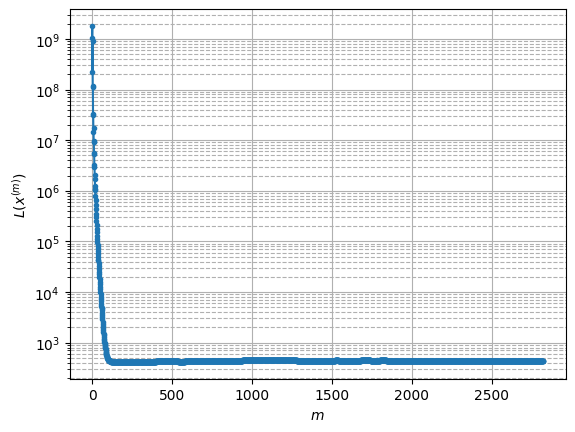

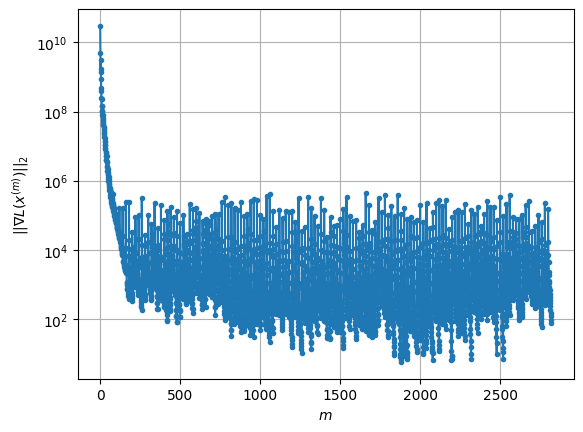

Windows:  48%|████▊     | 141/296 [1:30:49<1:34:29, 36.58s/it]

Before applying the algorithm
Cost function: 435.2144823185631
Gradient norm: 200016.17083893158
Global relative error: 1.8508970861257592
Position relative errors: 0.03456608806804963 m, 1.740210440814521 m, 0.17752262339954464 m, 0.603967369710601 m

Iteration 1
Cost function: 434.34349650468386 (-0.20%)
Gradient norm: 26603.46667890296 (-86.70%)
Global relative error: 2.0092063266476177 (8.55%)
Position relative errors: 0.05005722811225644 m, 1.743756704654901 m, 0.30268156262709783 m, 0.9497887216371821 m

Iteration 2
Cost function: 434.25758149295 (-0.02%)
Gradient norm: 16442.491988325368 (-38.19%)
Global relative error: 1.9218326009514652 (-4.35%)
Position relative errors: 0.05041227686255614 m, 1.6369406087180098 m, 0.2727975927889898 m, 0.9679380862668095 m

Iteration 3
Cost function: 434.23433286907647 (-0.01%)
Gradient norm: 5683.387916330159 (-65.43%)
Global relative error: 1.9360793710575797 (0.74%)
Position relative errors: 0.050541332356202055 m, 1.6099041500245082 m, 0.

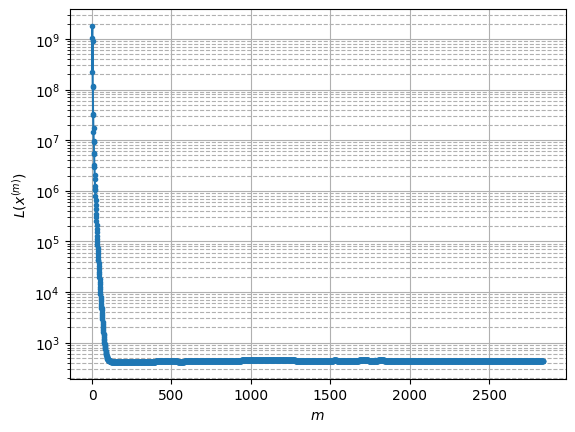

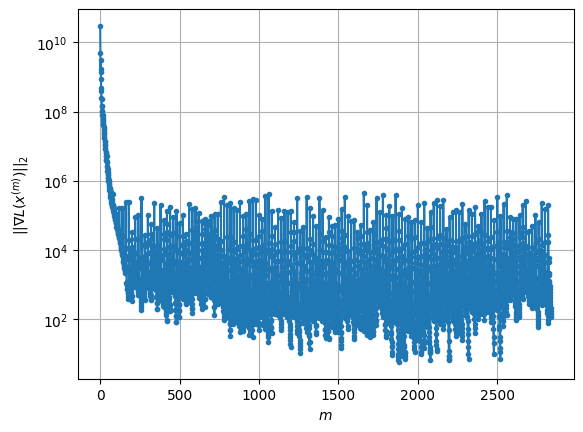

Windows:  48%|████▊     | 142/296 [1:31:25<1:33:08, 36.29s/it]

Before applying the algorithm
Cost function: 429.5892461743954
Gradient norm: 26789.83072491205
Global relative error: 1.8405467578491685
Position relative errors: 0.0502768916429158 m, 1.515461416411773 m, 0.2877620135563357 m, 1.0028220691387064 m

Iteration 1
Cost function: 429.3647762999333 (-0.05%)
Gradient norm: 13431.187187163248 (-49.86%)
Global relative error: 1.7977705060441882 (-2.32%)
Position relative errors: 0.05693120471491704 m, 1.5075400223924602 m, 0.21090371265954208 m, 0.9547658029617226 m

Iteration 2
Cost function: 429.3475942604462 (-0.00%)
Gradient norm: 6983.618201951454 (-48.00%)
Global relative error: 1.7535860805219732 (-2.46%)
Position relative errors: 0.0570112204959294 m, 1.4758120028250654 m, 0.21686848724721894 m, 0.9201946717025128 m

Iteration 3
Cost function: 429.3406979268805 (-0.00%)
Gradient norm: 4997.154267906757 (-28.44%)
Global relative error: 1.7864670941545013 (1.88%)
Position relative errors: 0.057094598707469586 m, 1.5045659431985778 m, 0.

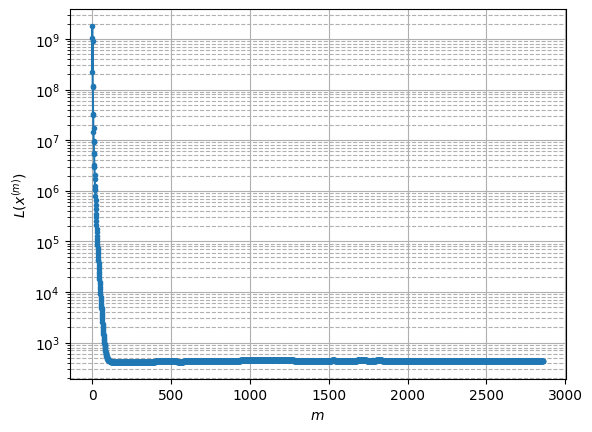

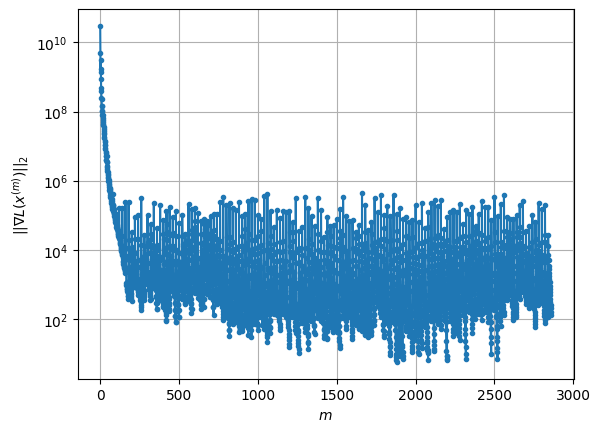

Windows:  48%|████▊     | 143/296 [1:32:01<1:32:16, 36.18s/it]

Before applying the algorithm
Cost function: 426.1222079771691
Gradient norm: 138953.03842186285
Global relative error: 1.6969694575956238
Position relative errors: 0.056400848298893864 m, 1.4739138270503143 m, 0.1920268308048385 m, 0.8168383599086634 m

Iteration 1
Cost function: 425.8140739151162 (-0.07%)
Gradient norm: 16888.61429747511 (-87.85%)
Global relative error: 1.5557316704795594 (-8.32%)
Position relative errors: 0.05100500390788195 m, 1.4110032119711127 m, 0.20279394611452878 m, 0.6209998137841312 m

Iteration 2
Cost function: 425.7763348388356 (-0.01%)
Gradient norm: 6746.261221784837 (-60.05%)
Global relative error: 1.591344188925348 (2.29%)
Position relative errors: 0.051384253736770545 m, 1.4475061389278117 m, 0.2126815424556575 m, 0.6238792447717939 m

Iteration 3
Cost function: 425.76622494655567 (-0.00%)
Gradient norm: 3366.3963423181654 (-50.10%)
Global relative error: 1.5755537968468454 (-0.99%)
Position relative errors: 0.051487857478301584 m, 1.4369403003225976 

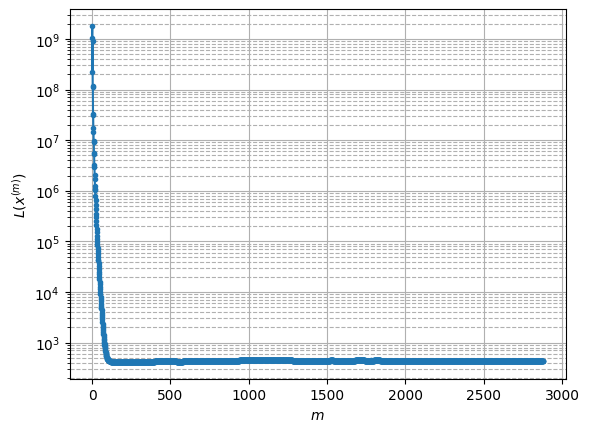

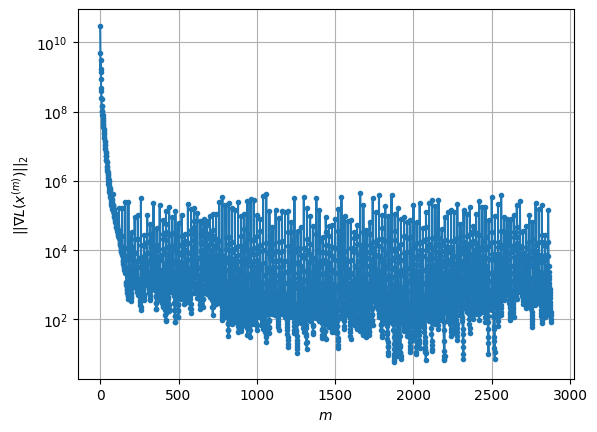

Windows:  49%|████▊     | 144/296 [1:32:39<1:33:19, 36.84s/it]

Before applying the algorithm
Cost function: 426.41644325088026
Gradient norm: 120473.42751274457
Global relative error: 1.5153760464473365
Position relative errors: 0.0510009176643328 m, 1.418799955861867 m, 0.19369739487526932 m, 0.4932017676757956 m

Iteration 1
Cost function: 426.27392843186476 (-0.03%)
Gradient norm: 2181.72115741638 (-98.19%)
Global relative error: 1.5205870689019803 (0.34%)
Position relative errors: 0.041321308201601556 m, 1.441889324723708 m, 0.19325144026878016 m, 0.44054835630061917 m

Iteration 2
Cost function: 426.26830242567786 (-0.00%)
Gradient norm: 1673.7613119613186 (-23.28%)
Global relative error: 1.5093789999944405 (-0.74%)
Position relative errors: 0.04115322991872645 m, 1.4334216114739113 m, 0.1951352084591612 m, 0.4286634063911925 m

Iteration 3
Cost function: 426.2663969720982 (-0.00%)
Gradient norm: 1226.068800956081 (-26.75%)
Global relative error: 1.5293189207277347 (1.32%)
Position relative errors: 0.04106974419534518 m, 1.4520687405179573 m,

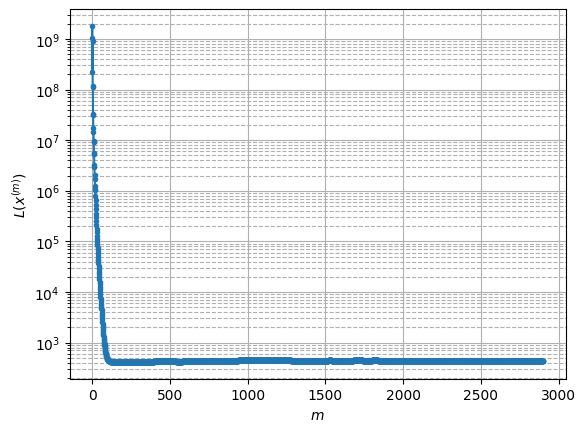

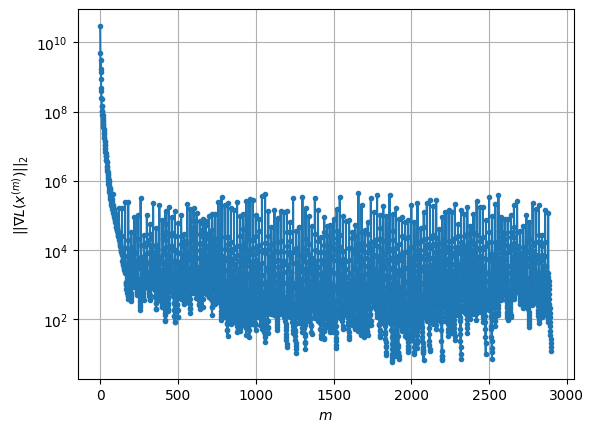

Windows:  49%|████▉     | 145/296 [1:33:15<1:31:57, 36.54s/it]

Before applying the algorithm
Cost function: 426.2997804446111
Gradient norm: 82743.3276940766
Global relative error: 1.4668384680606728
Position relative errors: 0.04037503525310529 m, 1.407622852778954 m, 0.20490643639308836 m, 0.35579793360151846 m

Iteration 1
Cost function: 425.68932436000733 (-0.14%)
Gradient norm: 31856.379095937773 (-61.50%)
Global relative error: 1.2987186434134228 (-11.46%)
Position relative errors: 0.03957158659193803 m, 1.2284630819313944 m, 0.2815338562186826 m, 0.3109946532622972 m

Iteration 2
Cost function: 425.6182673279827 (-0.02%)
Gradient norm: 13737.99113099169 (-56.88%)
Global relative error: 1.4522452409373943 (11.82%)
Position relative errors: 0.03981573294291355 m, 1.3895758218867678 m, 0.2762007183434103 m, 0.3165746283377888 m

Iteration 3
Cost function: 425.6042644171923 (-0.00%)
Gradient norm: 7336.393381301979 (-46.60%)
Global relative error: 1.3614768810895448 (-6.25%)
Position relative errors: 0.03969061393391642 m, 1.297580122838202 m, 

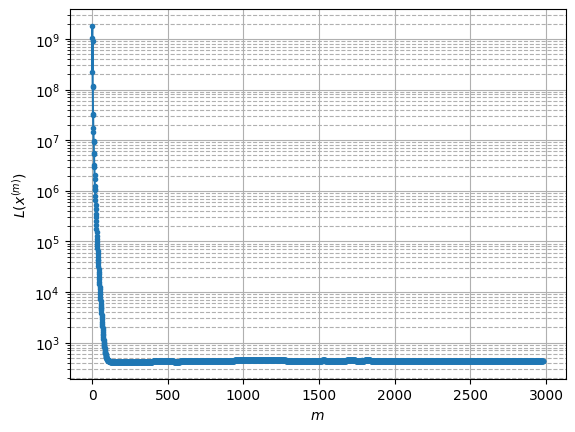

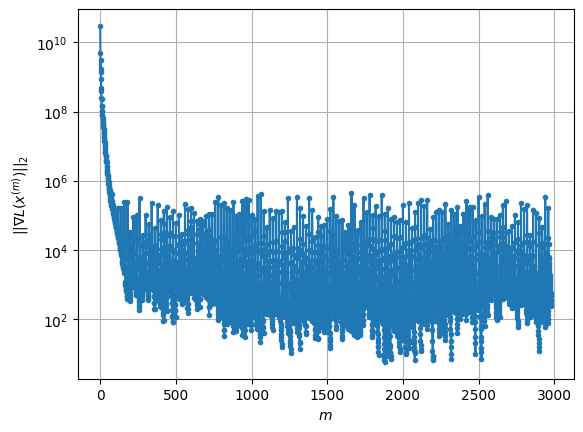

Windows:  50%|█████     | 149/296 [1:35:42<1:29:57, 36.72s/it]

Before applying the algorithm
Cost function: 429.5263315366213
Gradient norm: 169652.46122810585
Global relative error: 1.1100878717733835
Position relative errors: 0.07505617352054532 m, 0.7142270764233248 m, 0.5904541766889645 m, 0.6065498335512456 m

Iteration 1
Cost function: 428.8652722168152 (-0.15%)
Gradient norm: 33773.66062643621 (-80.09%)
Global relative error: 0.8458948787311442 (-23.80%)
Position relative errors: 0.07650337913954336 m, 0.43830462795102043 m, 0.6294322349903038 m, 0.34840616060359464 m

Iteration 2
Cost function: 428.76800285701034 (-0.02%)
Gradient norm: 13471.52656255257 (-60.11%)
Global relative error: 0.9254136282750407 (9.40%)
Position relative errors: 0.07720532869680749 m, 0.4699123781581875 m, 0.6444811128490507 m, 0.46287530476027333 m

Iteration 3
Cost function: 428.7417442503602 (-0.01%)
Gradient norm: 5904.527556186284 (-56.17%)
Global relative error: 0.8786970472601828 (-5.05%)
Position relative errors: 0.07749258236179955 m, 0.408979120459904 m

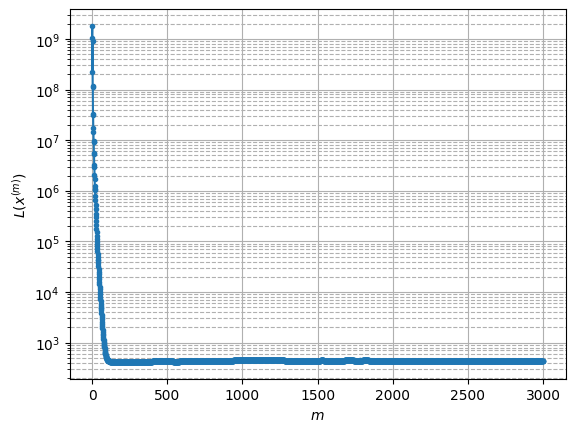

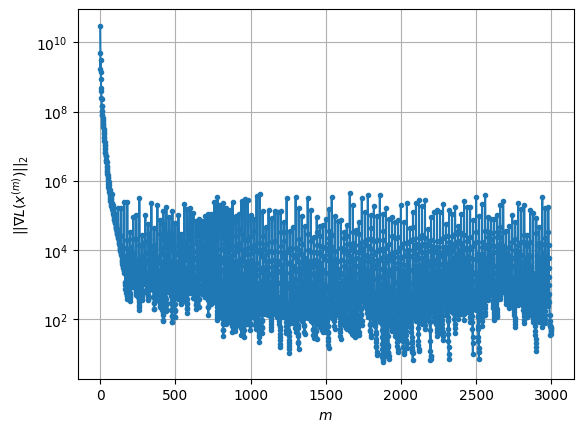

Windows:  51%|█████     | 150/296 [1:36:18<1:29:10, 36.65s/it]

Before applying the algorithm
Cost function: 429.1234511398898
Gradient norm: 163736.08810326233
Global relative error: 0.8159030775434221
Position relative errors: 0.07542388232697021 m, 0.350125624939652 m, 0.6073674719207826 m, 0.41051577715171794 m

Iteration 1
Cost function: 428.59818061880054 (-0.12%)
Gradient norm: 15979.99937280704 (-90.24%)
Global relative error: 0.696567786842908 (-14.63%)
Position relative errors: 0.07740276574822805 m, 0.30411621816506434 m, 0.5668142522320582 m, 0.2558253501839248 m

Iteration 2
Cost function: 428.54846661011766 (-0.01%)
Gradient norm: 7578.252477163011 (-52.58%)
Global relative error: 0.7268760418068408 (4.35%)
Position relative errors: 0.07745342277022756 m, 0.2665413620932916 m, 0.6167614108973416 m, 0.26628455506894855 m

Iteration 3
Cost function: 428.5335810773381 (-0.00%)
Gradient norm: 5891.595203355461 (-22.26%)
Global relative error: 0.7212732046988651 (-0.77%)
Position relative errors: 0.0774208167107518 m, 0.27093169775144843 m

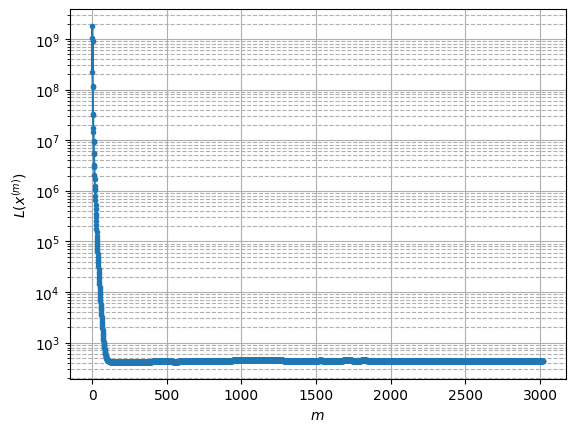

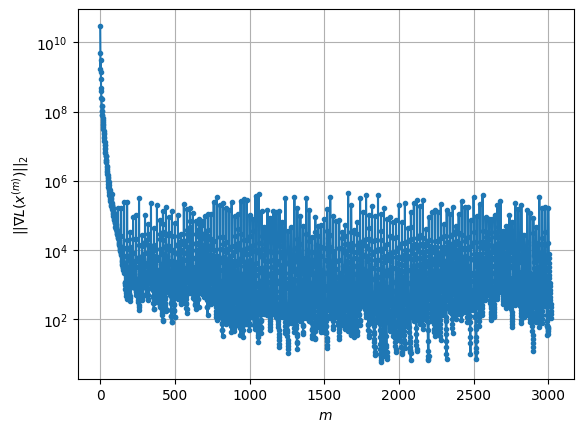

Windows:  51%|█████     | 151/296 [1:36:57<1:30:10, 37.31s/it]

Before applying the algorithm
Cost function: 421.68184619780374
Gradient norm: 47899.72305231276
Global relative error: 0.706471880513298
Position relative errors: 0.07489792480719311 m, 0.20992289885856386 m, 0.6172674680354036 m, 0.26153877734088726 m

Iteration 1
Cost function: 421.37619805362425 (-0.07%)
Gradient norm: 11204.489766919944 (-76.61%)
Global relative error: 0.7280628714004184 (3.06%)
Position relative errors: 0.08099992159427864 m, 0.1722278933106042 m, 0.5728976971041132 m, 0.40698646340091355 m

Iteration 2
Cost function: 421.3353696002016 (-0.01%)
Gradient norm: 9437.598014408286 (-15.77%)
Global relative error: 0.7571951043796661 (4.00%)
Position relative errors: 0.08116347150817578 m, 0.19219701593000552 m, 0.5526226660012725 m, 0.47373256288453364 m

Iteration 3
Cost function: 421.32122762676795 (-0.00%)
Gradient norm: 6747.432571551332 (-28.50%)
Global relative error: 0.7480759886021089 (-1.20%)
Position relative errors: 0.08120862293110663 m, 0.19845404939506 m

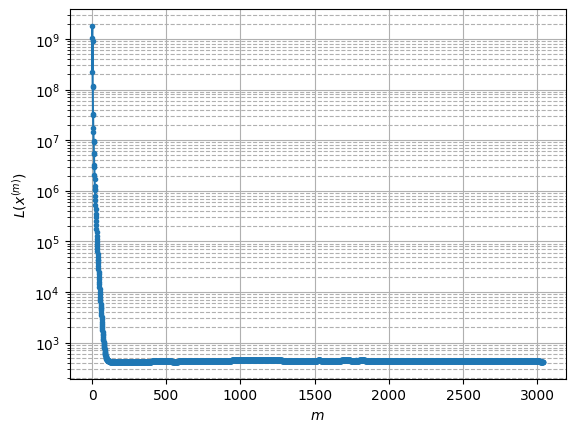

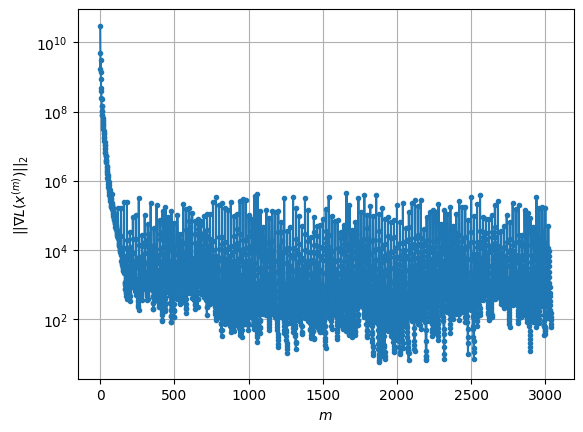

Windows:  51%|█████▏    | 152/296 [1:37:34<1:28:51, 37.03s/it]

Before applying the algorithm
Cost function: 426.7469951688227
Gradient norm: 88943.95325106848
Global relative error: 0.7502309339558426
Position relative errors: 0.07859993936951594 m, 0.25405158533746275 m, 0.5661875105294548 m, 0.414192278954944 m

Iteration 1
Cost function: 426.07596277237724 (-0.16%)
Gradient norm: 39894.25604368762 (-55.15%)
Global relative error: 0.8112635772726748 (8.14%)
Position relative errors: 0.07006124901790901 m, 0.5236271997362563 m, 0.5972495332236493 m, 0.1494784551867974 m

Iteration 2
Cost function: 425.99209148843323 (-0.02%)
Gradient norm: 19929.119925314106 (-50.05%)
Global relative error: 0.7767460914914857 (-4.25%)
Position relative errors: 0.07030567298369522 m, 0.4384581417195798 m, 0.6053669469792451 m, 0.19918194084532836 m

Iteration 3
Cost function: 425.9680998845775 (-0.01%)
Gradient norm: 13268.299782527176 (-33.42%)
Global relative error: 0.7840548220741496 (0.94%)
Position relative errors: 0.07036063704899469 m, 0.48504956970453156 m

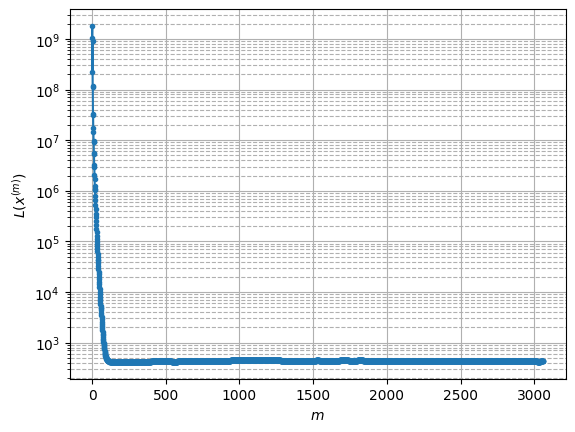

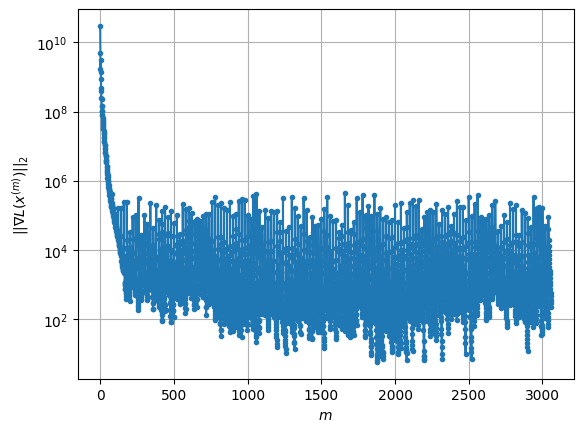

Windows:  52%|█████▏    | 153/296 [1:38:10<1:27:41, 36.80s/it]

Before applying the algorithm
Cost function: 429.02738375821724
Gradient norm: 183119.7678033081
Global relative error: 0.8046784320574326
Position relative errors: 0.06800794704507164 m, 0.5413244191836182 m, 0.5767702851011323 m, 0.13108214461199422 m

Iteration 1
Cost function: 428.45357189070364 (-0.13%)
Gradient norm: 34006.76203881209 (-81.43%)
Global relative error: 0.7411915663820927 (-7.89%)
Position relative errors: 0.050998571981182586 m, 0.36834451689935527 m, 0.6383789964038878 m, 0.059628977643567185 m

Iteration 2
Cost function: 428.36334127924107 (-0.02%)
Gradient norm: 24717.341549696055 (-27.32%)
Global relative error: 0.7320218015520298 (-1.24%)
Position relative errors: 0.05063316979452216 m, 0.3579421150622622 m, 0.626356192823291 m, 0.11333234634575705 m

Iteration 3
Cost function: 428.32570297342227 (-0.01%)
Gradient norm: 16811.252659909056 (-31.99%)
Global relative error: 0.736069992999151 (0.55%)
Position relative errors: 0.050470796628884866 m, 0.320177430608

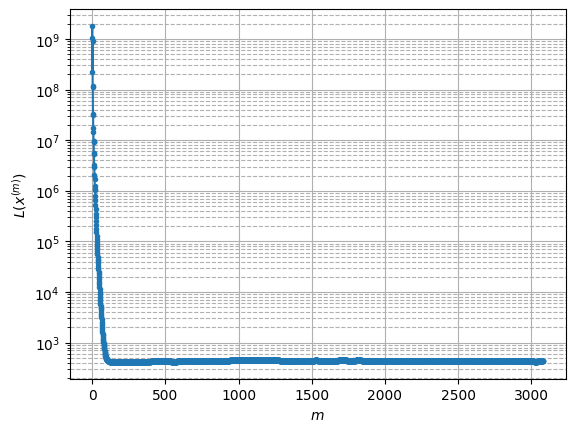

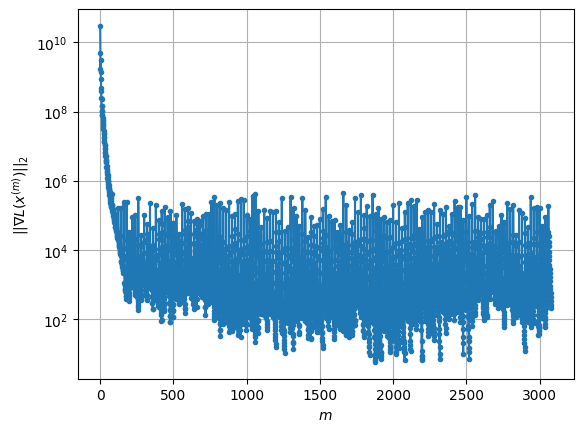

Windows:  52%|█████▏    | 154/296 [1:38:46<1:26:24, 36.51s/it]

Before applying the algorithm
Cost function: 432.4210116384225
Gradient norm: 83343.65321989827
Global relative error: 0.7696458217524544
Position relative errors: 0.04858109878241204 m, 0.3588706726918838 m, 0.6519641969050664 m, 0.1901208968107739 m

Iteration 1
Cost function: 432.1706092067591 (-0.06%)
Gradient norm: 21776.30576142933 (-73.87%)
Global relative error: 0.9146494716710608 (18.84%)
Position relative errors: 0.047970660914642735 m, 0.3401032177181085 m, 0.7226575780329009 m, 0.4431411211266507 m

Iteration 2
Cost function: 432.13625690862494 (-0.01%)
Gradient norm: 12192.368336401196 (-44.01%)
Global relative error: 0.9087147632905413 (-0.65%)
Position relative errors: 0.04791326136482551 m, 0.30241031408007485 m, 0.7179841036386249 m, 0.4653063846557566 m

Iteration 3
Cost function: 432.1249429963905 (-0.00%)
Gradient norm: 9289.87230393124 (-23.81%)
Global relative error: 0.8951582366480029 (-1.49%)
Position relative errors: 0.0478814120348452 m, 0.2917340810235356 m, 

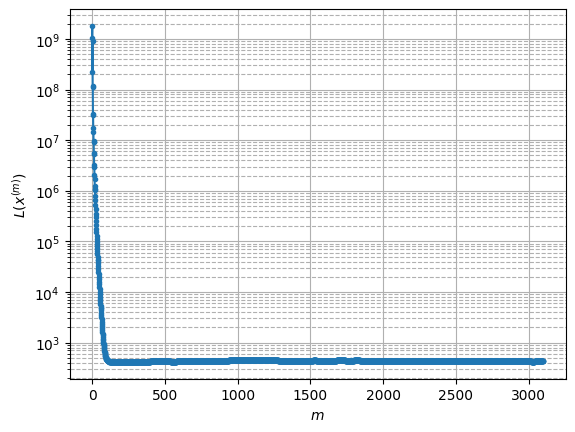

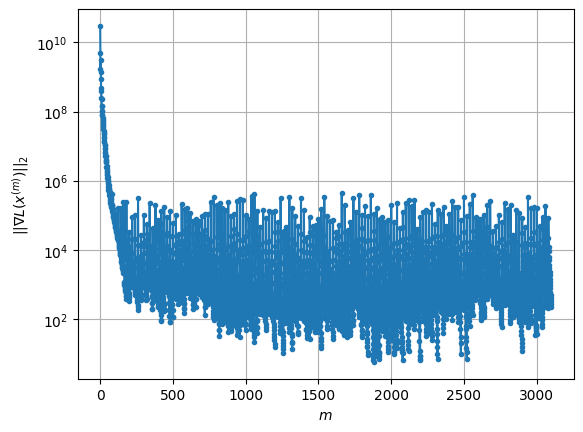

Windows:  52%|█████▏    | 155/296 [1:39:25<1:27:28, 37.23s/it]

Before applying the algorithm
Cost function: 435.5359008255887
Gradient norm: 217058.59008277257
Global relative error: 0.9439825237461155
Position relative errors: 0.04638877203766715 m, 0.3054214876423945 m, 0.6730092835828522 m, 0.585426054311629 m

Iteration 1
Cost function: 435.2184105970317 (-0.07%)
Gradient norm: 31781.154635487328 (-85.36%)
Global relative error: 0.8932515679561956 (-5.37%)
Position relative errors: 0.04716775253925529 m, 0.19553416592342213 m, 0.680680811891995 m, 0.542319144862229 m

Iteration 2
Cost function: 435.16614477677984 (-0.01%)
Gradient norm: 17930.04376464641 (-43.58%)
Global relative error: 0.941594227648834 (5.41%)
Position relative errors: 0.047092662940988295 m, 0.23033677227055596 m, 0.7017897761808475 m, 0.5820778679212109 m

Iteration 3
Cost function: 435.1467151852998 (-0.00%)
Gradient norm: 13240.399265278982 (-26.16%)
Global relative error: 0.9198555417327691 (-2.31%)
Position relative errors: 0.04706128136909828 m, 0.2124723303143107 m, 

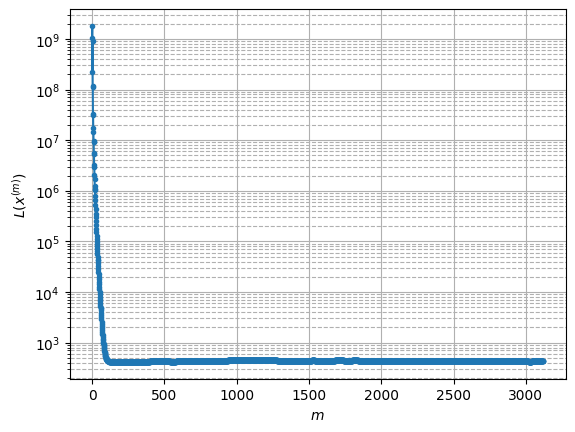

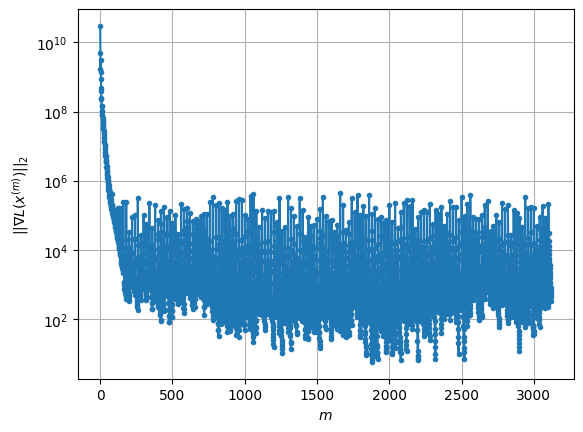

Windows:  53%|█████▎    | 156/296 [1:40:01<1:26:17, 36.98s/it]

Before applying the algorithm
Cost function: 435.8234785248955
Gradient norm: 139731.51787319122
Global relative error: 0.9880989756686241
Position relative errors: 0.04540910013023747 m, 0.2626861868463322 m, 0.7037477264831575 m, 0.6403198010380954 m

Iteration 1
Cost function: 435.51717916047005 (-0.07%)
Gradient norm: 16511.48579641476 (-88.18%)
Global relative error: 1.1678259663897246 (18.19%)
Position relative errors: 0.043110298344710835 m, 0.43507394884556405 m, 0.6818378624125393 m, 0.8412861107863975 m

Iteration 2
Cost function: 435.4906473190536 (-0.01%)
Gradient norm: 7071.820253874648 (-57.17%)
Global relative error: 1.1070724995455536 (-5.20%)
Position relative errors: 0.04303501973547137 m, 0.3613072787883422 m, 0.6862392263786253 m, 0.7888512060245201 m

Iteration 3
Cost function: 435.4838285288952 (-0.00%)
Gradient norm: 3656.1340232861685 (-48.30%)
Global relative error: 1.1337395490895152 (2.41%)
Position relative errors: 0.04297212503497919 m, 0.3783452701476983 m

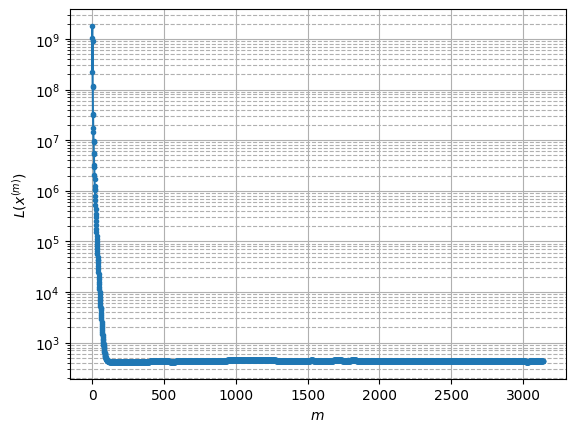

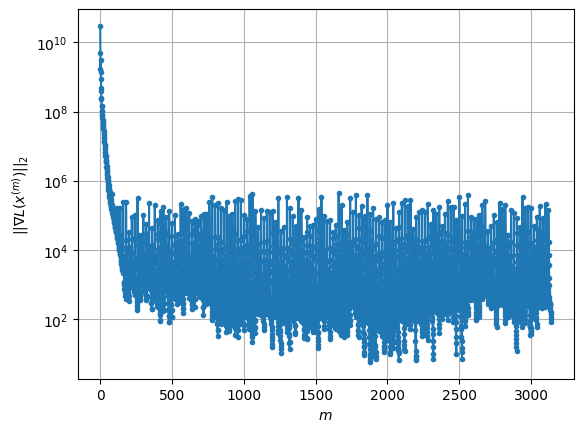

Windows:  53%|█████▎    | 157/296 [1:40:37<1:24:45, 36.59s/it]

Before applying the algorithm
Cost function: 437.87183969359506
Gradient norm: 111602.63382892104
Global relative error: 1.1940995695846504
Position relative errors: 0.04145151500030333 m, 0.4350884564689877 m, 0.6848571932216213 m, 0.8751115510154213 m

Iteration 1
Cost function: 437.63876950492113 (-0.05%)
Gradient norm: 31047.325393459832 (-72.18%)
Global relative error: 1.0259592057185762 (-14.08%)
Position relative errors: 0.04146509714331944 m, 0.4734679028766961 m, 0.7032343248546754 m, 0.576331830673808 m

Iteration 2
Cost function: 437.6078944928727 (-0.01%)
Gradient norm: 12872.61721453117 (-58.54%)
Global relative error: 1.073769854416972 (4.66%)
Position relative errors: 0.041606672666018946 m, 0.5500891362264196 m, 0.7193338338327714 m, 0.5755061610722707 m

Iteration 3
Cost function: 437.6005921806434 (-0.00%)
Gradient norm: 6514.830827813747 (-49.39%)
Global relative error: 1.059522605431053 (-1.33%)
Position relative errors: 0.0416256850375243 m, 0.5603364800661289 m, 0

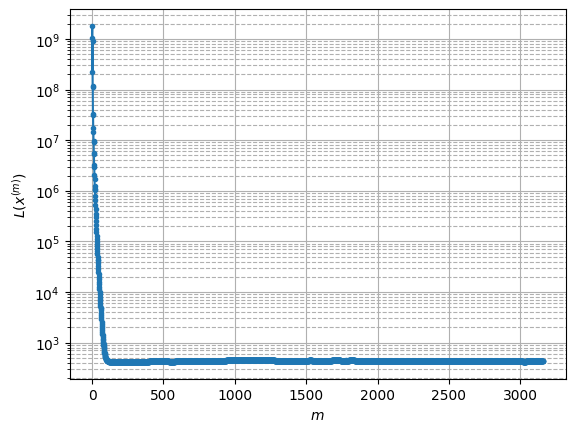

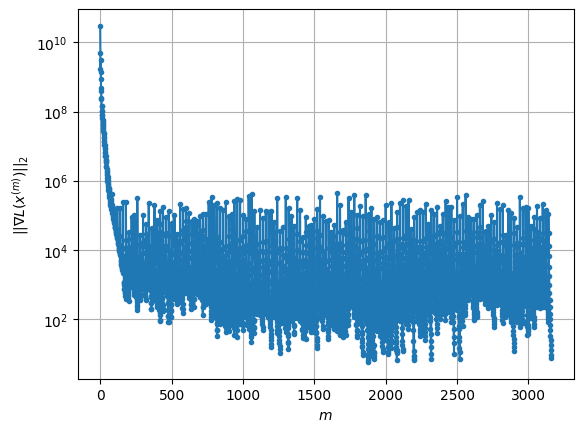

Windows:  53%|█████▎    | 158/296 [1:41:14<1:24:58, 36.95s/it]

Before applying the algorithm
Cost function: 440.5619008729636
Gradient norm: 255761.13258832422
Global relative error: 1.139800824622664
Position relative errors: 0.04013087650149073 m, 0.682054987301406 m, 0.7292257771963542 m, 0.5482356862848027 m

Iteration 1
Cost function: 440.2329252683177 (-0.07%)
Gradient norm: 17089.655291050527 (-93.32%)
Global relative error: 1.274449633072783 (11.81%)
Position relative errors: 0.03814375809646339 m, 0.7778328497139976 m, 0.6854096505348525 m, 0.7402372444007339 m

Iteration 2
Cost function: 440.19669136313667 (-0.01%)
Gradient norm: 10631.701071601403 (-37.79%)
Global relative error: 1.2343570289555512 (-3.15%)
Position relative errors: 0.03823131072045744 m, 0.7358524072558367 m, 0.6720771139513702 m, 0.7273269386142678 m

Iteration 3
Cost function: 440.1858367124706 (-0.00%)
Gradient norm: 6973.11713591041 (-34.41%)
Global relative error: 1.2312704117912754 (-0.25%)
Position relative errors: 0.03828636455246637 m, 0.7286618254654958 m, 0.

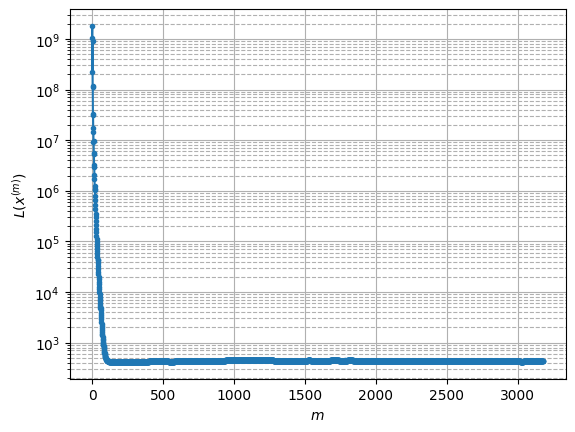

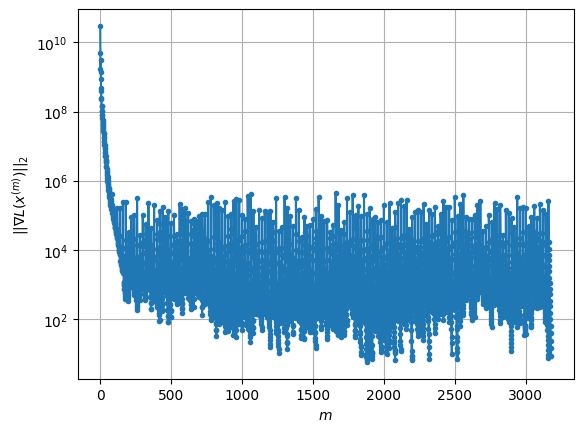

Windows:  54%|█████▎    | 159/296 [1:41:51<1:23:47, 36.70s/it]

Before applying the algorithm
Cost function: 439.7543225410919
Gradient norm: 147935.04685643385
Global relative error: 1.3056640997319917
Position relative errors: 0.03671659644230745 m, 0.7820613349303936 m, 0.6095467557652716 m, 0.8486688201310056 m

Iteration 1
Cost function: 439.4966804556544 (-0.06%)
Gradient norm: 27585.018698962638 (-81.35%)
Global relative error: 1.1572827279910873 (-11.36%)
Position relative errors: 0.04399265665815178 m, 0.734072492267854 m, 0.5179089195381199 m, 0.7281970547505323 m

Iteration 2
Cost function: 439.4542154393079 (-0.01%)
Gradient norm: 18928.6901564086 (-31.38%)
Global relative error: 1.21625991628031 (5.10%)
Position relative errors: 0.044117368921617835 m, 0.7688945294774323 m, 0.5043409223866431 m, 0.7948448796954077 m

Iteration 3
Cost function: 439.43588603345796 (-0.00%)
Gradient norm: 12989.580171220992 (-31.38%)
Global relative error: 1.182336996238791 (-2.79%)
Position relative errors: 0.04419250547623218 m, 0.7459656556809806 m, 0.

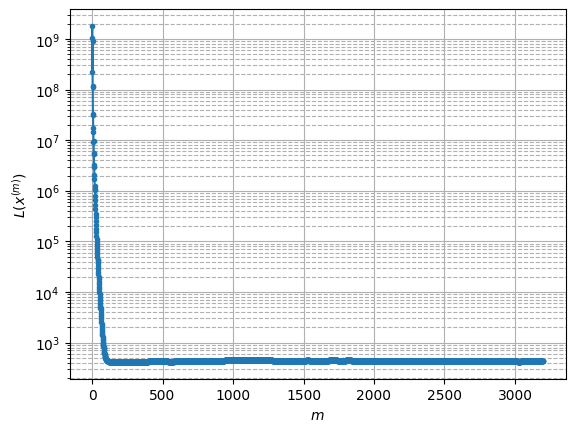

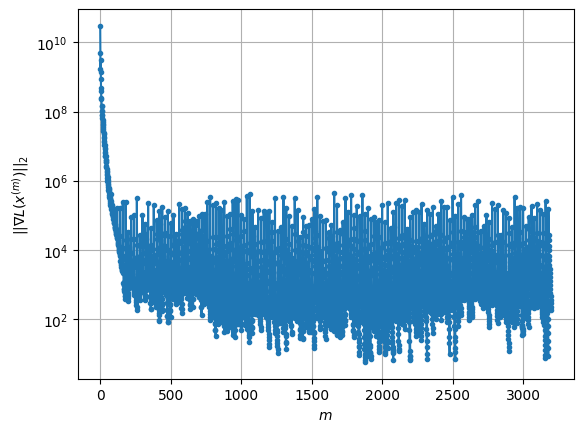

Windows:  54%|█████▍    | 160/296 [1:42:26<1:22:35, 36.44s/it]

Before applying the algorithm
Cost function: 438.92088192742665
Gradient norm: 41456.15056741653
Global relative error: 1.2768411346027464
Position relative errors: 0.04237767752383073 m, 0.834114481538123 m, 0.4428600451104186 m, 0.8582835863437972 m

Iteration 1
Cost function: 438.70493037123646 (-0.05%)
Gradient norm: 17676.017053022013 (-57.36%)
Global relative error: 1.3935943167328126 (9.14%)
Position relative errors: 0.039850339132437934 m, 0.9008523817346328 m, 0.5528378076196487 m, 0.9073855255340666 m

Iteration 2
Cost function: 438.6572665435799 (-0.01%)
Gradient norm: 13818.032109122558 (-21.83%)
Global relative error: 1.320860026558345 (-5.22%)
Position relative errors: 0.03990676706037102 m, 0.8933530191343779 m, 0.5255616986058064 m, 0.817789348618262 m

Iteration 3
Cost function: 438.64113410038163 (-0.00%)
Gradient norm: 10983.367941238228 (-20.51%)
Global relative error: 1.3651981107788496 (3.36%)
Position relative errors: 0.03998448112938901 m, 0.9318393634757302 m, 

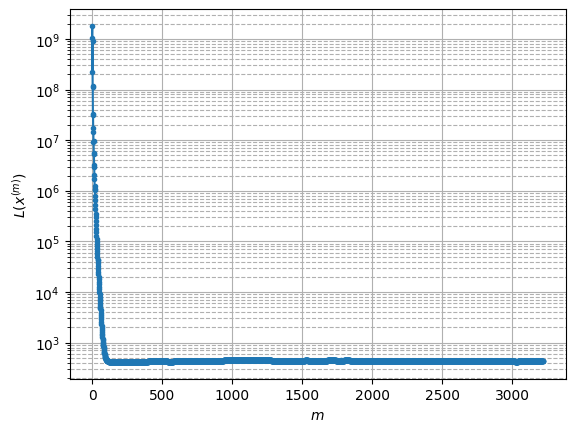

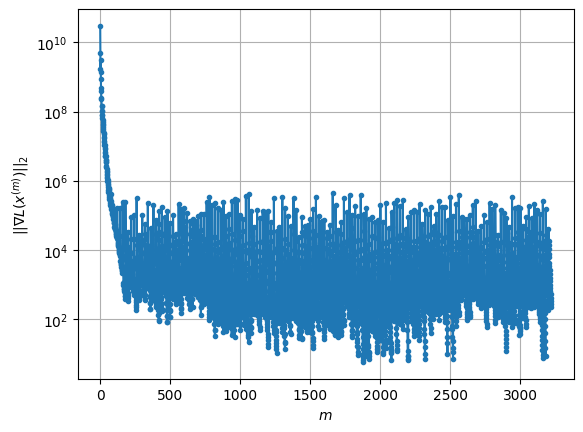

Windows:  54%|█████▍    | 161/296 [1:43:03<1:22:06, 36.49s/it]

Before applying the algorithm
Cost function: 438.8886368129278
Gradient norm: 187877.80336048605
Global relative error: 1.4303926766203736
Position relative errors: 0.03831949387058283 m, 1.0413230784402576 m, 0.49914523329537897 m, 0.8432383007144181 m

Iteration 1
Cost function: 438.45268021802417 (-0.10%)
Gradient norm: 28523.00573082809 (-84.82%)
Global relative error: 1.155661035140977 (-19.21%)
Position relative errors: 0.04361624353748114 m, 0.9714777901279091 m, 0.3101003636524513 m, 0.5419546662940659 m

Iteration 2
Cost function: 438.4058132776553 (-0.01%)
Gradient norm: 13685.693761194554 (-52.02%)
Global relative error: 1.3065190836708833 (13.05%)
Position relative errors: 0.04367332392567005 m, 1.083543807245027 m, 0.3617833155520252 m, 0.6325556589283734 m

Iteration 3
Cost function: 438.3934618611177 (-0.00%)
Gradient norm: 6259.76766036825 (-54.26%)
Global relative error: 1.242793223850387 (-4.88%)
Position relative errors: 0.043646679134256475 m, 1.054737449271269 m, 0

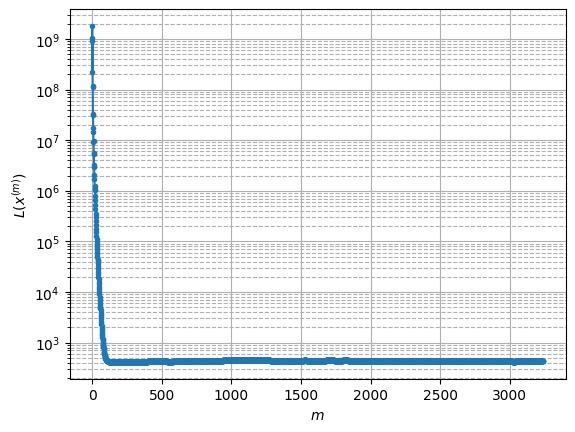

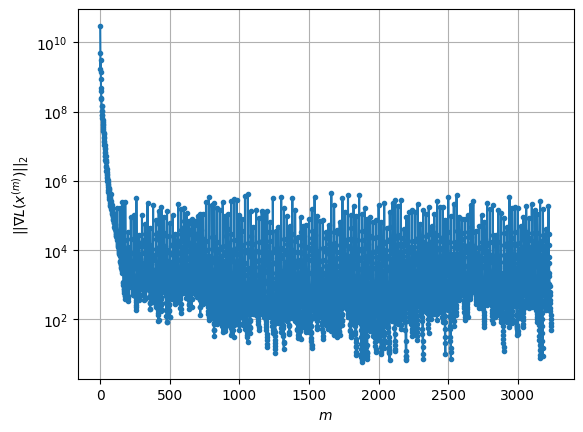

Windows:  55%|█████▍    | 162/296 [1:43:40<1:21:30, 36.49s/it]

Before applying the algorithm
Cost function: 439.4360106245217
Gradient norm: 336690.6434740966
Global relative error: 1.3854903203646487
Position relative errors: 0.04185573788416645 m, 1.2078918100606355 m, 0.3595871357515614 m, 0.5740406977057655 m

Iteration 1
Cost function: 438.5935952243662 (-0.19%)
Gradient norm: 26764.68196946358 (-92.05%)
Global relative error: 1.284541478413091 (-7.29%)
Position relative errors: 0.040851694057285136 m, 1.1974657561083586 m, 0.23214053386548117 m, 0.40070248842567574 m

Iteration 2
Cost function: 438.5544817140542 (-0.01%)
Gradient norm: 11781.241763996737 (-55.98%)
Global relative error: 1.3279380107360181 (3.38%)
Position relative errors: 0.040829518489160437 m, 1.226952359174992 m, 0.2716657131061858 m, 0.4272416985612694 m

Iteration 3
Cost function: 438.54625525517116 (-0.00%)
Gradient norm: 6296.188864449492 (-46.56%)
Global relative error: 1.3211546737097697 (-0.51%)
Position relative errors: 0.04081827582544026 m, 1.2272709074280919 m,

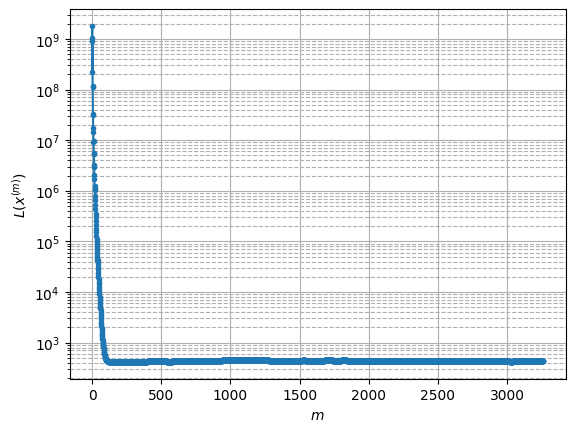

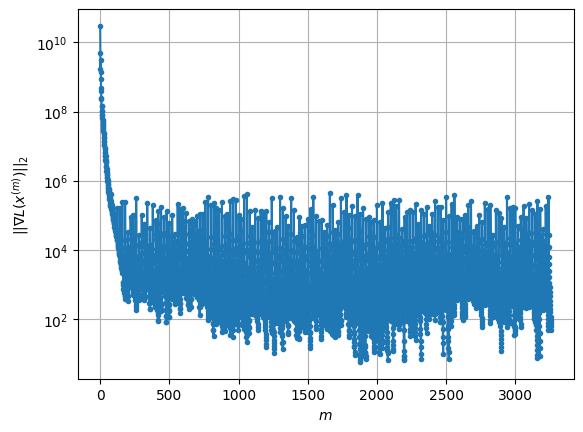

Windows:  55%|█████▌    | 163/296 [1:44:16<1:20:34, 36.35s/it]

Before applying the algorithm
Cost function: 438.79976432429
Gradient norm: 182961.77649473932
Global relative error: 1.397942181111464
Position relative errors: 0.04018627359228704 m, 1.2948665706654237 m, 0.2680934578078943 m, 0.4517430848556193 m

Iteration 1
Cost function: 438.38542237815386 (-0.09%)
Gradient norm: 27215.57757298922 (-85.12%)
Global relative error: 1.2877638089558205 (-7.88%)
Position relative errors: 0.04423764342406985 m, 1.2301242294474442 m, 0.26688560432426867 m, 0.2682230606209856 m

Iteration 2
Cost function: 438.3320851141268 (-0.01%)
Gradient norm: 13295.677713005338 (-51.15%)
Global relative error: 1.399277069607722 (8.66%)
Position relative errors: 0.04424072309997436 m, 1.3388485997983448 m, 0.28824060069989293 m, 0.28358279904411904 m

Iteration 3
Cost function: 438.3153156567415 (-0.00%)
Gradient norm: 6583.3900911244755 (-50.48%)
Global relative error: 1.387784792159337 (-0.82%)
Position relative errors: 0.04427893603233326 m, 1.337799219290412 m, 0.

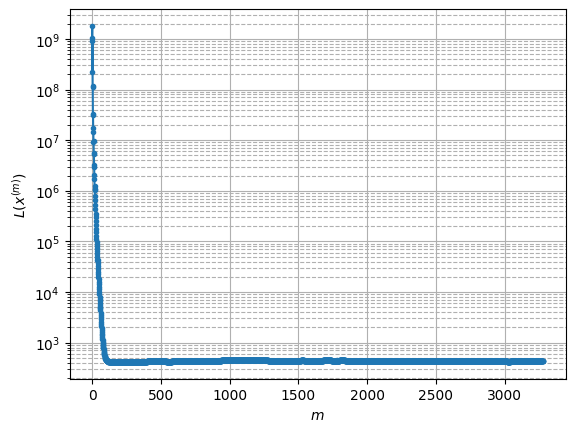

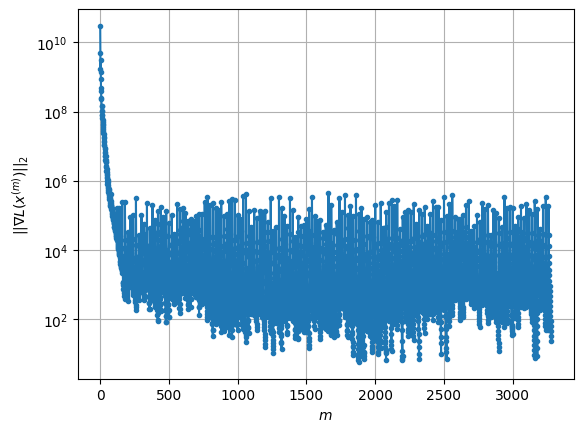

Windows:  55%|█████▌    | 164/296 [1:44:54<1:21:11, 36.91s/it]

Before applying the algorithm
Cost function: 439.3847566926708
Gradient norm: 116766.76757526773
Global relative error: 1.502092692389928
Position relative errors: 0.04368461573532614 m, 1.4519939108174909 m, 0.30079176754851533 m, 0.23581882996060172 m

Iteration 1
Cost function: 439.21919061831466 (-0.04%)
Gradient norm: 17327.87267763061 (-85.16%)
Global relative error: 1.2857570810474925 (-14.40%)
Position relative errors: 0.04660718693833399 m, 1.247339346780372 m, 0.30143474796153086 m, 0.06541888952808018 m

Iteration 2
Cost function: 439.2014420370655 (-0.00%)
Gradient norm: 5504.5062009889425 (-68.23%)
Global relative error: 1.3798739679760483 (7.32%)
Position relative errors: 0.046579743158381995 m, 1.3417872055332978 m, 0.3068616842184208 m, 0.08558208016335132 m

Iteration 3
Cost function: 439.1979921181226 (-0.00%)
Gradient norm: 2663.9213716823256 (-51.60%)
Global relative error: 1.3330173204605007 (-3.40%)
Position relative errors: 0.046589359063419274 m, 1.2959309643081

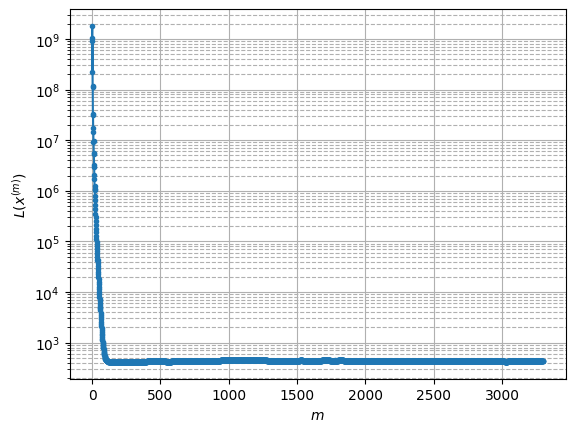

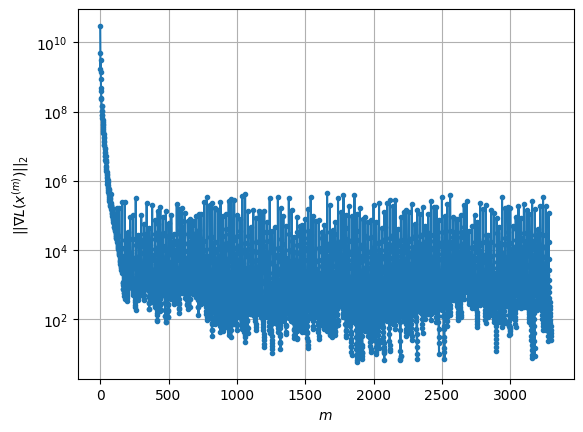

Windows:  56%|█████▌    | 165/296 [1:45:29<1:19:49, 36.56s/it]

Before applying the algorithm
Cost function: 441.05210106729595
Gradient norm: 390931.0017988527
Global relative error: 1.36081257981308
Position relative errors: 0.046004224011152346 m, 1.3245527861170143 m, 0.28603605617433575 m, 0.11591703140568972 m

Iteration 1
Cost function: 440.62166167960754 (-0.10%)
Gradient norm: 21949.134153817897 (-94.39%)
Global relative error: 1.5907322550415284 (16.90%)
Position relative errors: 0.0484868147326046 m, 1.520892508096255 m, 0.3572386457057469 m, 0.2955389716088513 m

Iteration 2
Cost function: 440.5982668688027 (-0.01%)
Gradient norm: 8588.444561124952 (-60.87%)
Global relative error: 1.4907696690483578 (-6.28%)
Position relative errors: 0.04852357701006749 m, 1.4407320754716026 m, 0.34354408682208143 m, 0.16219429508843414 m

Iteration 3
Cost function: 440.59285603206496 (-0.00%)
Gradient norm: 4453.14519244462 (-48.15%)
Global relative error: 1.5648313869891133 (4.97%)
Position relative errors: 0.0485237098942042 m, 1.5082050178427073 m, 

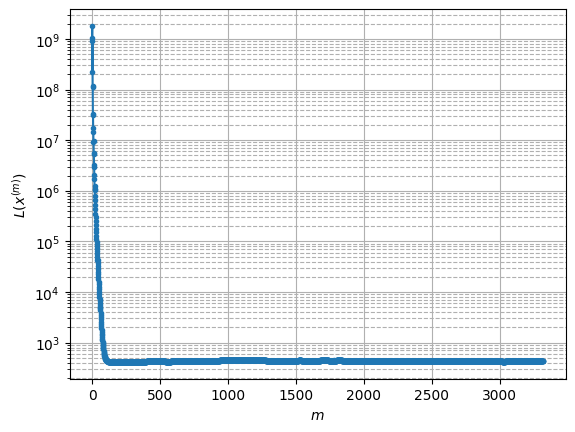

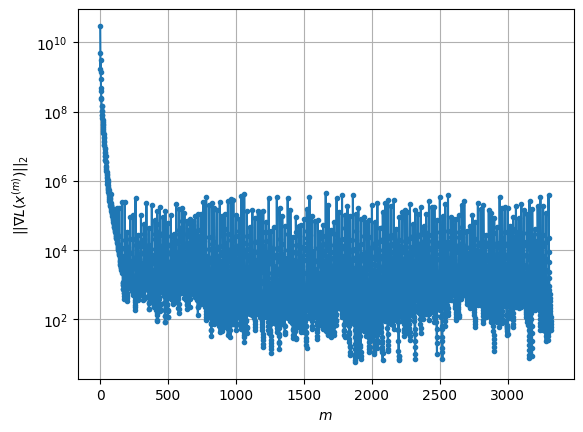

Windows:  56%|█████▌    | 166/296 [1:46:05<1:18:38, 36.29s/it]

Before applying the algorithm
Cost function: 444.20540444750117
Gradient norm: 240179.1522426843
Global relative error: 1.5956563009223181
Position relative errors: 0.0477044221535858 m, 1.5422803260008942 m, 0.34354154159268724 m, 0.21723875946955634 m

Iteration 1
Cost function: 443.7972578855283 (-0.09%)
Gradient norm: 18104.379297718333 (-92.46%)
Global relative error: 1.4259586879085677 (-10.63%)
Position relative errors: 0.049319535540599174 m, 1.3703688631274773 m, 0.3758248945055634 m, 0.10848954390317433 m

Iteration 2
Cost function: 443.7433101766853 (-0.01%)
Gradient norm: 5444.783704402524 (-69.93%)
Global relative error: 1.53226123995821 (7.45%)
Position relative errors: 0.04940065704450036 m, 1.4816238754997089 m, 0.38090897944129054 m, 0.07129033031663885 m

Iteration 3
Cost function: 443.7263667716854 (-0.00%)
Gradient norm: 3227.6266306652083 (-40.72%)
Global relative error: 1.5188692342645345 (-0.87%)
Position relative errors: 0.04950095488575775 m, 1.4665748570607773

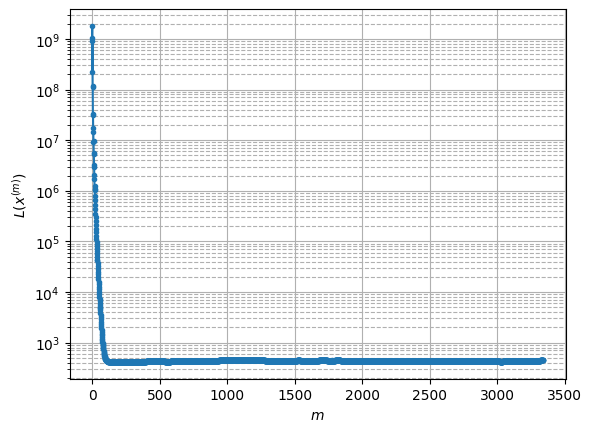

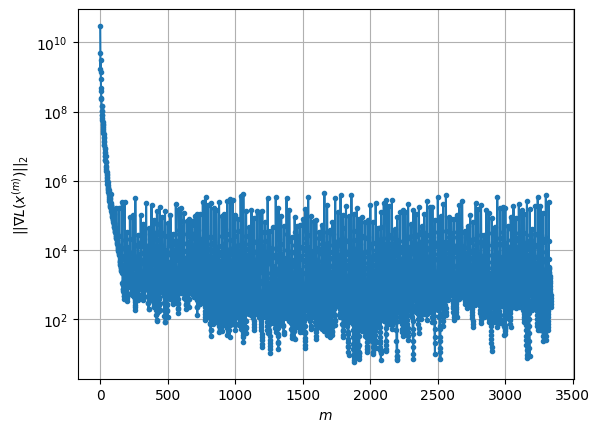

Windows:  56%|█████▋    | 167/296 [1:46:42<1:18:19, 36.43s/it]

Before applying the algorithm
Cost function: 445.36544382287104
Gradient norm: 90584.0690427043
Global relative error: 1.602363136746269
Position relative errors: 0.0487173162887346 m, 1.5565700646075127 m, 0.367329346853372 m, 0.08574608568278735 m

Iteration 1
Cost function: 445.25663713219495 (-0.02%)
Gradient norm: 16744.990803523444 (-81.51%)
Global relative error: 1.5525859573638285 (-3.11%)
Position relative errors: 0.050497650646989044 m, 1.5143018156011945 m, 0.3331643542738032 m, 0.062161772174199846 m

Iteration 2
Cost function: 445.23518672622686 (-0.00%)
Gradient norm: 9607.846051456196 (-42.62%)
Global relative error: 1.4993872449165786 (-3.43%)
Position relative errors: 0.050536795702308776 m, 1.4591335788494628 m, 0.33456419031107365 m, 0.06784861981858537 m

Iteration 3
Cost function: 445.22759603754923 (-0.00%)
Gradient norm: 6550.2005435297115 (-31.82%)
Global relative error: 1.4965230071035922 (-0.19%)
Position relative errors: 0.05054961174665741 m, 1.4554780487915

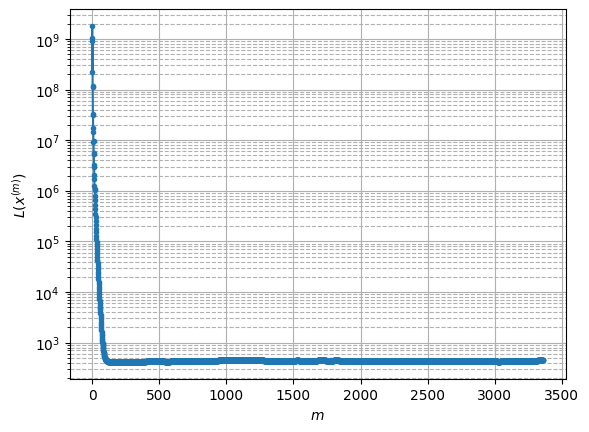

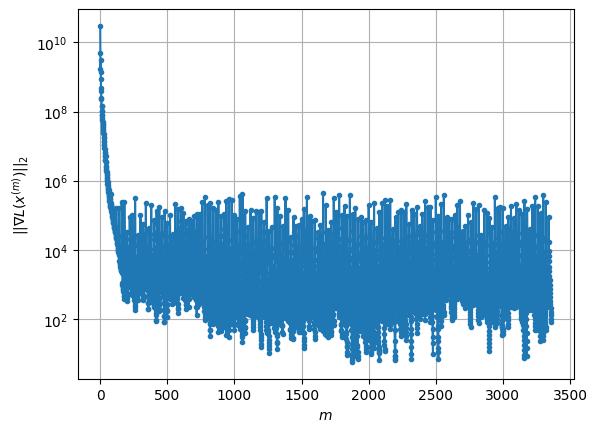

Windows:  57%|█████▋    | 168/296 [1:47:16<1:16:27, 35.84s/it]

Before applying the algorithm
Cost function: 444.9597545411345
Gradient norm: 150336.01557168495
Global relative error: 1.441293765788502
Position relative errors: 0.04934798298280367 m, 1.3987524978477748 m, 0.30949898570768175 m, 0.1503114752995257 m

Iteration 1
Cost function: 444.81222682263063 (-0.03%)
Gradient norm: 15338.080595383635 (-89.80%)
Global relative error: 1.3166138544485835 (-8.65%)
Position relative errors: 0.04960608081731423 m, 1.2912593879555079 m, 0.20002850060727595 m, 0.15378053753524815 m

Iteration 2
Cost function: 444.7960627033087 (-0.00%)
Gradient norm: 7280.74091815401 (-52.53%)
Global relative error: 1.2899276087707552 (-2.03%)
Position relative errors: 0.04957499095867294 m, 1.2541286315789966 m, 0.19621711617977833 m, 0.22386411418633798 m

Iteration 3
Cost function: 444.7919077783359 (-0.00%)
Gradient norm: 3975.5631041651577 (-45.40%)
Global relative error: 1.2622575887469452 (-2.15%)
Position relative errors: 0.049559161303333044 m, 1.22353260872014

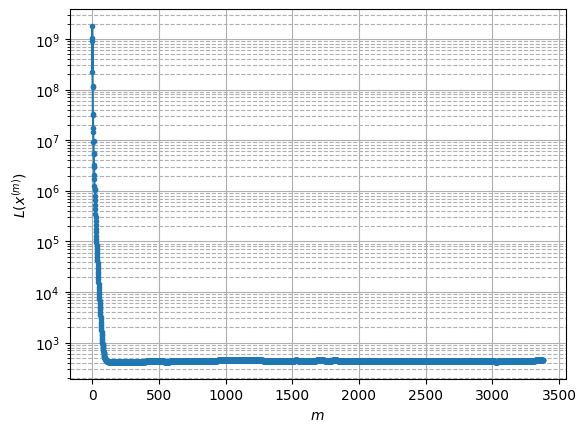

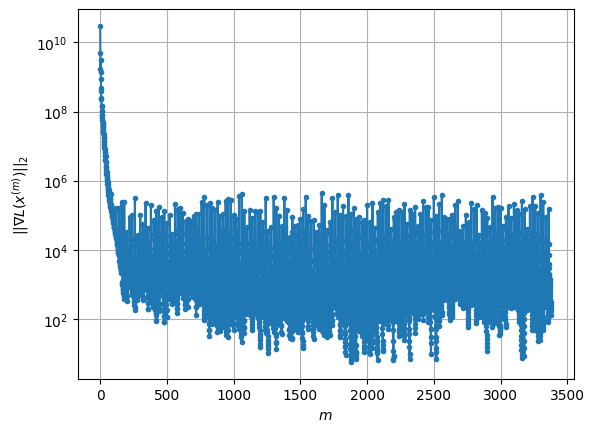

Windows:  57%|█████▋    | 169/296 [1:47:50<1:14:42, 35.29s/it]

Before applying the algorithm
Cost function: 444.5698120768858
Gradient norm: 102585.9526174433
Global relative error: 1.1977594050035458
Position relative errors: 0.04828724253736791 m, 1.1367893287638735 m, 0.15068901032429693 m, 0.34248816252567793 m

Iteration 1
Cost function: 444.0419602917061 (-0.12%)
Gradient norm: 17841.22946065767 (-82.61%)
Global relative error: 1.2383251299224358 (3.39%)
Position relative errors: 0.04484023118350286 m, 1.1114660537129994 m, 0.19319778541976496 m, 0.5086801466766091 m

Iteration 2
Cost function: 443.98604863271663 (-0.01%)
Gradient norm: 9566.121291114801 (-46.38%)
Global relative error: 1.1524246930294344 (-6.94%)
Position relative errors: 0.04489204388599303 m, 1.0220694589802741 m, 0.1727018594336121 m, 0.5016123067159519 m

Iteration 3
Cost function: 443.9751712045054 (-0.00%)
Gradient norm: 5235.7163367289395 (-45.27%)
Global relative error: 1.1930422763023674 (3.52%)
Position relative errors: 0.044896101862788945 m, 1.0428470016080618 m

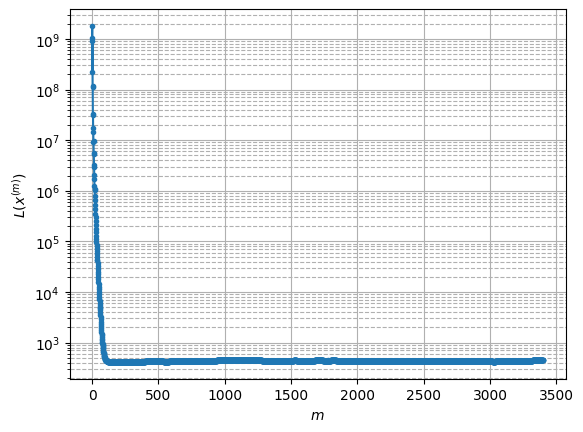

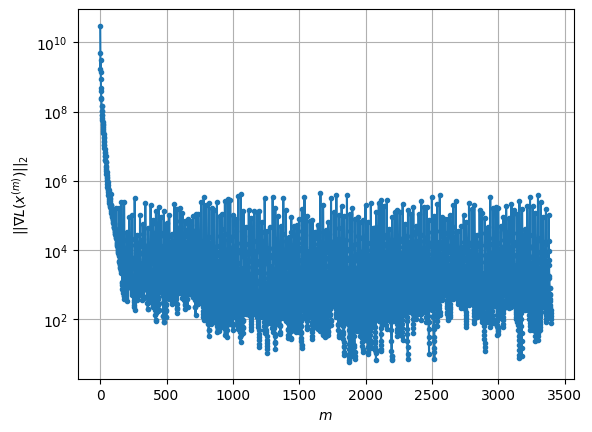

Windows:  57%|█████▋    | 170/296 [1:48:27<1:14:57, 35.69s/it]

Before applying the algorithm
Cost function: 443.3829459736245
Gradient norm: 200480.07606833152
Global relative error: 1.1239777022201083
Position relative errors: 0.0434650704950144 m, 0.9530830754174632 m, 0.13311342691947953 m, 0.5790936931394463 m

Iteration 1
Cost function: 443.11038884096797 (-0.06%)
Gradient norm: 12359.676784313246 (-93.83%)
Global relative error: 1.2413732876350538 (10.44%)
Position relative errors: 0.04311574297686219 m, 1.0648305064919423 m, 0.19002163595501867 m, 0.607598485341364 m

Iteration 2
Cost function: 443.08976781370086 (-0.00%)
Gradient norm: 5691.360838102534 (-53.95%)
Global relative error: 1.1931867912041296 (-3.88%)
Position relative errors: 0.043174164475518056 m, 1.051296254842442 m, 0.19103239227739038 m, 0.5292569325689238 m

Iteration 3
Cost function: 443.08448485628213 (-0.00%)
Gradient norm: 2514.0949017758517 (-55.83%)
Global relative error: 1.2331665552393174 (3.35%)
Position relative errors: 0.04319500988426379 m, 1.090501916799433 

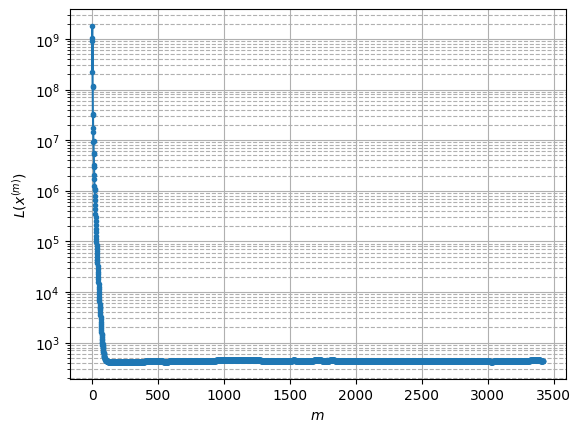

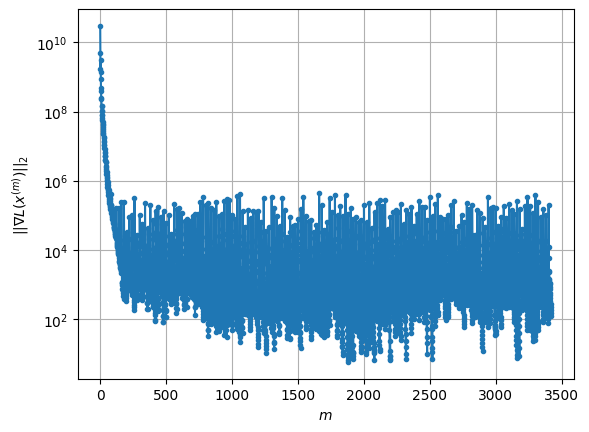

Windows:  58%|█████▊    | 171/296 [1:49:01<1:13:28, 35.27s/it]

Before applying the algorithm
Cost function: 439.52181932864346
Gradient norm: 199274.1745088734
Global relative error: 1.2160315920338494
Position relative errors: 0.04165683367736039 m, 1.0913458364147932 m, 0.18797907366628416 m, 0.5006245367645691 m

Iteration 1
Cost function: 439.33363567043057 (-0.04%)
Gradient norm: 13820.497550345024 (-93.06%)
Global relative error: 1.1557062157693185 (-4.96%)
Position relative errors: 0.04416443192030101 m, 0.955887058524055 m, 0.2663595745538796 m, 0.5907944813495905 m

Iteration 2
Cost function: 439.3046305681986 (-0.01%)
Gradient norm: 11214.321993209225 (-18.86%)
Global relative error: 1.1111232988231992 (-3.86%)
Position relative errors: 0.04413671534540838 m, 0.8842788556876482 m, 0.2235133340567766 m, 0.6330395154396271 m

Iteration 3
Cost function: 439.2941767729369 (-0.00%)
Gradient norm: 8301.369253873188 (-25.98%)
Global relative error: 1.1288245107322967 (1.59%)
Position relative errors: 0.04408617996244569 m, 0.862441956001048 m, 

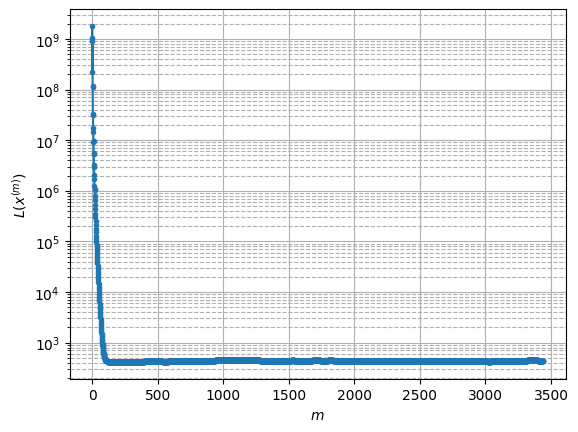

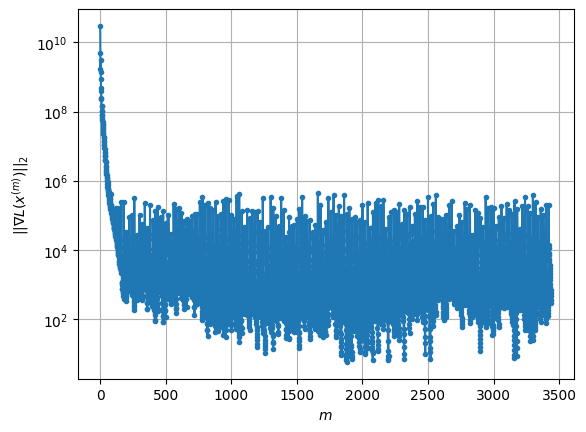

Windows:  58%|█████▊    | 172/296 [1:49:36<1:12:21, 35.02s/it]

Before applying the algorithm
Cost function: 439.36169816009453
Gradient norm: 70935.06327698664
Global relative error: 1.0714807792939762
Position relative errors: 0.04233147463739359 m, 0.7113919410736549 m, 0.17837262329402329 m, 0.7799892686467206 m

Iteration 1
Cost function: 439.11382083770326 (-0.06%)
Gradient norm: 13147.786806030792 (-81.47%)
Global relative error: 0.944469907630912 (-11.85%)
Position relative errors: 0.044264343050873324 m, 0.6976485041473333 m, 0.12995769341453586 m, 0.6216600806306795 m

Iteration 2
Cost function: 439.0765497449192 (-0.01%)
Gradient norm: 8753.658095845147 (-33.42%)
Global relative error: 1.0295384349196595 (9.01%)
Position relative errors: 0.04412896490984133 m, 0.7587624330965204 m, 0.15649099277461664 m, 0.6766030480772739 m

Iteration 3
Cost function: 439.06530690150544 (-0.00%)
Gradient norm: 6289.154546615508 (-28.15%)
Global relative error: 0.964423752223718 (-6.32%)
Position relative errors: 0.04405878772486073 m, 0.7172694977744543

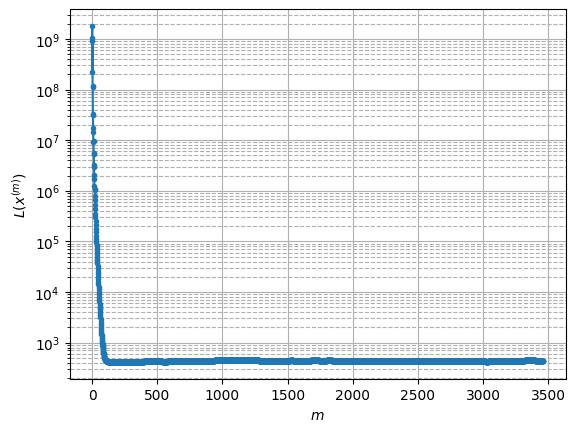

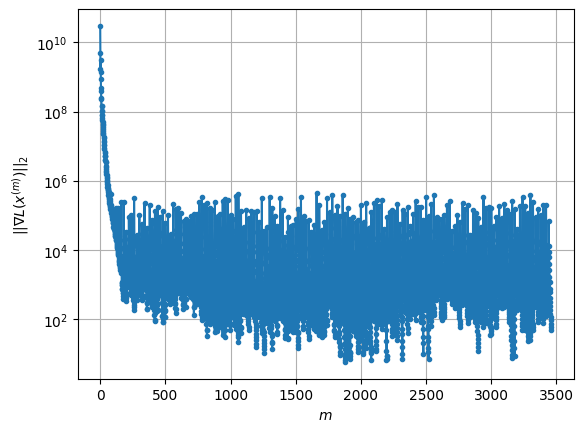

Windows:  58%|█████▊    | 173/296 [1:50:12<1:12:41, 35.46s/it]

Before applying the algorithm
Cost function: 444.43839431963363
Gradient norm: 179419.93321814435
Global relative error: 0.9665041910201577
Position relative errors: 0.04232457424401377 m, 0.6788004215061458 m, 0.12830608650342523 m, 0.6746153949318681 m

Iteration 1
Cost function: 443.55976873255173 (-0.20%)
Gradient norm: 29166.739066081725 (-83.74%)
Global relative error: 0.7997996830210449 (-17.25%)
Position relative errors: 0.044613955615727174 m, 0.5952285131045062 m, 0.16505966617069415 m, 0.5061087983852709 m

Iteration 2
Cost function: 443.4267239798991 (-0.03%)
Gradient norm: 16780.766568324383 (-42.47%)
Global relative error: 0.8464136256605853 (5.83%)
Position relative errors: 0.04478669416582482 m, 0.5970486691857637 m, 0.20319153634211173 m, 0.562720870190994 m

Iteration 3
Cost function: 443.3856016846608 (-0.01%)
Gradient norm: 11886.72981547015 (-29.16%)
Global relative error: 0.8131250459509194 (-3.93%)
Position relative errors: 0.044890260418570006 m, 0.5574183459649

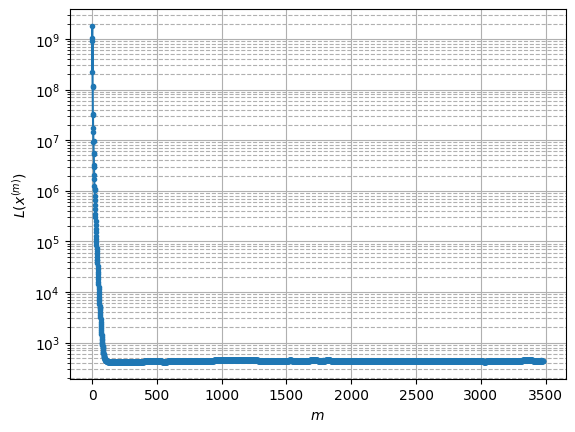

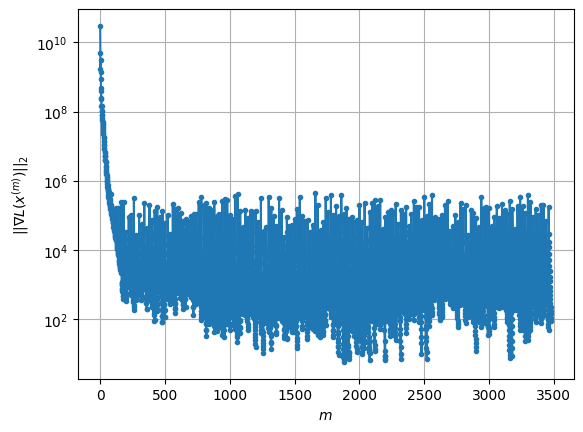

Windows:  59%|█████▉    | 174/296 [1:50:46<1:11:03, 34.94s/it]

Before applying the algorithm
Cost function: 445.27614274459495
Gradient norm: 187272.76229681348
Global relative error: 0.8429934407540475
Position relative errors: 0.04376412036753944 m, 0.4712652619813343 m, 0.20213596463723957 m, 0.6676606601763319 m

Iteration 1
Cost function: 445.0673977938956 (-0.05%)
Gradient norm: 16912.383296782253 (-90.97%)
Global relative error: 1.112135751597187 (31.93%)
Position relative errors: 0.04998484895394379 m, 0.5930430965307922 m, 0.20306317674854615 m, 0.9172845869516982 m

Iteration 2
Cost function: 445.02915842646047 (-0.01%)
Gradient norm: 10745.266686007268 (-36.47%)
Global relative error: 0.949278245425952 (-14.64%)
Position relative errors: 0.050208725817162646 m, 0.4714110101590708 m, 0.1863628001598256 m, 0.8010288853069808 m

Iteration 3
Cost function: 445.01514242010916 (-0.00%)
Gradient norm: 7362.054497738426 (-31.49%)
Global relative error: 1.065606954927438 (12.25%)
Position relative errors: 0.05030629981490706 m, 0.552321953506005

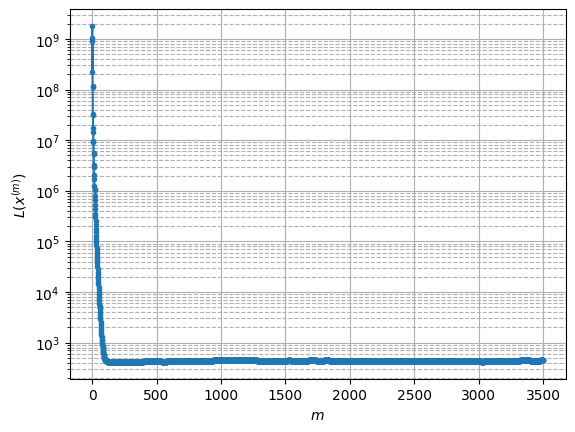

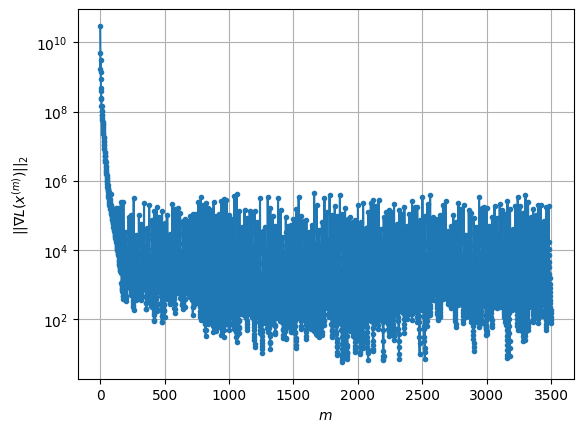

Windows:  59%|█████▉    | 175/296 [1:51:21<1:10:44, 35.08s/it]

Before applying the algorithm
Cost function: 450.65786182368896
Gradient norm: 141694.86901280217
Global relative error: 1.030701074950183
Position relative errors: 0.04925198123073095 m, 0.5234605906411257 m, 0.1638369637960077 m, 0.871242823779489 m

Iteration 1
Cost function: 450.02306386149235 (-0.14%)
Gradient norm: 22132.432577999567 (-84.38%)
Global relative error: 0.9388739666777133 (-8.91%)
Position relative errors: 0.05918776737484758 m, 0.5194059967057519 m, 0.08096633980907679 m, 0.7756555994365393 m

Iteration 2
Cost function: 449.9788612729611 (-0.01%)
Gradient norm: 10730.985799725613 (-51.51%)
Global relative error: 1.046709152320718 (11.49%)
Position relative errors: 0.05920617201390675 m, 0.6438240434206267 m, 0.10538933568557814 m, 0.8163805377252322 m

Iteration 3
Cost function: 449.96698760472265 (-0.00%)
Gradient norm: 7233.13989229141 (-32.60%)
Global relative error: 0.9605706406578666 (-8.23%)
Position relative errors: 0.05930305016437642 m, 0.6124529029777417 m

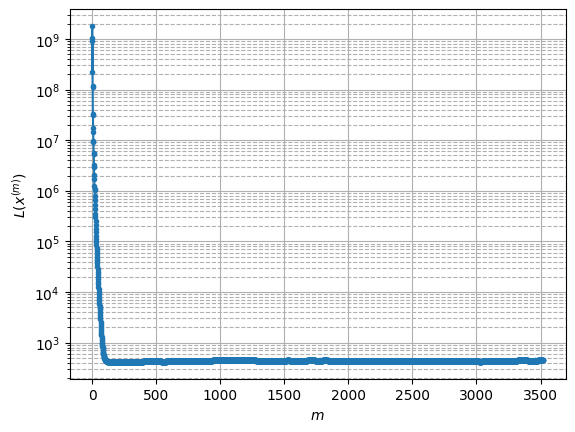

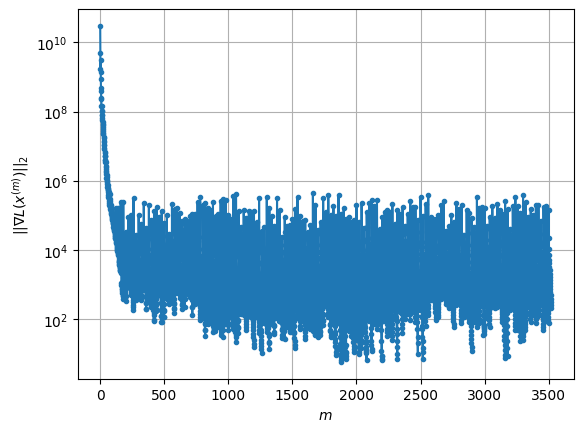

Windows:  59%|█████▉    | 176/296 [1:51:56<1:09:47, 34.89s/it]

Before applying the algorithm
Cost function: 445.898004118856
Gradient norm: 142193.4447485146
Global relative error: 0.9750927127838513
Position relative errors: 0.058199549870453976 m, 0.6747199246585384 m, 0.08964716439191617 m, 0.695797260814006 m

Iteration 1
Cost function: 444.8357212633399 (-0.24%)
Gradient norm: 17785.22886558171 (-87.49%)
Global relative error: 1.2942398555853567 (32.73%)
Position relative errors: 0.06813180580081457 m, 0.7059605660643118 m, 0.1143925624654269 m, 1.0765443183092605 m

Iteration 2
Cost function: 444.56673397218754 (-0.06%)
Gradient norm: 9029.364163742968 (-49.23%)
Global relative error: 1.2598326128502324 (-2.66%)
Position relative errors: 0.06723428104372488 m, 0.575587493425104 m, 0.15827095788950576 m, 1.1073871707672638 m

Iteration 3
Cost function: 444.4584374618083 (-0.02%)
Gradient norm: 3596.500345448475 (-60.17%)
Global relative error: 1.3383441770680173 (6.23%)
Position relative errors: 0.06658993264001448 m, 0.5612095821792926 m, 0.

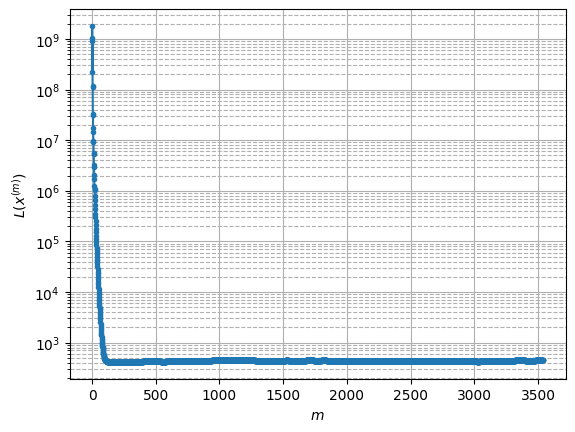

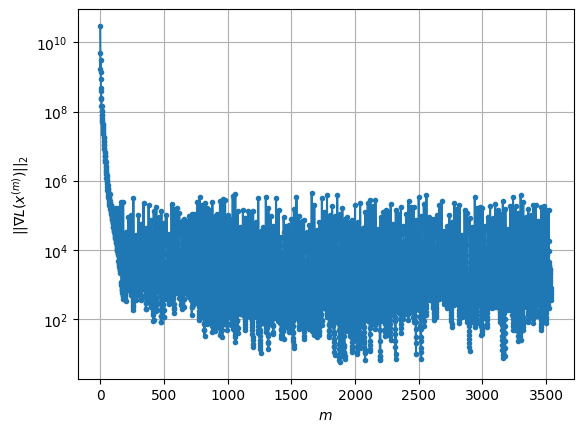

Windows:  60%|█████▉    | 177/296 [1:52:32<1:09:51, 35.22s/it]

Before applying the algorithm
Cost function: 451.02281591624063
Gradient norm: 303104.3884413096
Global relative error: 1.3711710985095882
Position relative errors: 0.06375163097079366 m, 0.39716111736533827 m, 0.26147199246042213 m, 1.2845000518523038 m

Iteration 1
Cost function: 450.6254530961203 (-0.09%)
Gradient norm: 28898.055400175977 (-90.47%)
Global relative error: 1.4097634858104338 (2.81%)
Position relative errors: 0.05945350052673637 m, 0.4664918497953765 m, 0.2639227446741815 m, 1.302546484607748 m

Iteration 2
Cost function: 450.57359872620754 (-0.01%)
Gradient norm: 15990.877627890435 (-44.66%)
Global relative error: 1.315816422253649 (-6.66%)
Position relative errors: 0.05942691405706434 m, 0.4896345976271089 m, 0.25976599079715956 m, 1.1918975856161298 m

Iteration 3
Cost function: 450.55654280204266 (-0.00%)
Gradient norm: 8008.251002973727 (-49.92%)
Global relative error: 1.3383700312439357 (1.71%)
Position relative errors: 0.05943779419753921 m, 0.5101419329132078 m

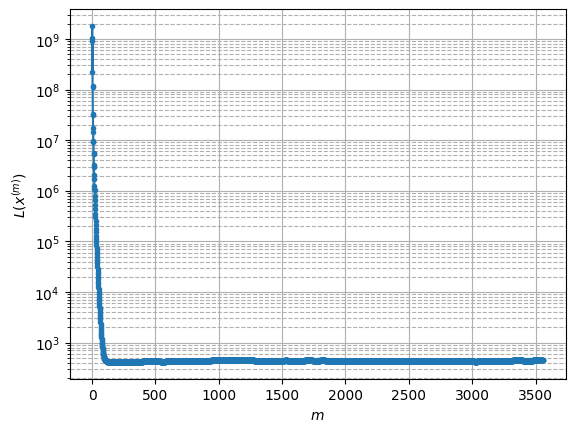

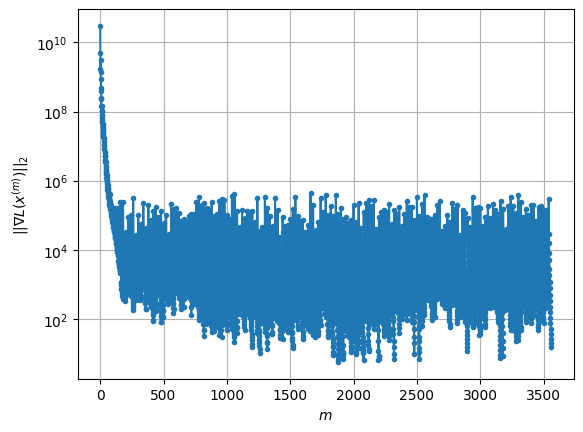

Windows:  60%|██████    | 178/296 [1:53:09<1:10:38, 35.92s/it]

Before applying the algorithm
Cost function: 454.24361353484596
Gradient norm: 237783.20395894296
Global relative error: 1.2695469864394626
Position relative errors: 0.05770278258280881 m, 0.4691861169734635 m, 0.26400920515281145 m, 1.148295369460442 m

Iteration 1
Cost function: 453.7178834126972 (-0.12%)
Gradient norm: 28339.220921872195 (-88.08%)
Global relative error: 1.1993301829768712 (-5.53%)
Position relative errors: 0.06526189537921029 m, 0.5447386807249687 m, 0.29134527788357173 m, 1.0259195758248794 m

Iteration 2
Cost function: 453.6403808781856 (-0.02%)
Gradient norm: 12816.55212296124 (-54.77%)
Global relative error: 1.1047263341861873 (-7.89%)
Position relative errors: 0.06527502006787544 m, 0.4724425164095784 m, 0.2731567421265525 m, 0.9583016758589996 m

Iteration 3
Cost function: 453.6136513965392 (-0.01%)
Gradient norm: 8017.983029030391 (-37.44%)
Global relative error: 1.1602419779733473 (5.03%)
Position relative errors: 0.06527569345554048 m, 0.5097552026292502 m,

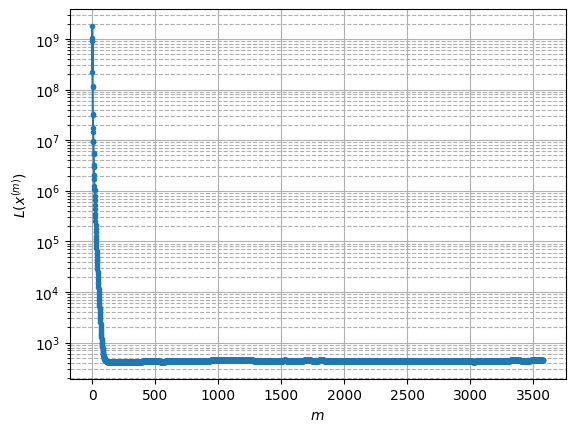

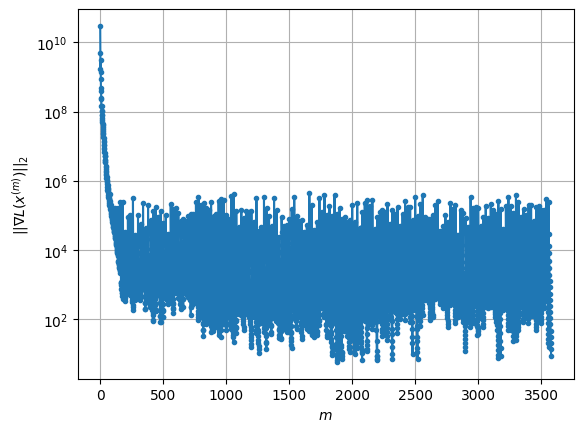

Windows:  60%|██████    | 179/296 [1:53:59<1:17:53, 39.95s/it]

Before applying the algorithm
Cost function: 449.88968142864303
Gradient norm: 301742.53215128306
Global relative error: 1.1373879490632977
Position relative errors: 0.06351485198350956 m, 0.39022317404948587 m, 0.2868977942655729 m, 1.027147393018411 m

Iteration 1
Cost function: 449.5823485024991 (-0.07%)
Gradient norm: 15911.193886487434 (-94.73%)
Global relative error: 1.2029350823516385 (5.76%)
Position relative errors: 0.06534140503848733 m, 0.4348802213482449 m, 0.34300522051240606 m, 1.0658373091680364 m

Iteration 2
Cost function: 449.56835962163245 (-0.00%)
Gradient norm: 7039.0124040513565 (-55.76%)
Global relative error: 1.1349440343202841 (-5.65%)
Position relative errors: 0.06534104610777569 m, 0.36229943158263844 m, 0.33579386851258186 m, 1.01971036974157 m

Iteration 3
Cost function: 449.5647762715132 (-0.00%)
Gradient norm: 3933.138469223393 (-44.12%)
Global relative error: 1.1910071357103234 (4.94%)
Position relative errors: 0.06533192055370232 m, 0.40209411612687335 

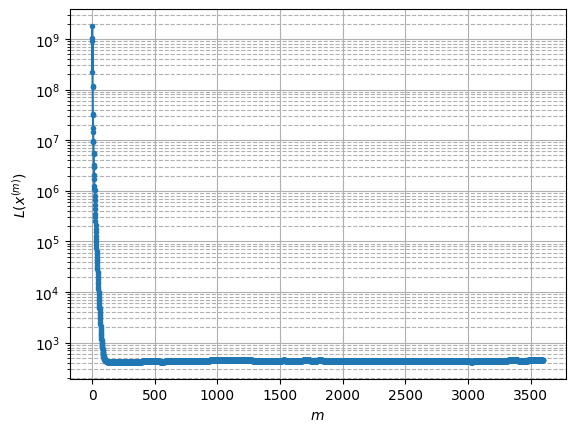

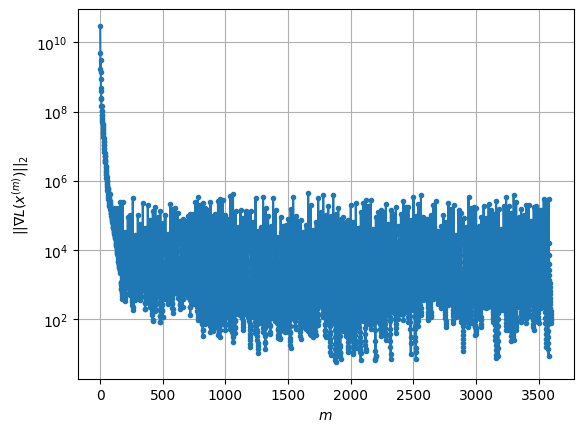

Windows:  61%|██████    | 180/296 [1:54:51<1:24:28, 43.69s/it]

Before applying the algorithm
Cost function: 452.98490297720997
Gradient norm: 170675.89563920494
Global relative error: 1.161933749827741
Position relative errors: 0.06353547357066155 m, 0.3397551795201582 m, 0.3569198779874776 m, 1.0503460968935345 m

Iteration 1
Cost function: 452.27789522411234 (-0.16%)
Gradient norm: 30600.03628111306 (-82.07%)
Global relative error: 0.8394579066746448 (-27.75%)
Position relative errors: 0.07246235957502074 m, 0.246629757082929 m, 0.3323837946452661 m, 0.7267274563112376 m

Iteration 2
Cost function: 452.1830116037884 (-0.02%)
Gradient norm: 13721.578426471444 (-55.16%)
Global relative error: 1.0235384386126738 (21.93%)
Position relative errors: 0.07207594374808285 m, 0.24399900533682592 m, 0.3565346882831135 m, 0.925085255754175 m

Iteration 3
Cost function: 452.15611998659364 (-0.01%)
Gradient norm: 10198.813518137147 (-25.67%)
Global relative error: 0.9404093621850997 (-8.12%)
Position relative errors: 0.0718556896736364 m, 0.24141567665581615 

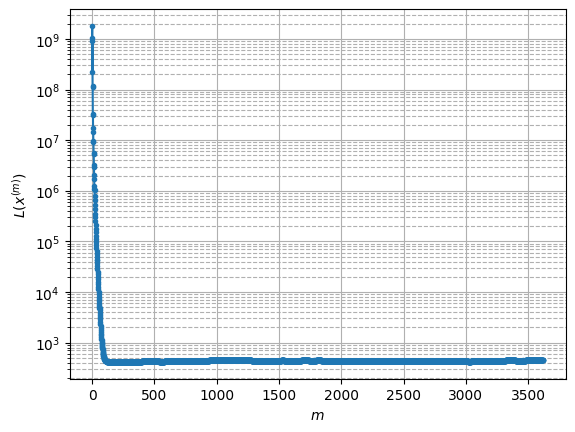

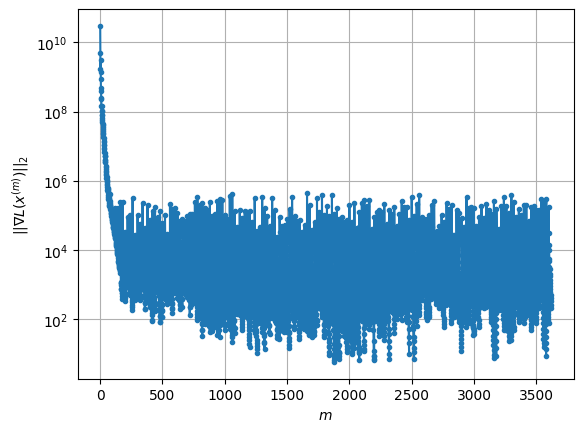

Windows:  61%|██████    | 181/296 [1:55:47<1:30:45, 47.35s/it]

Before applying the algorithm
Cost function: 451.1828319788683
Gradient norm: 55319.21621723763
Global relative error: 1.062762604545272
Position relative errors: 0.06935478942224933 m, 0.2694604566523714 m, 0.39860155139166237 m, 0.9450721749077969 m

Iteration 1
Cost function: 450.98631550878366 (-0.04%)
Gradient norm: 26828.451619902145 (-51.50%)
Global relative error: 0.9321969774719644 (-12.29%)
Position relative errors: 0.07667234967783522 m, 0.3748487371697257 m, 0.45824591434160206 m, 0.715968530204929 m

Iteration 2
Cost function: 450.9571608793735 (-0.01%)
Gradient norm: 14325.44995241802 (-46.60%)
Global relative error: 1.032801177997819 (10.79%)
Position relative errors: 0.07671748032515015 m, 0.3144535605286121 m, 0.4435878100119069 m, 0.8747232545067337 m

Iteration 3
Cost function: 450.9494540621183 (-0.00%)
Gradient norm: 7158.773038318684 (-50.03%)
Global relative error: 0.9962725282304362 (-3.54%)
Position relative errors: 0.07674341587569959 m, 0.3701083756451423 m, 

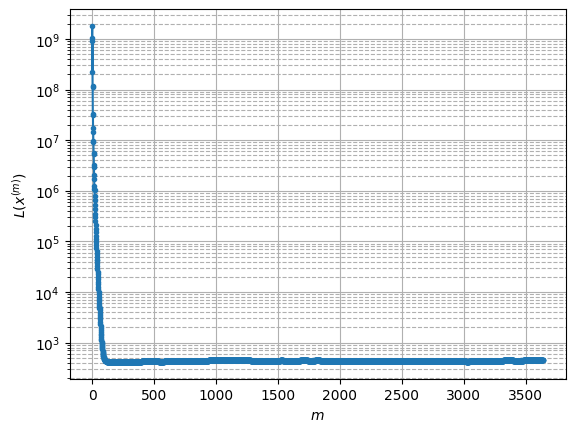

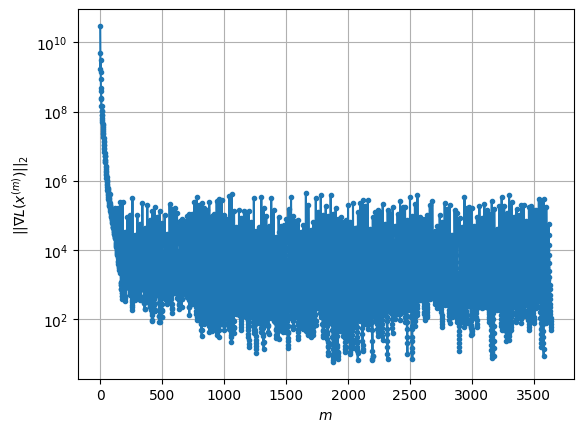

Windows:  61%|██████▏   | 182/296 [1:56:41<1:33:54, 49.42s/it]

Before applying the algorithm
Cost function: 453.7328831232594
Gradient norm: 78512.88422295301
Global relative error: 1.0510223284965787
Position relative errors: 0.0747369526392111 m, 0.38989804352952345 m, 0.4628453686556616 m, 0.8560462569047472 m

Iteration 1
Cost function: 453.236217659089 (-0.11%)
Gradient norm: 23419.95009255008 (-70.17%)
Global relative error: 0.8663855123488235 (-17.57%)
Position relative errors: 0.08661252525103406 m, 0.5072385144192069 m, 0.36466110134408075 m, 0.5940138363958261 m

Iteration 2
Cost function: 453.12234669572155 (-0.03%)
Gradient norm: 14658.132592032383 (-37.41%)
Global relative error: 0.8995702991073854 (3.83%)
Position relative errors: 0.08707036291748335 m, 0.43925600618183114 m, 0.3590447159877102 m, 0.6926653610309941 m

Iteration 3
Cost function: 453.07799988386154 (-0.01%)
Gradient norm: 9395.172401600734 (-35.90%)
Global relative error: 0.8927116937775849 (-0.76%)
Position relative errors: 0.08736953904516366 m, 0.48892990759272476 

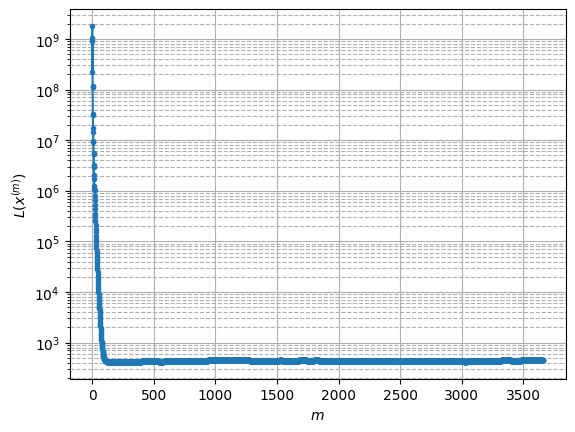

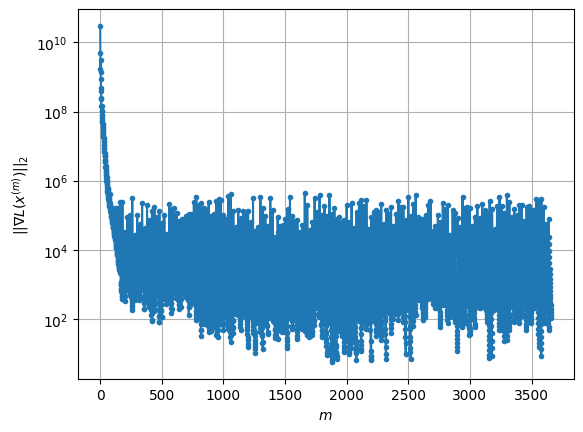

Windows:  62%|██████▏   | 183/296 [1:57:26<1:30:13, 47.91s/it]

Before applying the algorithm
Cost function: 450.71435701693815
Gradient norm: 235428.76629680267
Global relative error: 1.0526289307831793
Position relative errors: 0.08556555905489857 m, 0.5931626835069669 m, 0.36343401844509726 m, 0.7853525734666178 m

Iteration 1
Cost function: 450.1956359293624 (-0.12%)
Gradient norm: 17155.16254996 (-92.71%)
Global relative error: 1.1277078771876579 (7.13%)
Position relative errors: 0.07014786732670353 m, 0.8515513299867168 m, 0.35881975970480723 m, 0.6425821311463298 m

Iteration 2
Cost function: 450.1519810760364 (-0.01%)
Gradient norm: 5882.725341450717 (-65.71%)
Global relative error: 1.159126207138675 (2.79%)
Position relative errors: 0.06978987195723509 m, 0.8012254014175452 m, 0.3741242877908365 m, 0.7461705881502058 m

Iteration 3
Cost function: 450.1376263053069 (-0.00%)
Gradient norm: 5175.461312017588 (-12.02%)
Global relative error: 1.2008472357234647 (3.60%)
Position relative errors: 0.06955632002397052 m, 0.8749838303040586 m, 0.378

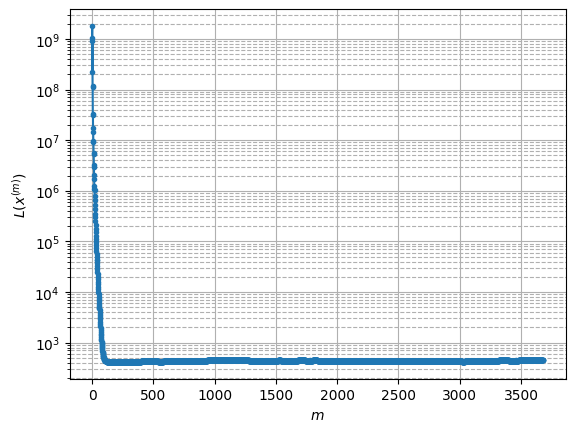

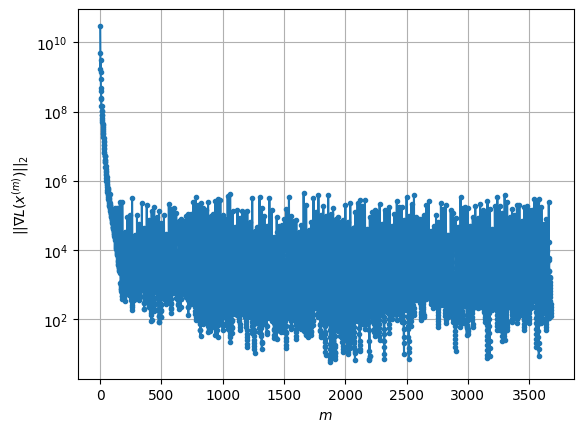

Windows:  62%|██████▏   | 184/296 [1:58:02<1:22:48, 44.37s/it]

Before applying the algorithm
Cost function: 453.73242791950344
Gradient norm: 262158.4640503719
Global relative error: 1.327714630155841
Position relative errors: 0.06771222576719384 m, 0.9510427955527793 m, 0.4213794885869111 m, 0.8223120022775203 m

Iteration 1
Cost function: 453.3043277866093 (-0.09%)
Gradient norm: 39480.80690587829 (-84.94%)
Global relative error: 1.5154983710642873 (14.14%)
Position relative errors: 0.06446282944502206 m, 1.1963942653369954 m, 0.42302166041030265 m, 0.8259979009678023 m

Iteration 2
Cost function: 453.22512952178755 (-0.02%)
Gradient norm: 13909.859095263222 (-64.77%)
Global relative error: 1.4975418354944068 (-1.18%)
Position relative errors: 0.06447372957769014 m, 1.1255404428814328 m, 0.42622521418000275 m, 0.8887996680713394 m

Iteration 3
Cost function: 453.20095626752396 (-0.01%)
Gradient norm: 7840.860927634569 (-43.63%)
Global relative error: 1.5313715190910315 (2.26%)
Position relative errors: 0.06449014638314496 m, 1.179564373121042 m,

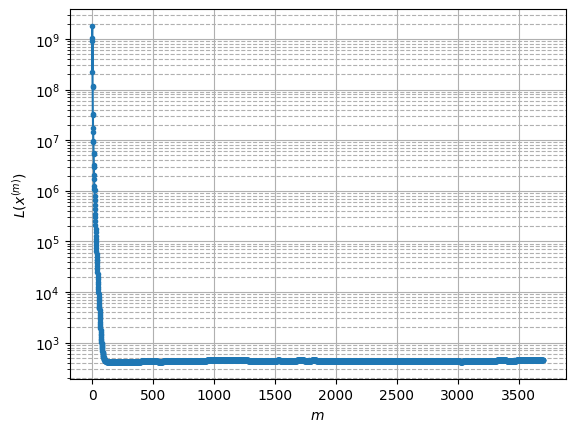

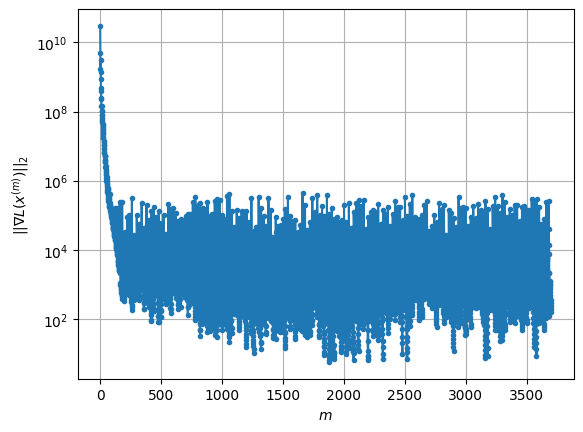

Windows:  62%|██████▎   | 185/296 [1:58:38<1:17:44, 42.02s/it]

Before applying the algorithm
Cost function: 450.03617347582497
Gradient norm: 45511.5756273698
Global relative error: 1.535373092080771
Position relative errors: 0.06318055355507725 m, 1.1655607683399996 m, 0.4510585918759849 m, 0.8896024835441557 m

Iteration 1
Cost function: 449.7617685073965 (-0.06%)
Gradient norm: 17416.580691368643 (-61.73%)
Global relative error: 1.489195577733897 (-3.01%)
Position relative errors: 0.0719672561422362 m, 0.9732079716467259 m, 0.4621475106997291 m, 1.025577783498139 m

Iteration 2
Cost function: 449.7465009638979 (-0.00%)
Gradient norm: 7906.021076817479 (-54.61%)
Global relative error: 1.4861360087092201 (-0.21%)
Position relative errors: 0.07207171497286274 m, 1.0520136884673637 m, 0.45561677101067666 m, 0.942913642857449 m

Iteration 3
Cost function: 449.7423754584181 (-0.00%)
Gradient norm: 4900.435148545567 (-38.02%)
Global relative error: 1.464274794004121 (-1.47%)
Position relative errors: 0.07215272164028816 m, 0.9879553304106831 m, 0.4546

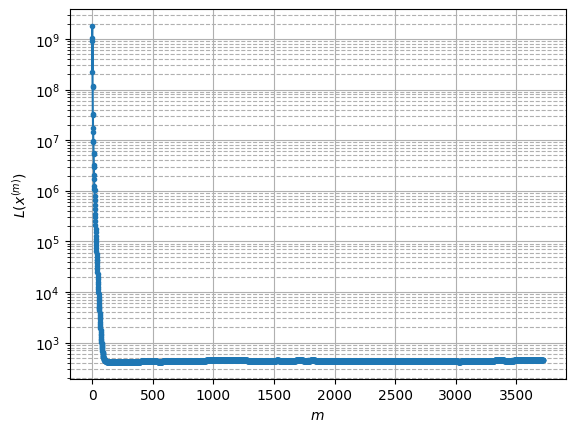

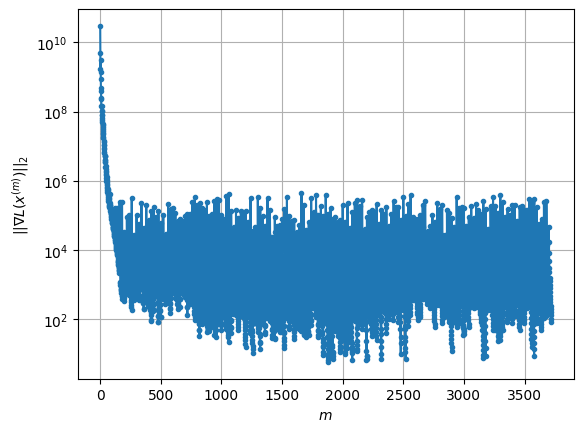

Windows:  63%|██████▎   | 186/296 [1:59:13<1:13:07, 39.89s/it]

Before applying the algorithm
Cost function: 452.563102480419
Gradient norm: 111683.71644412215
Global relative error: 1.4429572496221001
Position relative errors: 0.07111486273416173 m, 0.9889113483118547 m, 0.47309134596155306 m, 0.9355784109360386 m

Iteration 1
Cost function: 451.97363582649325 (-0.13%)
Gradient norm: 38738.577946410114 (-65.31%)
Global relative error: 1.7484859369996222 (21.17%)
Position relative errors: 0.07783551721794328 m, 1.0433456810983457 m, 0.5293560022905075 m, 1.2970567058815612 m

Iteration 2
Cost function: 451.89047834621346 (-0.02%)
Gradient norm: 12053.368898633385 (-68.89%)
Global relative error: 1.8053483430491295 (3.25%)
Position relative errors: 0.07749201609560037 m, 1.1109144523114327 m, 0.5332470164969326 m, 1.317115718242359 m

Iteration 3
Cost function: 451.8698960339053 (-0.00%)
Gradient norm: 7253.605123971859 (-39.82%)
Global relative error: 1.8744466221166214 (3.83%)
Position relative errors: 0.07728518886076977 m, 1.1536656848299331 m, 

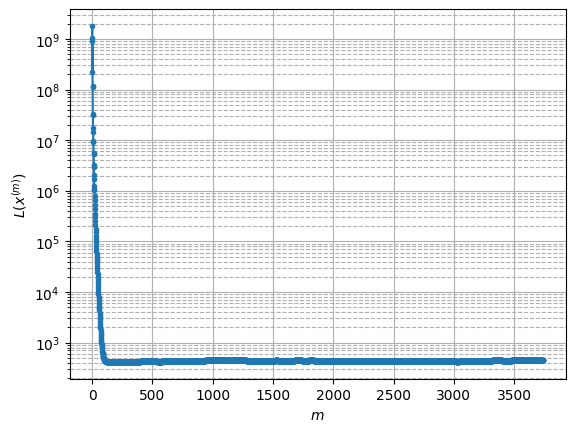

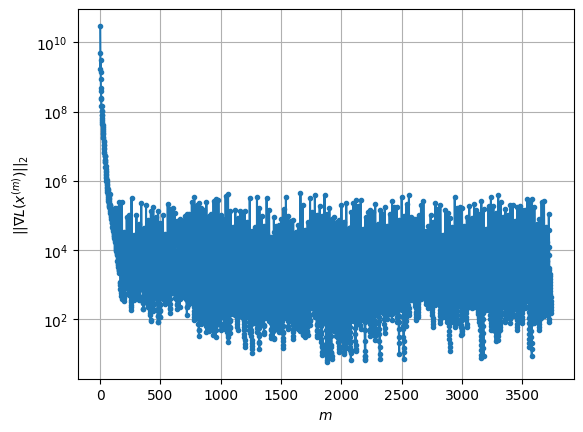

Windows:  63%|██████▎   | 187/296 [1:59:48<1:09:51, 38.45s/it]

Before applying the algorithm
Cost function: 457.1829060861253
Gradient norm: 153139.0118931926
Global relative error: 1.9297946973318907
Position relative errors: 0.07566546407706302 m, 1.1990678338637197 m, 0.584332510614679 m, 1.3925420791387786 m

Iteration 1
Cost function: 456.45739986454765 (-0.16%)
Gradient norm: 48567.398281498805 (-68.29%)
Global relative error: 1.7374773875008804 (-9.97%)
Position relative errors: 0.06260488962682381 m, 1.324878323094412 m, 0.6216301621323342 m, 0.9344417386770423 m

Iteration 2
Cost function: 456.37840924879 (-0.02%)
Gradient norm: 19029.385472580158 (-60.82%)
Global relative error: 1.6821244474440602 (-3.19%)
Position relative errors: 0.06257408537046197 m, 1.1701471835158914 m, 0.6215366101922155 m, 1.034444097138095 m

Iteration 3
Cost function: 456.3622591328006 (-0.00%)
Gradient norm: 10145.37360563793 (-46.69%)
Global relative error: 1.643690687536444 (-2.28%)
Position relative errors: 0.06250040909862704 m, 1.2069014252852805 m, 0.623

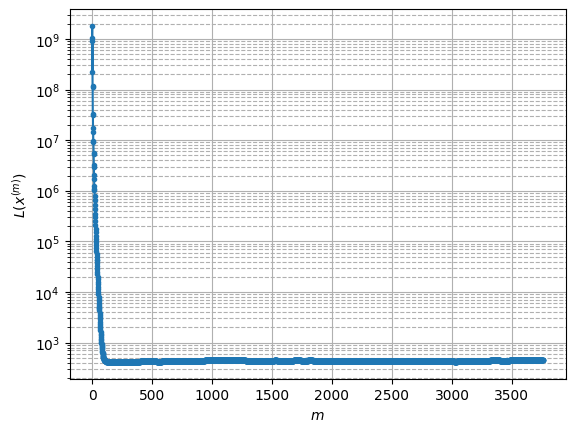

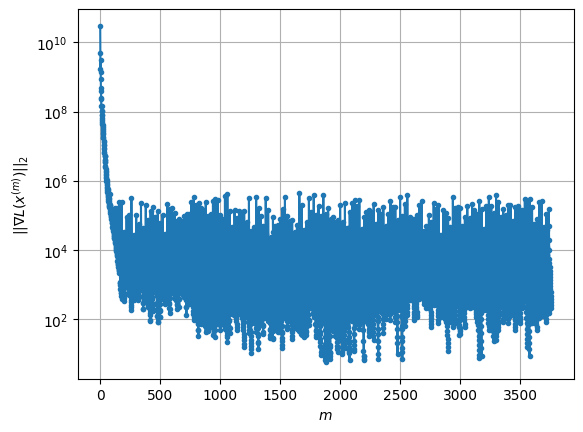

Windows:  64%|██████▎   | 188/296 [2:00:22<1:06:38, 37.02s/it]

Before applying the algorithm
Cost function: 453.7356428072425
Gradient norm: 78079.86919019077
Global relative error: 1.5574020686493497
Position relative errors: 0.062101226469547736 m, 1.1173106336167729 m, 0.639096912247399 m, 0.8745378312237015 m

Iteration 1
Cost function: 453.3248212286229 (-0.09%)
Gradient norm: 20586.89838315971 (-73.63%)
Global relative error: 1.5730712775996678 (1.01%)
Position relative errors: 0.06369315707177216 m, 0.8721867883063376 m, 0.7795464272904035 m, 1.049806481562372 m

Iteration 2
Cost function: 453.2473829133966 (-0.02%)
Gradient norm: 12696.931127839947 (-38.33%)
Global relative error: 1.5437424603986418 (-1.86%)
Position relative errors: 0.06334048461936277 m, 0.9492676042504865 m, 0.7630668253215603 m, 0.9464398790119798 m

Iteration 3
Cost function: 453.2218777034701 (-0.01%)
Gradient norm: 8043.354502604359 (-36.65%)
Global relative error: 1.5241776609474353 (-1.27%)
Position relative errors: 0.06317100641813019 m, 0.8746786130448421 m, 0.7

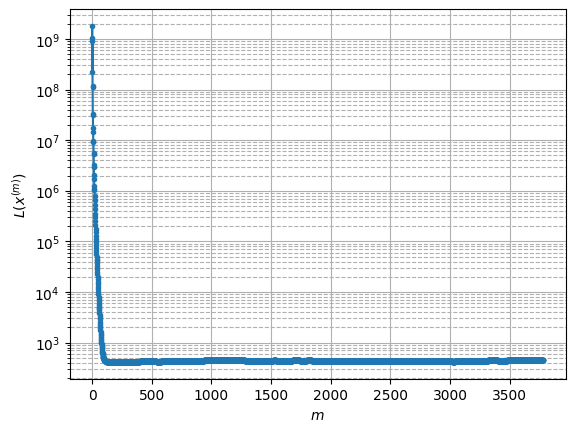

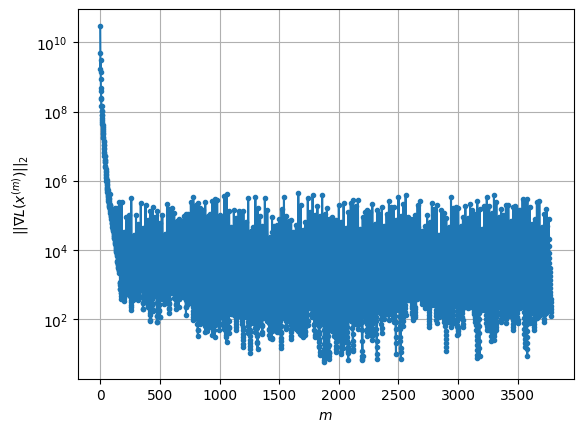

Windows:  64%|██████▍   | 189/296 [2:00:56<1:04:29, 36.16s/it]

Before applying the algorithm
Cost function: 450.6475520339286
Gradient norm: 85052.37287546528
Global relative error: 1.423584796265838
Position relative errors: 0.06261082771089409 m, 0.8035924288583592 m, 0.7938738946212706 m, 0.8641045269546815 m

Iteration 1
Cost function: 450.20760079071175 (-0.10%)
Gradient norm: 8147.778182739467 (-90.42%)
Global relative error: 1.3460777716961614 (-5.44%)
Position relative errors: 0.054433564105117994 m, 0.4340894355332588 m, 0.8245920625834662 m, 0.9698330065728746 m

Iteration 2
Cost function: 450.1548372034972 (-0.01%)
Gradient norm: 4987.083035967962 (-38.79%)
Global relative error: 1.2073463172598713 (-10.31%)
Position relative errors: 0.05463728864531494 m, 0.47790074307961866 m, 0.7763006431365583 m, 0.7897262734564716 m

Iteration 3
Cost function: 450.1393716999076 (-0.00%)
Gradient norm: 3306.2100748063763 (-33.70%)
Global relative error: 1.17186970433961 (-2.94%)
Position relative errors: 0.05480910045649321 m, 0.36784611806504114 m,

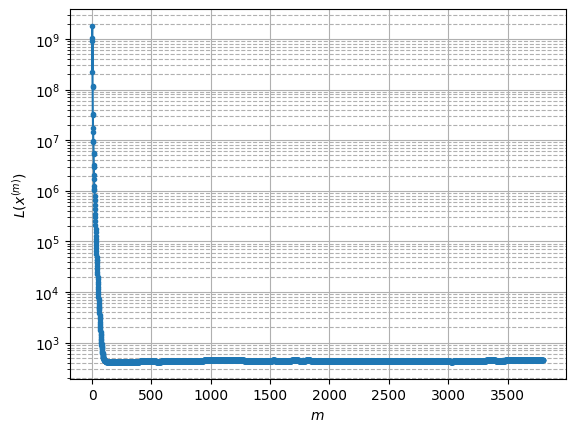

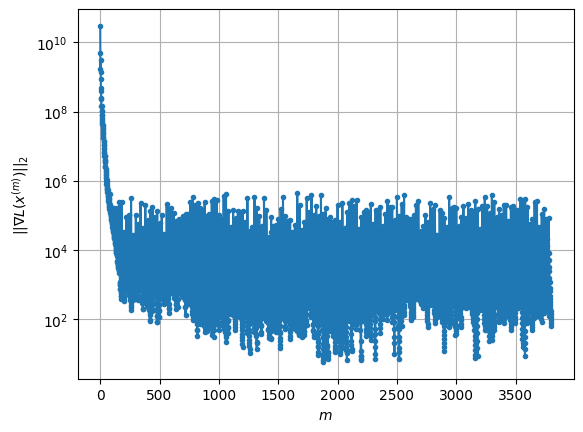

Windows:  64%|██████▍   | 190/296 [2:01:31<1:03:01, 35.68s/it]

Before applying the algorithm
Cost function: 448.93074685040807
Gradient norm: 108686.0469743004
Global relative error: 1.0663044325715312
Position relative errors: 0.05575181937279885 m, 0.32429667743354407 m, 0.7448350248351291 m, 0.6884393308444249 m

Iteration 1
Cost function: 448.63983277631837 (-0.06%)
Gradient norm: 11545.730128037572 (-89.38%)
Global relative error: 1.2401585055556474 (16.30%)
Position relative errors: 0.05622401713717772 m, 0.516196855166485 m, 0.6004039549859299 m, 0.9528312621618339 m

Iteration 2
Cost function: 448.59386830174265 (-0.01%)
Gradient norm: 1572.6294839943307 (-86.38%)
Global relative error: 1.34832119291342 (8.72%)
Position relative errors: 0.05619429861068798 m, 0.6120394914344367 m, 0.653636557968116 m, 1.0064683961775291 m

Iteration 3
Cost function: 448.5830678482145 (-0.00%)
Gradient norm: 1810.1281323156038 (15.10%)
Global relative error: 1.4336733660639926 (6.33%)
Position relative errors: 0.05615350326787223 m, 0.6618644836969306 m, 0.

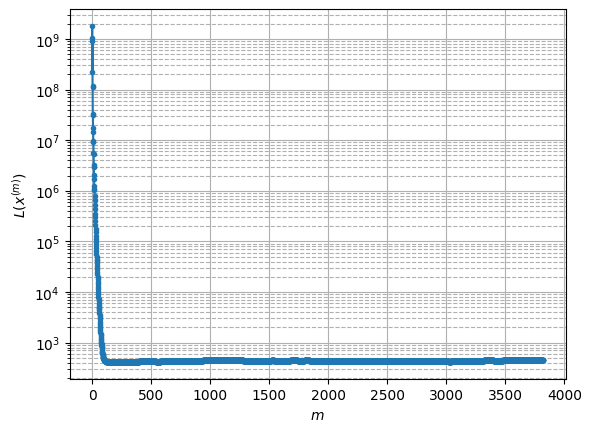

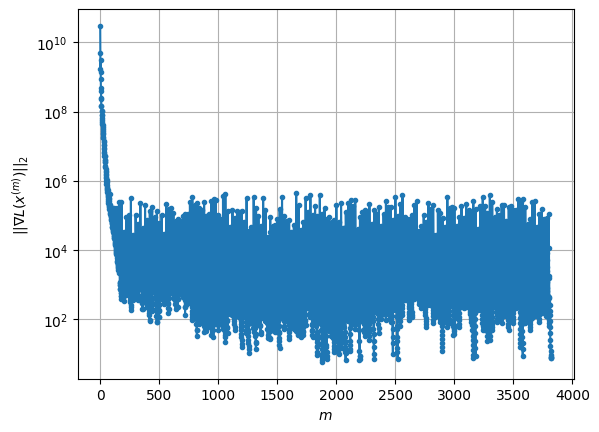

Windows:  65%|██████▍   | 191/296 [2:02:05<1:01:31, 35.16s/it]

Before applying the algorithm
Cost function: 450.4978254251301
Gradient norm: 236132.88260597552
Global relative error: 1.549391669844936
Position relative errors: 0.056728917593169496 m, 0.7736502340120816 m, 0.6741905652887185 m, 1.1594516878691918 m

Iteration 1
Cost function: 450.2828435804502 (-0.05%)
Gradient norm: 6177.483658098668 (-97.38%)
Global relative error: 1.6031321366922877 (3.47%)
Position relative errors: 0.057148628848290604 m, 0.8642873947574007 m, 0.5842474594988505 m, 1.215906382604517 m

Iteration 2
Cost function: 450.2685560487064 (-0.00%)
Gradient norm: 2316.983187013538 (-62.49%)
Global relative error: 1.619337740412238 (1.01%)
Position relative errors: 0.0571707217644956 m, 0.877771435128947 m, 0.6128697232386889 m, 1.2136283143352475 m

Iteration 3
Cost function: 450.2657061412609 (-0.00%)
Gradient norm: 1304.1492377132674 (-43.71%)
Global relative error: 1.6420540761574913 (1.40%)
Position relative errors: 0.05715196228544486 m, 0.8859278455011504 m, 0.6065

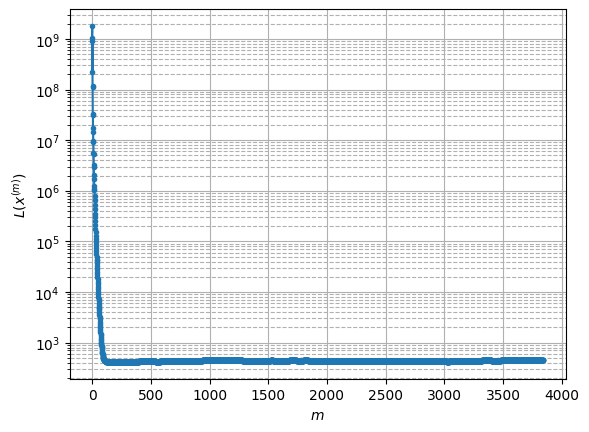

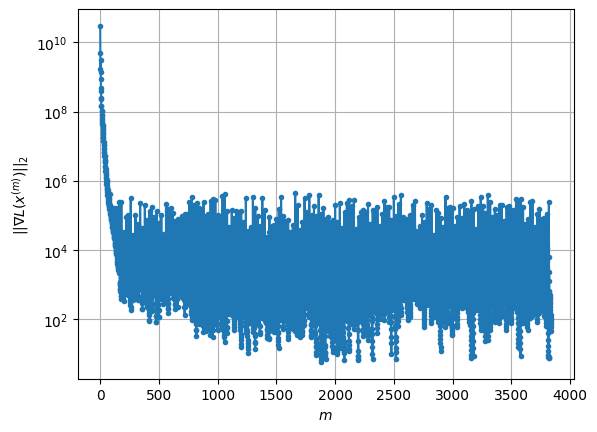

Windows:  65%|██████▍   | 192/296 [2:02:39<1:00:37, 34.98s/it]

Before applying the algorithm
Cost function: 452.17334486721586
Gradient norm: 90903.62598267959
Global relative error: 1.6429375773906003
Position relative errors: 0.05742776884745032 m, 0.9135644725963977 m, 0.6107088153932603 m, 1.2199918153312324 m

Iteration 1
Cost function: 451.91078273955316 (-0.06%)
Gradient norm: 23399.352684754045 (-74.26%)
Global relative error: 1.5809686936518246 (-3.77%)
Position relative errors: 0.05468601945254083 m, 0.9919890690891301 m, 0.5319517252499909 m, 1.1088084095648485 m

Iteration 2
Cost function: 451.8809293350208 (-0.01%)
Gradient norm: 9471.821516236414 (-59.52%)
Global relative error: 1.5249884080114116 (-3.54%)
Position relative errors: 0.05492188314480098 m, 0.8851504227544602 m, 0.5403932885617866 m, 1.1167168883009837 m

Iteration 3
Cost function: 451.87239532139563 (-0.00%)
Gradient norm: 5663.839907724945 (-40.20%)
Global relative error: 1.5034351221177156 (-1.41%)
Position relative errors: 0.05500290065330309 m, 0.915492105368129 m,

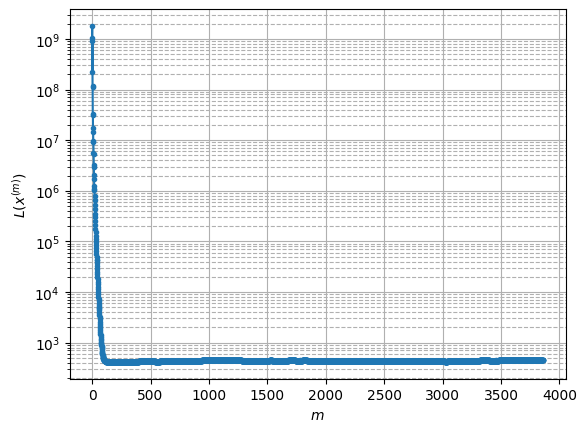

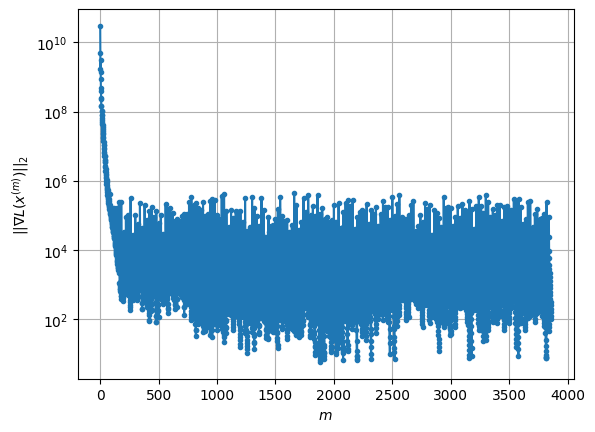

Windows:  65%|██████▌   | 193/296 [2:03:14<1:00:10, 35.05s/it]

Before applying the algorithm
Cost function: 459.79079841270556
Gradient norm: 142545.88528373945
Global relative error: 1.4681879615250242
Position relative errors: 0.05515276787339746 m, 0.8984694201429735 m, 0.5121282666509742 m, 1.0406781240413827 m

Iteration 1
Cost function: 458.8128574139262 (-0.21%)
Gradient norm: 34045.317545391095 (-76.12%)
Global relative error: 1.940706731576496 (32.18%)
Position relative errors: 0.04333196589403275 m, 0.9362390003150364 m, 0.38145488693552143 m, 1.6560232466329263 m

Iteration 2
Cost function: 458.6853515735297 (-0.03%)
Gradient norm: 11358.268502308043 (-66.64%)
Global relative error: 2.0900289867629187 (7.69%)
Position relative errors: 0.04322638037350955 m, 1.2432469574576417 m, 0.4341951850292487 m, 1.622394391583391 m

Iteration 3
Cost function: 458.64828315327946 (-0.01%)
Gradient norm: 7326.099865505094 (-35.50%)
Global relative error: 2.2589447525485133 (8.08%)
Position relative errors: 0.04319113462744392 m, 1.230817368869985 m, 0

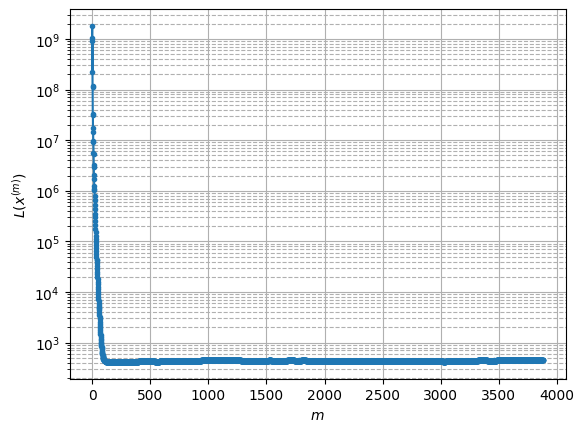

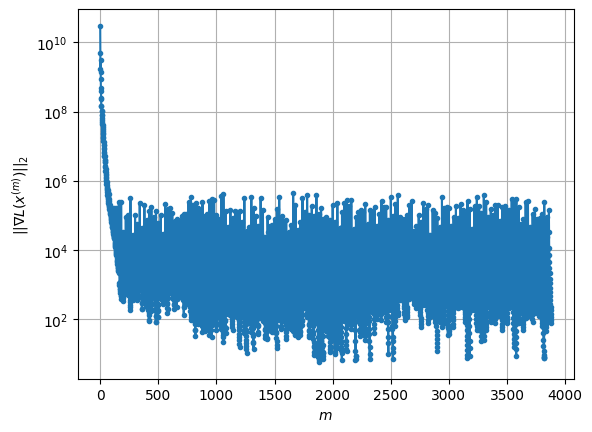

Windows:  66%|██████▌   | 194/296 [2:03:49<59:25, 34.96s/it]  

Before applying the algorithm
Cost function: 459.04019179444083
Gradient norm: 54137.344535193675
Global relative error: 2.495410471558259
Position relative errors: 0.04432555907291056 m, 1.481283394436731 m, 0.4722983162406924 m, 1.951369186950373 m

Iteration 1
Cost function: 458.6882109646298 (-0.08%)
Gradient norm: 13855.04576086732 (-74.41%)
Global relative error: 2.42369183635174 (-2.87%)
Position relative errors: 0.04538681363912368 m, 1.145711159092324 m, 0.676345059368907 m, 2.025370303377929 m

Iteration 2
Cost function: 458.64104674195084 (-0.01%)
Gradient norm: 4084.853136334967 (-70.52%)
Global relative error: 2.331377801988647 (-3.81%)
Position relative errors: 0.0452144056725626 m, 1.193429166046929 m, 0.6363923877900175 m, 1.8984227919030632 m

Iteration 3
Cost function: 458.6288930797631 (-0.00%)
Gradient norm: 2874.158335063023 (-29.64%)
Global relative error: 2.2875791004986192 (-1.88%)
Position relative errors: 0.045176855213436264 m, 1.0919895705681748 m, 0.6488779

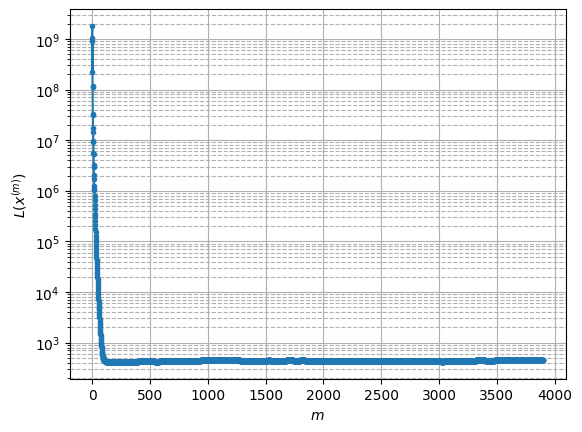

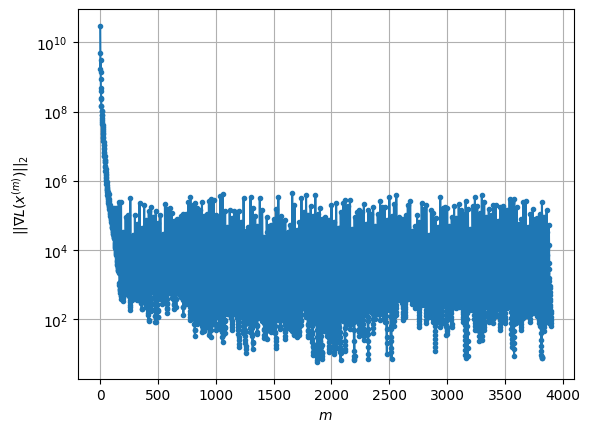

Windows:  66%|██████▌   | 195/296 [2:04:24<58:41, 34.87s/it]

Before applying the algorithm
Cost function: 461.2394075423954
Gradient norm: 109181.43978583116
Global relative error: 2.0900633038084915
Position relative errors: 0.045726616819198575 m, 0.9947616872239513 m, 0.6240357598723718 m, 1.7283811695427975 m

Iteration 1
Cost function: 460.67566035032866 (-0.12%)
Gradient norm: 32917.81052113562 (-69.85%)
Global relative error: 1.8460749847988327 (-11.67%)
Position relative errors: 0.042310306749734024 m, 1.201435517591536 m, 0.5840206204783313 m, 1.2734500123294568 m

Iteration 2
Cost function: 460.564094940461 (-0.02%)
Gradient norm: 10006.602979587145 (-69.60%)
Global relative error: 1.7024996032100597 (-7.78%)
Position relative errors: 0.042497701896499034 m, 0.7990527588408648 m, 0.5596747995701399 m, 1.3946244232961689 m

Iteration 3
Cost function: 460.52584562514966 (-0.01%)
Gradient norm: 4647.376908522497 (-53.56%)
Global relative error: 1.5706531361760412 (-7.74%)
Position relative errors: 0.04253714853693761 m, 0.9278227084802696

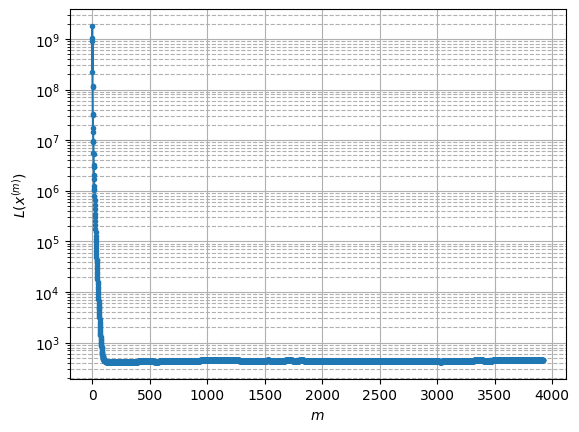

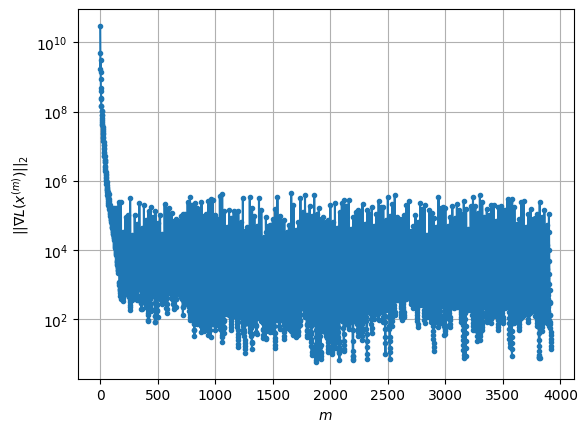

Windows:  66%|██████▌   | 196/296 [2:04:58<57:58, 34.78s/it]

Before applying the algorithm
Cost function: 463.3989537240697
Gradient norm: 309556.18966105965
Global relative error: 1.3740752596928802
Position relative errors: 0.04363702385252564 m, 0.7238321444630463 m, 0.4870517799941364 m, 1.0606723557195084 m

Iteration 1
Cost function: 462.94956675763444 (-0.10%)
Gradient norm: 26959.147448868804 (-91.29%)
Global relative error: 1.163964250071696 (-15.29%)
Position relative errors: 0.040735249678271246 m, 0.8894580553753435 m, 0.5319065497312205 m, 0.5282922060954527 m

Iteration 2
Cost function: 462.83442072610126 (-0.02%)
Gradient norm: 16560.418786272498 (-38.57%)
Global relative error: 1.0053228165840162 (-13.63%)
Position relative errors: 0.04091565794824522 m, 0.5821944824892341 m, 0.4690602960860257 m, 0.6708437610337695 m

Iteration 3
Cost function: 462.78838140443884 (-0.01%)
Gradient norm: 10752.365000268785 (-35.07%)
Global relative error: 0.9500492266267052 (-5.50%)
Position relative errors: 0.040989802855901196 m, 0.687481466261

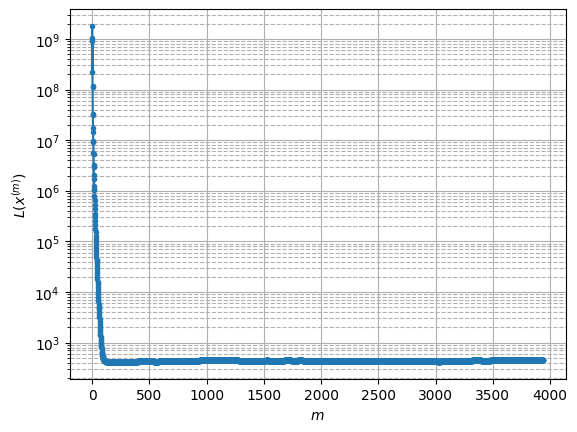

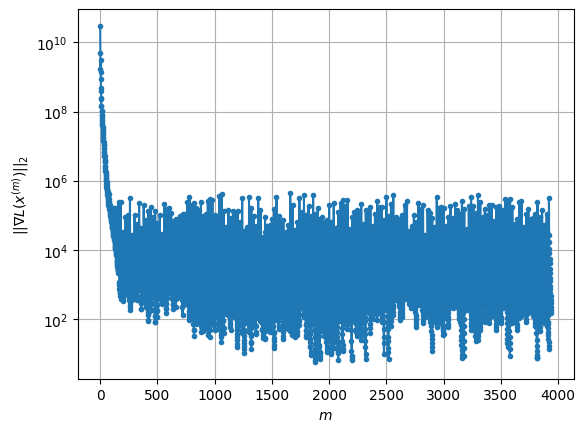

Windows:  67%|██████▋   | 197/296 [2:05:33<57:22, 34.77s/it]

Before applying the algorithm
Cost function: 462.5342856871541
Gradient norm: 64937.27923966587
Global relative error: 0.7643713400504836
Position relative errors: 0.04207656614729227 m, 0.5098425199784165 m, 0.41416553963295505 m, 0.3886126876224145 m

Iteration 1
Cost function: 462.0666380129073 (-0.10%)
Gradient norm: 12638.205058190993 (-80.54%)
Global relative error: 0.8732336554540311 (14.24%)
Position relative errors: 0.03467398639394138 m, 0.6184688041371105 m, 0.4521026285999371 m, 0.4176506110134188 m

Iteration 2
Cost function: 462.0323298391339 (-0.01%)
Gradient norm: 8592.218730697781 (-32.01%)
Global relative error: 0.8126335533251184 (-6.94%)
Position relative errors: 0.03475359752897082 m, 0.5671318824379206 m, 0.4184695808940028 m, 0.4029986674288582 m

Iteration 3
Cost function: 462.02292785550173 (-0.00%)
Gradient norm: 5411.271695553547 (-37.02%)
Global relative error: 0.8500517862737408 (4.60%)
Position relative errors: 0.03479473639219317 m, 0.6046009064675857 m, 

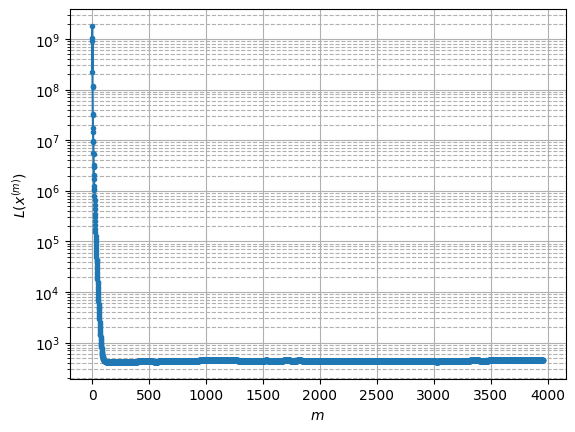

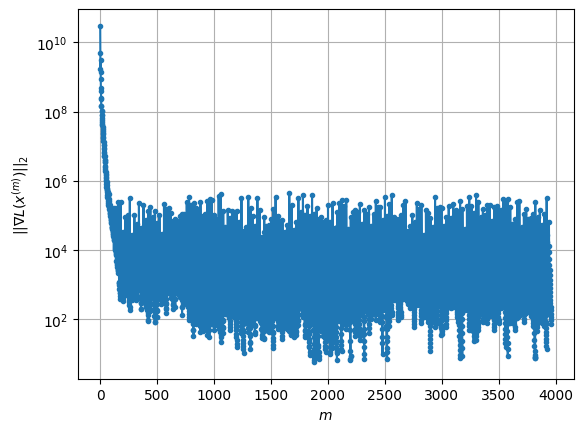

Windows:  67%|██████▋   | 198/296 [2:06:07<56:12, 34.41s/it]

Before applying the algorithm
Cost function: 464.47675823516806
Gradient norm: 280806.49054971273
Global relative error: 0.8360947739508306
Position relative errors: 0.03572637705633946 m, 0.5915750880012018 m, 0.4048049852471899 m, 0.4288907165974186 m

Iteration 1
Cost function: 463.6827258507962 (-0.17%)
Gradient norm: 43460.069559713025 (-84.52%)
Global relative error: 1.2693686599615772 (51.82%)
Position relative errors: 0.03170390984907453 m, 0.7289736354516881 m, 0.4696498118537743 m, 0.9264517870704375 m

Iteration 2
Cost function: 463.5037043124212 (-0.04%)
Gradient norm: 30193.60342616089 (-30.53%)
Global relative error: 1.0247651629700067 (-19.27%)
Position relative errors: 0.03172529328987085 m, 0.47958448045890484 m, 0.39500834506349763 m, 0.8143090331731687 m

Iteration 3
Cost function: 463.42883239061064 (-0.02%)
Gradient norm: 20815.253159496748 (-31.06%)
Global relative error: 1.1961544035071037 (16.72%)
Position relative errors: 0.031731989908379665 m, 0.5444164612041

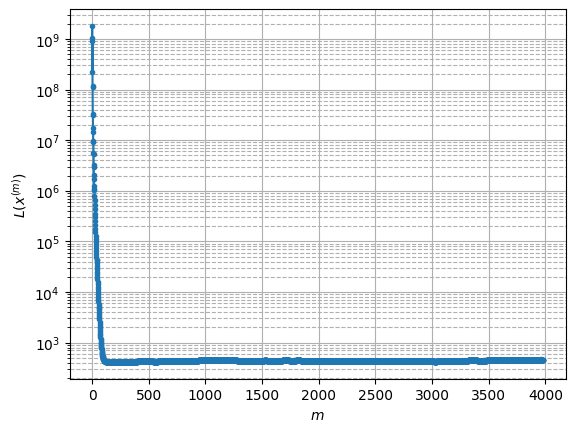

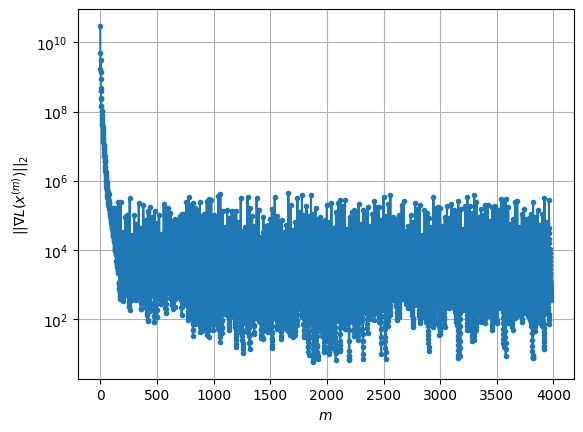

Windows:  67%|██████▋   | 199/296 [2:06:40<55:12, 34.15s/it]

Before applying the algorithm
Cost function: 463.7428085353215
Gradient norm: 106336.2037257012
Global relative error: 1.281768254221519
Position relative errors: 0.03277652103757163 m, 0.29866842765018137 m, 0.3443045189614294 m, 1.197539467813718 m

Iteration 1
Cost function: 463.4358598093846 (-0.07%)
Gradient norm: 28649.18807036026 (-73.06%)
Global relative error: 1.8176278711376654 (41.81%)
Position relative errors: 0.034957263503748386 m, 0.61776529562938 m, 0.3483316266148485 m, 1.6731927888902787 m

Iteration 2
Cost function: 463.35150524025426 (-0.02%)
Gradient norm: 14959.192439962948 (-47.78%)
Global relative error: 1.517580541407712 (-16.51%)
Position relative errors: 0.03489779872340735 m, 0.2661862132434058 m, 0.3177502310346716 m, 1.4594541931128653 m

Iteration 3
Cost function: 463.316756701 (-0.01%)
Gradient norm: 8077.482656706757 (-46.00%)
Global relative error: 1.7926765878226807 (18.13%)
Position relative errors: 0.03490031676630471 m, 0.39839815284141494 m, 0.311

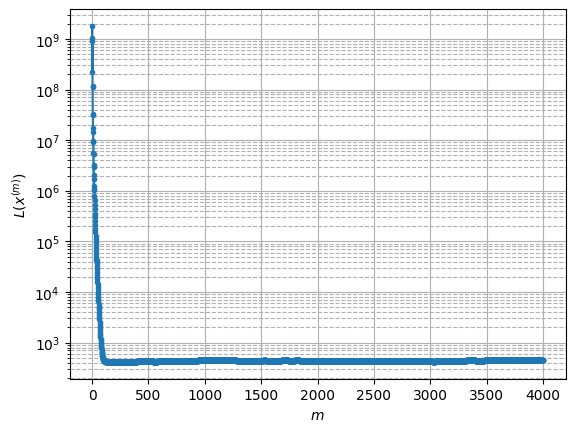

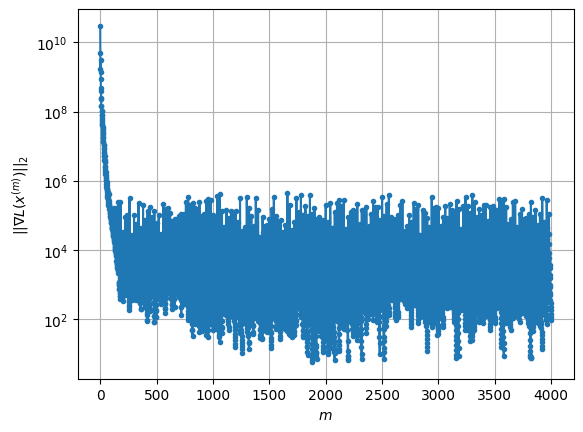

Windows:  68%|██████▊   | 200/296 [2:07:14<54:25, 34.01s/it]

Before applying the algorithm
Cost function: 461.7400424107097
Gradient norm: 99160.9227494486
Global relative error: 1.9017579119441084
Position relative errors: 0.03583148704237449 m, 0.22524472830135361 m, 0.26722840338544196 m, 1.869023131172302 m

Iteration 1
Cost function: 461.2579510083753 (-0.10%)
Gradient norm: 22497.678741664826 (-77.31%)
Global relative error: 1.9528889555634876 (2.69%)
Position relative errors: 0.041945265108559636 m, 0.500440223293399 m, 0.2375556532871576 m, 1.872201369541872 m

Iteration 2
Cost function: 461.2006041530464 (-0.01%)
Gradient norm: 13918.705120732655 (-38.13%)
Global relative error: 1.726168503224086 (-11.61%)
Position relative errors: 0.041962903820865614 m, 0.4618670209495812 m, 0.2495018634765196 m, 1.6438733607211162 m

Iteration 3
Cost function: 461.17596652472787 (-0.01%)
Gradient norm: 10197.597707409079 (-26.73%)
Global relative error: 1.784817558642288 (3.40%)
Position relative errors: 0.04197738534220245 m, 0.5970402747085232 m, 0

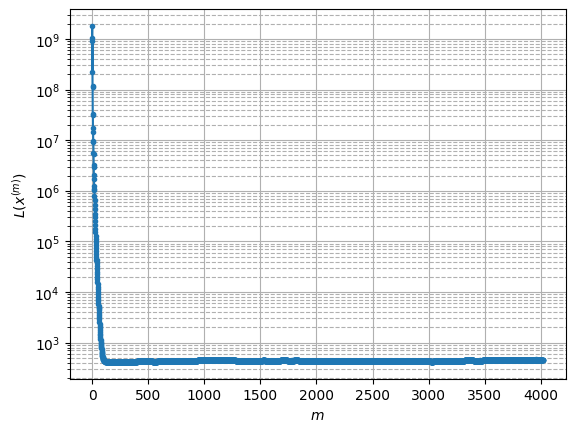

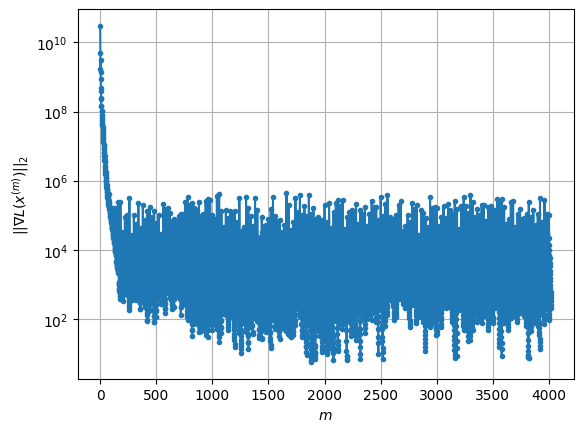

Windows:  68%|██████▊   | 201/296 [2:07:48<53:54, 34.04s/it]

Before applying the algorithm
Cost function: 459.83188958723196
Gradient norm: 113133.1087379057
Global relative error: 1.7033988154660478
Position relative errors: 0.04245617497214655 m, 0.6989777753603265 m, 0.2829698737995453 m, 1.5268001765201107 m

Iteration 1
Cost function: 459.55834240360883 (-0.06%)
Gradient norm: 14419.261648117592 (-87.25%)
Global relative error: 1.4956722459915135 (-12.19%)
Position relative errors: 0.045339635961930164 m, 0.5181197027011638 m, 0.4313243590417671 m, 1.3343486280846952 m

Iteration 2
Cost function: 459.512499820433 (-0.01%)
Gradient norm: 8810.13451100911 (-38.90%)
Global relative error: 1.6189297305203387 (8.24%)
Position relative errors: 0.0455101936663988 m, 0.6257286180869819 m, 0.41927880623385466 m, 1.4323150796629245 m

Iteration 3
Cost function: 459.4979106627319 (-0.00%)
Gradient norm: 4774.398730222412 (-45.81%)
Global relative error: 1.5205857056671244 (-6.07%)
Position relative errors: 0.04553072706366428 m, 0.5603680820676324 m, 

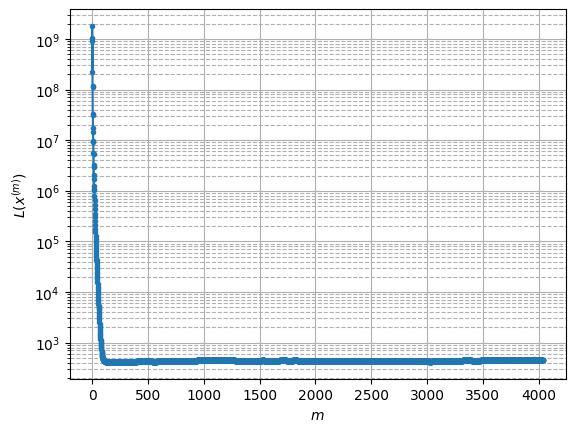

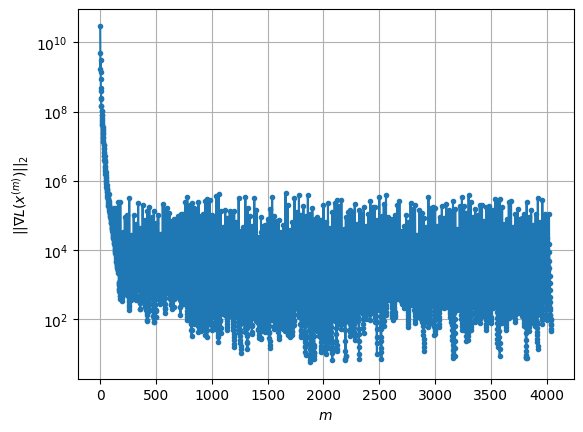

Windows:  68%|██████▊   | 202/296 [2:08:22<53:20, 34.05s/it]

Before applying the algorithm
Cost function: 458.63295639806745
Gradient norm: 61637.021886563336
Global relative error: 1.5941077309356337
Position relative errors: 0.04617986063602439 m, 0.5355522248513782 m, 0.4330441590625583 m, 1.4369058789284999 m

Iteration 1
Cost function: 458.4985312028823 (-0.03%)
Gradient norm: 21834.866365615457 (-64.58%)
Global relative error: 1.719585314578888 (7.87%)
Position relative errors: 0.04385936661629293 m, 0.6598330396552721 m, 0.40500213645325817 m, 1.5348089031195575 m

Iteration 2
Cost function: 458.4544988082089 (-0.01%)
Gradient norm: 15527.744641367099 (-28.89%)
Global relative error: 1.6337793804051415 (-4.99%)
Position relative errors: 0.04379537305106133 m, 0.6053314524607888 m, 0.3999590927934754 m, 1.4631877023555733 m

Iteration 3
Cost function: 458.4338023901549 (-0.00%)
Gradient norm: 10449.74923071994 (-32.70%)
Global relative error: 1.6943054041837362 (3.70%)
Position relative errors: 0.04377280997874984 m, 0.6413468186622052 m, 

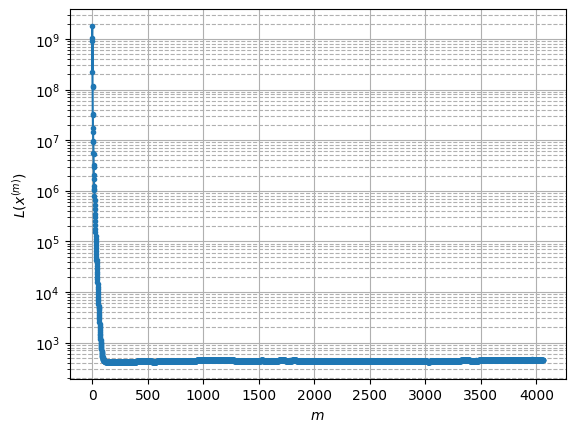

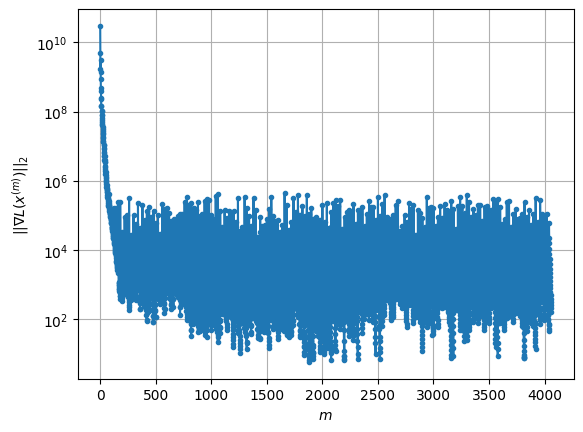

Windows:  69%|██████▊   | 203/296 [2:08:56<52:53, 34.12s/it]

Before applying the algorithm
Cost function: 463.92638146832076
Gradient norm: 65055.535882233795
Global relative error: 1.7651274394468397
Position relative errors: 0.044084117676426136 m, 0.5043076394172263 m, 0.37922952676805505 m, 1.6479031336998768 m

Iteration 1
Cost function: 463.3833587014617 (-0.12%)
Gradient norm: 44441.083513938975 (-31.69%)
Global relative error: 1.399483311075049 (-20.71%)
Position relative errors: 0.043675328463069284 m, 0.41245648843351274 m, 0.27528448235393826 m, 1.3079525106603749 m

Iteration 2
Cost function: 463.2790707153109 (-0.02%)
Gradient norm: 24437.395477668535 (-45.01%)
Global relative error: 1.6807644976410994 (20.10%)
Position relative errors: 0.0435558879257308 m, 0.4601346825942507 m, 0.28340741210154824 m, 1.5909192723080632 m

Iteration 3
Cost function: 463.23715093604915 (-0.01%)
Gradient norm: 15984.507023549637 (-34.59%)
Global relative error: 1.5676394143807355 (-6.73%)
Position relative errors: 0.04338228571014182 m, 0.42411623404

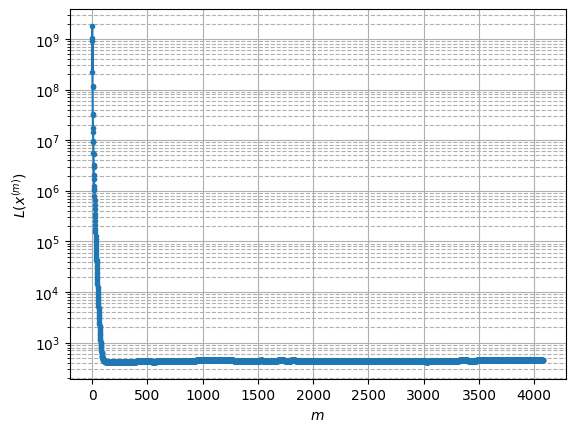

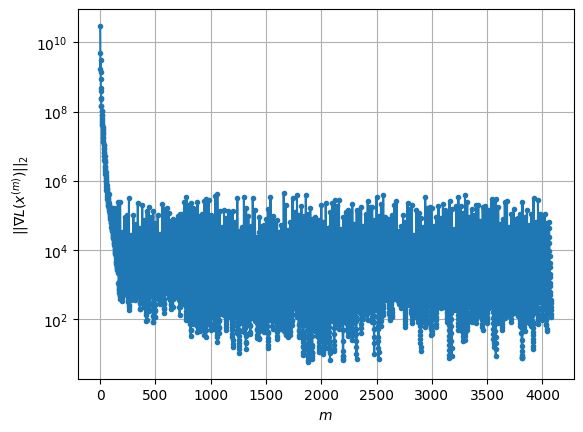

Windows:  69%|██████▉   | 204/296 [2:09:31<52:21, 34.14s/it]

Before applying the algorithm
Cost function: 463.61609520092264
Gradient norm: 85489.36673438233
Global relative error: 1.799002924073938
Position relative errors: 0.04331195202620309 m, 0.4393721206130469 m, 0.2467388922434903 m, 1.7264425707417155 m

Iteration 1
Cost function: 462.98746636985805 (-0.14%)
Gradient norm: 36606.71416507378 (-57.18%)
Global relative error: 2.1145479017094524 (17.54%)
Position relative errors: 0.04850812161814474 m, 0.28821782924732803 m, 0.3007324079253044 m, 2.0725455387096017 m

Iteration 2
Cost function: 462.91995577292835 (-0.01%)
Gradient norm: 19661.92480099853 (-46.29%)
Global relative error: 1.9934409463914826 (-5.73%)
Position relative errors: 0.04809769573323098 m, 0.3356452882834423 m, 0.3001880572759471 m, 1.9413185452522985 m

Iteration 3
Cost function: 462.90156957789094 (-0.00%)
Gradient norm: 11084.564710568153 (-43.62%)
Global relative error: 2.0741592344027775 (4.05%)
Position relative errors: 0.047995919420144154 m, 0.3426867013156717 

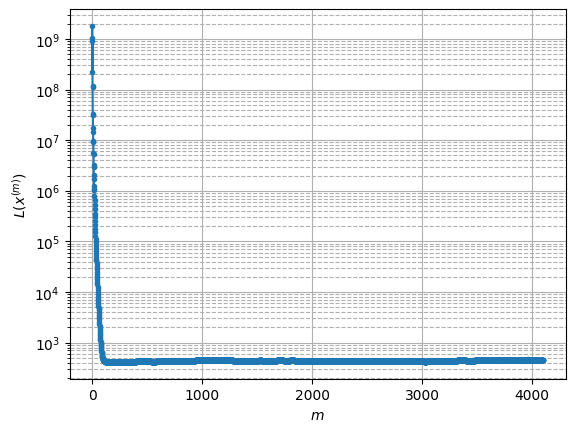

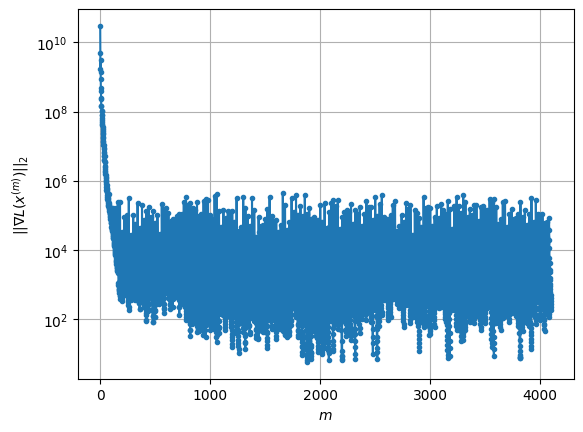

Windows:  69%|██████▉   | 205/296 [2:10:05<51:40, 34.07s/it]

Before applying the algorithm
Cost function: 464.4168898540418
Gradient norm: 327526.49115569907
Global relative error: 2.0627500178172293
Position relative errors: 0.047441869246856054 m, 0.34363294220636764 m, 0.3384984236401815 m, 2.004998162612656 m

Iteration 1
Cost function: 464.0718938763389 (-0.07%)
Gradient norm: 9004.455825787429 (-97.25%)
Global relative error: 2.1052388793940615 (2.06%)
Position relative errors: 0.05009379099798863 m, 0.34991063865212274 m, 0.3141109701541287 m, 2.051441997616947 m

Iteration 2
Cost function: 464.05537883414735 (-0.00%)
Gradient norm: 4547.463827273375 (-49.50%)
Global relative error: 2.0925071721898214 (-0.60%)
Position relative errors: 0.0502924296853567 m, 0.3174533661299217 m, 0.3034202655446058 m, 2.0452903651574488 m

Iteration 3
Cost function: 464.04882399357405 (-0.00%)
Gradient norm: 2928.582288295482 (-35.60%)
Global relative error: 2.122589524656116 (1.44%)
Position relative errors: 0.050421237140624534 m, 0.31159944515858945 m, 

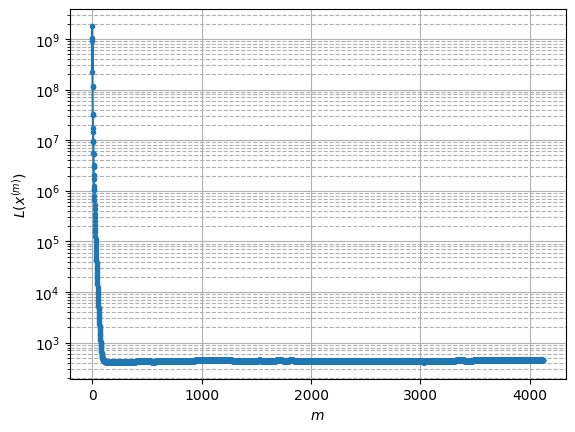

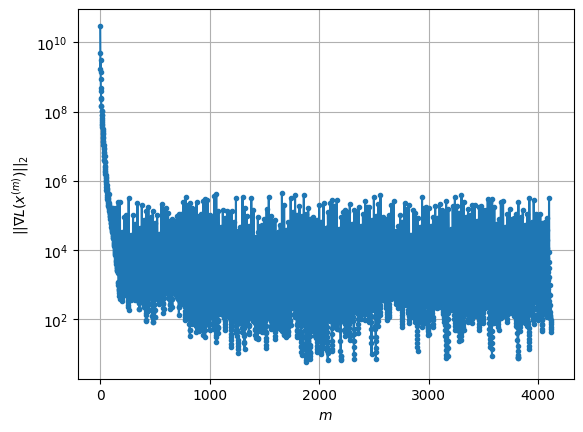

Windows:  70%|██████▉   | 206/296 [2:10:38<50:53, 33.93s/it]

Before applying the algorithm
Cost function: 464.414049103989
Gradient norm: 54888.00128133475
Global relative error: 2.205459020971612
Position relative errors: 0.04978399457058147 m, 0.28887269227015405 m, 0.2780724479783142 m, 2.168131932029914 m

Iteration 1
Cost function: 463.87980251309307 (-0.12%)
Gradient norm: 17732.102039647438 (-67.69%)
Global relative error: 2.3077548655718227 (4.64%)
Position relative errors: 0.06647280301901393 m, 0.29573185690599263 m, 0.2747246813324015 m, 2.271206299491851 m

Iteration 2
Cost function: 463.85101092317626 (-0.01%)
Gradient norm: 9610.729930200108 (-45.80%)
Global relative error: 2.3070702715549554 (-0.03%)
Position relative errors: 0.06633907545253366 m, 0.3269490796032875 m, 0.28073592721326684 m, 2.2654931079059684 m

Iteration 3
Cost function: 463.8446538760688 (-0.00%)
Gradient norm: 4485.44774960719 (-53.33%)
Global relative error: 2.337701078109888 (1.33%)
Position relative errors: 0.06631194385196781 m, 0.3157848740434941 m, 0.27

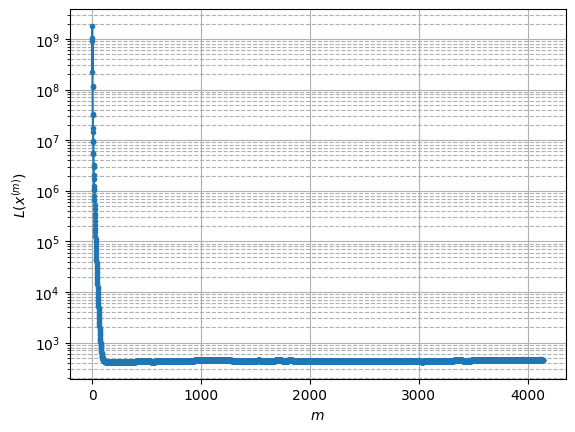

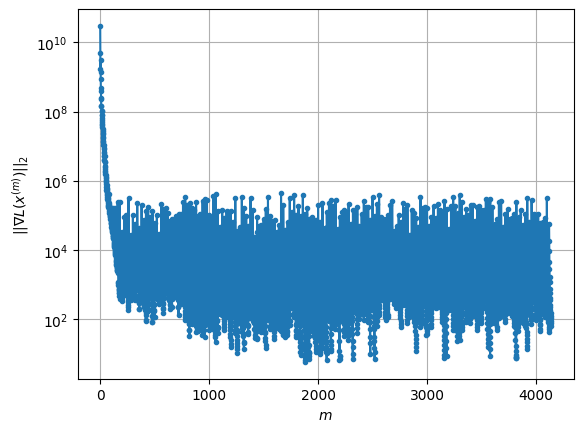

Windows:  70%|██████▉   | 207/296 [2:11:12<50:11, 33.83s/it]

Before applying the algorithm
Cost function: 475.54674328625845
Gradient norm: 423460.6997801412
Global relative error: 2.4188527329732685
Position relative errors: 0.06473901040134859 m, 0.3486870182587932 m, 0.2717623508987284 m, 2.3772284023704136 m

Iteration 1
Cost function: 474.6231481958759 (-0.19%)
Gradient norm: 49856.61245624608 (-88.23%)
Global relative error: 1.8071602219058842 (-25.29%)
Position relative errors: 0.06098980201136734 m, 0.418915814879411 m, 0.2190817048919461 m, 1.743163187158597 m

Iteration 2
Cost function: 474.44299423594674 (-0.04%)
Gradient norm: 36015.97366451049 (-27.76%)
Global relative error: 1.8733639091380125 (3.66%)
Position relative errors: 0.0616027735793418 m, 0.20693403597315863 m, 0.21501692912577716 m, 1.8484156555917952 m

Iteration 3
Cost function: 474.37588286170626 (-0.01%)
Gradient norm: 19393.055593073124 (-46.15%)
Global relative error: 1.6004258266760345 (-14.57%)
Position relative errors: 0.0618095311278842 m, 0.1792883673578435 m,

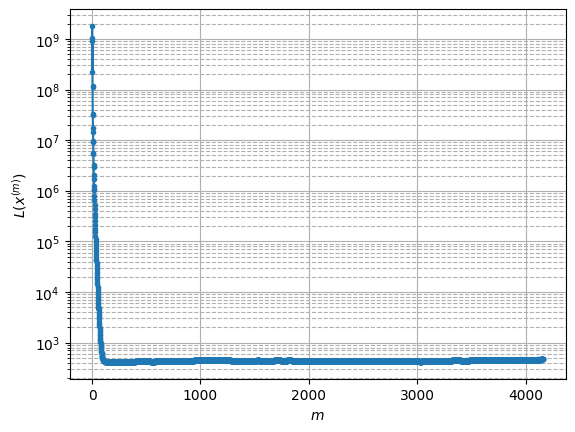

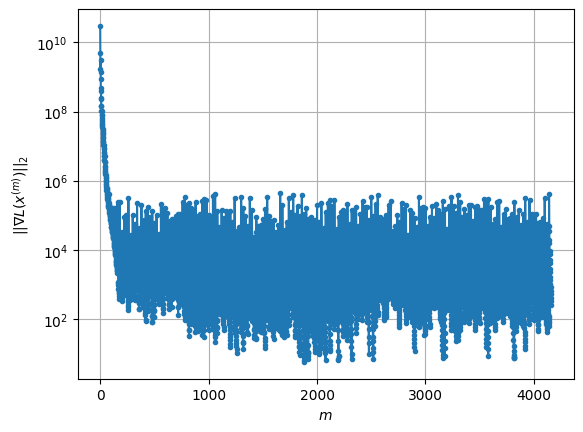

Windows:  70%|███████   | 208/296 [2:11:46<49:48, 33.96s/it]

Before applying the algorithm
Cost function: 477.4615261602221
Gradient norm: 241176.4933446184
Global relative error: 1.5266020239990454
Position relative errors: 0.06100818069666872 m, 0.23455983960814744 m, 0.2315250738295654 m, 1.4893511820438812 m

Iteration 1
Cost function: 477.20818826664197 (-0.05%)
Gradient norm: 15399.041942430607 (-93.62%)
Global relative error: 1.392147708427612 (-8.81%)
Position relative errors: 0.054644187409400545 m, 0.15770707249192956 m, 0.3234851979514733 m, 1.3437157045713832 m

Iteration 2
Cost function: 477.16751105298465 (-0.01%)
Gradient norm: 11818.207484372802 (-23.25%)
Global relative error: 1.443087921640538 (3.66%)
Position relative errors: 0.05447824492067782 m, 0.30181058100678926 m, 0.33714840209400876 m, 1.369223482300861 m

Iteration 3
Cost function: 477.149160973796 (-0.00%)
Gradient norm: 8134.549245241336 (-31.17%)
Global relative error: 1.3582893310713144 (-5.88%)
Position relative errors: 0.05436183673711978 m, 0.2996656384143973 m

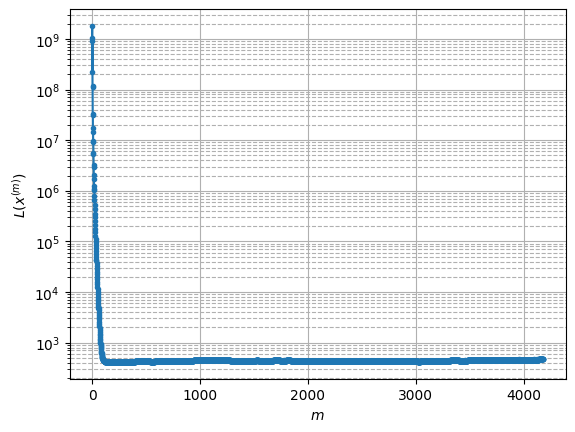

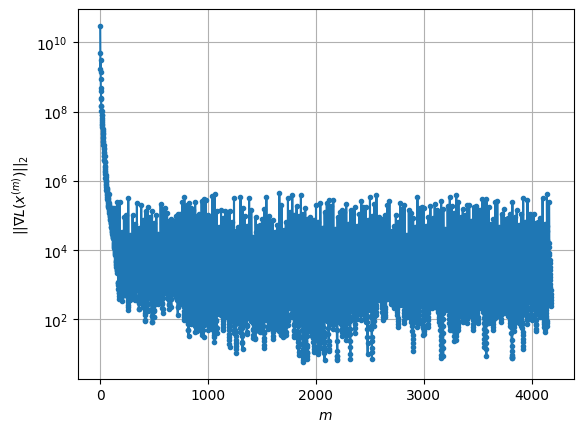

Windows:  71%|███████   | 209/296 [2:12:20<49:15, 33.97s/it]

Before applying the algorithm
Cost function: 478.910076563195
Gradient norm: 184494.64779890486
Global relative error: 1.339713942628772
Position relative errors: 0.05304180073475313 m, 0.4169915079118286 m, 0.3425703387543964 m, 1.2250634356652823 m

Iteration 1
Cost function: 478.5769647742029 (-0.07%)
Gradient norm: 18612.45380125418 (-89.91%)
Global relative error: 1.5042276482649304 (12.28%)
Position relative errors: 0.06310403849713955 m, 0.7052246739768336 m, 0.29888967927731575 m, 1.293073374082143 m

Iteration 2
Cost function: 478.54804338858963 (-0.01%)
Gradient norm: 9116.369355229504 (-51.02%)
Global relative error: 1.3491846675121202 (-10.31%)
Position relative errors: 0.06303008058434766 m, 0.6652995147138903 m, 0.30475806617862505 m, 1.1317342182787822 m

Iteration 3
Cost function: 478.5402085581891 (-0.00%)
Gradient norm: 5320.367100807243 (-41.64%)
Global relative error: 1.4261839594330816 (5.71%)
Position relative errors: 0.06298920243797182 m, 0.7520477104434121 m, 0

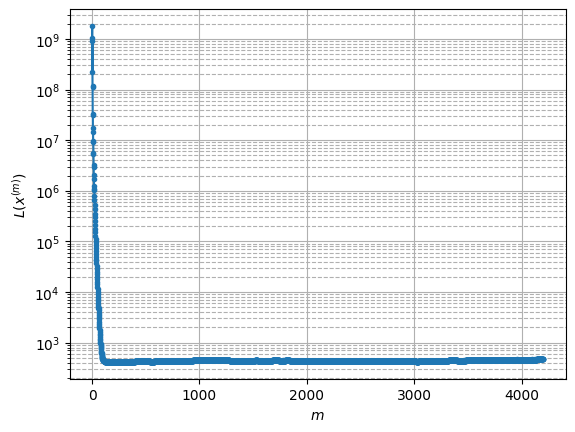

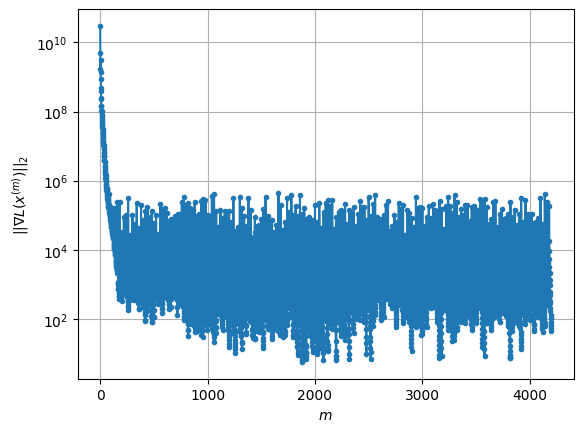

Windows:  71%|███████   | 210/296 [2:12:53<48:24, 33.78s/it]

Before applying the algorithm
Cost function: 480.015025655433
Gradient norm: 146867.70234150364
Global relative error: 1.386974547340215
Position relative errors: 0.06127652433762311 m, 0.7134718618656288 m, 0.3065321574843785 m, 1.1475784626720653 m

Iteration 1
Cost function: 479.56378429644224 (-0.09%)
Gradient norm: 21458.01887649704 (-85.39%)
Global relative error: 1.292393527566626 (-6.82%)
Position relative errors: 0.06250181675881053 m, 0.6385802602508767 m, 0.3171947194498889 m, 1.0760926567484888 m

Iteration 2
Cost function: 479.4587861854379 (-0.02%)
Gradient norm: 16575.638872741853 (-22.75%)
Global relative error: 1.3325246489617784 (3.11%)
Position relative errors: 0.06308546218142516 m, 0.6927025593471076 m, 0.2917481269052864 m, 1.0984930355227063 m

Iteration 3
Cost function: 479.4231665162623 (-0.01%)
Gradient norm: 9836.661150672466 (-40.66%)
Global relative error: 1.2667107316837896 (-4.94%)
Position relative errors: 0.06338212467118716 m, 0.6451304576829677 m, 0.2

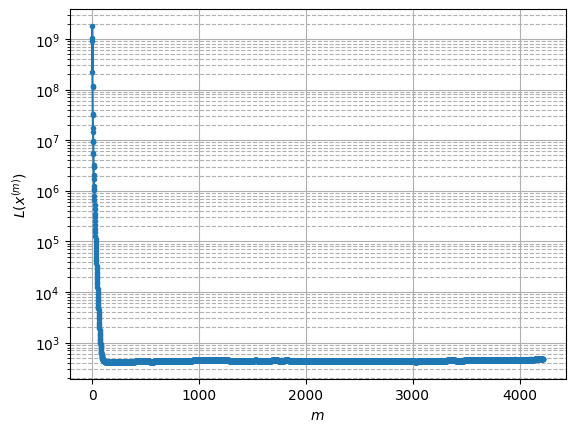

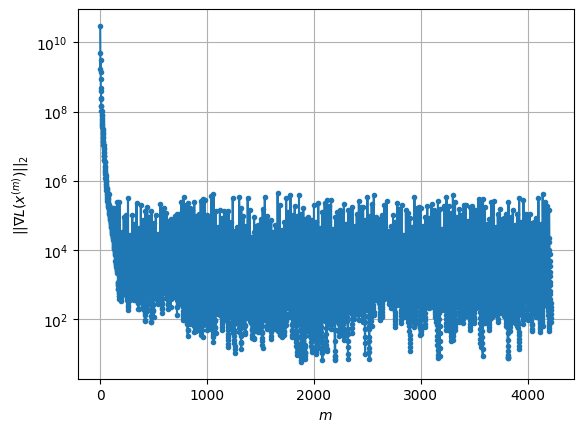

Windows:  71%|███████▏  | 211/296 [2:13:27<47:53, 33.80s/it]

Before applying the algorithm
Cost function: 481.7792055176086
Gradient norm: 68978.9748880548
Global relative error: 1.2476561736890528
Position relative errors: 0.062306516989793975 m, 0.6406829971753024 m, 0.25542536574148444 m, 1.0378081680301996 m

Iteration 1
Cost function: 481.40465187753585 (-0.08%)
Gradient norm: 23319.44466278922 (-66.19%)
Global relative error: 1.2312002434787788 (-1.32%)
Position relative errors: 0.0658811253515396 m, 0.533878568429708 m, 0.2819511019273047 m, 1.0709762096922013 m

Iteration 2
Cost function: 481.2869208741191 (-0.02%)
Gradient norm: 13011.75977364387 (-44.20%)
Global relative error: 1.2552098030963892 (1.95%)
Position relative errors: 0.06647863345158352 m, 0.49479318547378875 m, 0.27648007036279404 m, 1.117975819363255 m

Iteration 3
Cost function: 481.23794922355825 (-0.01%)
Gradient norm: 8605.11879098586 (-33.87%)
Global relative error: 1.2618389909322256 (0.53%)
Position relative errors: 0.06686831410976232 m, 0.4810131325209695 m, 0.2

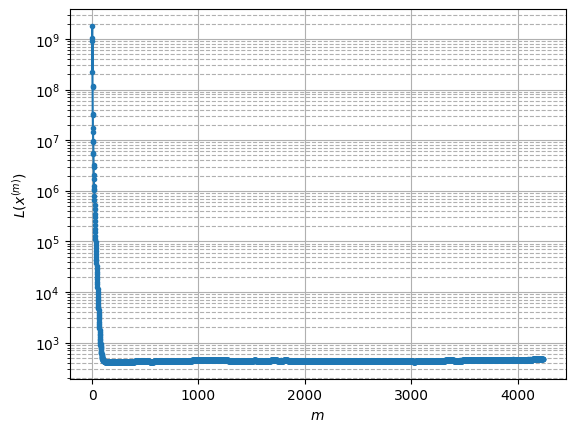

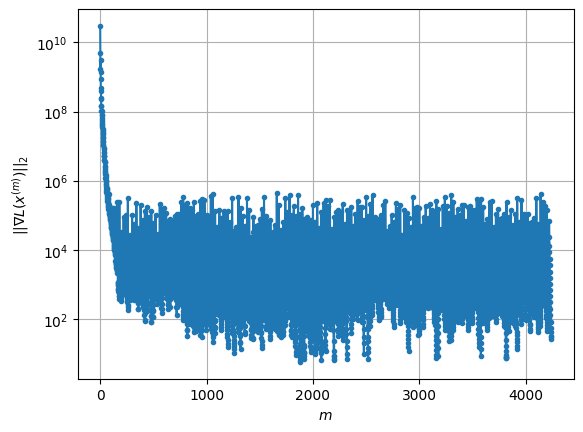

Windows:  72%|███████▏  | 212/296 [2:14:01<47:11, 33.71s/it]

Before applying the algorithm
Cost function: 485.43999674724154
Gradient norm: 81036.41882157333
Global relative error: 1.2473171037345085
Position relative errors: 0.06571245224806778 m, 0.43102537673171776 m, 0.283498100393495 m, 1.1337225438084169 m

Iteration 1
Cost function: 484.9915507321124 (-0.09%)
Gradient norm: 24227.559574635023 (-70.10%)
Global relative error: 1.3017711986357399 (4.37%)
Position relative errors: 0.07214969860928287 m, 0.5096458875072172 m, 0.179825152808167 m, 1.1820854260631948 m

Iteration 2
Cost function: 484.9535613582418 (-0.01%)
Gradient norm: 9324.754551074358 (-61.51%)
Global relative error: 1.2273725836903566 (-5.72%)
Position relative errors: 0.07201158284806042 m, 0.5008483330298532 m, 0.16944376204345313 m, 1.1053039529729984 m

Iteration 3
Cost function: 484.9451944906698 (-0.00%)
Gradient norm: 3833.63069911215 (-58.89%)
Global relative error: 1.262500849410246 (2.86%)
Position relative errors: 0.07192385750398059 m, 0.524706958372987 m, 0.175

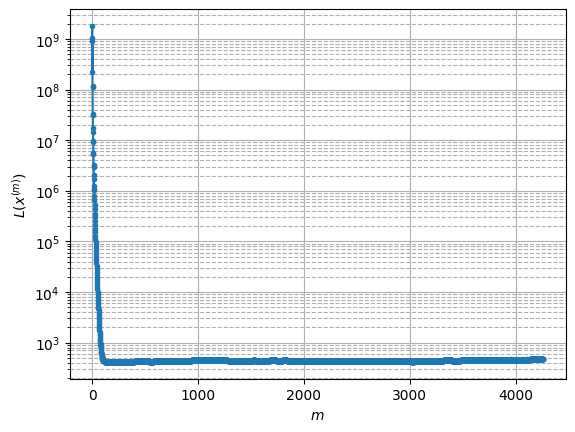

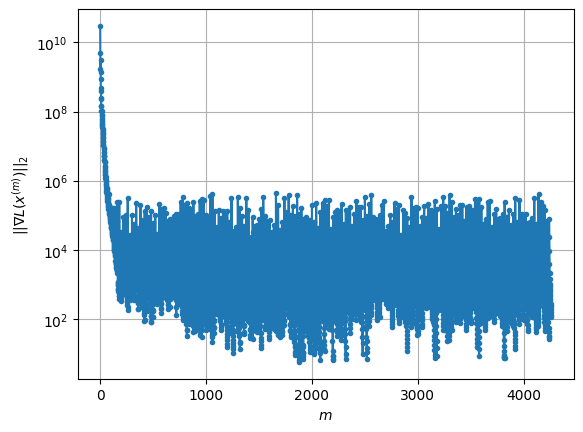

Windows:  72%|███████▏  | 213/296 [2:14:35<46:52, 33.88s/it]

Before applying the algorithm
Cost function: 483.3557119615552
Gradient norm: 110045.10011845865
Global relative error: 1.2047482467539574
Position relative errors: 0.06930026617337103 m, 0.5318404285811602 m, 0.17116677781913575 m, 1.0651116320660492 m

Iteration 1
Cost function: 483.035013465883 (-0.07%)
Gradient norm: 19213.55321910626 (-82.54%)
Global relative error: 1.1795357367382393 (-2.09%)
Position relative errors: 0.0701634934000526 m, 0.564981764610783 m, 0.12797605122350503 m, 1.025084504142659 m

Iteration 2
Cost function: 482.95001507325827 (-0.02%)
Gradient norm: 12043.424757281357 (-37.32%)
Global relative error: 1.2033334040173294 (2.02%)
Position relative errors: 0.07073557052347353 m, 0.5727111948359979 m, 0.12888424159910877 m, 1.0480446014932308 m

Iteration 3
Cost function: 482.9178490711209 (-0.01%)
Gradient norm: 7365.154819342463 (-38.85%)
Global relative error: 1.1945643142127078 (-0.73%)
Position relative errors: 0.07104431021373421 m, 0.5692537836221272 m, 0

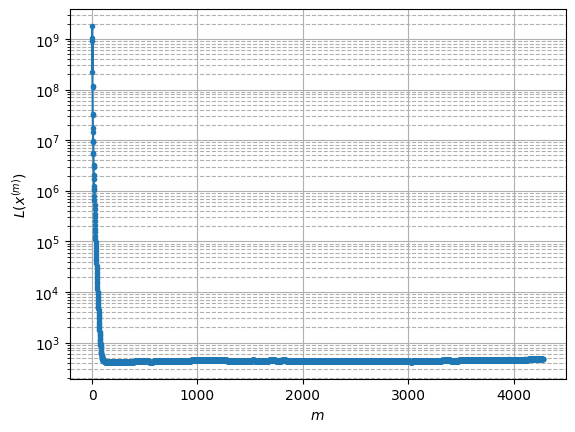

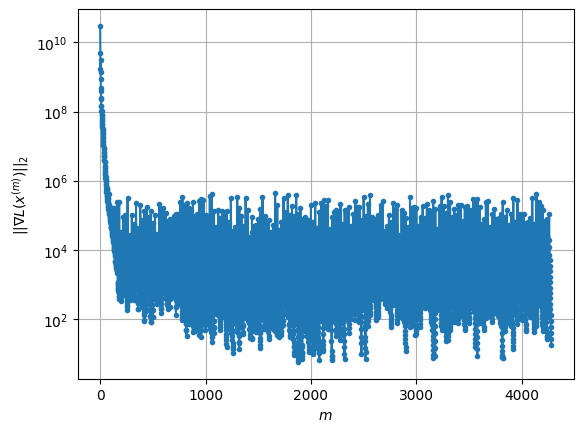

Windows:  72%|███████▏  | 214/296 [2:15:10<46:38, 34.13s/it]

Before applying the algorithm
Cost function: 487.7969533838485
Gradient norm: 55013.416334331916
Global relative error: 1.1433548301686296
Position relative errors: 0.06933816524319383 m, 0.5598566679706911 m, 0.13550187631209448 m, 0.9852162068857353 m

Iteration 1
Cost function: 487.63926320306757 (-0.03%)
Gradient norm: 15646.199409257584 (-71.56%)
Global relative error: 1.4297952986664426 (25.05%)
Position relative errors: 0.06574450576175118 m, 0.73540094797153 m, 0.15302344735006465 m, 1.2148086760550079 m

Iteration 2
Cost function: 487.6184690719378 (-0.00%)
Gradient norm: 13448.349299755842 (-14.05%)
Global relative error: 1.2973140725850365 (-9.27%)
Position relative errors: 0.0656378413257803 m, 0.6152910051681784 m, 0.147872923325143 m, 1.130603740647969 m

Iteration 3
Cost function: 487.6099525348052 (-0.00%)
Gradient norm: 7920.922708541688 (-41.10%)
Global relative error: 1.3796575222730687 (6.35%)
Position relative errors: 0.06562440334480439 m, 0.6515466174362813 m, 0.

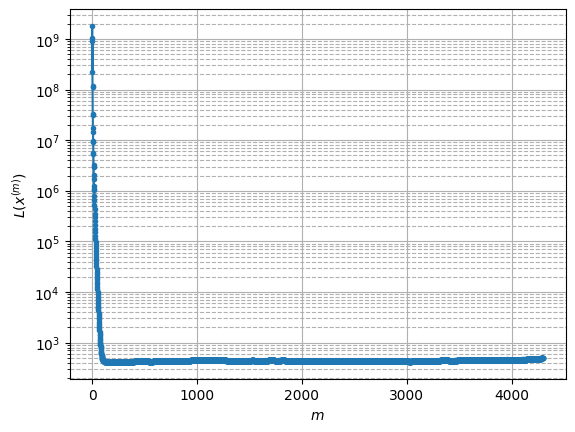

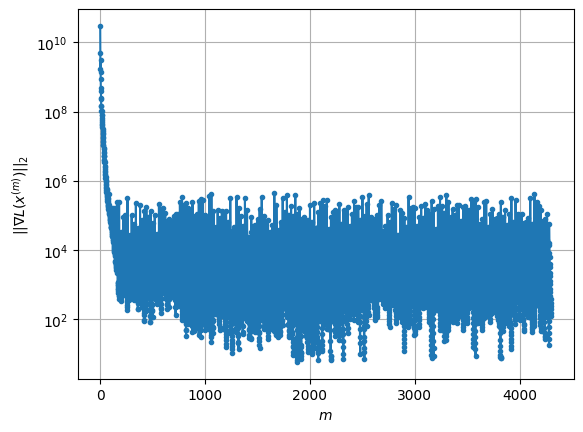

Windows:  73%|███████▎  | 215/296 [2:15:44<46:11, 34.21s/it]

Before applying the algorithm
Cost function: 484.75668381483536
Gradient norm: 278314.51659296534
Global relative error: 1.319079052317694
Position relative errors: 0.06339679645175088 m, 0.5211440220179115 m, 0.15412268099814858 m, 1.2002516591812278 m

Iteration 1
Cost function: 484.3883146618141 (-0.08%)
Gradient norm: 14159.917828629199 (-94.91%)
Global relative error: 1.2680073779369396 (-3.87%)
Position relative errors: 0.06023527659622795 m, 0.6367669451719317 m, 0.22231768455436754 m, 1.072061538418903 m

Iteration 2
Cost function: 484.32376468763954 (-0.01%)
Gradient norm: 4621.0091097615095 (-67.37%)
Global relative error: 1.2796157959650405 (0.92%)
Position relative errors: 0.0606948031426112 m, 0.6529219585993199 m, 0.2105715846886255 m, 1.0784636140941175 m

Iteration 3
Cost function: 484.2983643816541 (-0.01%)
Gradient norm: 2235.181436825398 (-51.63%)
Global relative error: 1.2692246679514159 (-0.81%)
Position relative errors: 0.06103620479743497 m, 0.6588717940932171 m,

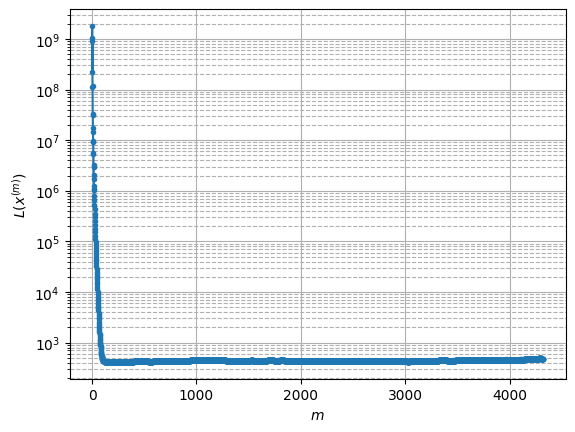

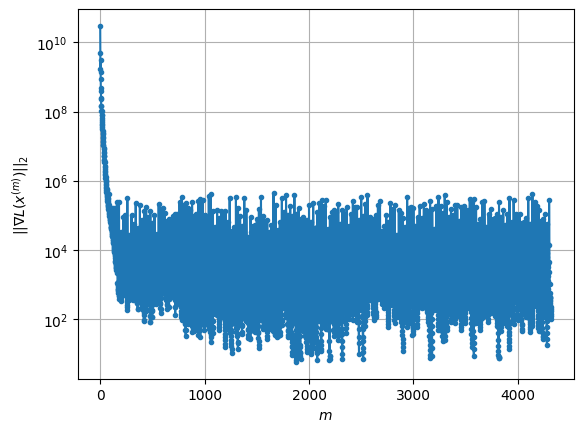

Windows:  73%|███████▎  | 216/296 [2:16:18<45:34, 34.18s/it]

Before applying the algorithm
Cost function: 487.01810143484215
Gradient norm: 93634.61719606671
Global relative error: 1.2265499671750277
Position relative errors: 0.059840674455773485 m, 0.6053003275312412 m, 0.22171276396239883 m, 1.0417759849850978 m

Iteration 1
Cost function: 486.44195150499235 (-0.12%)
Gradient norm: 33791.62336416285 (-63.91%)
Global relative error: 1.344561384868257 (9.62%)
Position relative errors: 0.056507481051564994 m, 0.6517166235511974 m, 0.14115769720456628 m, 1.1661858164171144 m

Iteration 2
Cost function: 486.35200894437406 (-0.02%)
Gradient norm: 14550.648841062603 (-56.94%)
Global relative error: 1.3268916568953049 (-1.31%)
Position relative errors: 0.056573991413533295 m, 0.7083995303721448 m, 0.15242665198178498 m, 1.1101235688458055 m

Iteration 3
Cost function: 486.32748983696064 (-0.01%)
Gradient norm: 9914.01060027245 (-31.87%)
Global relative error: 1.2969684205398588 (-2.26%)
Position relative errors: 0.056570470527324376 m, 0.6789002591946

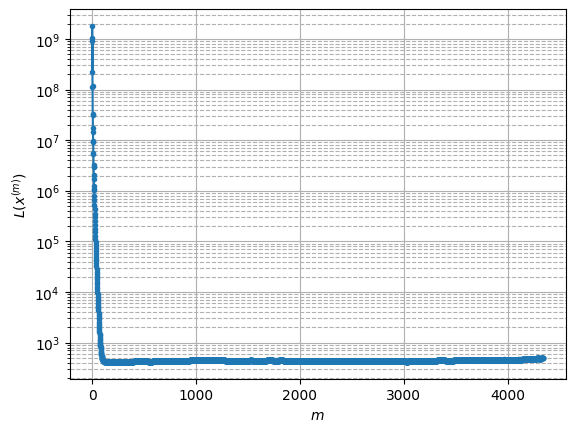

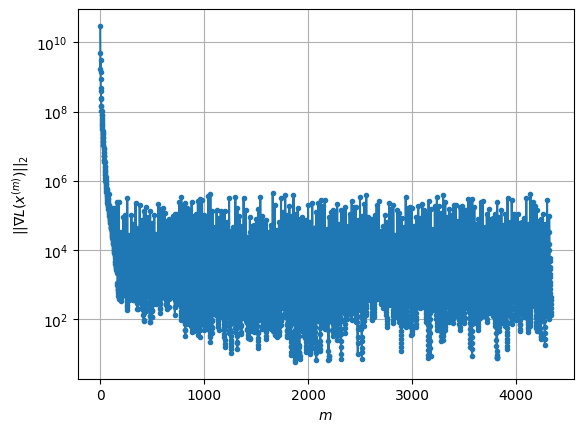

Windows:  73%|███████▎  | 217/296 [2:16:53<45:14, 34.36s/it]

Before applying the algorithm
Cost function: 485.78807859135117
Gradient norm: 47938.276651841705
Global relative error: 1.23494039371073
Position relative errors: 0.05463700374893244 m, 0.6405150165728131 m, 0.1800383880933335 m, 1.038949143271087 m

Iteration 1
Cost function: 485.66049604578194 (-0.03%)
Gradient norm: 3729.778294704246 (-92.22%)
Global relative error: 1.4163659012848744 (14.69%)
Position relative errors: 0.056156665446777596 m, 0.6723516210273063 m, 0.20083257979987326 m, 1.2290417078630145 m

Iteration 2
Cost function: 485.6507983254934 (-0.00%)
Gradient norm: 2860.13513282189 (-23.32%)
Global relative error: 1.3768135998459545 (-2.79%)
Position relative errors: 0.056197624739443314 m, 0.6416768932047333 m, 0.1976316615240041 m, 1.2006854471638027 m

Iteration 3
Cost function: 485.64901958501855 (-0.00%)
Gradient norm: 2087.8113131922605 (-27.00%)
Global relative error: 1.4037686575404278 (1.96%)
Position relative errors: 0.056223187687018644 m, 0.6455953176344462 m

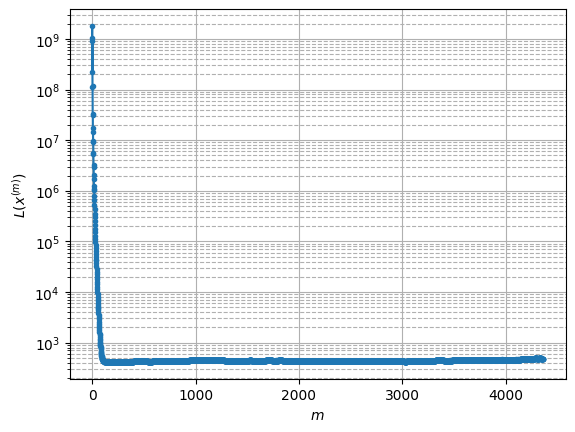

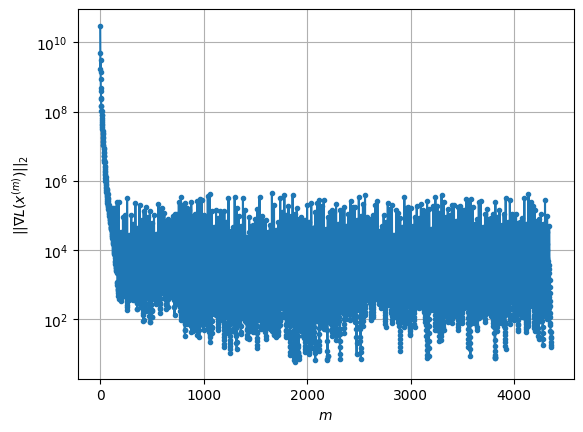

Windows:  74%|███████▎  | 218/296 [2:17:27<44:35, 34.30s/it]

Before applying the algorithm
Cost function: 488.7304131133248
Gradient norm: 203538.05677892617
Global relative error: 1.2906979069489037
Position relative errors: 0.05454578468272282 m, 0.6172654772841186 m, 0.2190674923453222 m, 1.1108166376628592 m

Iteration 1
Cost function: 488.5943819486929 (-0.03%)
Gradient norm: 5892.742370450612 (-97.10%)
Global relative error: 1.2360607425317565 (-4.23%)
Position relative errors: 0.053998214170002966 m, 0.5603689704075822 m, 0.2528894441844822 m, 1.0709620305987904 m

Iteration 2
Cost function: 488.5824242162506 (-0.00%)
Gradient norm: 4408.163695724787 (-25.19%)
Global relative error: 1.2796584878941832 (3.53%)
Position relative errors: 0.05386323570036231 m, 0.5486698629749458 m, 0.2608389703125341 m, 1.1249641415382337 m

Iteration 3
Cost function: 488.5787032886795 (-0.00%)
Gradient norm: 4123.68413763273 (-6.45%)
Global relative error: 1.2759549236224266 (-0.29%)
Position relative errors: 0.0538133527578013 m, 0.5303949207599212 m, 0.27

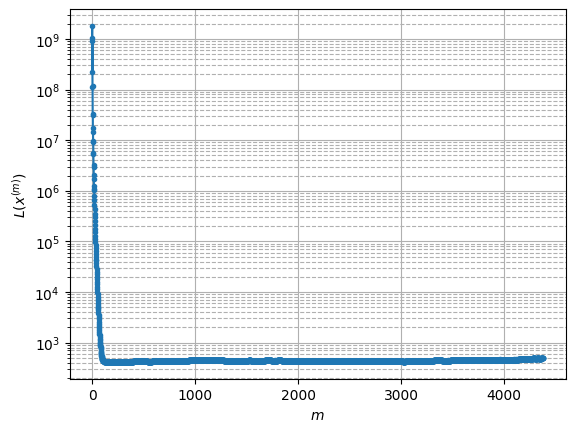

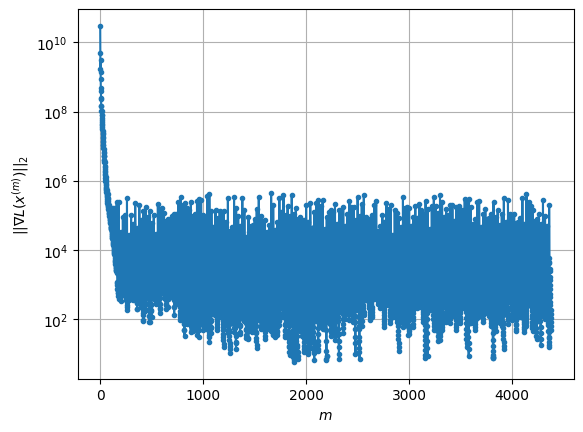

Windows:  74%|███████▍  | 219/296 [2:18:01<44:02, 34.32s/it]

Before applying the algorithm
Cost function: 490.55712229005394
Gradient norm: 74863.85840073705
Global relative error: 1.1884644063002596
Position relative errors: 0.05165425923478191 m, 0.4989497084372249 m, 0.3038512841726448 m, 1.033681698546821 m

Iteration 1
Cost function: 490.48475591034327 (-0.01%)
Gradient norm: 7207.226034241221 (-90.37%)
Global relative error: 1.2789058588660005 (7.61%)
Position relative errors: 0.054158669312852056 m, 0.4506944820862627 m, 0.36852562658027205 m, 1.1374201534462223 m

Iteration 2
Cost function: 490.47454755680474 (-0.00%)
Gradient norm: 2856.983580217602 (-60.36%)
Global relative error: 1.3079090596068148 (2.27%)
Position relative errors: 0.054042443967191225 m, 0.4413619626280551 m, 0.3769264362455721 m, 1.1708227632129797 m

Iteration 3
Cost function: 490.47105485981814 (-0.00%)
Gradient norm: 2559.33259532983 (-10.42%)
Global relative error: 1.3138863878635498 (0.46%)
Position relative errors: 0.05395661168216534 m, 0.4204196727688955 m, 

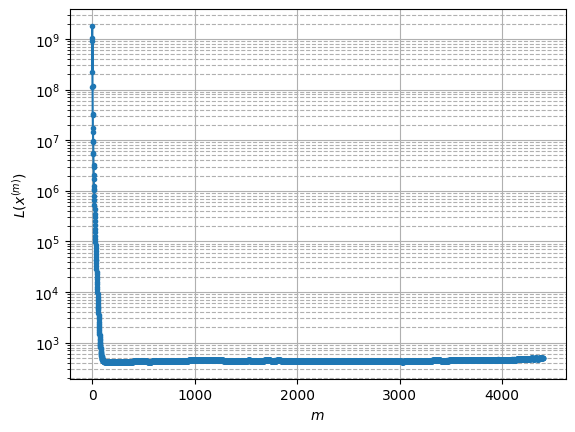

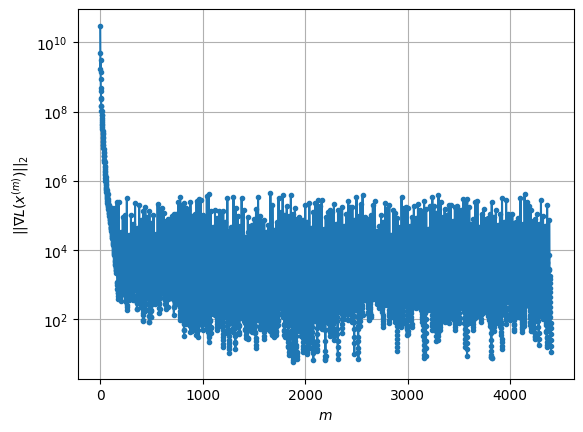

Windows:  74%|███████▍  | 220/296 [2:18:36<43:36, 34.43s/it]

Before applying the algorithm
Cost function: 483.58808722014845
Gradient norm: 95102.05715408882
Global relative error: 1.2061535903457825
Position relative errors: 0.051709147667097145 m, 0.404098643604734 m, 0.42330885290889964 m, 1.0533945569436665 m

Iteration 1
Cost function: 482.9363245953472 (-0.13%)
Gradient norm: 11677.005626876651 (-87.72%)
Global relative error: 1.0204879420056403 (-15.39%)
Position relative errors: 0.04706207954093975 m, 0.38995882419786654 m, 0.2531352182233132 m, 0.9072093894949194 m

Iteration 2
Cost function: 482.74545981703193 (-0.04%)
Gradient norm: 5053.462525338852 (-56.72%)
Global relative error: 0.9986245058896398 (-2.14%)
Position relative errors: 0.0465194344015172 m, 0.44258422142035997 m, 0.2958451383745532 m, 0.8436090835572958 m

Iteration 3
Cost function: 482.66726280530753 (-0.02%)
Gradient norm: 1781.8731447999403 (-64.74%)
Global relative error: 0.983128332334855 (-1.55%)
Position relative errors: 0.04601151211183855 m, 0.492352716139505

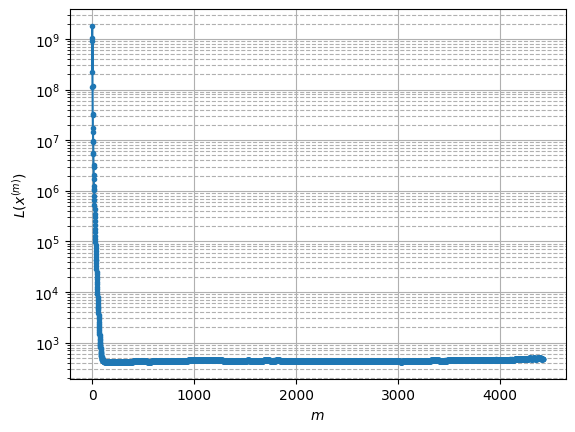

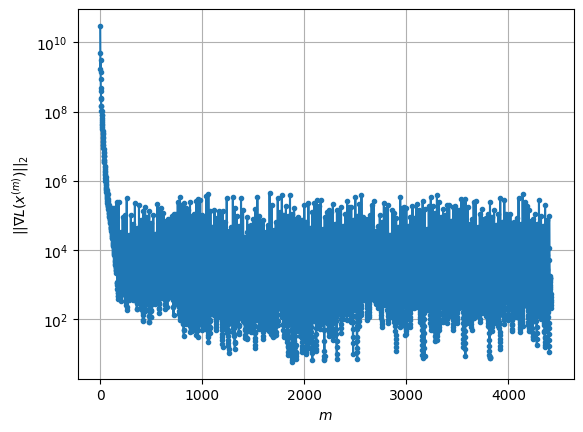

Windows:  75%|███████▍  | 221/296 [2:19:10<42:52, 34.30s/it]

Before applying the algorithm
Cost function: 481.8648232762573
Gradient norm: 34748.83586348578
Global relative error: 0.9150859385355496
Position relative errors: 0.043245129890874465 m, 0.616515299753213 m, 0.41140247074062314 m, 0.5349426909450213 m

Iteration 1
Cost function: 481.547919547445 (-0.07%)
Gradient norm: 13018.412808240057 (-62.54%)
Global relative error: 1.3355126516886806 (45.94%)
Position relative errors: 0.03291108996819492 m, 0.8201837306416738 m, 0.3879087573488381 m, 0.9794539722051416 m

Iteration 2
Cost function: 481.5221337159346 (-0.01%)
Gradient norm: 9014.793515112657 (-30.75%)
Global relative error: 1.1727227814332932 (-12.19%)
Position relative errors: 0.032992745314303365 m, 0.725527603461194 m, 0.3588431568068526 m, 0.847953757880605 m

Iteration 3
Cost function: 481.5142170030996 (-0.00%)
Gradient norm: 5961.738667555048 (-33.87%)
Global relative error: 1.2411497768042152 (5.83%)
Position relative errors: 0.033126305020451614 m, 0.7631231042033022 m, 0

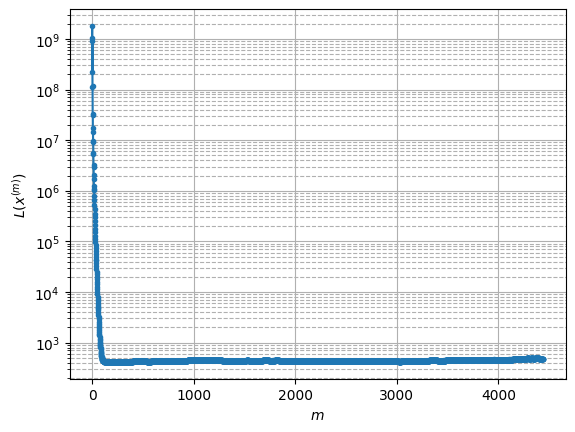

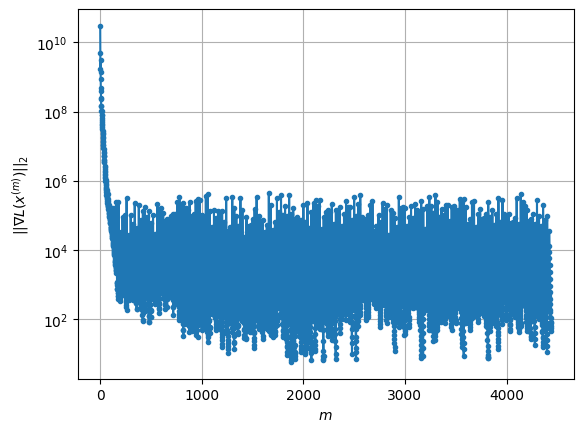

Windows:  75%|███████▌  | 222/296 [2:19:45<42:22, 34.35s/it]

Before applying the algorithm
Cost function: 481.12126603938276
Gradient norm: 178251.92719398972
Global relative error: 1.090633159592332
Position relative errors: 0.032291313313283825 m, 0.6945259033655041 m, 0.34089034022951004 m, 0.7680228085463312 m

Iteration 1
Cost function: 480.8718993637665 (-0.05%)
Gradient norm: 11550.321654577972 (-93.52%)
Global relative error: 1.1859560396471336 (8.74%)
Position relative errors: 0.03597803377983053 m, 0.5982594525743329 m, 0.48090420418658986 m, 0.9033308488775917 m

Iteration 2
Cost function: 480.8123369335148 (-0.01%)
Gradient norm: 2402.3685384179616 (-79.20%)
Global relative error: 1.2387688675280732 (4.45%)
Position relative errors: 0.03625333597778098 m, 0.5331883165452311 m, 0.4772806939536988 m, 1.0105145457335551 m

Iteration 3
Cost function: 480.7873328518267 (-0.01%)
Gradient norm: 1577.3643741400422 (-34.34%)
Global relative error: 1.251892238103478 (1.06%)
Position relative errors: 0.03645388419957423 m, 0.4780299476896474 m,

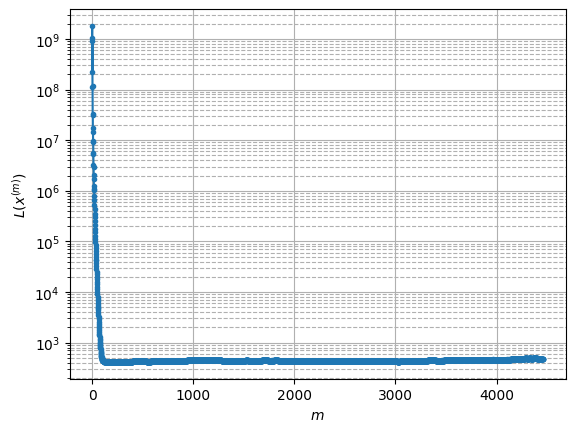

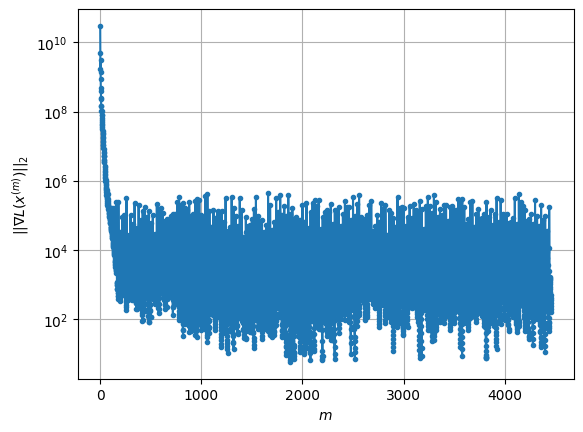

Windows:  75%|███████▌  | 223/296 [2:20:19<41:38, 34.23s/it]

Before applying the algorithm
Cost function: 479.3838273575782
Gradient norm: 102600.5884465004
Global relative error: 1.1569327077075744
Position relative errors: 0.035765336924587145 m, 0.3661631430268296 m, 0.4623433911157294 m, 0.9946699593502395 m

Iteration 1
Cost function: 478.99168139239293 (-0.08%)
Gradient norm: 19524.400321055393 (-80.97%)
Global relative error: 1.47261971054698 (27.29%)
Position relative errors: 0.03923251713323543 m, 0.4455065924011553 m, 0.3561985788600481 m, 1.3570950964707338 m

Iteration 12
Cost function: 477.7380799622979 (-0.00%)
Gradient norm: 1020.7267528001589 (-20.44%)
Global relative error: 1.0348447715741318 (0.57%)
Position relative errors: 0.01906855027702671 m, 0.7982614680349742 m, 0.3947382247082223 m, 0.5267790174538036 m

Iteration 13
Cost function: 477.73795211960123 (-0.00%)
Gradient norm: 844.5803991976336 (-17.26%)
Global relative error: 1.0400665784643515 (0.50%)
Position relative errors: 0.01906831693607995 m, 0.8027675937504871 m,

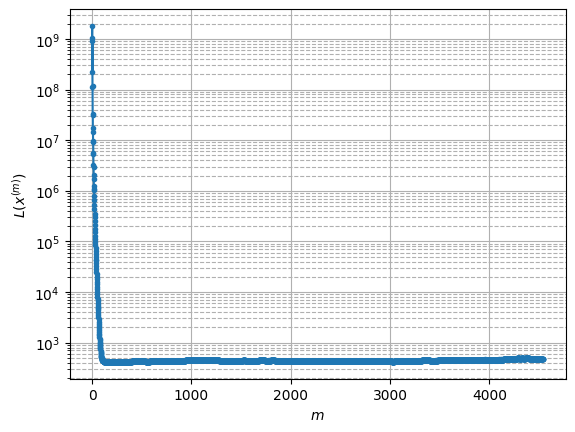

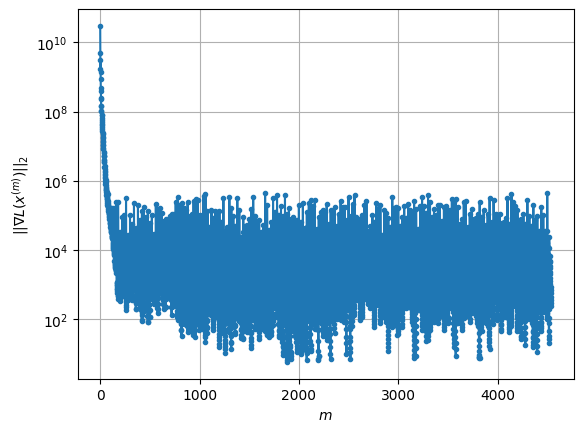

Windows:  77%|███████▋  | 227/296 [2:22:36<39:27, 34.31s/it]

Before applying the algorithm
Cost function: 476.4584735806746
Gradient norm: 163856.3975074026
Global relative error: 1.0342927672997906
Position relative errors: 0.018818708004214237 m, 0.7441420302961818 m, 0.37807972577258603 m, 0.6105009411497082 m

Iteration 1
Cost function: 476.1621199746795 (-0.06%)
Gradient norm: 16111.010794668222 (-90.17%)
Global relative error: 1.0380531522041825 (0.36%)
Position relative errors: 0.021097794767576453 m, 0.48573737174725184 m, 0.4735900797430377 m, 0.7854148500467883 m

Iteration 2
Cost function: 476.1052725814901 (-0.01%)
Gradient norm: 7582.512800641492 (-52.94%)
Global relative error: 1.0543863341533766 (1.57%)
Position relative errors: 0.0210647386132599 m, 0.6182200940560538 m, 0.4814267697501986 m, 0.705205144479 m

Iteration 3
Cost function: 476.0812688491472 (-0.01%)
Gradient norm: 5209.500917465683 (-31.30%)
Global relative error: 1.0738940244355386 (1.85%)
Position relative errors: 0.021038539449073714 m, 0.5479299668778769 m, 0.50

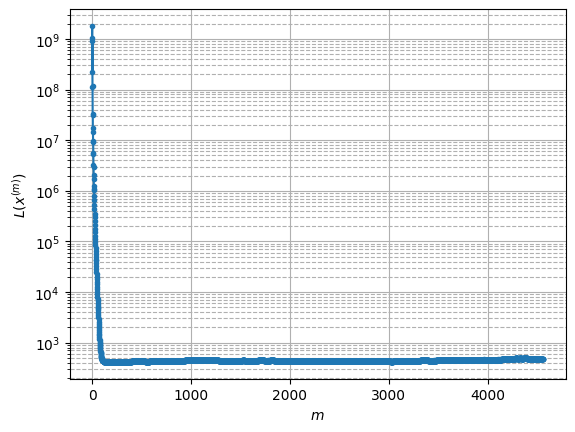

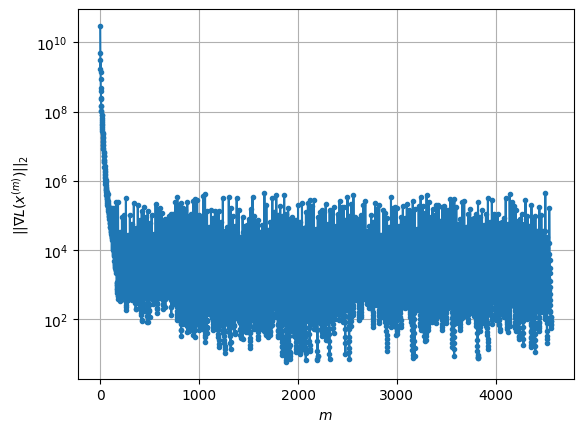

Windows:  77%|███████▋  | 228/296 [2:23:10<38:44, 34.18s/it]

Before applying the algorithm
Cost function: 471.09283458873915
Gradient norm: 70209.40527576322
Global relative error: 1.064111977670344
Position relative errors: 0.020617068644437374 m, 0.49925960508931705 m, 0.499797188839368 m, 0.7955166815083367 m

Iteration 1
Cost function: 469.60536281798096 (-0.32%)
Gradient norm: 18232.970399962454 (-74.03%)
Global relative error: 1.6957066657527484 (59.35%)
Position relative errors: 0.03598044936798992 m, 0.24839361813461072 m, 0.6041865460506085 m, 1.5644105747886237 m

Iteration 2
Cost function: 469.4966938766541 (-0.02%)
Gradient norm: 3507.575508911902 (-80.76%)
Global relative error: 1.7232140407287104 (1.62%)
Position relative errors: 0.035982013399420136 m, 0.5002792891603358 m, 0.6264883935628776 m, 1.5249258721860723 m

Iteration 3
Cost function: 469.4734628043347 (-0.00%)
Gradient norm: 3405.6947222123717 (-2.90%)
Global relative error: 1.8666341069764032 (8.32%)
Position relative errors: 0.03606888760935498 m, 0.5150224669878994 m,

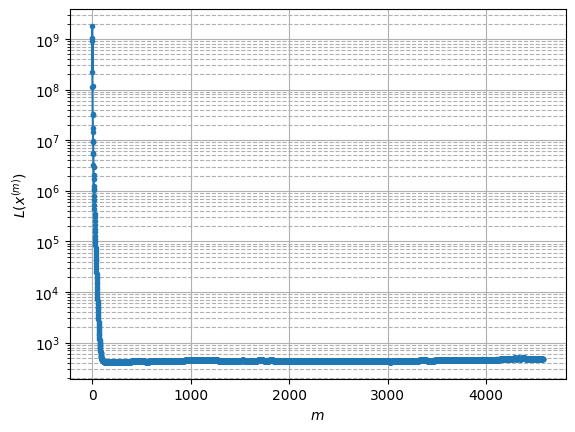

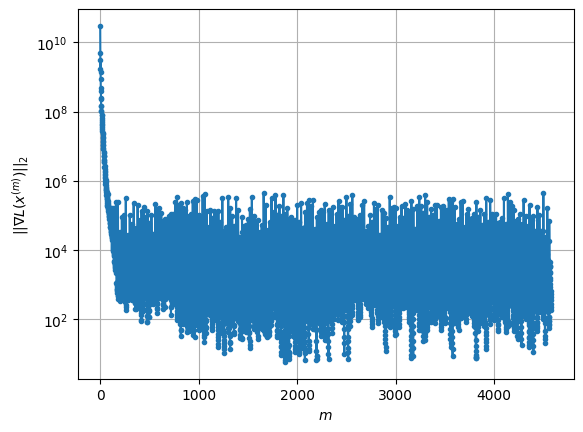

Windows:  77%|███████▋  | 229/296 [2:23:44<38:17, 34.30s/it]

Before applying the algorithm
Cost function: 467.394974287462
Gradient norm: 68038.54347097423
Global relative error: 1.9796396024648009
Position relative errors: 0.035510715695388086 m, 0.5699803023745053 m, 0.5876209502028333 m, 1.8020902773905647 m

Iteration 1
Cost function: 466.92111911723333 (-0.10%)
Gradient norm: 30021.439027206954 (-55.88%)
Global relative error: 2.0882993543219204 (5.49%)
Position relative errors: 0.037582842802110855 m, 0.3565098519708456 m, 0.47559400498827287 m, 2.0015709011070677 m

Iteration 2
Cost function: 466.7853843841378 (-0.03%)
Gradient norm: 16761.764560053183 (-44.17%)
Global relative error: 1.9694022066049481 (-5.69%)
Position relative errors: 0.03711518345580305 m, 0.4230522405376269 m, 0.4593861910623227 m, 1.8673918922722745 m

Iteration 3
Cost function: 466.7280895145907 (-0.01%)
Gradient norm: 11211.283596967309 (-33.11%)
Global relative error: 2.0035785700233903 (1.74%)
Position relative errors: 0.03687277260809626 m, 0.3824794935568648 m

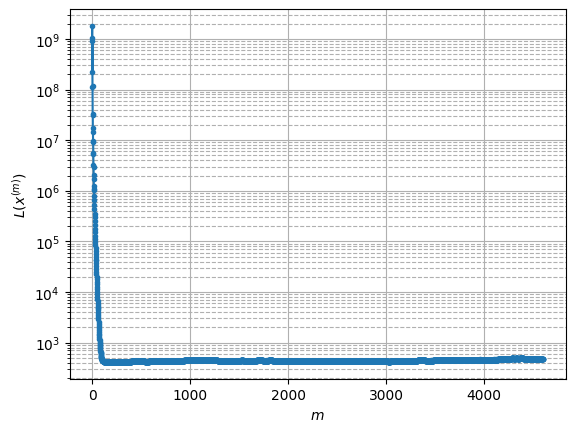

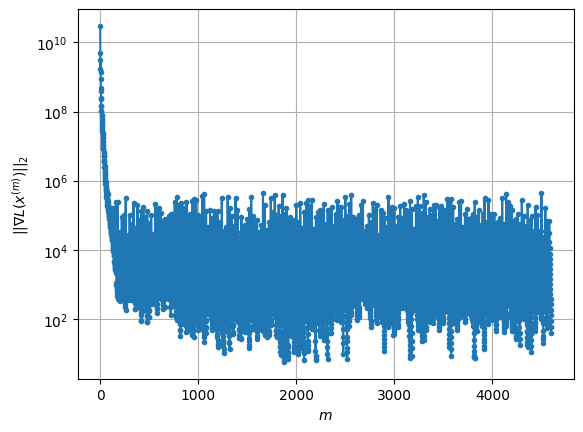

Windows:  78%|███████▊  | 230/296 [2:24:19<37:44, 34.32s/it]

Before applying the algorithm
Cost function: 466.06780233647333
Gradient norm: 71149.55209732124
Global relative error: 2.007640336412871
Position relative errors: 0.035283713054519945 m, 0.34088945234218043 m, 0.31024433025513276 m, 1.9536917877757007 m

Iteration 1
Cost function: 465.79566254424236 (-0.06%)
Gradient norm: 20792.866193625334 (-70.78%)
Global relative error: 1.6286917480088303 (-18.88%)
Position relative errors: 0.03957657721887947 m, 0.33259646612382965 m, 0.33729786399008516 m, 1.557778533081318 m

Iteration 2
Cost function: 465.7409735127266 (-0.01%)
Gradient norm: 8559.032064132674 (-58.84%)
Global relative error: 1.604819293897821 (-1.47%)
Position relative errors: 0.039519668444680224 m, 0.22698791164445897 m, 0.2955254427678654 m, 1.5604546571505482 m

Iteration 3
Cost function: 465.7231557201891 (-0.00%)
Gradient norm: 4457.408337574866 (-47.92%)
Global relative error: 1.5266053798490973 (-4.87%)
Position relative errors: 0.03940846211479166 m, 0.21304349395527

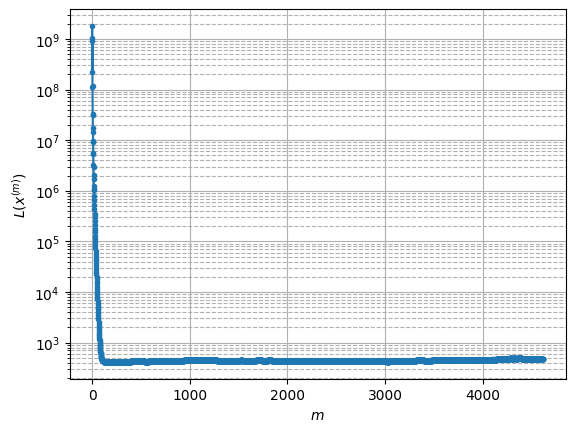

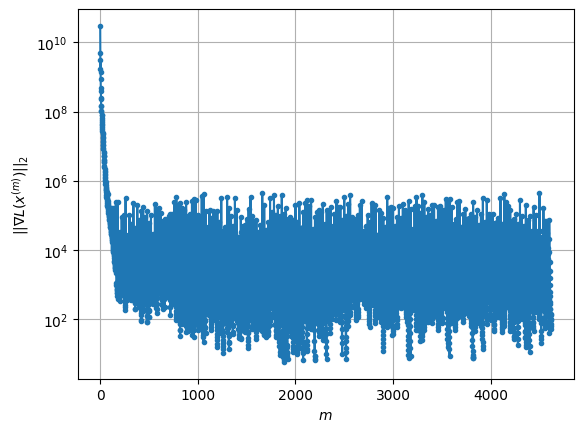

Windows:  78%|███████▊  | 231/296 [2:24:53<37:13, 34.37s/it]

Before applying the algorithm
Cost function: 468.28693353390486
Gradient norm: 301549.33255621017
Global relative error: 1.5008655502458257
Position relative errors: 0.03814729799389701 m, 0.08944414810875789 m, 0.21275667293094336 m, 1.4825219410001544 m

Iteration 1
Cost function: 467.94002950471986 (-0.07%)
Gradient norm: 11286.591881567576 (-96.26%)
Global relative error: 1.8948585004056515 (26.25%)
Position relative errors: 0.04063462206997943 m, 0.1341160496883029 m, 0.17057344303779629 m, 1.8819535268841385 m

Iteration 2
Cost function: 467.9068722472554 (-0.01%)
Gradient norm: 2755.879654815799 (-75.58%)
Global relative error: 1.7603594261140776 (-7.10%)
Position relative errors: 0.04061900597328857 m, 0.060759157884994225 m, 0.2015966529862646 m, 1.74724840869852 m

Iteration 3
Cost function: 467.8982446661584 (-0.00%)
Gradient norm: 1804.128775750957 (-34.54%)
Global relative error: 1.8404698212353174 (4.55%)
Position relative errors: 0.040753888469607015 m, 0.064221354960322

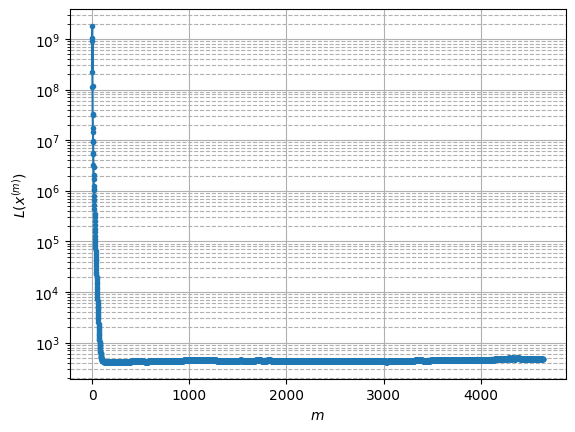

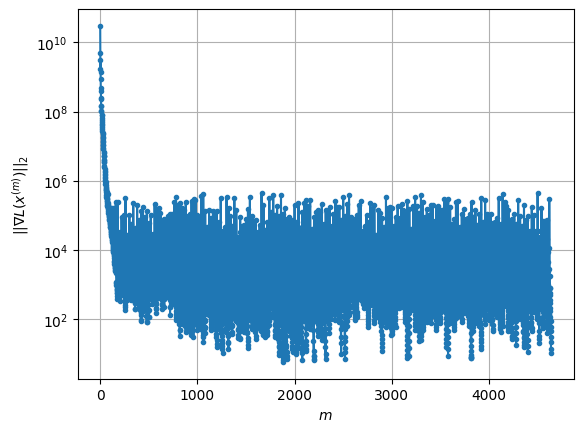

Windows:  78%|███████▊  | 232/296 [2:25:27<36:35, 34.31s/it]

Before applying the algorithm
Cost function: 469.8223257681832
Gradient norm: 160270.17796262898
Global relative error: 1.8823751812404164
Position relative errors: 0.04008174575679515 m, 0.09086961640544709 m, 0.2471367952506483 m, 1.8634351905967275 m

Iteration 1
Cost function: 469.59740282063353 (-0.05%)
Gradient norm: 16443.15951555123 (-89.74%)
Global relative error: 1.6780997413585024 (-10.85%)
Position relative errors: 0.04324906466769497 m, 0.30052392126086264 m, 0.22385342417836238 m, 1.6351510621516006 m

Iteration 2
Cost function: 469.56264274473864 (-0.01%)
Gradient norm: 7653.736476108771 (-53.45%)
Global relative error: 1.8576893345058165 (10.70%)
Position relative errors: 0.04311637285301769 m, 0.18167334176042213 m, 0.21261284744765396 m, 1.8360110372960965 m

Iteration 3
Cost function: 469.5513093389107 (-0.00%)
Gradient norm: 6090.771396134561 (-20.42%)
Global relative error: 1.824129815470769 (-1.81%)
Position relative errors: 0.043040896215314546 m, 0.3261461558823

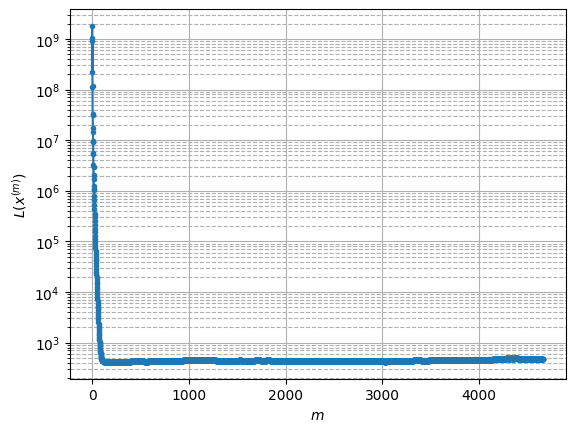

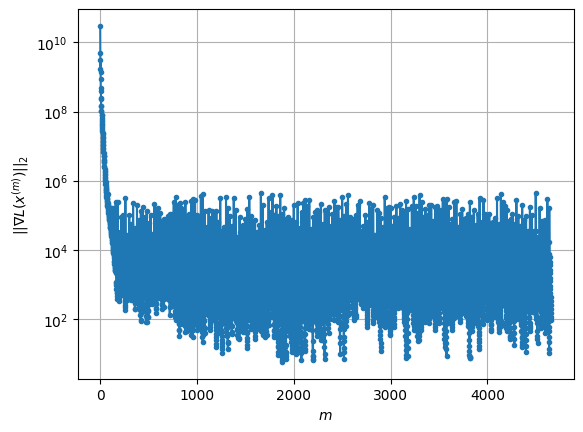

Windows:  79%|███████▊  | 233/296 [2:26:02<36:08, 34.42s/it]

Before applying the algorithm
Cost function: 472.02887862014796
Gradient norm: 78047.41006405784
Global relative error: 1.9979512727335025
Position relative errors: 0.04189770308308472 m, 0.31779064229072407 m, 0.25279349384343497 m, 1.9558000540959026 m

Iteration 1
Cost function: 471.63811485403875 (-0.08%)
Gradient norm: 10302.500326267125 (-86.80%)
Global relative error: 1.5510915282505944 (-22.37%)
Position relative errors: 0.044277564772552784 m, 0.20044281267880615 m, 0.24931243566538458 m, 1.5170980921337156 m

Iteration 2
Cost function: 471.57266087314684 (-0.01%)
Gradient norm: 5711.83730313016 (-44.56%)
Global relative error: 1.5183262423628903 (-2.11%)
Position relative errors: 0.04437598815164913 m, 0.06717860422495874 m, 0.2003680524553539 m, 1.5028908131082008 m

Iteration 3
Cost function: 471.55483433334314 (-0.00%)
Gradient norm: 4092.918543010285 (-28.34%)
Global relative error: 1.4065867660327835 (-7.36%)
Position relative errors: 0.04421528920881639 m, 0.07185722321

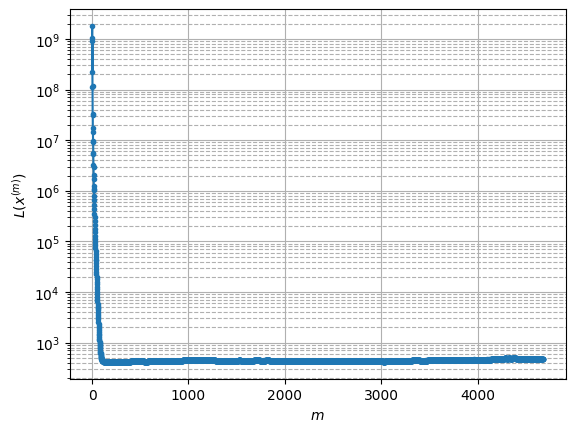

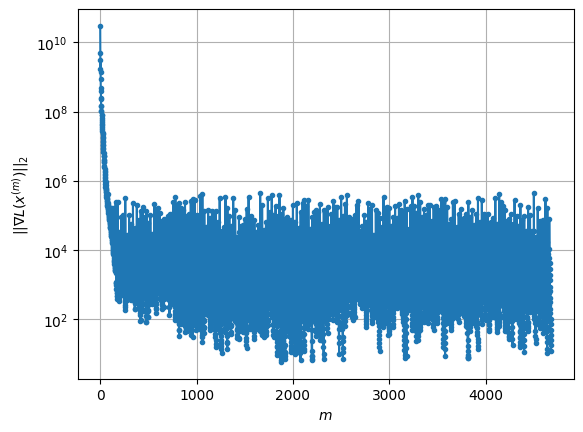

Windows:  79%|███████▉  | 234/296 [2:26:37<35:36, 34.46s/it]

Before applying the algorithm
Cost function: 471.84521490888017
Gradient norm: 411529.9113728691
Global relative error: 1.3406209849744326
Position relative errors: 0.04303145374485837 m, 0.2532049012331987 m, 0.263590526080256 m, 1.2891144120175562 m

Iteration 1
Cost function: 471.46276237712203 (-0.08%)
Gradient norm: 8955.535893953747 (-97.82%)
Global relative error: 1.497389492627975 (11.69%)
Position relative errors: 0.039341845794973226 m, 0.2709975867539872 m, 0.2905543772763975 m, 1.4431772094140223 m

Iteration 2
Cost function: 471.40349615861453 (-0.01%)
Gradient norm: 4188.174287503881 (-53.23%)
Global relative error: 1.4876026131413285 (-0.65%)
Position relative errors: 0.03904060183884263 m, 0.21123196499957883 m, 0.2860699742377679 m, 1.4439450899736233 m

Iteration 3
Cost function: 471.3798439332052 (-0.01%)
Gradient norm: 4165.432528553628 (-0.54%)
Global relative error: 1.5384995891798814 (3.42%)
Position relative errors: 0.03891592463951067 m, 0.2136582854990005 m, 0

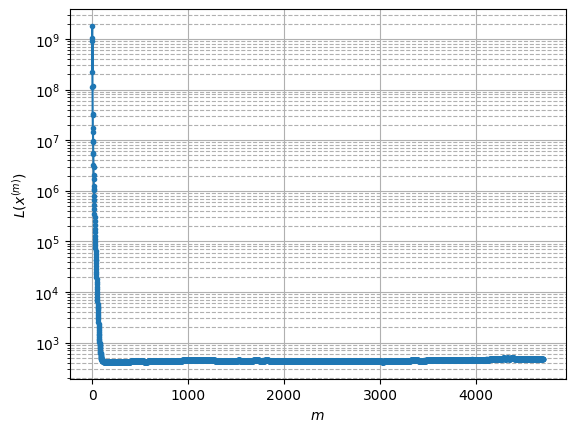

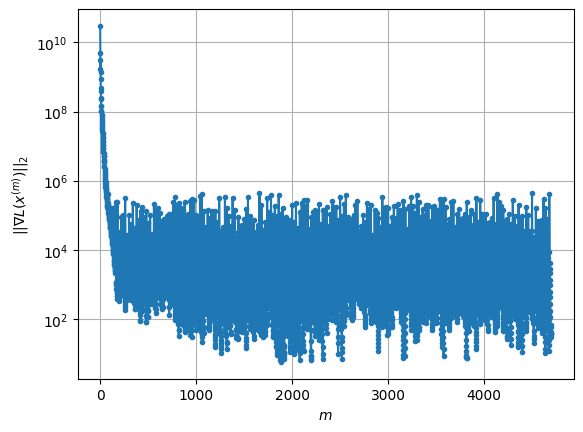

Windows:  79%|███████▉  | 235/296 [2:27:12<35:16, 34.70s/it]

Before applying the algorithm
Cost function: 465.93162657851263
Gradient norm: 63678.102603683496
Global relative error: 1.6888924380110741
Position relative errors: 0.03755139412738978 m, 0.21946184213402775 m, 0.3618980196158214 m, 1.6345668804581108 m

Iteration 1
Cost function: 465.7431132646523 (-0.04%)
Gradient norm: 2069.9014045995837 (-96.75%)
Global relative error: 1.735265804981727 (2.75%)
Position relative errors: 0.03142678546029978 m, 0.20751574926590258 m, 0.527067129482641 m, 1.6399061257657128 m

Iteration 2
Cost function: 465.73828002121746 (-0.00%)
Gradient norm: 864.8363719320537 (-58.22%)
Global relative error: 1.7730210720434367 (2.18%)
Position relative errors: 0.03130394850129086 m, 0.21187717582454818 m, 0.5129770814459544 m, 1.6836214844551152 m

Iteration 3
Cost function: 465.7363216851514 (-0.00%)
Gradient norm: 715.502360508372 (-17.27%)
Global relative error: 1.768051344198194 (-0.28%)
Position relative errors: 0.031282527106799754 m, 0.2268381502302056 m, 

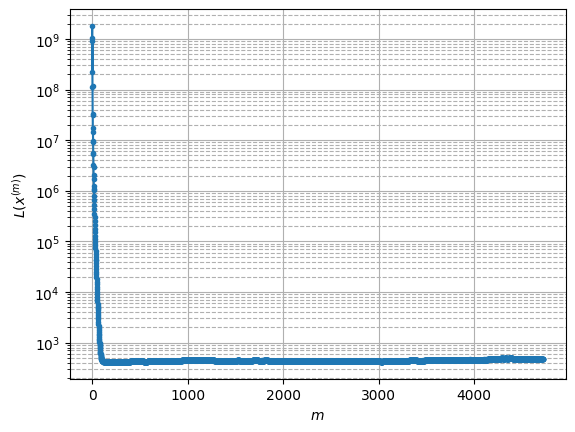

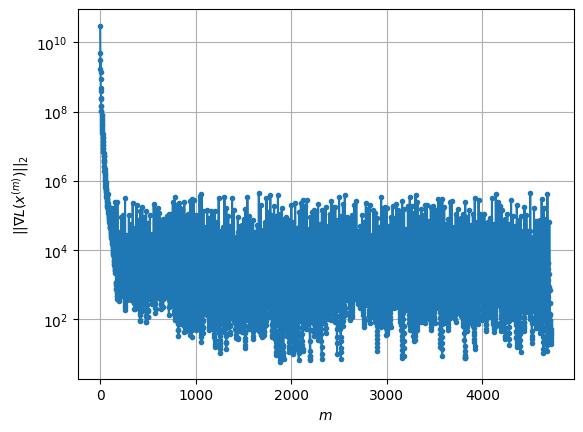

Windows:  80%|███████▉  | 236/296 [2:27:46<34:33, 34.55s/it]

Before applying the algorithm
Cost function: 465.00181571632754
Gradient norm: 170110.12206106883
Global relative error: 1.8567779170060423
Position relative errors: 0.030541946248480497 m, 0.21434260068765756 m, 0.5956665056092643 m, 1.745257922130894 m

Iteration 1
Cost function: 464.2137595927796 (-0.17%)
Gradient norm: 14268.282136882312 (-91.61%)
Global relative error: 2.4358405868079838 (31.19%)
Position relative errors: 0.03412512492436515 m, 0.37654676629988687 m, 1.6336877520128634 m, 1.7667561304945778 m

Iteration 2
Cost function: 464.15636640593226 (-0.01%)
Gradient norm: 3499.353821200345 (-75.47%)
Global relative error: 2.338087370704252 (-4.01%)
Position relative errors: 0.034183108939911395 m, 0.2318141796554611 m, 1.5795219716044722 m, 1.7078795176539665 m

Iteration 3
Cost function: 464.13293957037655 (-0.01%)
Gradient norm: 2006.5517778564085 (-42.66%)
Global relative error: 2.2989851964363694 (-1.67%)
Position relative errors: 0.03434585835038672 m, 0.16849939454988

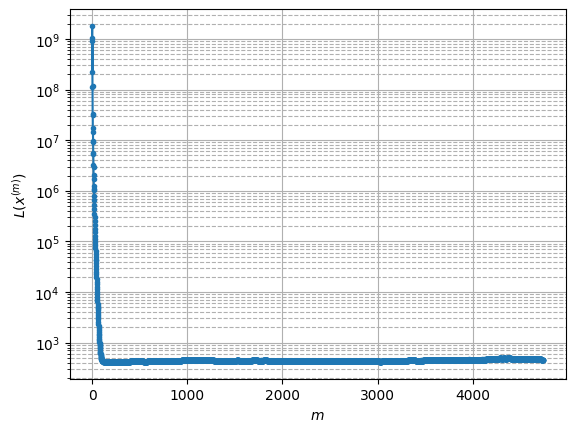

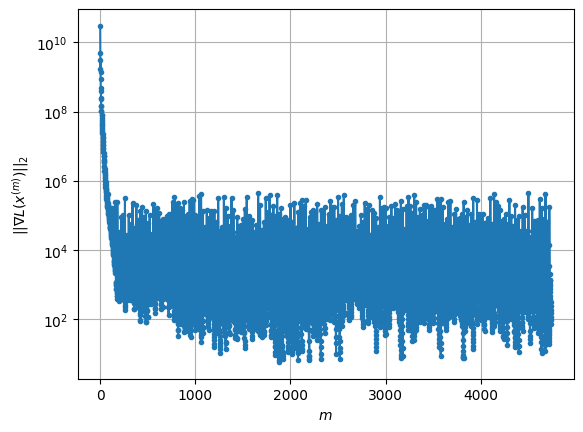

Windows:  80%|████████  | 237/296 [2:28:20<33:53, 34.46s/it]

Before applying the algorithm
Cost function: 459.70014768425966
Gradient norm: 24729.84477937805
Global relative error: 2.255431943163808
Position relative errors: 0.03387682333178794 m, 0.27893058868193804 m, 1.7732025822596242 m, 1.3652006025947554 m

Iteration 1
Cost function: 459.2378363788709 (-0.10%)
Gradient norm: 14863.04236895354 (-39.90%)
Global relative error: 2.361958075755516 (4.72%)
Position relative errors: 0.04483682671988252 m, 0.6803237286735356 m, 1.575941593679613 m, 1.6218504872570445 m

Iteration 2
Cost function: 459.15109164528246 (-0.02%)
Gradient norm: 7881.632238354631 (-46.97%)
Global relative error: 2.223053963613587 (-5.88%)
Position relative errors: 0.04439974895737526 m, 0.5056520436627168 m, 1.5862138098099277 m, 1.472492871214291 m

Iteration 3
Cost function: 459.11432903838283 (-0.01%)
Gradient norm: 4970.518217073646 (-36.94%)
Global relative error: 2.320856389432239 (4.40%)
Position relative errors: 0.04415800706611539 m, 0.5802139069614913 m, 1.5989

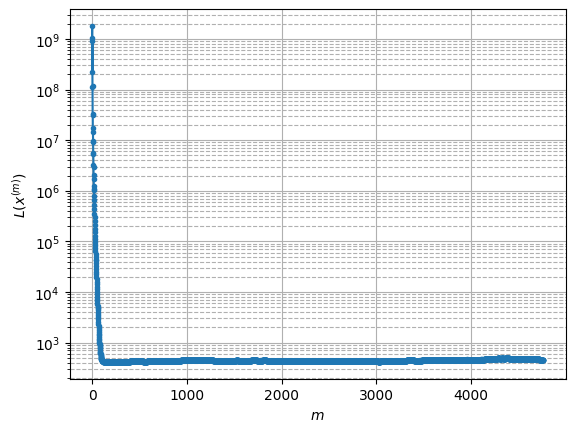

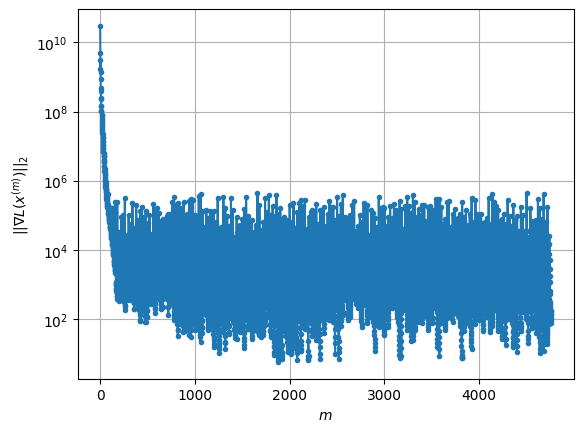

Windows:  80%|████████  | 238/296 [2:28:54<33:06, 34.25s/it]

Before applying the algorithm
Cost function: 457.9108563943651
Gradient norm: 112324.93048780067
Global relative error: 2.438554599947215
Position relative errors: 0.042170822211039134 m, 0.4485345871116801 m, 1.644062513338356 m, 1.7437434539387378 m

Iteration 1
Cost function: 457.441955206121 (-0.10%)
Gradient norm: 24632.12005753213 (-78.07%)
Global relative error: 2.6545579799686236 (8.86%)
Position relative errors: 0.04908706467043376 m, 0.18708553054763422 m, 1.8195667841595125 m, 1.9231329526003007 m

Iteration 2
Cost function: 457.34682012251295 (-0.02%)
Gradient norm: 15364.063811588967 (-37.63%)
Global relative error: 2.7580710469742904 (3.90%)
Position relative errors: 0.04930681577893757 m, 0.23564350655171165 m, 1.7375783120060766 m, 2.128336079560405 m

Iteration 3
Cost function: 457.313524241088 (-0.01%)
Gradient norm: 8874.687815461419 (-42.24%)
Global relative error: 2.7992464252812344 (1.49%)
Position relative errors: 0.04949877011277715 m, 0.35725281392225894 m, 1.6

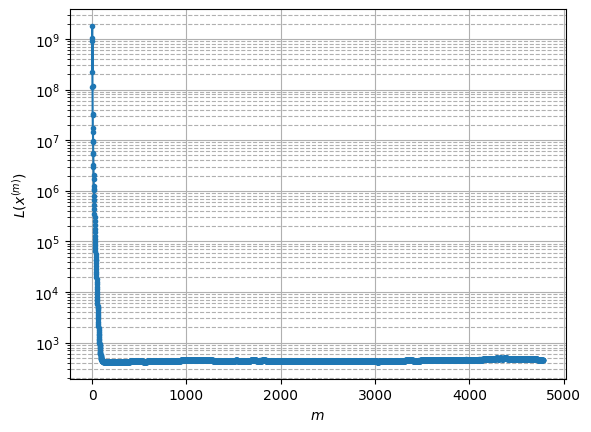

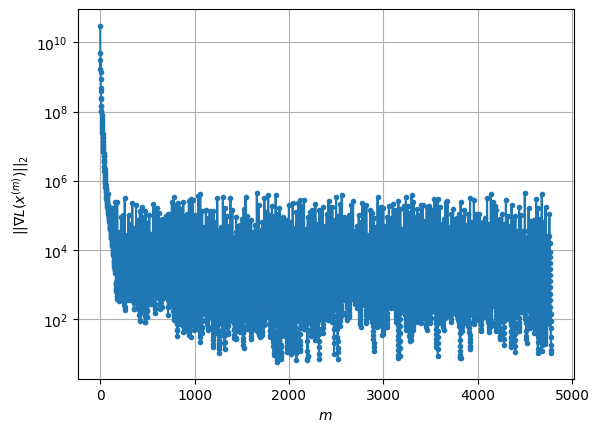

Windows:  81%|████████  | 239/296 [2:29:28<32:30, 34.21s/it]

Before applying the algorithm
Cost function: 458.704995653494
Gradient norm: 34724.35320484596
Global relative error: 2.9873338899338338
Position relative errors: 0.04824479111776174 m, 0.4570788017071978 m, 1.6798062438765125 m, 2.4271716444017475 m

Iteration 1
Cost function: 458.56062595668055 (-0.03%)
Gradient norm: 9008.172775176361 (-74.06%)
Global relative error: 3.2883881724317674 (10.08%)
Position relative errors: 0.04775876055209087 m, 0.49977463426784463 m, 1.862818800346991 m, 2.6629576316068815 m

Iteration 2
Cost function: 458.544083415811 (-0.00%)
Gradient norm: 4684.973667684734 (-47.99%)
Global relative error: 3.2778217521742783 (-0.32%)
Position relative errors: 0.04773764610701215 m, 0.6183441455436428 m, 1.8231220358769045 m, 2.652491147408074 m

Iteration 3
Cost function: 458.540126874061 (-0.00%)
Gradient norm: 2169.4745725517373 (-53.69%)
Global relative error: 3.3398360135685725 (1.89%)
Position relative errors: 0.04780842486919512 m, 0.6148894731295214 m, 1.817

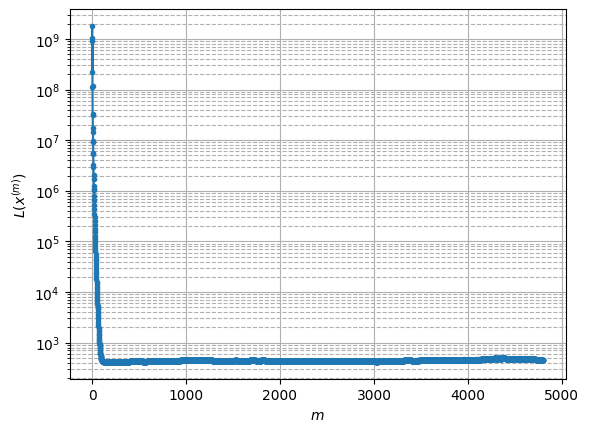

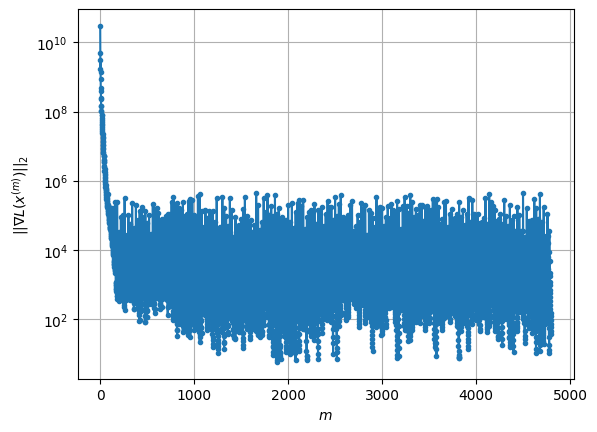

Windows:  81%|████████  | 240/296 [2:30:02<31:54, 34.19s/it]

Before applying the algorithm
Cost function: 459.51678747063
Gradient norm: 165805.5502322576
Global relative error: 3.425121432826846
Position relative errors: 0.046196036782491644 m, 0.6504514260973723 m, 1.8516689662653796 m, 2.80669809245377 m

Iteration 1
Cost function: 459.45129444247044 (-0.01%)
Gradient norm: 5378.411027951795 (-96.76%)
Global relative error: 3.475741962034072 (1.48%)
Position relative errors: 0.04542137188931019 m, 0.7941912919814587 m, 1.9578984819356167 m, 2.7594581478642612 m

Iteration 2
Cost function: 459.44759200911403 (-0.00%)
Gradient norm: 3450.6738294040874 (-35.84%)
Global relative error: 3.5121181393754433 (1.05%)
Position relative errors: 0.04537410296085281 m, 0.7666714552772051 m, 1.952448479487351 m, 2.8165708254509854 m

Iteration 3
Cost function: 459.44670572868154 (-0.00%)
Gradient norm: 2519.574333981805 (-26.98%)
Global relative error: 3.5087290743953368 (-0.10%)
Position relative errors: 0.04537832674347029 m, 0.8061498855327978 m, 1.9475

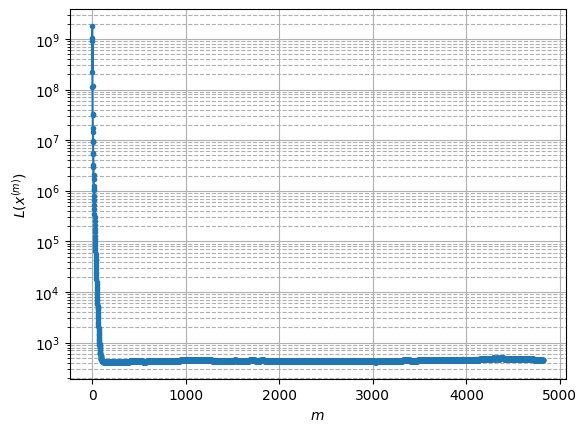

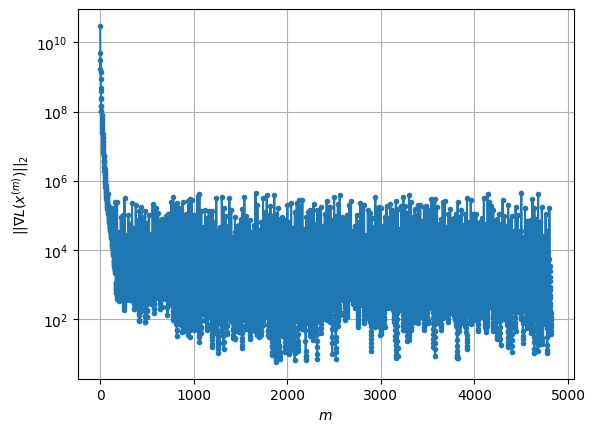

Windows:  81%|████████▏ | 241/296 [2:30:36<31:07, 33.95s/it]

Before applying the algorithm
Cost function: 457.5868502629053
Gradient norm: 51676.36048092352
Global relative error: 3.554939323659203
Position relative errors: 0.043732465051396156 m, 0.7598937180815912 m, 2.0056048934100046 m, 2.8347465637968554 m

Iteration 1
Cost function: 457.40683265490327 (-0.04%)
Gradient norm: 12241.047052051326 (-76.31%)
Global relative error: 3.371249024825949 (-5.17%)
Position relative errors: 0.042270175117227186 m, 0.8142573132269624 m, 1.8192779086340953 m, 2.7185920544420865 m

Iteration 2
Cost function: 457.3725969752144 (-0.01%)
Gradient norm: 6912.86887186709 (-43.53%)
Global relative error: 3.4370010283517654 (1.95%)
Position relative errors: 0.04226279075238564 m, 0.795029916061796 m, 1.8655861865049315 m, 2.774653407664202 m

Iteration 3
Cost function: 457.3621298114077 (-0.00%)
Gradient norm: 4449.186384338512 (-35.64%)
Global relative error: 3.4297677931907677 (-0.21%)
Position relative errors: 0.04213557184496467 m, 0.8424212979757483 m, 1.84

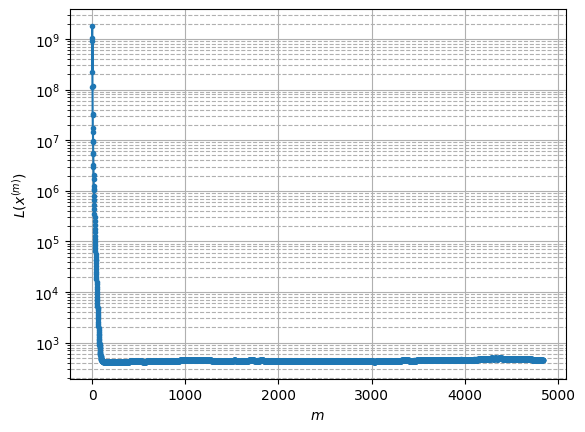

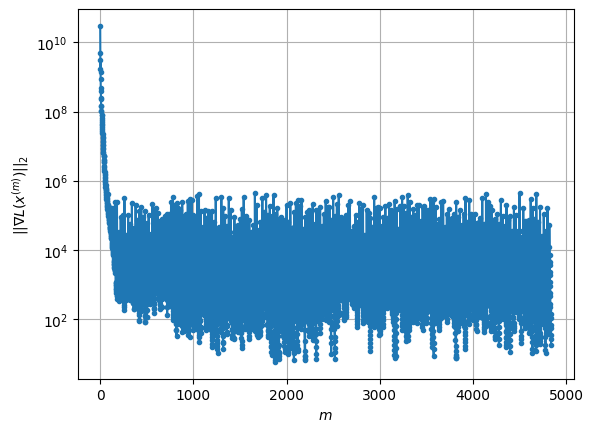

Windows:  82%|████████▏ | 242/296 [2:31:10<30:36, 34.02s/it]

Before applying the algorithm
Cost function: 461.0404017523355
Gradient norm: 135315.87472852826
Global relative error: 3.4902230052455887
Position relative errors: 0.04032457887654556 m, 0.85457141259252 m, 1.8892211421883567 m, 2.807236467138403 m

Iteration 1
Cost function: 460.01445562616755 (-0.22%)
Gradient norm: 49876.596183359354 (-63.14%)
Global relative error: 2.9659290430755005 (-15.02%)
Position relative errors: 0.04217435450456012 m, 1.265963136131047 m, 1.9628454427460338 m, 1.8274370159513555 m

Iteration 2
Cost function: 459.85877342769857 (-0.03%)
Gradient norm: 26451.398521404444 (-46.97%)
Global relative error: 2.9757883731906274 (0.33%)
Position relative errors: 0.0418927356086919 m, 0.7633803364561982 m, 2.0550876906656645 m, 2.0118202552590354 m

Iteration 3
Cost function: 459.81828475552 (-0.01%)
Gradient norm: 13349.065486211177 (-49.53%)
Global relative error: 2.8240732747334802 (-5.10%)
Position relative errors: 0.04172129655372035 m, 0.8614233374303322 m, 2.0

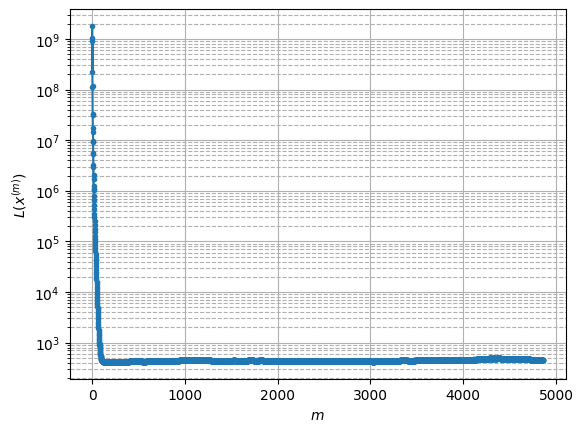

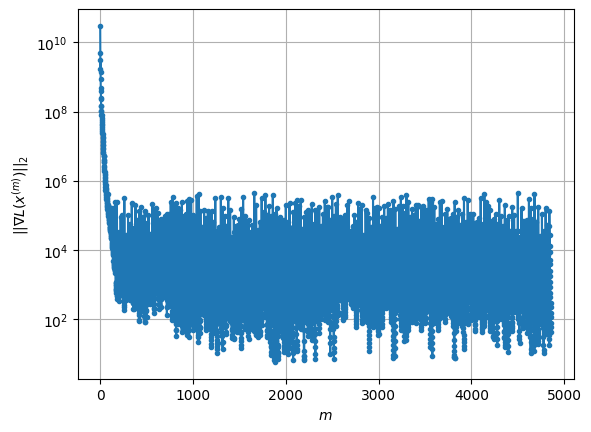

Windows:  82%|████████▏ | 243/296 [2:31:44<30:02, 34.00s/it]

Before applying the algorithm
Cost function: 464.0229369324228
Gradient norm: 111306.22813434222
Global relative error: 2.7031452455580336
Position relative errors: 0.039825408013508944 m, 0.44143525576238 m, 2.217374619341662 m, 1.481143874040936 m

Iteration 1
Cost function: 463.37471769167234 (-0.14%)
Gradient norm: 28953.738047288443 (-73.99%)
Global relative error: 2.131325876458553 (-21.15%)
Position relative errors: 0.03469348519773725 m, 0.06596655505295722 m, 1.6292968260559013 m, 1.3719990466880776 m

Iteration 2
Cost function: 463.30571311446704 (-0.01%)
Gradient norm: 10192.991209267431 (-64.80%)
Global relative error: 2.1214676820924043 (-0.46%)
Position relative errors: 0.03497202210667046 m, 0.10300090351211871 m, 1.6700437212943515 m, 1.3037414051919685 m

Iteration 3
Cost function: 463.2888549876916 (-0.00%)
Gradient norm: 2904.9023979706312 (-71.50%)
Global relative error: 2.112622666372979 (-0.42%)
Position relative errors: 0.03508426644642625 m, 0.03134379463693822 

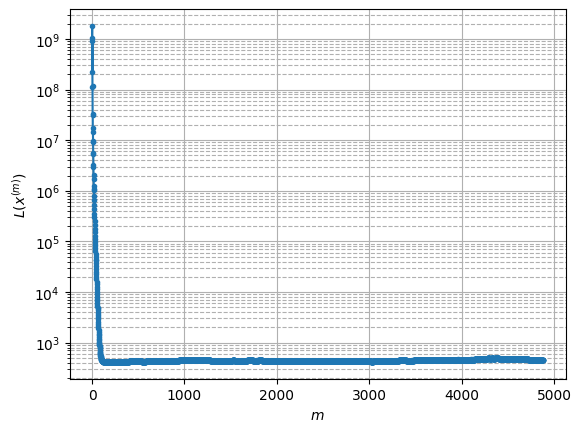

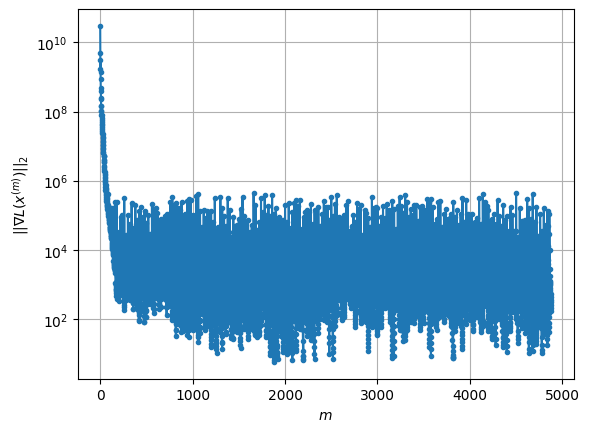

Windows:  82%|████████▏ | 244/296 [2:32:18<29:24, 33.92s/it]

Before applying the algorithm
Cost function: 466.7487146887175
Gradient norm: 166803.7327608336
Global relative error: 2.024144025597055
Position relative errors: 0.03410781368795802 m, 0.27411887015079656 m, 1.7234604242752487 m, 1.0249553233060429 m

Iteration 1
Cost function: 466.22243944046426 (-0.11%)
Gradient norm: 34552.97796037533 (-79.29%)
Global relative error: 1.7290153857474042 (-14.58%)
Position relative errors: 0.04421182467310958 m, 0.19146468454022003 m, 1.5745669119721768 m, 0.6867417030591157 m

Iteration 2
Cost function: 466.1740709668026 (-0.01%)
Gradient norm: 16720.939921211477 (-51.61%)
Global relative error: 1.81596719419806 (5.03%)
Position relative errors: 0.0442196585446794 m, 0.16080750471388322 m, 1.603308248739198 m, 0.8362531844581212 m

Iteration 3
Cost function: 466.16504300631146 (-0.00%)
Gradient norm: 9046.90597926213 (-45.89%)
Global relative error: 1.7696481260398789 (-2.55%)
Position relative errors: 0.04424541300507626 m, 0.15897013993860215 m, 1

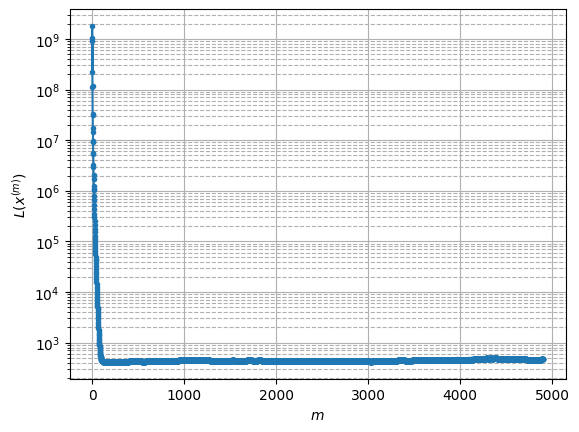

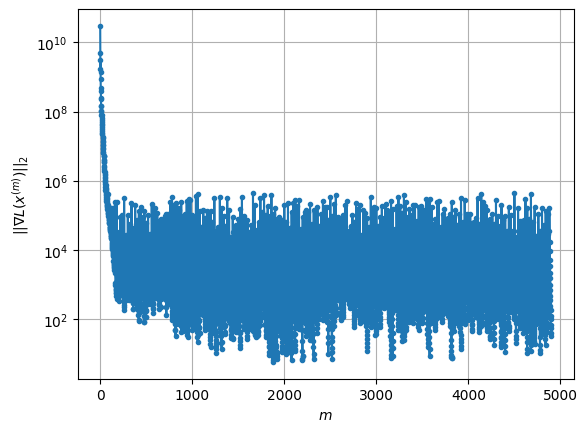

Windows:  83%|████████▎ | 245/296 [2:32:52<28:52, 33.97s/it]

Before applying the algorithm
Cost function: 463.9649171531331
Gradient norm: 42685.80343157974
Global relative error: 1.7871093173235237
Position relative errors: 0.04245588800874122 m, 0.1577276768610292 m, 1.620882660101093 m, 0.7347194209404838 m

Iteration 1
Cost function: 463.8418919673853 (-0.03%)
Gradient norm: 11659.466405329913 (-72.69%)
Global relative error: 1.9369099286333356 (8.38%)
Position relative errors: 0.04521939353594138 m, 0.11653809562150606 m, 1.7629812903261333 m, 0.7923920918801147 m

Iteration 2
Cost function: 463.8177227826576 (-0.01%)
Gradient norm: 7332.4972524730265 (-37.11%)
Global relative error: 1.908408161419078 (-1.47%)
Position relative errors: 0.0450249633725878 m, 0.1271622679774327 m, 1.739888133164404 m, 0.7724037937845727 m

Iteration 3
Cost function: 463.8099189587104 (-0.00%)
Gradient norm: 4577.172081704515 (-37.58%)
Global relative error: 1.92459671176501 (0.85%)
Position relative errors: 0.044943321225793614 m, 0.11927499377222534 m, 1.758

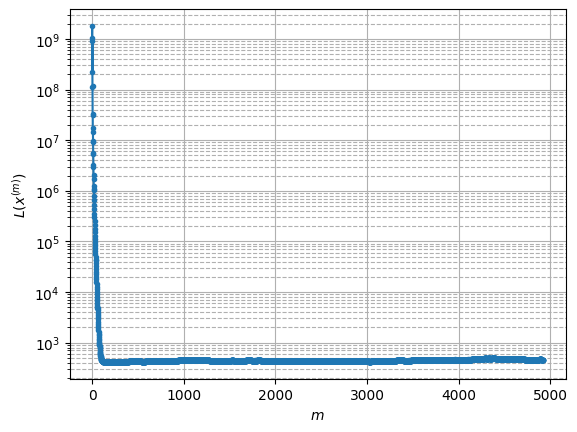

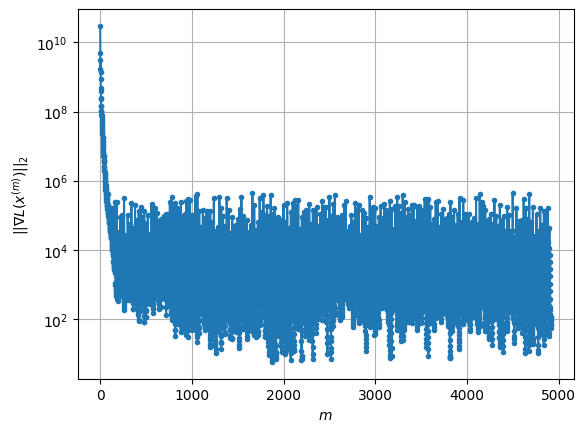

Windows:  83%|████████▎ | 246/296 [2:33:25<28:11, 33.83s/it]

Before applying the algorithm
Cost function: 467.0573434293462
Gradient norm: 106850.08305253183
Global relative error: 1.9351968091263376
Position relative errors: 0.042877188520619586 m, 0.1724588289300991 m, 1.791719025867159 m, 0.7093260008256254 m

Iteration 1
Cost function: 466.80260080927746 (-0.05%)
Gradient norm: 16749.033996879807 (-84.32%)
Global relative error: 2.0462358260978197 (5.74%)
Position relative errors: 0.05302964140213639 m, 0.3870710372547732 m, 1.9104886617232122 m, 0.6200588332174201 m

Iteration 2
Cost function: 466.76033446310737 (-0.01%)
Gradient norm: 8046.651438316849 (-51.96%)
Global relative error: 2.020904564909815 (-1.24%)
Position relative errors: 0.05309988776439784 m, 0.4289936983762465 m, 1.9101784037777676 m, 0.4984114016535869 m

Iteration 3
Cost function: 466.74092092966924 (-0.00%)
Gradient norm: 2531.4025701028586 (-68.54%)
Global relative error: 2.0736793917135543 (2.61%)
Position relative errors: 0.053230603034719666 m, 0.5606620776291397 m

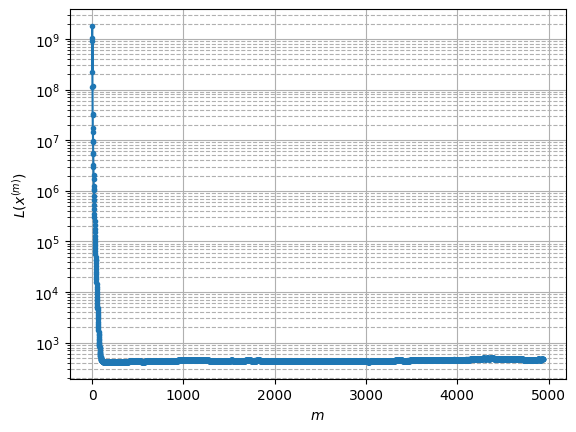

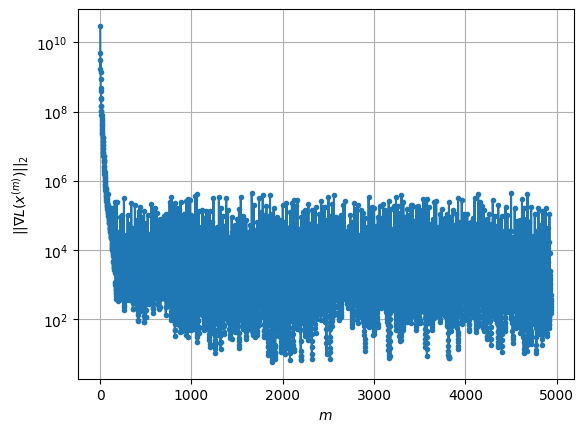

Windows:  83%|████████▎ | 247/296 [2:33:58<27:30, 33.69s/it]

Before applying the algorithm
Cost function: 466.4585448035581
Gradient norm: 157775.84201969457
Global relative error: 2.2578789021786
Position relative errors: 0.05143016416710033 m, 0.934071842705321 m, 2.042173185339855 m, 0.22892681374595228 m

Iteration 1
Cost function: 466.1463733974536 (-0.07%)
Gradient norm: 11985.68026433814 (-92.40%)
Global relative error: 2.0933650413226457 (-7.29%)
Position relative errors: 0.04314230369897624 m, 0.9832475841312115 m, 1.83202915597951 m, 0.2391786146281541 m

Iteration 2
Cost function: 466.08990685055954 (-0.01%)
Gradient norm: 6211.60664011788 (-48.17%)
Global relative error: 2.1081157096996943 (0.70%)
Position relative errors: 0.043573087062871524 m, 1.0094775087338224 m, 1.8402035450336436 m, 0.19198082117224544 m

Iteration 3
Cost function: 466.0663832225386 (-0.01%)
Gradient norm: 2562.1255150700945 (-58.75%)
Global relative error: 2.1146480753358463 (0.31%)
Position relative errors: 0.04378813542968979 m, 1.0386674275280205 m, 1.8316

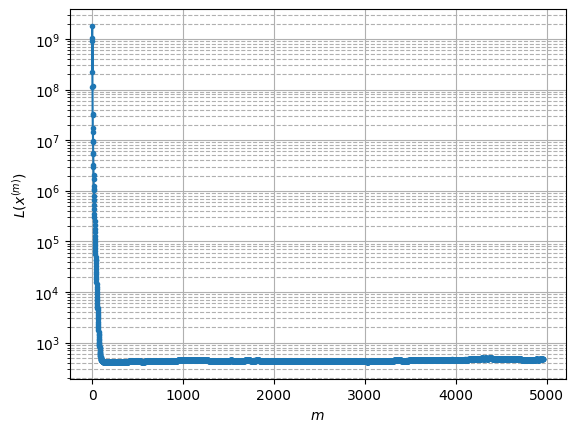

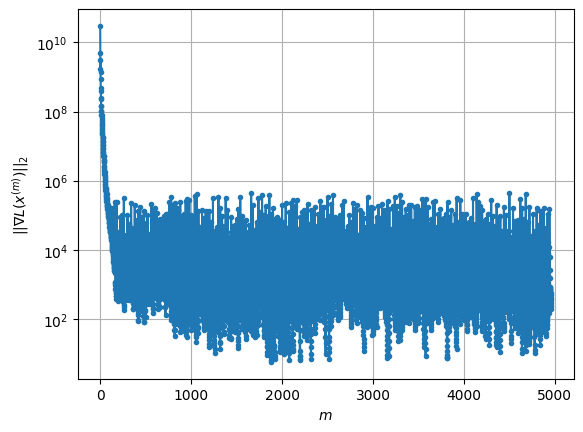

Windows:  84%|████████▍ | 248/296 [2:34:33<27:02, 33.81s/it]

Before applying the algorithm
Cost function: 464.2042781677226
Gradient norm: 147019.43352762482
Global relative error: 2.2727534656489565
Position relative errors: 0.04231326275624927 m, 1.288624481323706 m, 1.8445405290201315 m, 0.3173840510550085 m

Iteration 1
Cost function: 463.18526553856907 (-0.22%)
Gradient norm: 22699.47863799084 (-84.56%)
Global relative error: 1.962456175912224 (-13.65%)
Position relative errors: 0.03167489414468495 m, 1.6218749800910124 m, 1.0566763634562935 m, 0.321219892027915 m

Iteration 2
Cost function: 463.05566980646466 (-0.03%)
Gradient norm: 9370.697214373538 (-58.72%)
Global relative error: 1.7401972090894857 (-11.33%)
Position relative errors: 0.03212043456945535 m, 1.3330451707220232 m, 1.0879295679692131 m, 0.25816559286159085 m

Iteration 3
Cost function: 463.0178081810997 (-0.01%)
Gradient norm: 4664.692616298312 (-50.22%)
Global relative error: 1.747912077986714 (0.44%)
Position relative errors: 0.032120109935198655 m, 1.3859140647189354 m, 

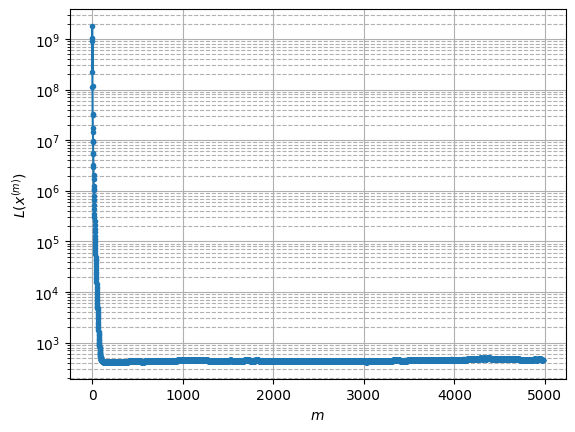

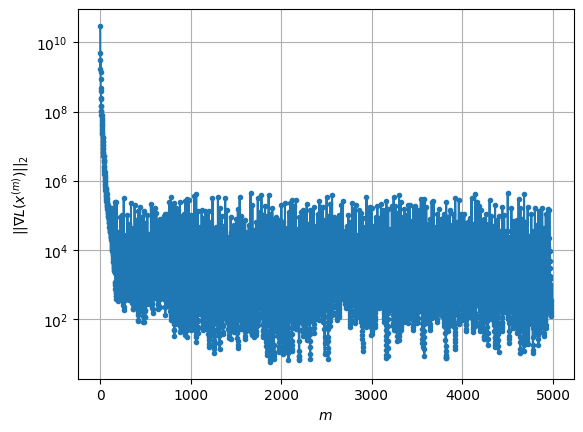

Windows:  84%|████████▍ | 249/296 [2:35:07<26:34, 33.92s/it]

Before applying the algorithm
Cost function: 460.41693218988235
Gradient norm: 25608.720636883758
Global relative error: 1.5486266892121507
Position relative errors: 0.030791347868390617 m, 1.2462799117090633 m, 0.8946170530454132 m, 0.20913100597834802 m

Iteration 1
Cost function: 460.13439396391885 (-0.06%)
Gradient norm: 7779.003869299833 (-69.62%)
Global relative error: 1.325129848922759 (-14.43%)
Position relative errors: 0.024081422411236477 m, 1.139411143677025 m, 0.6244356431185822 m, 0.2592376207808623 m

Iteration 2
Cost function: 460.08667470417623 (-0.01%)
Gradient norm: 6790.335167309664 (-12.71%)
Global relative error: 1.256421648794593 (-5.19%)
Position relative errors: 0.024297125867159104 m, 1.0373341571019272 m, 0.5871041118372665 m, 0.3965402218101457 m

Iteration 3
Cost function: 460.0702018231675 (-0.00%)
Gradient norm: 4702.352000873932 (-30.75%)
Global relative error: 1.170470880477063 (-6.84%)
Position relative errors: 0.02439761487689019 m, 0.9208868873740227 

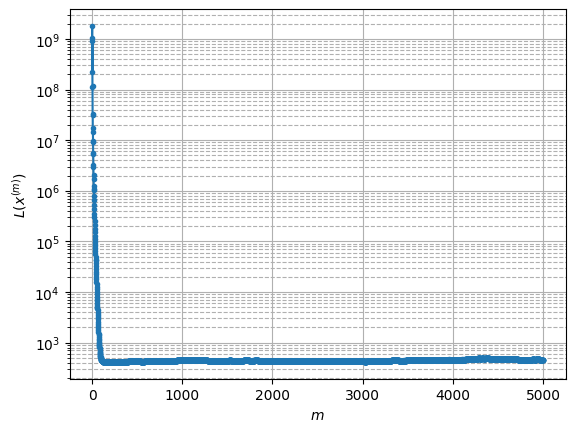

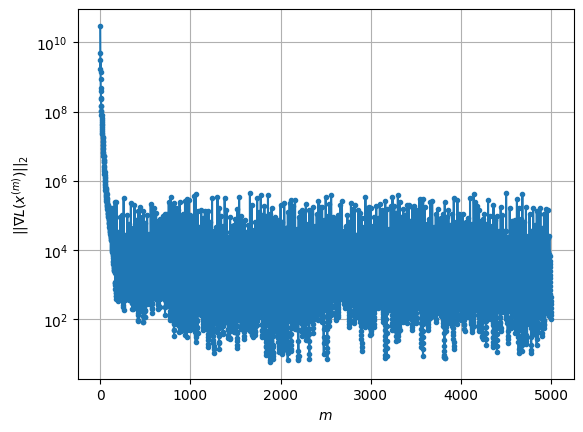

Windows:  84%|████████▍ | 250/296 [2:35:41<26:09, 34.11s/it]

Before applying the algorithm
Cost function: 458.27437599324435
Gradient norm: 231597.06077155887
Global relative error: 1.0754483155972412
Position relative errors: 0.02311603435608719 m, 0.8022955046133 m, 0.41869223818097856 m, 0.580573387191952 m

Iteration 1
Cost function: 458.0051153902629 (-0.06%)
Gradient norm: 25189.589645632677 (-89.12%)
Global relative error: 1.1413579141695196 (6.13%)
Position relative errors: 0.030927721895440963 m, 0.8322842811803673 m, 0.364384571300344 m, 0.690116158488773 m

Iteration 2
Cost function: 457.9606055617457 (-0.01%)
Gradient norm: 17784.64967904616 (-29.40%)
Global relative error: 1.0756268727429694 (-5.76%)
Position relative errors: 0.030952840350166138 m, 0.7388851358259613 m, 0.37602289601811534 m, 0.6845895016746308 m

Iteration 3
Cost function: 457.94090073873065 (-0.00%)
Gradient norm: 12323.643805984559 (-30.71%)
Global relative error: 1.1117307559119551 (3.36%)
Position relative errors: 0.030962231175593675 m, 0.7338908721431847 m, 

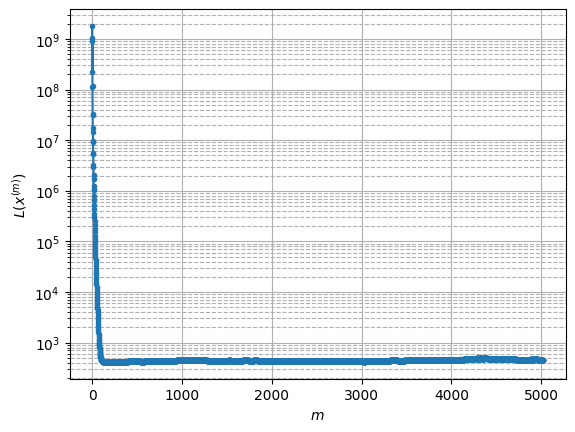

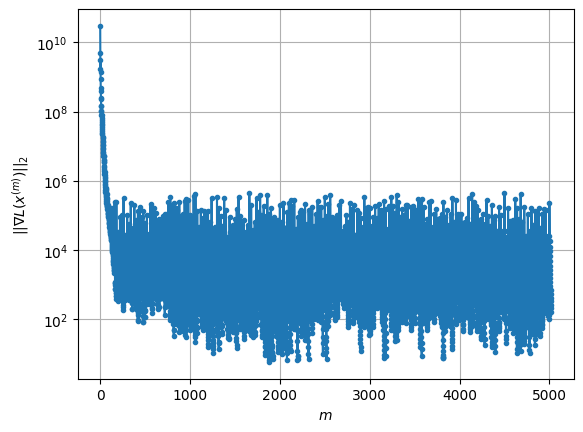

Windows:  85%|████████▍ | 251/296 [2:36:16<25:44, 34.32s/it]

Before applying the algorithm
Cost function: 464.4580773820305
Gradient norm: 255842.55821441187
Global relative error: 1.055769690638806
Position relative errors: 0.02948257078140355 m, 0.6890012718789124 m, 0.3148372804821049 m, 0.7347975690314427 m

Iteration 1
Cost function: 464.0237960549447 (-0.09%)
Gradient norm: 18432.702576836647 (-92.80%)
Global relative error: 1.1936358253393946 (13.06%)
Position relative errors: 0.03407014484117192 m, 0.5398897305865101 m, 0.6204922477210417 m, 0.8643537791365163 m

Iteration 2
Cost function: 463.9759375883492 (-0.01%)
Gradient norm: 7020.364669640569 (-61.91%)
Global relative error: 1.1601399553243519 (-2.81%)
Position relative errors: 0.03380054498603073 m, 0.5257151771980698 m, 0.5890885813634862 m, 0.8493371923037062 m

Iteration 3
Cost function: 463.96233568912317 (-0.00%)
Gradient norm: 1931.8097821989056 (-72.48%)
Global relative error: 1.1704518520699307 (0.89%)
Position relative errors: 0.03367304944113302 m, 0.5018813686733898 m, 

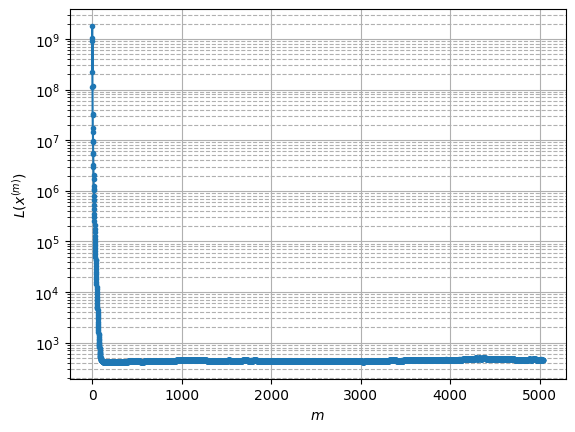

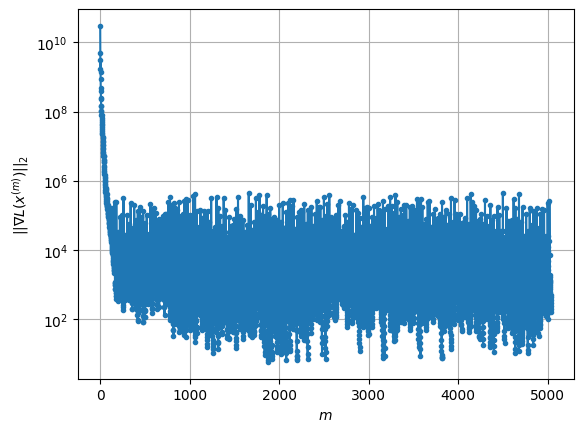

Windows:  85%|████████▌ | 252/296 [2:36:51<25:13, 34.40s/it]

Before applying the algorithm
Cost function: 461.09876020918193
Gradient norm: 149458.8033210716
Global relative error: 1.1209435454687326
Position relative errors: 0.03186740576810409 m, 0.46589978204207133 m, 0.5368655710722344 m, 0.8661437864076132 m

Iteration 1
Cost function: 460.5106684937978 (-0.13%)
Gradient norm: 19035.00729463782 (-87.26%)
Global relative error: 1.0146024112882923 (-9.49%)
Position relative errors: 0.031046875378933046 m, 0.5314560740880114 m, 0.4045516171278948 m, 0.7631103696432696 m

Iteration 2
Cost function: 460.44402896110284 (-0.01%)
Gradient norm: 6704.361458007713 (-64.78%)
Global relative error: 1.0933889896156817 (7.77%)
Position relative errors: 0.03095473839337962 m, 0.5915275171931659 m, 0.4331029979216642 m, 0.8105854715420722 m

Iteration 3
Cost function: 460.42898262622543 (-0.00%)
Gradient norm: 3807.7377151849496 (-43.21%)
Global relative error: 1.0254388029960855 (-6.21%)
Position relative errors: 0.030803889048167683 m, 0.5447139561298655

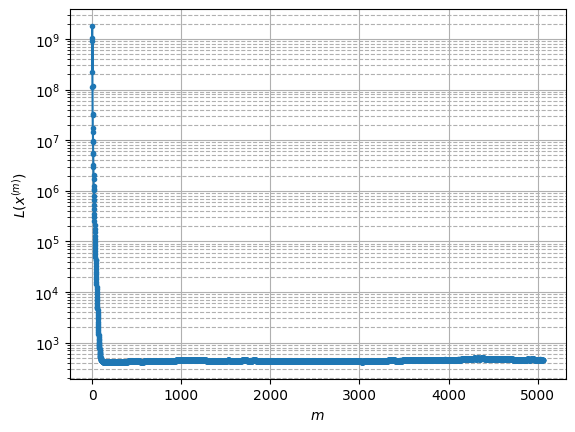

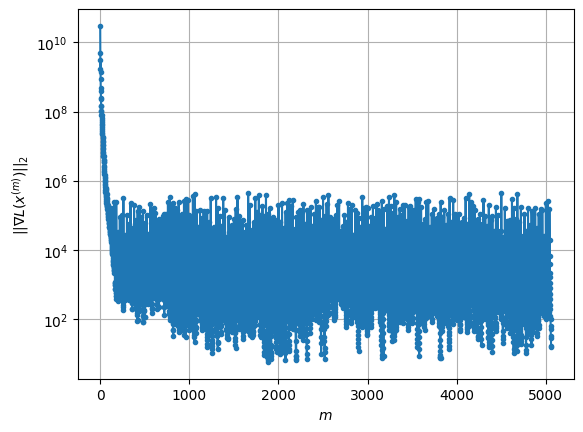

Windows:  85%|████████▌ | 253/296 [2:37:25<24:39, 34.41s/it]

Before applying the algorithm
Cost function: 456.3050147211837
Gradient norm: 172804.1920063472
Global relative error: 1.0205526355563816
Position relative errors: 0.029340650484676517 m, 0.6764633995078353 m, 0.3937552412533281 m, 0.654224407073039 m

Iteration 1
Cost function: 455.963715658883 (-0.07%)
Gradient norm: 16479.82711478825 (-90.46%)
Global relative error: 1.2304508708979216 (20.57%)
Position relative errors: 0.03562533957971696 m, 0.7338932978545505 m, 0.340923142084879 m, 0.926230701664289 m

Iteration 2
Cost function: 455.89501829949984 (-0.02%)
Gradient norm: 8861.840017536826 (-46.23%)
Global relative error: 1.1547447581483845 (-6.15%)
Position relative errors: 0.03599020714722233 m, 0.6657863551742803 m, 0.280011131381993 m, 0.900252291440654 m

Iteration 3
Cost function: 455.8708344292791 (-0.01%)
Gradient norm: 5198.28581291446 (-41.34%)
Global relative error: 1.206644040393057 (4.49%)
Position relative errors: 0.036238313612100455 m, 0.685350085544868 m, 0.2749124

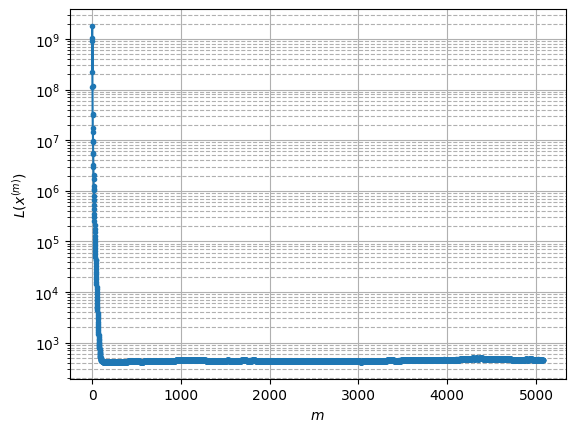

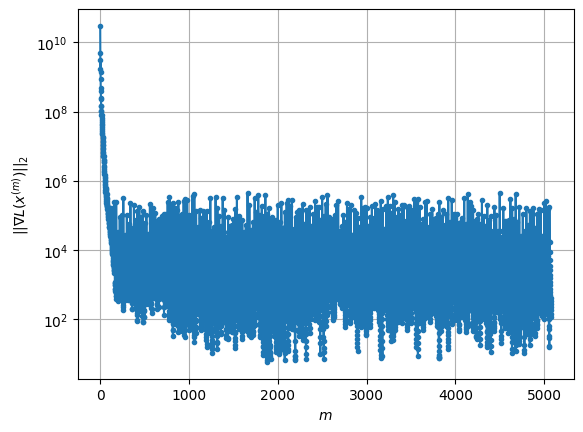

Windows:  86%|████████▌ | 254/296 [2:37:59<24:00, 34.29s/it]

Before applying the algorithm
Cost function: 453.68784879261443
Gradient norm: 104120.09788173286
Global relative error: 1.203950520996278
Position relative errors: 0.03523568652764057 m, 0.8841127620250165 m, 0.2371078047911186 m, 0.7812636609095556 m

Iteration 1
Cost function: 453.23935441710927 (-0.10%)
Gradient norm: 20370.879845532647 (-80.44%)
Global relative error: 1.3061535598528522 (8.49%)
Position relative errors: 0.03254861006332923 m, 0.6557100774432337 m, 0.5800861117152066 m, 0.9687699769623066 m

Iteration 2
Cost function: 453.19678504305796 (-0.01%)
Gradient norm: 10069.669359877818 (-50.57%)
Global relative error: 1.3625524682709205 (4.32%)
Position relative errors: 0.03264984389966453 m, 0.7134458087089016 m, 0.5564997749583185 m, 1.0182239934660993 m

Iteration 3
Cost function: 453.1856925340544 (-0.00%)
Gradient norm: 7621.7689896214915 (-24.31%)
Global relative error: 1.307047272980221 (-4.07%)
Position relative errors: 0.03269884366769285 m, 0.6419350481781924 m,

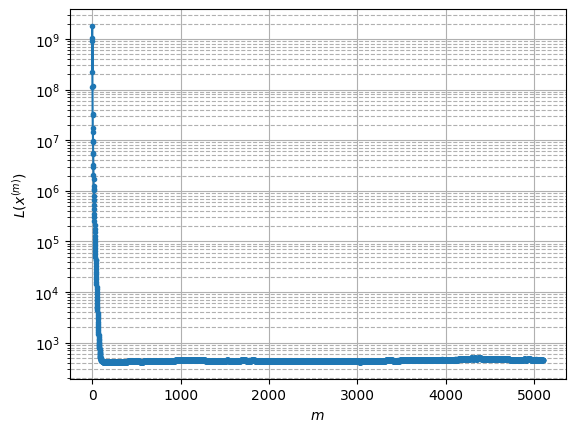

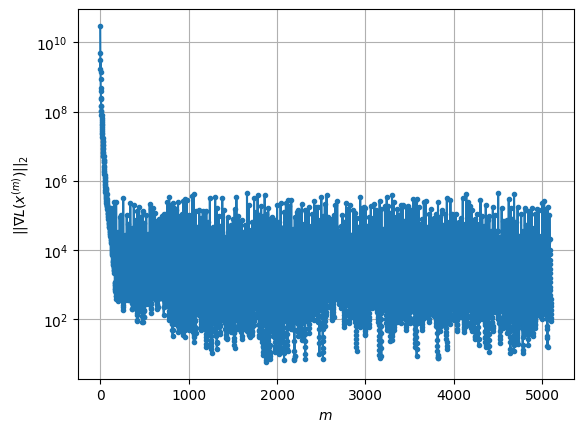

Windows:  86%|████████▌ | 255/296 [2:38:33<23:26, 34.30s/it]

Before applying the algorithm
Cost function: 454.2586651303188
Gradient norm: 180716.9337815489
Global relative error: 1.3275555903980047
Position relative errors: 0.03140068049208072 m, 0.7286857073426021 m, 0.4932152157361102 m, 0.9935634946818828 m

Iteration 1
Cost function: 453.97191544923544 (-0.06%)
Gradient norm: 17358.307092866013 (-90.39%)
Global relative error: 1.7155916416709545 (29.23%)
Position relative errors: 0.025425294762352613 m, 1.1008407410250667 m, 0.4240758380878393 m, 1.2453567284381937 m

Iteration 2
Cost function: 453.89855162637525 (-0.02%)
Gradient norm: 10294.43143310846 (-40.69%)
Global relative error: 1.4686022749417444 (-14.40%)
Position relative errors: 0.02585458047277029 m, 0.963929901719471 m, 0.40848792103970155 m, 1.0296100211617325 m

Iteration 3
Cost function: 453.8646961661607 (-0.01%)
Gradient norm: 8252.732614020388 (-19.83%)
Global relative error: 1.6657861806851673 (13.43%)
Position relative errors: 0.02611332479391189 m, 1.140666714965811 m

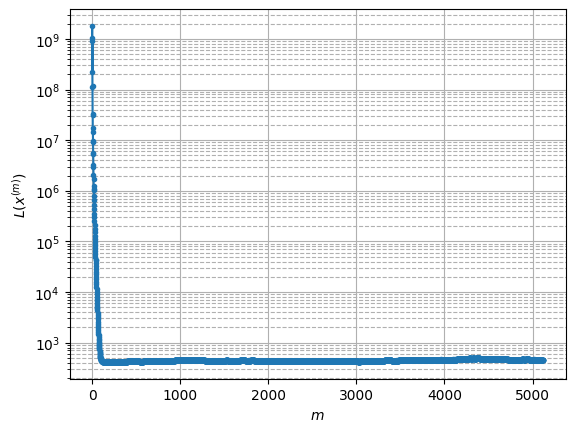

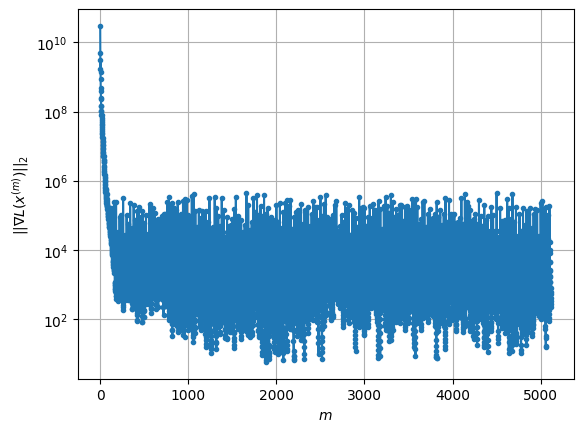

Windows:  86%|████████▋ | 256/296 [2:39:08<22:50, 34.25s/it]

Before applying the algorithm
Cost function: 450.7439891374909
Gradient norm: 36432.27236836617
Global relative error: 1.6885133679455075
Position relative errors: 0.02537604852964703 m, 1.386025639136315 m, 0.4505763322664537 m, 0.8522579218986918 m

Iteration 1
Cost function: 450.36757960986705 (-0.08%)
Gradient norm: 10552.661892862434 (-71.03%)
Global relative error: 1.8951533985579325 (12.24%)
Position relative errors: 0.030708573007173362 m, 1.3712949160216346 m, 0.7961505138069235 m, 1.037474320966635 m

Iteration 2
Cost function: 450.32010685451337 (-0.01%)
Gradient norm: 4705.65803616655 (-55.41%)
Global relative error: 1.9112229217912826 (0.85%)
Position relative errors: 0.03096517744199749 m, 1.4506223521726649 m, 0.7809684017918715 m, 0.9682937439457182 m

Iteration 3
Cost function: 450.3042751164365 (-0.00%)
Gradient norm: 2593.5120412726656 (-44.89%)
Global relative error: 1.924136664377269 (0.68%)
Position relative errors: 0.031081731357756177 m, 1.4723391116846347 m, 0.

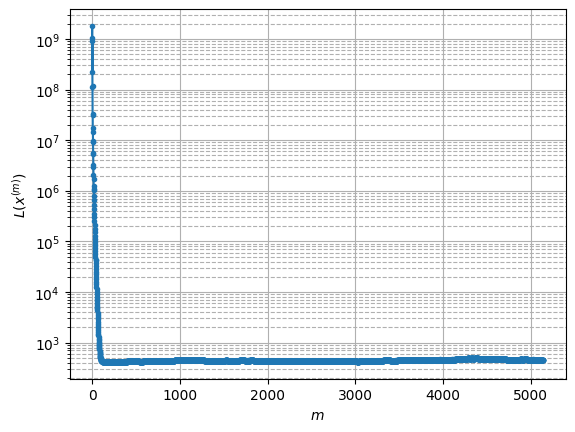

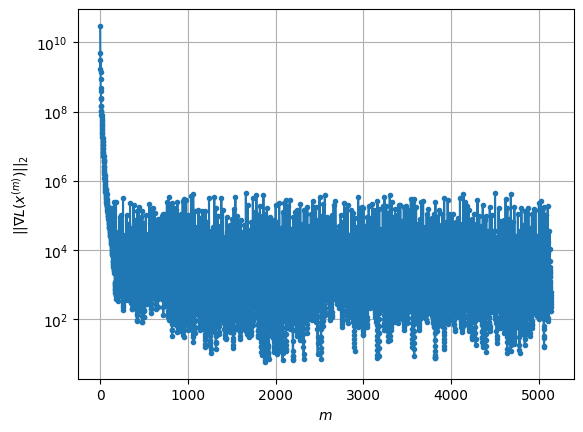

Windows:  87%|████████▋ | 257/296 [2:39:42<22:16, 34.28s/it]

Before applying the algorithm
Cost function: 449.3240178917772
Gradient norm: 90687.78867603424
Global relative error: 2.042985945247467
Position relative errors: 0.030212475598164173 m, 1.7174068466260373 m, 0.7585587127290678 m, 0.804969689852026 m

Iteration 1
Cost function: 449.0972477916695 (-0.05%)
Gradient norm: 12967.660740053645 (-85.70%)
Global relative error: 2.2355323864727747 (9.42%)
Position relative errors: 0.031086579444808488 m, 1.7033035100682021 m, 1.16707707905449 m, 0.8563412315460288 m

Iteration 2
Cost function: 449.069032311956 (-0.01%)
Gradient norm: 8268.268690462153 (-36.24%)
Global relative error: 2.1636790089827493 (-3.21%)
Position relative errors: 0.03127934662751839 m, 1.6658989455513655 m, 1.1247916869252161 m, 0.8000915358402991 m

Iteration 3
Cost function: 449.0588707938914 (-0.00%)
Gradient norm: 6942.790946303908 (-16.03%)
Global relative error: 2.2405458682266004 (3.55%)
Position relative errors: 0.03134093444725085 m, 1.74563228641432 m, 1.140563

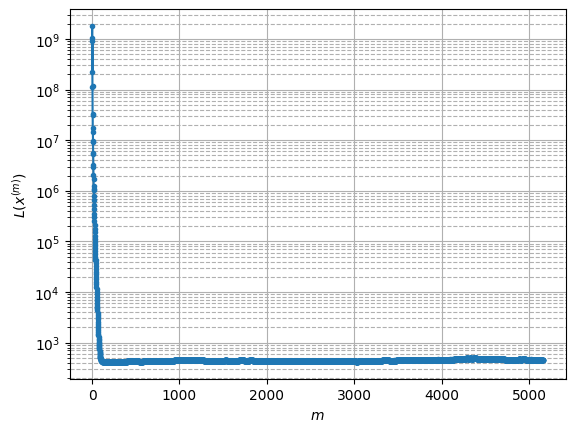

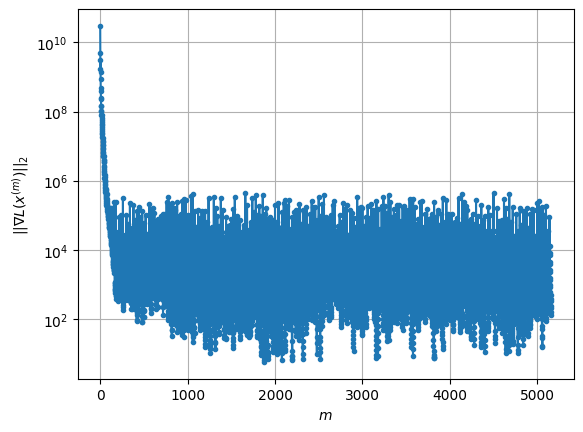

Windows:  87%|████████▋ | 258/296 [2:40:16<21:38, 34.16s/it]

Before applying the algorithm
Cost function: 447.8824482191187
Gradient norm: 318553.14724574075
Global relative error: 2.2437193463877527
Position relative errors: 0.03037272858611965 m, 1.8683072418452715 m, 1.0186192097538895 m, 0.7107674211122127 m

Iteration 1
Cost function: 447.50457492395435 (-0.08%)
Gradient norm: 24754.521484507557 (-92.23%)
Global relative error: 2.16600054828581 (-3.46%)
Position relative errors: 0.027666320567866134 m, 1.6654147415265885 m, 1.26258635928848 m, 0.5683802867323114 m

Iteration 2
Cost function: 447.46294285915354 (-0.01%)
Gradient norm: 15340.95552034023 (-38.03%)
Global relative error: 2.4430122185062983 (12.79%)
Position relative errors: 0.02752330865777625 m, 1.9400616853320123 m, 1.3600823555000292 m, 0.5948795462312476 m

Iteration 3
Cost function: 447.44881842874474 (-0.00%)
Gradient norm: 9406.407825098766 (-38.68%)
Global relative error: 2.3481464175813342 (-3.88%)
Position relative errors: 0.02749077701810709 m, 1.8479947331627968 m, 

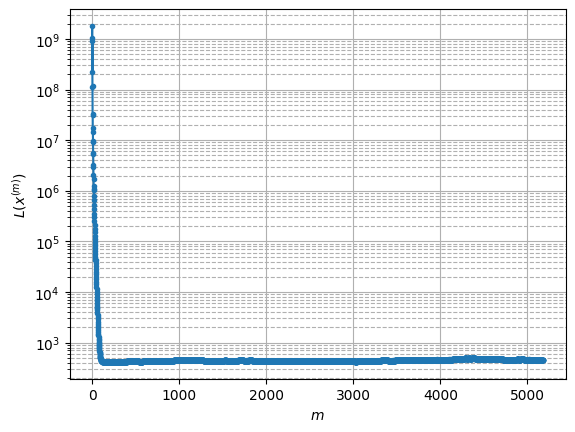

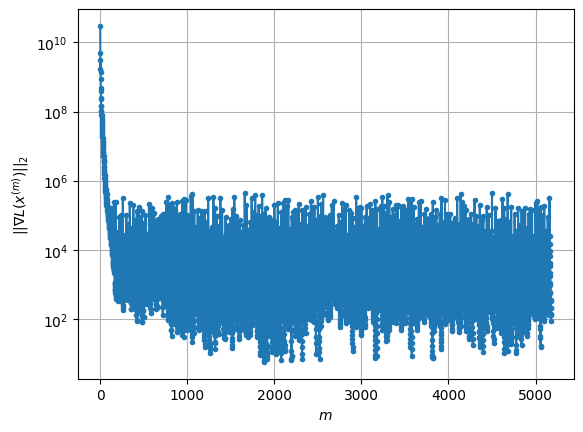

Windows:  88%|████████▊ | 259/296 [2:40:50<21:01, 34.10s/it]

Before applying the algorithm
Cost function: 449.71243238440235
Gradient norm: 61567.10343448019
Global relative error: 2.489246857271265
Position relative errors: 0.02626880174991798 m, 2.0675421269927665 m, 1.306609964016235 m, 0.46226964648002644 m

Iteration 1
Cost function: 449.39717514308387 (-0.07%)
Gradient norm: 24576.870137171558 (-60.08%)
Global relative error: 2.2471721152816073 (-9.72%)
Position relative errors: 0.02301179087815056 m, 1.865409667219239 m, 1.1789120524849304 m, 0.42386147627993975 m

Iteration 2
Cost function: 449.35239540872254 (-0.01%)
Gradient norm: 10907.422991355003 (-55.62%)
Global relative error: 2.3926408645781203 (6.47%)
Position relative errors: 0.022835358602986047 m, 2.019636027968339 m, 1.2315107793933837 m, 0.3586826249143902 m

Iteration 3
Cost function: 449.33694525401035 (-0.00%)
Gradient norm: 7142.974109994343 (-34.51%)
Global relative error: 2.2812821254863054 (-4.65%)
Position relative errors: 0.02275936179215869 m, 1.9039836141843642 m

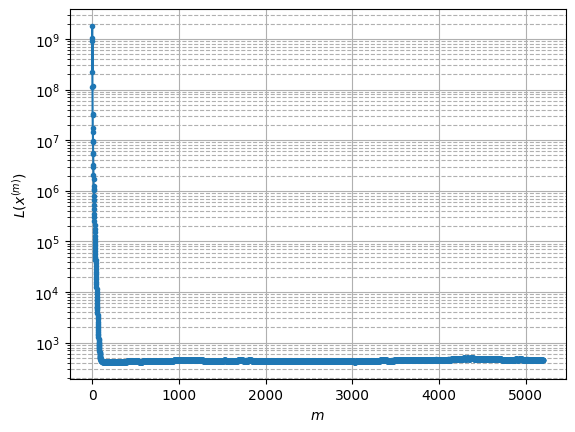

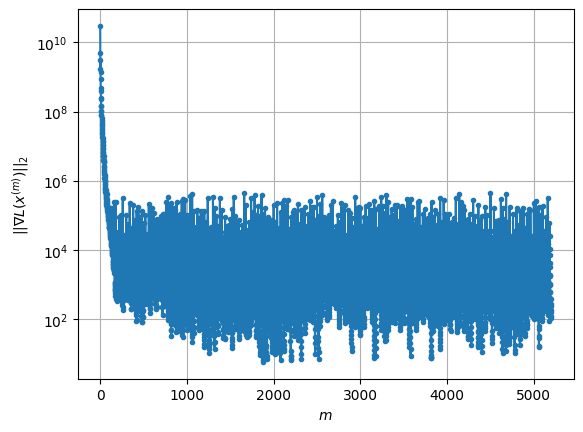

Windows:  88%|████████▊ | 260/296 [2:41:24<20:25, 34.03s/it]

Before applying the algorithm
Cost function: 450.9974495152857
Gradient norm: 87562.05060497741
Global relative error: 2.196197384429025
Position relative errors: 0.02257806045840551 m, 1.9140694809681313 m, 1.031913623225247 m, 0.30701531386201775 m

Iteration 1
Cost function: 450.59289342622213 (-0.09%)
Gradient norm: 23144.18867693447 (-73.57%)
Global relative error: 2.0051856196076767 (-8.70%)
Position relative errors: 0.019371826033979432 m, 1.7487557204069164 m, 0.9071690318048087 m, 0.37321175240032317 m

Iteration 2
Cost function: 450.4734853765064 (-0.03%)
Gradient norm: 15898.194180936183 (-31.31%)
Global relative error: 2.0552329529928053 (2.50%)
Position relative errors: 0.019203763042043326 m, 1.8228136767713403 m, 0.909891216648051 m, 0.27029066984651473 m

Iteration 3
Cost function: 450.42440712151944 (-0.01%)
Gradient norm: 9924.791258830845 (-37.57%)
Global relative error: 1.9313979946205744 (-6.03%)
Position relative errors: 0.019097336385429924 m, 1.7089478770766402 

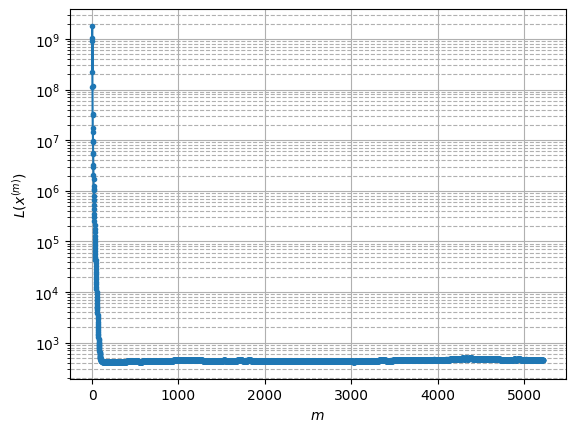

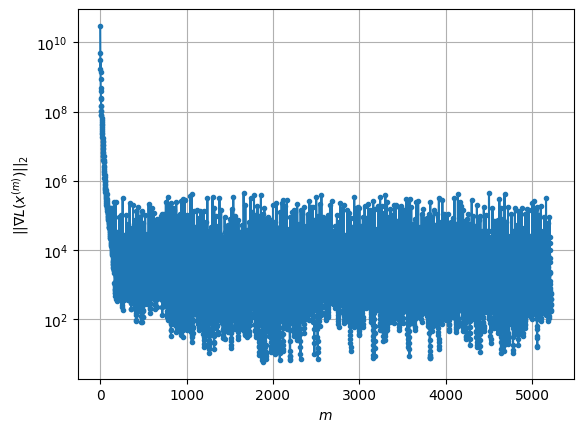

Windows:  88%|████████▊ | 261/296 [2:41:58<19:56, 34.19s/it]

Before applying the algorithm
Cost function: 449.22108460427785
Gradient norm: 80114.81631429165
Global relative error: 1.8386000621022798
Position relative errors: 0.01953071115932844 m, 1.6848690852993848 m, 0.7040105474038824 m, 0.21365618744690082 m

Iteration 1
Cost function: 449.0726032187071 (-0.03%)
Gradient norm: 21425.89456522278 (-73.26%)
Global relative error: 2.2614526111903186 (23.00%)
Position relative errors: 0.022030377450682377 m, 2.0791273153110916 m, 0.7799095528243314 m, 0.42737353214509743 m

Iteration 2
Cost function: 449.0481519045045 (-0.01%)
Gradient norm: 15067.004065020106 (-29.68%)
Global relative error: 2.010874959788177 (-11.08%)
Position relative errors: 0.022007531989734395 m, 1.8607475291953046 m, 0.7342262762814293 m, 0.2041054679326024 m

Iteration 3
Cost function: 449.0370784528949 (-0.00%)
Gradient norm: 11498.588927504012 (-23.68%)
Global relative error: 2.2193508502237984 (10.37%)
Position relative errors: 0.022049260468678594 m, 2.04964532107520

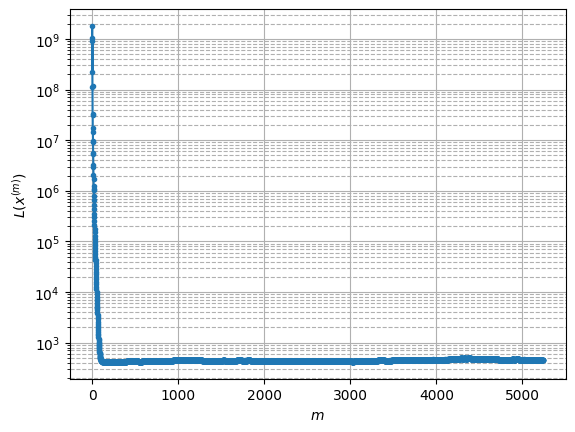

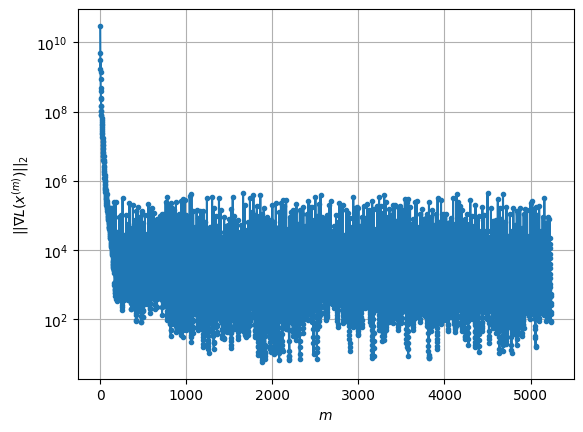

Windows:  89%|████████▊ | 262/296 [2:42:32<19:17, 34.03s/it]

Before applying the algorithm
Cost function: 459.56677751792
Gradient norm: 176334.97966550075
Global relative error: 2.224285674276984
Position relative errors: 0.022999732717780805 m, 2.104049946547626 m, 0.699402762610139 m, 0.17527795626846743 m

Iteration 1
Cost function: 458.80661317182694 (-0.17%)
Gradient norm: 34504.28084299111 (-80.43%)
Global relative error: 1.9202195958944417 (-13.67%)
Position relative errors: 0.018198875791319413 m, 1.7498365140602155 m, 0.7842003369936659 m, 0.1000554298217806 m

Iteration 2
Cost function: 458.6884147516489 (-0.03%)
Gradient norm: 20024.073453474623 (-41.97%)
Global relative error: 2.030828111147355 (5.76%)
Position relative errors: 0.018117440866593476 m, 1.8768286568665142 m, 0.7682251886621766 m, 0.10618661485238381 m

Iteration 3
Cost function: 458.6502949133016 (-0.01%)
Gradient norm: 11120.619932970189 (-44.46%)
Global relative error: 1.9427980224605539 (-4.33%)
Position relative errors: 0.018070285821152682 m, 1.7970088712360759 m

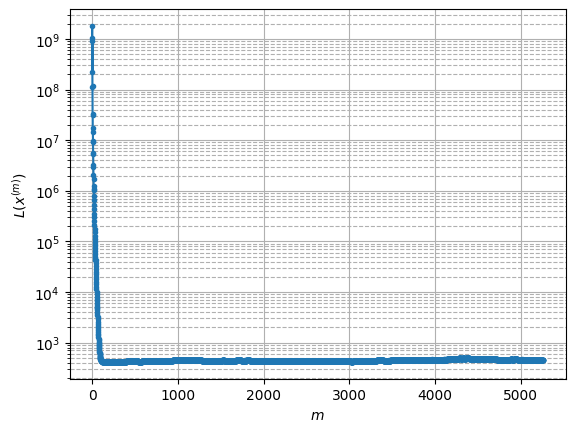

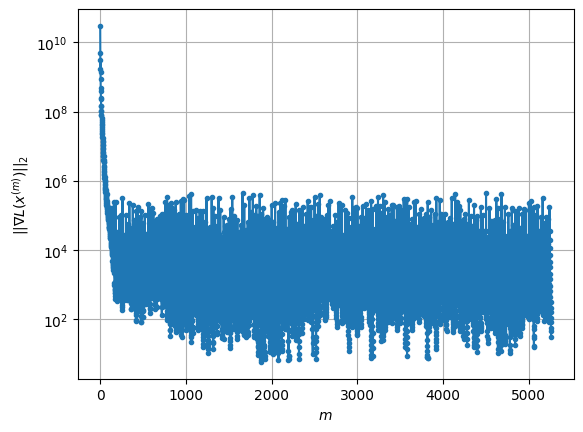

Windows:  89%|████████▉ | 263/296 [2:43:06<18:42, 34.03s/it]

Before applying the algorithm
Cost function: 458.815150509811
Gradient norm: 361591.65665930713
Global relative error: 2.0255701953635072
Position relative errors: 0.018479677190431646 m, 1.9030640351507309 m, 0.6890168291743972 m, 0.07869313622989649 m

Iteration 1
Cost function: 458.3417168201289 (-0.10%)
Gradient norm: 16478.022056922364 (-95.44%)
Global relative error: 1.9654007232516977 (-2.97%)
Position relative errors: 0.018058605311313917 m, 1.9010390248765285 m, 0.49770536862677073 m, 0.02847414589254938 m

Iteration 2
Cost function: 458.28250033563245 (-0.01%)
Gradient norm: 9879.512883861491 (-40.04%)
Global relative error: 1.8664508718843482 (-5.03%)
Position relative errors: 0.018246508232670145 m, 1.80330754077127 m, 0.47633089790740085 m, 0.06703172124402833 m

Iteration 3
Cost function: 458.26052193641647 (-0.00%)
Gradient norm: 3388.203766169551 (-65.70%)
Global relative error: 1.8507554256952556 (-0.84%)
Position relative errors: 0.01836316237432506 m, 1.7772059439967

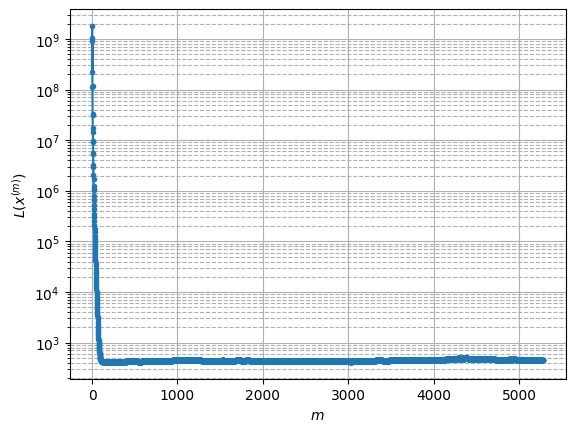

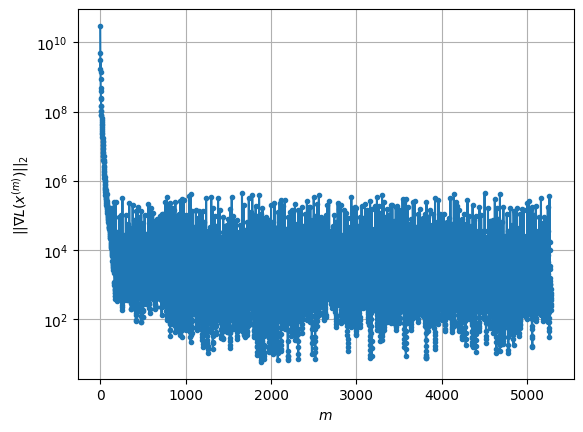

Windows:  89%|████████▉ | 264/296 [2:43:40<18:13, 34.18s/it]

Before applying the algorithm
Cost function: 458.62220171563183
Gradient norm: 310517.303829018
Global relative error: 1.71217806139861
Position relative errors: 0.01930347666264519 m, 1.6203444645940246 m, 0.49957546109878037 m, 0.23682354725650476 m

Iteration 1
Cost function: 458.2149670230283 (-0.09%)
Gradient norm: 19817.692732039955 (-93.62%)
Global relative error: 2.0716177316500666 (20.99%)
Position relative errors: 0.02957595610391865 m, 1.923079462055387 m, 0.5207496413491226 m, 0.5668387293438448 m

Iteration 2
Cost function: 458.1833773378227 (-0.01%)
Gradient norm: 14171.991454225043 (-28.49%)
Global relative error: 1.8063897583776423 (-12.80%)
Position relative errors: 0.029555708953410604 m, 1.6867193230532624 m, 0.5219340772090139 m, 0.3804328687615845 m

Iteration 3
Cost function: 458.17297733674815 (-0.00%)
Gradient norm: 10072.812373368903 (-28.92%)
Global relative error: 1.9731151100226885 (9.23%)
Position relative errors: 0.029625960805042838 m, 1.8233922082113518 

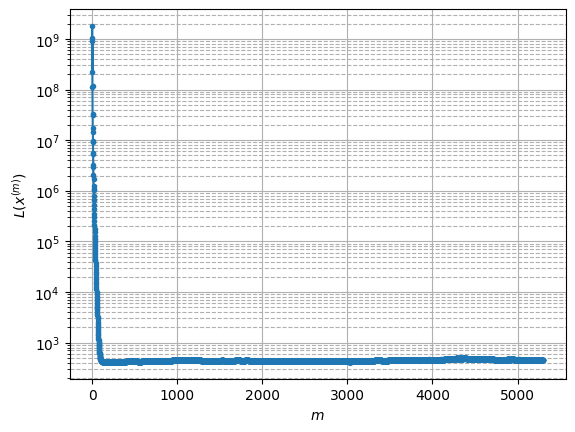

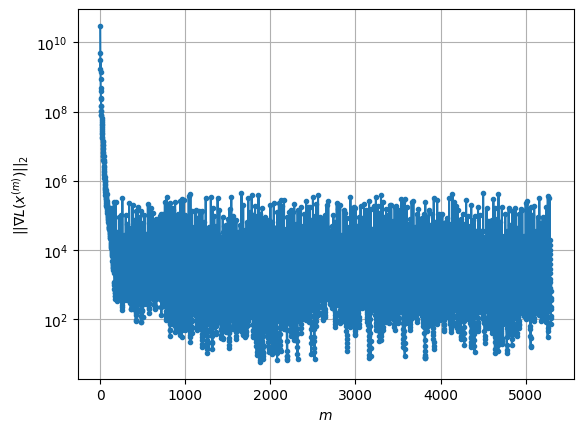

Windows:  90%|████████▉ | 265/296 [2:44:14<17:33, 33.99s/it]

Before applying the algorithm
Cost function: 460.6246290272907
Gradient norm: 92813.02424610703
Global relative error: 1.8422840531297262
Position relative errors: 0.02970236980248122 m, 1.7142143720439948 m, 0.519858386727118 m, 0.42934922708668677 m

Iteration 1
Cost function: 459.98216271827863 (-0.14%)
Gradient norm: 45838.44198285239 (-50.61%)
Global relative error: 1.367266724526439 (-25.78%)
Position relative errors: 0.023261733574512455 m, 1.250687184668904 m, 0.5322085892218925 m, 0.14631195540350359 m

Iteration 2
Cost function: 459.8685050585223 (-0.02%)
Gradient norm: 24310.553772320698 (-46.96%)
Global relative error: 1.7512215009441763 (28.08%)
Position relative errors: 0.023470865310552074 m, 1.6344195654648248 m, 0.5337790223275612 m, 0.3316214796350504 m

Iteration 3
Cost function: 459.82698391954966 (-0.01%)
Gradient norm: 17183.31012255285 (-29.32%)
Global relative error: 1.4805872158114677 (-15.45%)
Position relative errors: 0.023493173072032535 m, 1.359623665000391

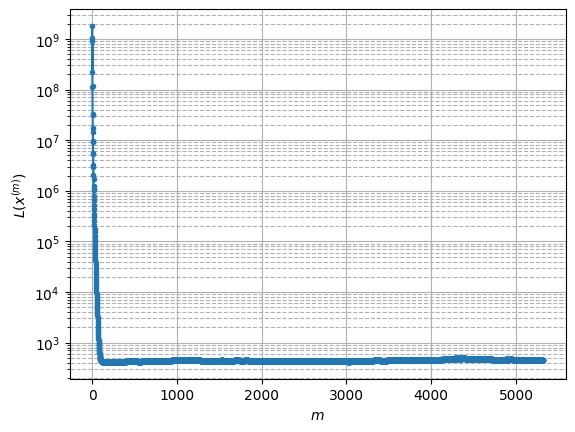

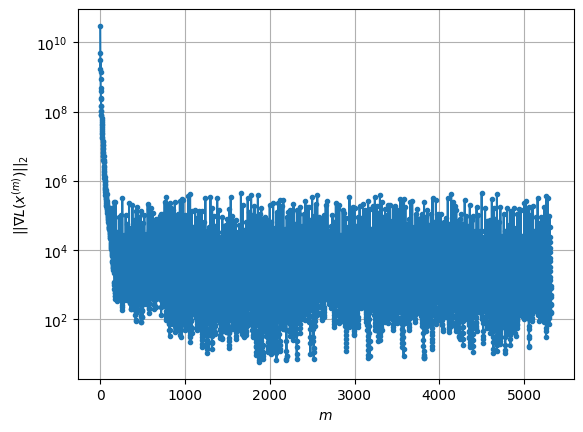

Windows:  90%|████████▉ | 266/296 [2:44:48<17:00, 34.01s/it]

Before applying the algorithm
Cost function: 460.3182779604772
Gradient norm: 127141.85483285513
Global relative error: 1.6248589320660514
Position relative errors: 0.024055785505713773 m, 1.5125426811010698 m, 0.5710623307143925 m, 0.16025828228062133 m

Iteration 1
Cost function: 459.50822182977527 (-0.18%)
Gradient norm: 24864.471286449174 (-80.44%)
Global relative error: 1.797287851505577 (10.61%)
Position relative errors: 0.02223516108332734 m, 1.632218137215172 m, 0.5945567007092473 m, 0.46054771320689475 m

Iteration 2
Cost function: 459.4110598410128 (-0.02%)
Gradient norm: 18028.119181575075 (-27.49%)
Global relative error: 1.598575228281524 (-11.06%)
Position relative errors: 0.022325527013296077 m, 1.4231687603115952 m, 0.6131361204059352 m, 0.391904368314398 m

Iteration 3
Cost function: 459.3873825763579 (-0.01%)
Gradient norm: 10081.552675469748 (-44.08%)
Global relative error: 1.6986223674544685 (6.26%)
Position relative errors: 0.02240962322704653 m, 1.4903076730531677 

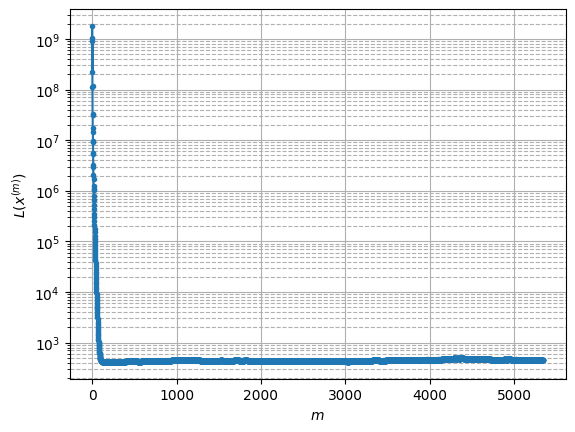

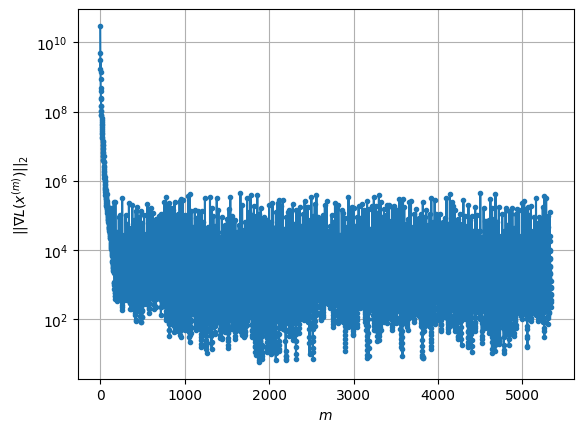

Windows:  90%|█████████ | 267/296 [2:45:22<16:28, 34.10s/it]

Before applying the algorithm
Cost function: 461.0088101098682
Gradient norm: 84353.9039217728
Global relative error: 1.5219099705531172
Position relative errors: 0.02296067389943584 m, 1.2828347197244114 m, 0.664953852130013 m, 0.47732860788603887 m

Iteration 1
Cost function: 460.7533797249382 (-0.06%)
Gradient norm: 25922.450733644124 (-69.27%)
Global relative error: 1.9727368053560974 (29.62%)
Position relative errors: 0.0224803096438026 m, 1.7556444281273742 m, 0.6605060940769265 m, 0.6104262827657396 m

Iteration 2
Cost function: 460.705073412483 (-0.01%)
Gradient norm: 13038.61962406026 (-49.70%)
Global relative error: 1.7498343484736274 (-11.30%)
Position relative errors: 0.022439483907244845 m, 1.5871044596916757 m, 0.6630547467962308 m, 0.320725738598403 m

Iteration 3
Cost function: 460.6833668941159 (-0.00%)
Gradient norm: 11420.011010434228 (-12.41%)
Global relative error: 1.9718228936795297 (12.69%)
Position relative errors: 0.02243415166437254 m, 1.8267303625162223 m, 0.

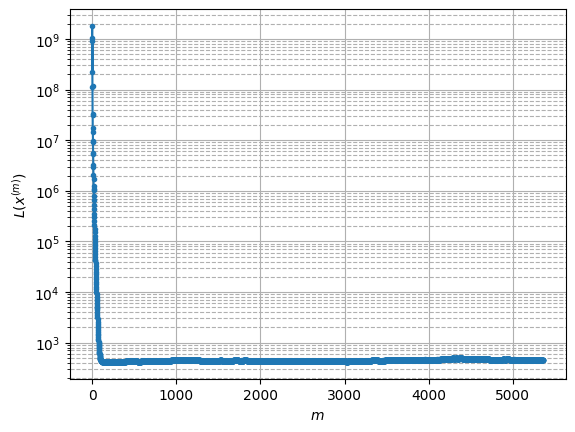

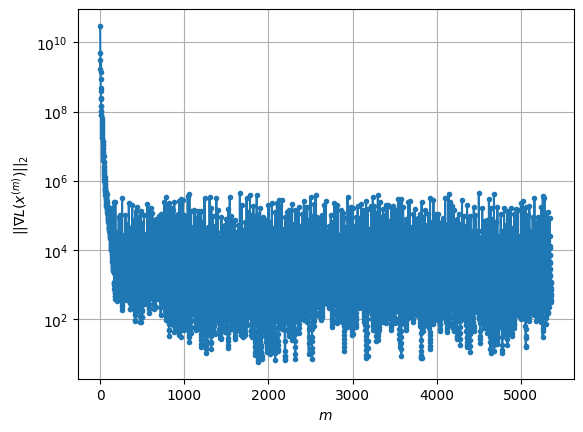

Windows:  91%|█████████ | 268/296 [2:45:57<15:58, 34.22s/it]

Before applying the algorithm
Cost function: 459.4671474851558
Gradient norm: 163443.08831920085
Global relative error: 2.0911768146532874
Position relative errors: 0.022705455472427038 m, 1.9973467014473234 m, 0.5625820734898994 m, 0.25807809783008817 m

Iteration 1
Cost function: 459.1024085613118 (-0.08%)
Gradient norm: 23450.35391731965 (-85.65%)
Global relative error: 2.5054367551914347 (19.81%)
Position relative errors: 0.02281912430447267 m, 2.3718667195299186 m, 0.7769375313996273 m, 0.21748644012038768 m

Iteration 2
Cost function: 459.0730988028817 (-0.01%)
Gradient norm: 12975.783749407277 (-44.67%)
Global relative error: 2.3737277590765355 (-5.26%)
Position relative errors: 0.022792238949209457 m, 2.232344854093562 m, 0.7605928436227821 m, 0.2686826706675198 m

Iteration 3
Cost function: 459.06379482365605 (-0.00%)
Gradient norm: 10610.19092077638 (-18.23%)
Global relative error: 2.5135906232196064 (5.89%)
Position relative errors: 0.02276406439833246 m, 2.3877673856659145 

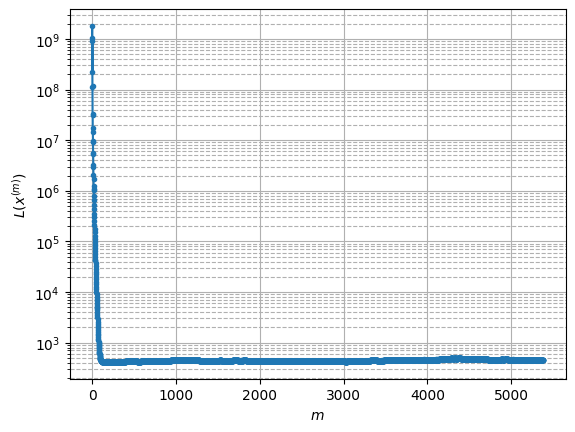

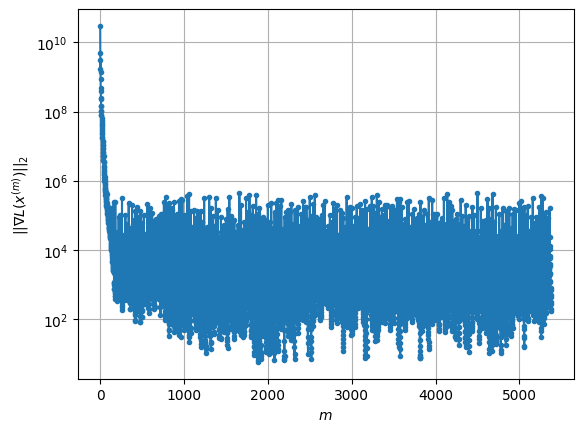

Windows:  91%|█████████ | 269/296 [2:46:31<15:22, 34.17s/it]

Before applying the algorithm
Cost function: 455.24460436117937
Gradient norm: 135435.2495220207
Global relative error: 2.592842224682348
Position relative errors: 0.02259674871729715 m, 2.4544220313682072 m, 0.704747067209809 m, 0.4488381991423314 m

Iteration 1
Cost function: 454.8739827511631 (-0.08%)
Gradient norm: 14246.920916760457 (-89.48%)
Global relative error: 2.8967213994046257 (11.72%)
Position relative errors: 0.02024020364483281 m, 2.6940887597424377 m, 1.0221973679330152 m, 0.29592738415641917 m

Iteration 2
Cost function: 454.82173142229647 (-0.01%)
Gradient norm: 14496.565412153972 (1.75%)
Global relative error: 2.7254068886269365 (-5.91%)
Position relative errors: 0.02015714936479147 m, 2.472954623564472 m, 1.080839469581061 m, 0.37908810991569675 m

Iteration 3
Cost function: 454.8024855823226 (-0.00%)
Gradient norm: 10660.848352800951 (-26.46%)
Global relative error: 2.808907374088071 (3.06%)
Position relative errors: 0.02009360544597343 m, 2.5806972062872293 m, 1.0

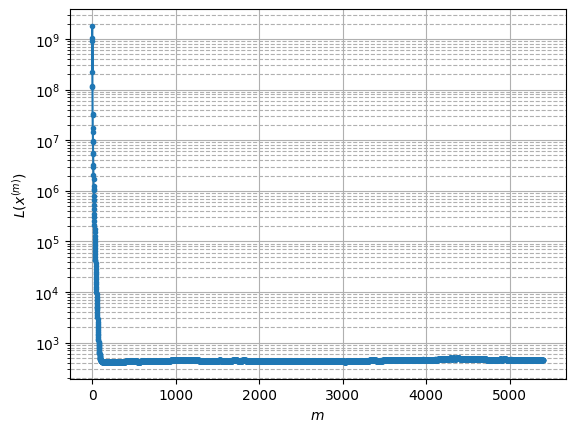

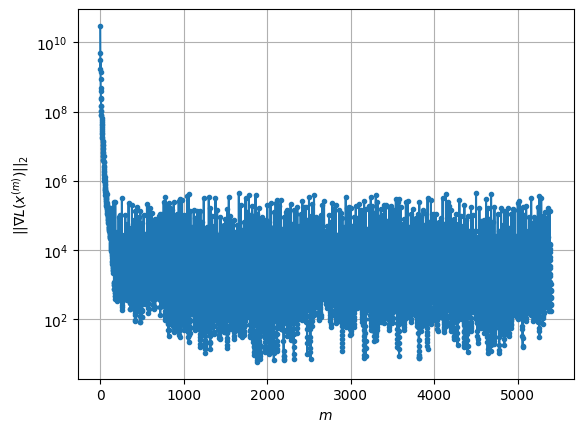

Windows:  91%|█████████ | 270/296 [2:47:04<14:43, 33.99s/it]

Before applying the algorithm
Cost function: 455.00828195256355
Gradient norm: 77976.55563320225
Global relative error: 2.610346064381842
Position relative errors: 0.019908526594176947 m, 2.3408315680851146 m, 1.1078830847809977 m, 0.32649990323447825 m

Iteration 1
Cost function: 454.72786515711925 (-0.06%)
Gradient norm: 18987.7349338305 (-75.65%)
Global relative error: 2.7209794030522674 (4.24%)
Position relative errors: 0.018939559020290073 m, 2.474549274154122 m, 1.099608980228723 m, 0.2661358803044391 m

Iteration 2
Cost function: 454.6943895007937 (-0.01%)
Gradient norm: 9183.440161527245 (-51.63%)
Global relative error: 2.6586599653602137 (-2.29%)
Position relative errors: 0.01894795102318837 m, 2.3859097859238227 m, 1.1215978731297396 m, 0.34286743842098344 m

Iteration 3
Cost function: 454.6845550922105 (-0.00%)
Gradient norm: 4967.011199080856 (-45.91%)
Global relative error: 2.699665015800685 (1.54%)
Position relative errors: 0.018957166710015426 m, 2.4521835094584454 m, 1.

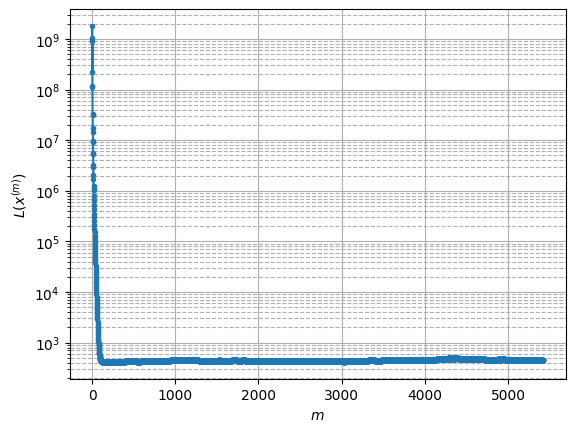

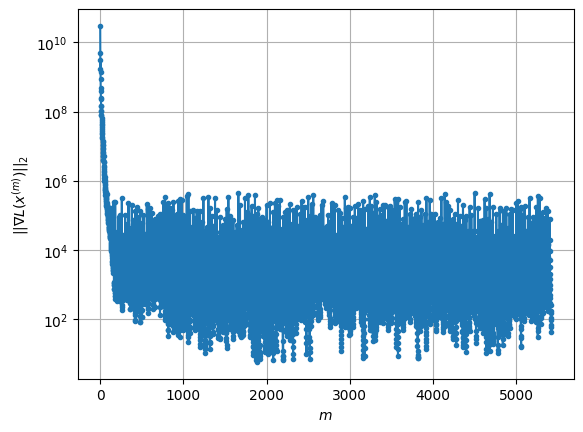

Windows:  92%|█████████▏| 271/296 [2:47:38<14:06, 33.87s/it]

Before applying the algorithm
Cost function: 461.2485628095956
Gradient norm: 151433.08179466077
Global relative error: 2.6130829824215294
Position relative errors: 0.019006706329832906 m, 2.3511990618867276 m, 1.0728129645600486 m, 0.3857061135720775 m

Iteration 1
Cost function: 460.8819766511187 (-0.08%)
Gradient norm: 26913.85776835071 (-82.23%)
Global relative error: 2.882766661259568 (10.32%)
Position relative errors: 0.018540801446567202 m, 2.6384903511138997 m, 1.1364812313538877 m, 0.23827301519048208 m

Iteration 2
Cost function: 460.8377909297152 (-0.01%)
Gradient norm: 12282.066420098034 (-54.37%)
Global relative error: 2.6860678860520495 (-6.82%)
Position relative errors: 0.018532830903511592 m, 2.369528775868398 m, 1.189733559508422 m, 0.4295099315543432 m

Iteration 3
Cost function: 460.8226372244636 (-0.00%)
Gradient norm: 7854.566286850063 (-36.05%)
Global relative error: 2.8252465082835347 (5.18%)
Position relative errors: 0.018537684273781132 m, 2.557250605872274 m, 

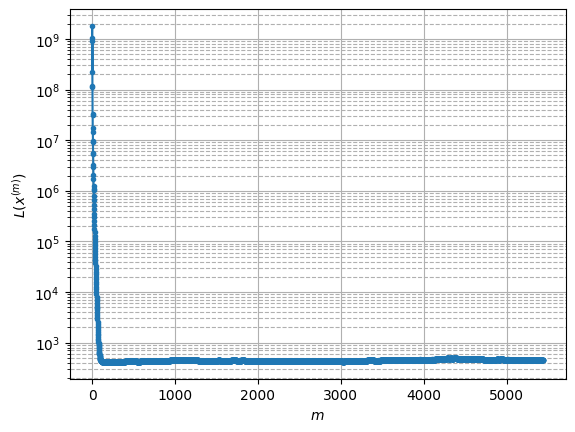

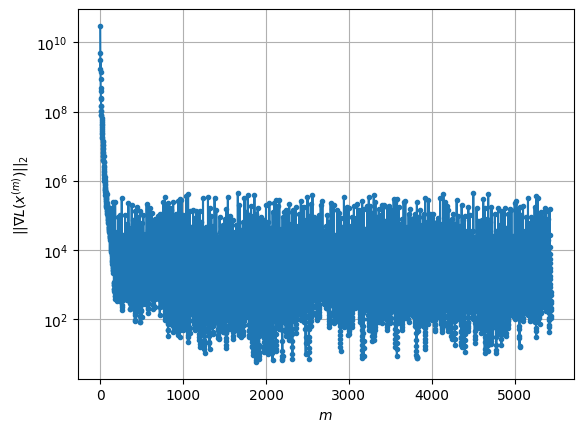

Windows:  92%|█████████▏| 272/296 [2:48:12<13:29, 33.74s/it]

Before applying the algorithm
Cost function: 463.0718337966589
Gradient norm: 165898.58401902983
Global relative error: 2.7163952092917594
Position relative errors: 0.018458351139772324 m, 2.420350022823516 m, 1.1594321122112674 m, 0.4196189578580299 m

Iteration 1
Cost function: 462.9615640438737 (-0.02%)
Gradient norm: 11432.654715998431 (-93.11%)
Global relative error: 2.6524419094878433 (-2.35%)
Position relative errors: 0.015831088156463797 m, 2.224721963244811 m, 1.3141627388805859 m, 0.5989832062115709 m

Iteration 2
Cost function: 462.94732955996994 (-0.00%)
Gradient norm: 8284.185628212224 (-27.54%)
Global relative error: 2.7092951387627866 (2.14%)
Position relative errors: 0.015853209320540775 m, 2.340658600749818 m, 1.28062772325709 m, 0.4704613944945617 m

Iteration 3
Cost function: 462.94186209476715 (-0.00%)
Gradient norm: 5646.171437064016 (-31.84%)
Global relative error: 2.6555308981136356 (-1.98%)
Position relative errors: 0.015869049863450536 m, 2.2470459066135917 m, 

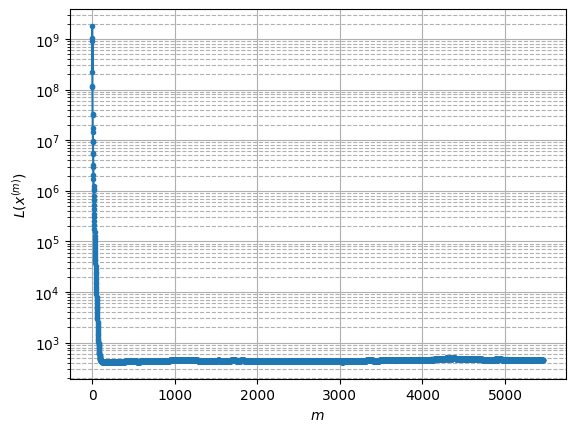

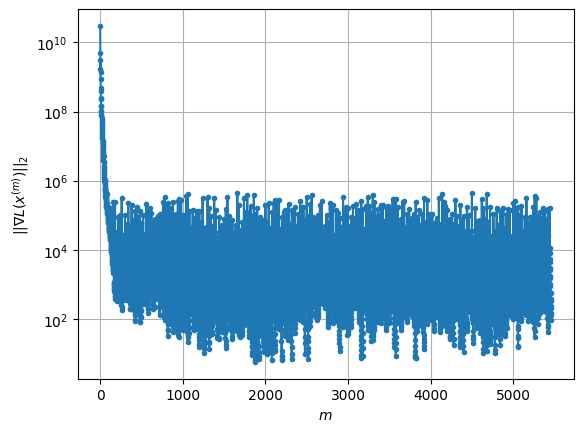

Windows:  92%|█████████▏| 273/296 [2:48:45<12:57, 33.78s/it]

Before applying the algorithm
Cost function: 463.63044218922596
Gradient norm: 285803.1536955477
Global relative error: 2.6343490123855866
Position relative errors: 0.015677859530609056 m, 2.238388939440268 m, 1.238831688802507 m, 0.6280565766634097 m

Iteration 1
Cost function: 462.95780765123936 (-0.15%)
Gradient norm: 7674.183595060029 (-97.31%)
Global relative error: 2.8843153777209376 (9.49%)
Position relative errors: 0.015243134375150388 m, 2.3593314616264256 m, 1.3022468070213107 m, 1.0279826841039807 m

Iteration 2
Cost function: 462.828408374047 (-0.03%)
Gradient norm: 15493.324859035787 (101.89%)
Global relative error: 3.0747122646099965 (6.60%)
Position relative errors: 0.015062725477728625 m, 2.6031968629895816 m, 1.1990656096033856 m, 1.113208482681324 m

Iteration 3
Cost function: 462.77007029473873 (-0.01%)
Gradient norm: 10654.193619379403 (-31.23%)
Global relative error: 3.191348821515782 (3.79%)
Position relative errors: 0.014928168117129298 m, 2.668232642325751 m, 1.

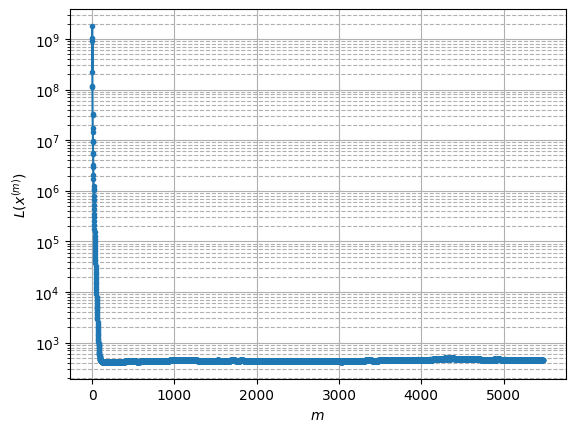

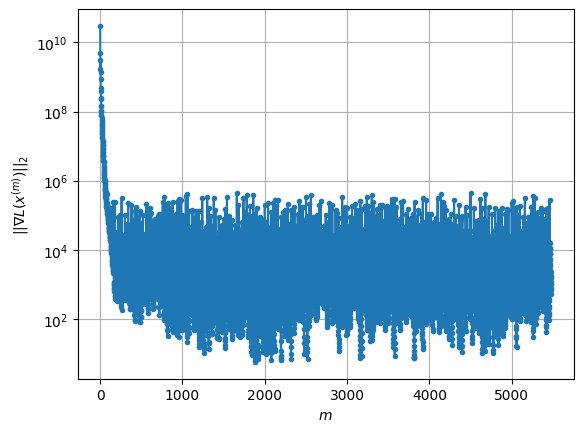

Windows:  93%|█████████▎| 274/296 [2:49:19<12:22, 33.75s/it]

Before applying the algorithm
Cost function: 461.49393010993236
Gradient norm: 198661.57205372668
Global relative error: 3.836207626326258
Position relative errors: 0.01450448185803717 m, 3.2087071503170788 m, 0.8805212920288124 m, 1.9092292124381869 m

Iteration 1
Cost function: 461.10730024067766 (-0.08%)
Gradient norm: 24071.2546558684 (-87.88%)
Global relative error: 3.7537436444408496 (-2.15%)
Position relative errors: 0.021816566546329443 m, 3.073085390698348 m, 0.9763107529427456 m, 1.9217375002942412 m

Iteration 2
Cost function: 461.05484398894055 (-0.01%)
Gradient norm: 10871.868030412044 (-54.83%)
Global relative error: 3.845650012570872 (2.45%)
Position relative errors: 0.021899539752069236 m, 3.2510083046158287 m, 0.9719325787661001 m, 1.8096499046717849 m

Iteration 3
Cost function: 461.03308213806724 (-0.00%)
Gradient norm: 7271.149910510435 (-33.12%)
Global relative error: 3.817677124335027 (-0.73%)
Position relative errors: 0.02194916199917042 m, 3.146043548091094 m, 0

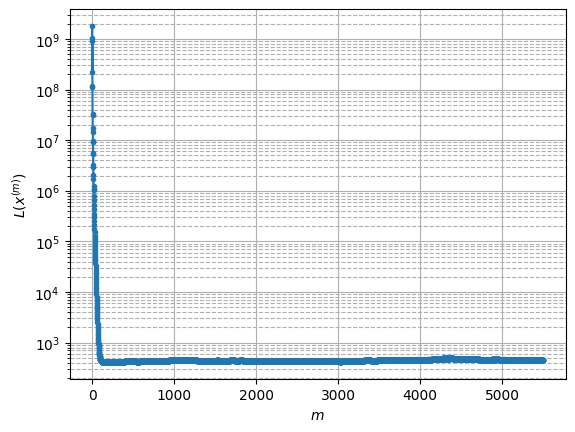

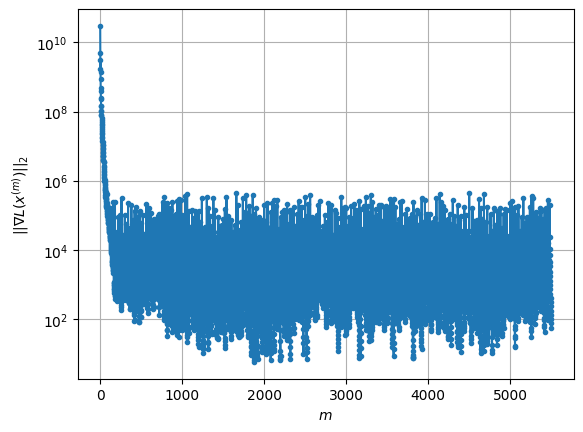

Windows:  93%|█████████▎| 275/296 [2:49:53<11:47, 33.69s/it]

Before applying the algorithm
Cost function: 462.97590667281304
Gradient norm: 218951.2084616767
Global relative error: 3.95722450598541
Position relative errors: 0.021866332719529934 m, 3.2563489686194123 m, 0.9128284487603148 m, 2.054769768796976 m

Iteration 1
Cost function: 462.59928118523345 (-0.08%)
Gradient norm: 14160.033863003917 (-93.53%)
Global relative error: 4.0191261307739925 (1.56%)
Position relative errors: 0.020704563620195043 m, 3.4343779765822564 m, 1.1681883482302557 m, 1.730123117462669 m

Iteration 2
Cost function: 462.558498565744 (-0.01%)
Gradient norm: 13037.55651906206 (-7.93%)
Global relative error: 3.8620136557285476 (-3.91%)
Position relative errors: 0.020745082656295166 m, 3.1292273217981905 m, 1.2338957972466058 m, 1.8974067536142676 m

Iteration 3
Cost function: 462.54271483556005 (-0.00%)
Gradient norm: 9458.88793140497 (-27.45%)
Global relative error: 3.848825543082545 (-0.34%)
Position relative errors: 0.02078247488033359 m, 3.2528163685802625 m, 1.23

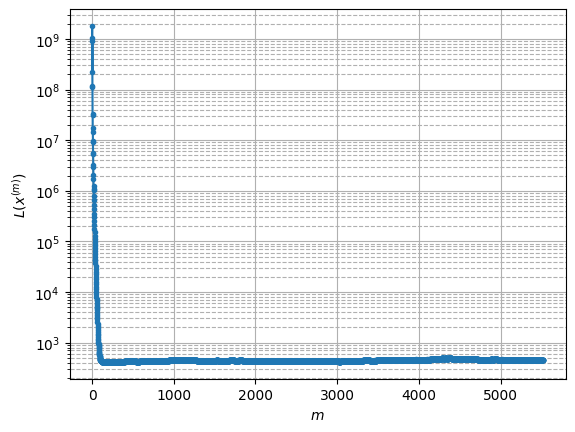

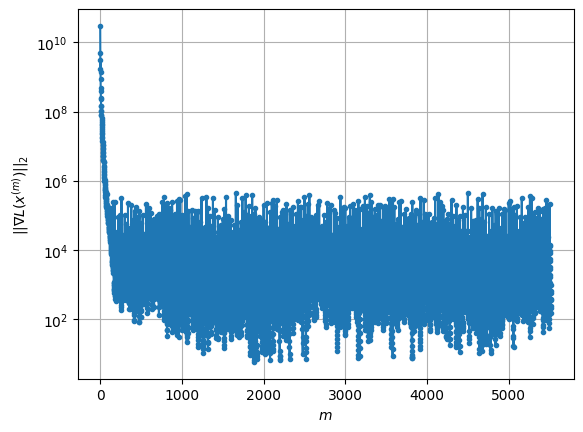

Windows:  93%|█████████▎| 276/296 [2:50:27<11:15, 33.79s/it]

Before applying the algorithm
Cost function: 460.4200394469564
Gradient norm: 138920.67030044112
Global relative error: 3.5117031501657165
Position relative errors: 0.020423151770670587 m, 2.8620305370234664 m, 1.282966695791238 m, 1.579371788432125 m

Iteration 1
Cost function: 459.90929403830023 (-0.11%)
Gradient norm: 27040.021938706945 (-80.54%)
Global relative error: 3.5331656849111712 (0.61%)
Position relative errors: 0.017321132735032073 m, 3.0798684472669837 m, 1.4539156382304752 m, 0.939943991580085 m

Iteration 2
Cost function: 459.8123263993236 (-0.02%)
Gradient norm: 19107.219549514375 (-29.34%)
Global relative error: 3.3310704241222036 (-5.72%)
Position relative errors: 0.017367673352558847 m, 2.7157019954363433 m, 1.5677322928926671 m, 1.1237891243093903 m

Iteration 3
Cost function: 459.7735360180099 (-0.01%)
Gradient norm: 14019.243414699553 (-26.63%)
Global relative error: 3.324507635194186 (-0.20%)
Position relative errors: 0.017406331734585778 m, 2.8128883487045058 m

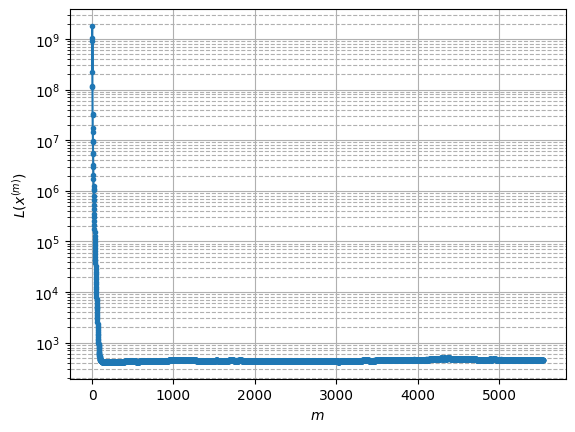

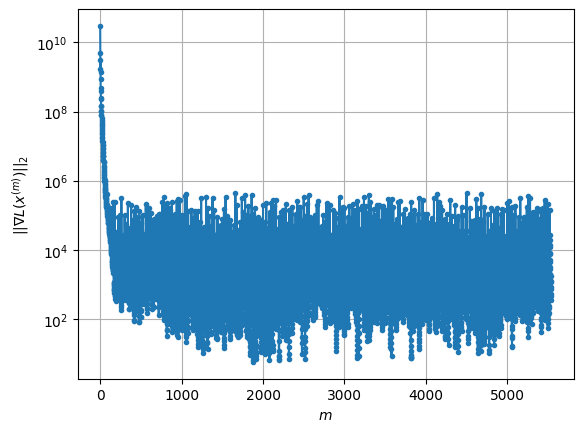

Windows:  94%|█████████▎| 277/296 [2:51:01<10:45, 33.99s/it]

Before applying the algorithm
Cost function: 459.4683658326084
Gradient norm: 135096.52300647093
Global relative error: 2.9076702714820732
Position relative errors: 0.01727300440057432 m, 2.278320977363668 m, 1.6869678469804983 m, 0.6462473895573073 m

Iteration 1
Cost function: 458.9743832875225 (-0.11%)
Gradient norm: 25465.439926890536 (-81.15%)
Global relative error: 2.8625315826861493 (-1.55%)
Position relative errors: 0.01917187266860753 m, 2.572291604124977 m, 1.1521576665337943 m, 0.49956446209735367 m

Iteration 2
Cost function: 458.90580407803503 (-0.01%)
Gradient norm: 13199.790167077044 (-48.17%)
Global relative error: 2.754615112532351 (-3.77%)
Position relative errors: 0.019322189214360228 m, 2.332138186476146 m, 1.214796304739829 m, 0.820322110309634 m

Iteration 3
Cost function: 458.87877866287596 (-0.01%)
Gradient norm: 10313.194754440205 (-21.87%)
Global relative error: 2.9293704139828054 (6.34%)
Position relative errors: 0.019435182113336755 m, 2.622018803023253 m, 1

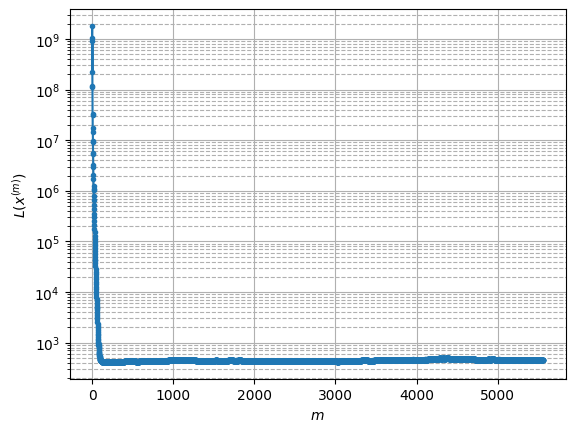

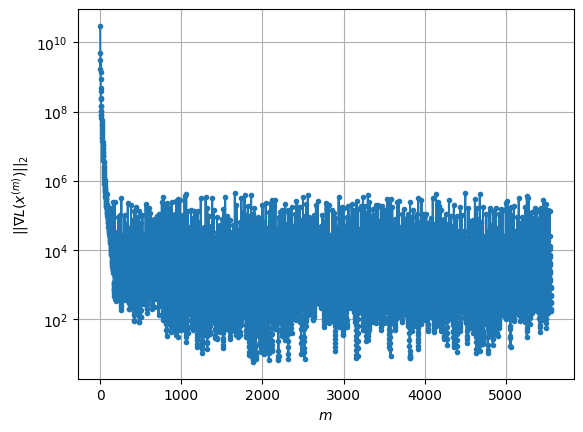

Windows:  94%|█████████▍| 278/296 [2:51:35<10:11, 33.98s/it]

Before applying the algorithm
Cost function: 459.4955005898685
Gradient norm: 95983.56385236207
Global relative error: 2.9995053042385007
Position relative errors: 0.01965470704597321 m, 2.647189691178293 m, 0.9925963107128883 m, 1.0018886781077498 m

Iteration 1
Cost function: 458.8063876762037 (-0.15%)
Gradient norm: 21167.375118082622 (-77.95%)
Global relative error: 3.191966026358993 (6.42%)
Position relative errors: 0.016970616991204668 m, 2.761030697085922 m, 0.8593332915211361 m, 1.3515212716478662 m

Iteration 2
Cost function: 458.594253530219 (-0.05%)
Gradient norm: 13238.838090692421 (-37.46%)
Global relative error: 3.5052267352480593 (9.81%)
Position relative errors: 0.01696766592969522 m, 3.1382775235618943 m, 0.6889921017637246 m, 1.401009019129768 m

Iteration 3
Cost function: 458.50002775093765 (-0.02%)
Gradient norm: 5598.4004529125905 (-57.71%)
Global relative error: 3.606372392703992 (2.89%)
Position relative errors: 0.01698462687375803 m, 3.1291283845408313 m, 0.6239

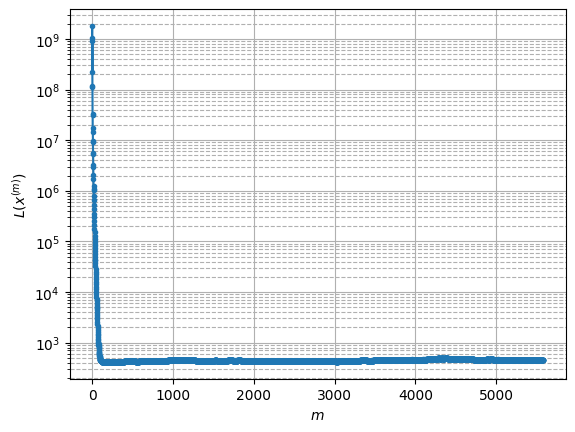

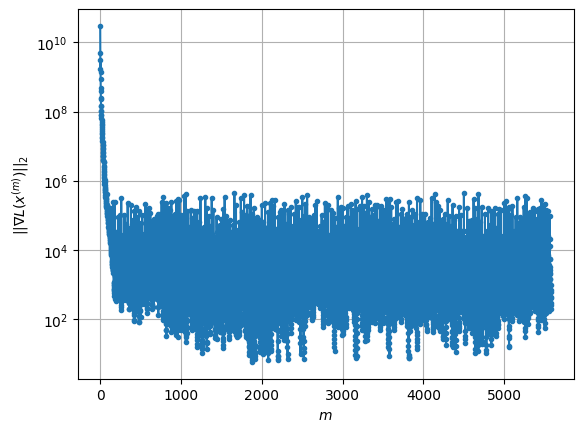

Windows:  94%|█████████▍| 279/296 [2:52:09<09:36, 33.92s/it]

Before applying the algorithm
Cost function: 457.76407447018056
Gradient norm: 37227.79148387888
Global relative error: 4.206494421488474
Position relative errors: 0.01693589641975 m, 3.5876386679892005 m, 0.34406469964422765 m, 2.169048621189905 m

Iteration 1
Cost function: 457.40866648942733 (-0.08%)
Gradient norm: 15994.274635808457 (-57.04%)
Global relative error: 4.289291829965577 (1.97%)
Position relative errors: 0.02149211233586228 m, 3.5342242505582266 m, 0.5562366268335693 m, 2.3658862081323933 m

Iteration 2
Cost function: 457.367505657838 (-0.01%)
Gradient norm: 11058.856315704737 (-30.86%)
Global relative error: 4.39904115199548 (2.56%)
Position relative errors: 0.021598398555042742 m, 3.6877238310915588 m, 0.5361384853081881 m, 2.337592833664662 m

Iteration 3
Cost function: 457.3510614983621 (-0.00%)
Gradient norm: 6968.6224202371795 (-36.99%)
Global relative error: 4.442538909956006 (0.99%)
Position relative errors: 0.02167184049422748 m, 3.679390588265243 m, 0.53576381

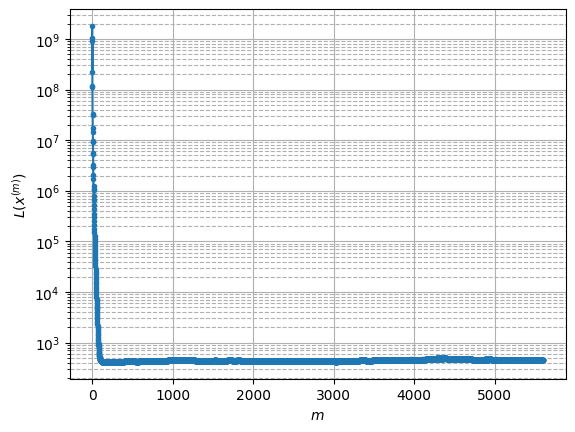

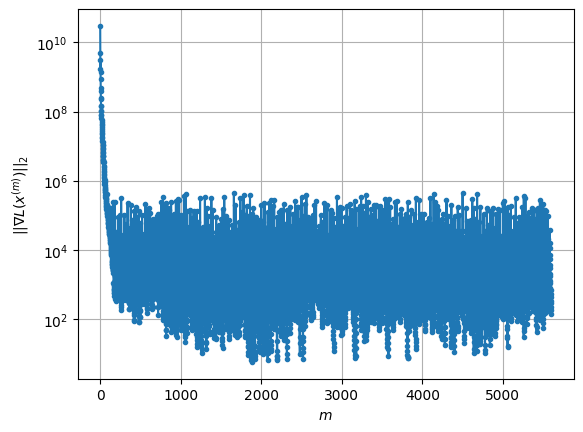

Windows:  95%|█████████▍| 280/296 [2:52:42<09:01, 33.82s/it]

Before applying the algorithm
Cost function: 454.5061868117214
Gradient norm: 122056.18420814612
Global relative error: 4.797582253732706
Position relative errors: 0.020869780634121347 m, 3.9102340738609955 m, 0.4170810354833142 m, 2.7481753228987413 m

Iteration 1
Cost function: 454.13661531024803 (-0.08%)
Gradient norm: 16344.457367638148 (-86.61%)
Global relative error: 4.833502751055969 (0.75%)
Position relative errors: 0.01403230328673147 m, 3.836411516445327 m, 0.29060577718121866 m, 2.9257548814545613 m

Iteration 2
Cost function: 454.08476155656 (-0.01%)
Gradient norm: 9383.239112407677 (-42.59%)
Global relative error: 4.929463264060986 (1.99%)
Position relative errors: 0.013949446026058803 m, 3.9406460165890977 m, 0.30542152894346764 m, 2.9457486382269717 m

Iteration 3
Cost function: 454.06871385676175 (-0.00%)
Gradient norm: 5251.544137604023 (-44.03%)
Global relative error: 4.9754024060072615 (0.93%)
Position relative errors: 0.013901264986181931 m, 3.9450988509614286 m, 0.

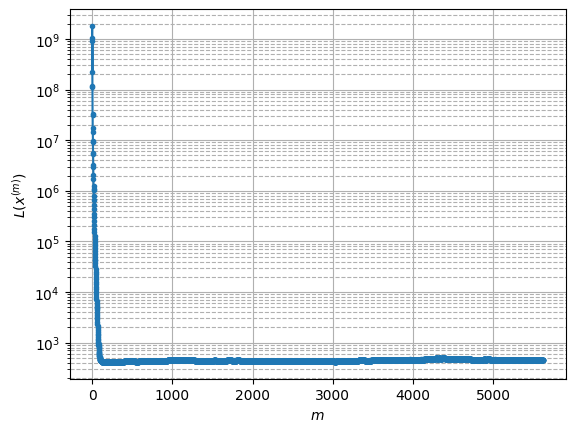

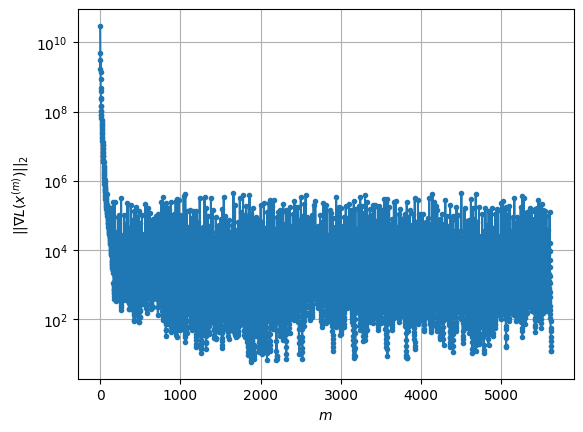

Windows:  95%|█████████▍| 281/296 [2:53:16<08:27, 33.84s/it]

Before applying the algorithm
Cost function: 455.42416022678873
Gradient norm: 101816.01421129434
Global relative error: 5.004997855403954
Position relative errors: 0.013492245410372913 m, 3.892124385886356 m, 0.37180848094460833 m, 3.1245707230151707 m

Iteration 1
Cost function: 455.03644481998333 (-0.09%)
Gradient norm: 5438.722722147413 (-94.66%)
Global relative error: 5.288203737753268 (5.66%)
Position relative errors: 0.014082367609679526 m, 3.829717622179631 m, 0.28326283886497383 m, 3.6356459366642113 m

Iteration 2
Cost function: 455.00004281515515 (-0.01%)
Gradient norm: 5893.862552355947 (8.37%)
Global relative error: 5.40349161912245 (2.18%)
Position relative errors: 0.01407580237469689 m, 4.033508414820991 m, 0.25603755038620796 m, 3.5864709290933523 m

Iteration 3
Cost function: 454.9920910760397 (-0.00%)
Gradient norm: 3661.6832072660764 (-37.87%)
Global relative error: 5.48999173605721 (1.60%)
Position relative errors: 0.014077396573393046 m, 4.028112468868382 m, 0.2687

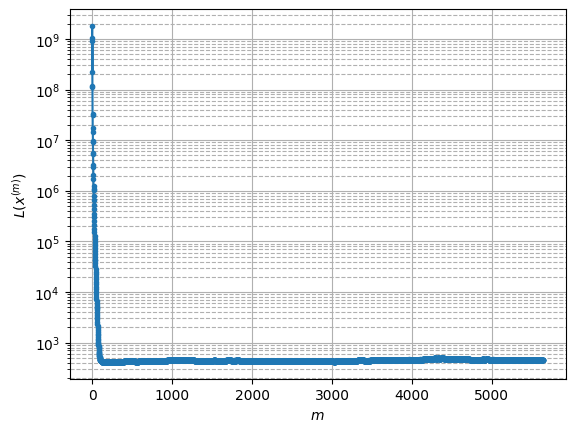

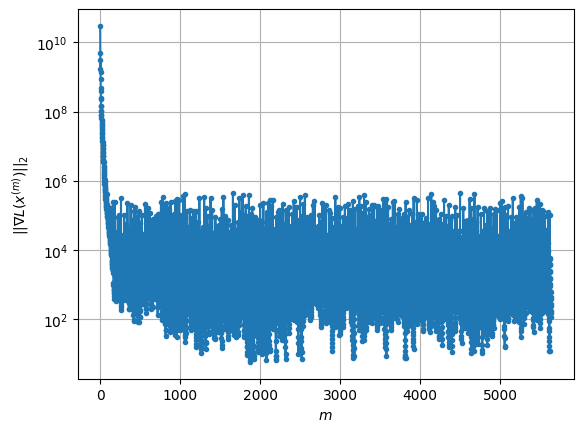

Windows:  95%|█████████▌| 282/296 [2:53:50<07:54, 33.87s/it]

Before applying the algorithm
Cost function: 453.2287131623032
Gradient norm: 192099.38017749498
Global relative error: 5.764462520952748
Position relative errors: 0.01373673277277723 m, 4.183523171644552 m, 0.31430597656364617 m, 3.953249284437304 m

Iteration 1
Cost function: 452.5923424737493 (-0.14%)
Gradient norm: 25638.95646512298 (-86.65%)
Global relative error: 5.98112580705887 (3.76%)
Position relative errors: 0.012592051713011154 m, 4.031068200537849 m, 0.7469304034987777 m, 4.355030011852103 m

Iteration 2
Cost function: 452.4243166741349 (-0.04%)
Gradient norm: 15460.405885734785 (-39.70%)
Global relative error: 6.2750840244705985 (4.91%)
Position relative errors: 0.012181804700611025 m, 4.389641662737876 m, 0.8154067344329089 m, 4.40938592784921 m

Iteration 3
Cost function: 452.3553276694639 (-0.02%)
Gradient norm: 5413.802547129909 (-64.98%)
Global relative error: 6.443657938069196 (2.69%)
Position relative errors: 0.011963886107531508 m, 4.396110571163905 m, 0.898804974

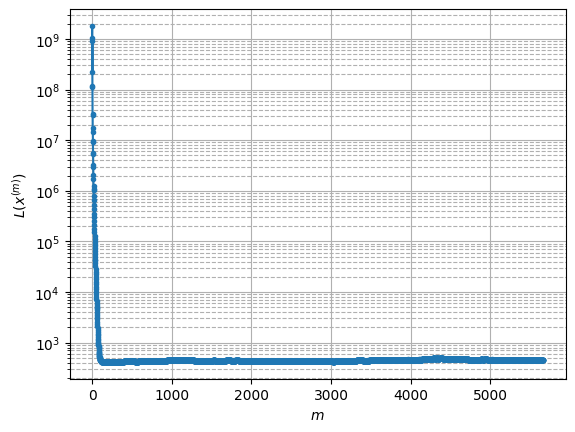

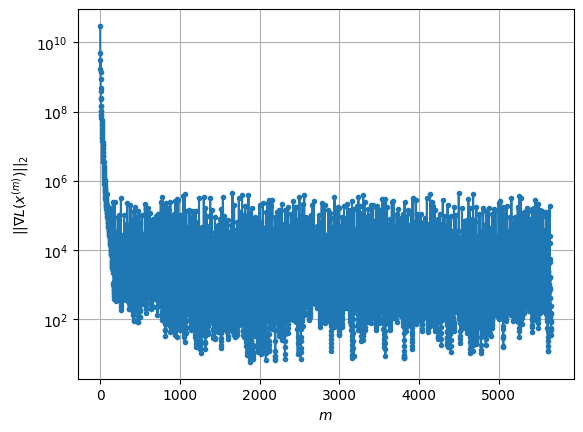

Windows:  96%|█████████▌| 283/296 [2:54:24<07:21, 33.93s/it]

Before applying the algorithm
Cost function: 452.9674053858649
Gradient norm: 351147.33019003965
Global relative error: 6.977183008107543
Position relative errors: 0.01144311843262414 m, 4.715463271050181 m, 1.166350790032703 m, 5.008490641863052 m

Iteration 1
Cost function: 452.2489388640166 (-0.16%)
Gradient norm: 21383.353763236275 (-93.91%)
Global relative error: 6.90911531827442 (-0.98%)
Position relative errors: 0.009396918515426955 m, 3.8101970686512097 m, 1.5106937456144007 m, 5.5620124809078035 m

Iteration 2
Cost function: 452.1740653551341 (-0.02%)
Gradient norm: 11245.367196314734 (-47.41%)
Global relative error: 6.804866938332192 (-1.51%)
Position relative errors: 0.009326313716490908 m, 4.207563692346709 m, 1.4539126604608346 m, 5.146714213960828 m

Iteration 3
Cost function: 452.15442818491664 (-0.00%)
Gradient norm: 9746.143731716898 (-13.33%)
Global relative error: 6.7769297373231865 (-0.41%)
Position relative errors: 0.009369107374803952 m, 3.8904207237323893 m, 1.42

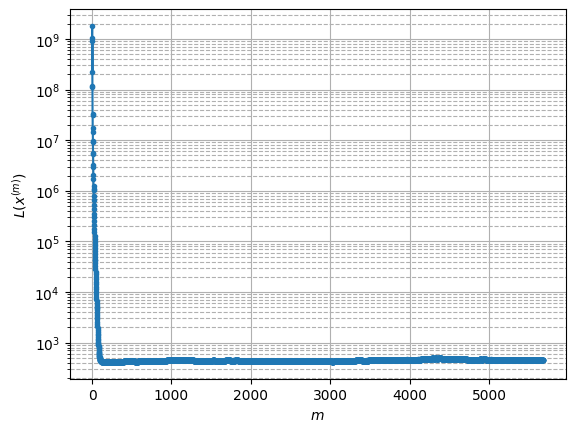

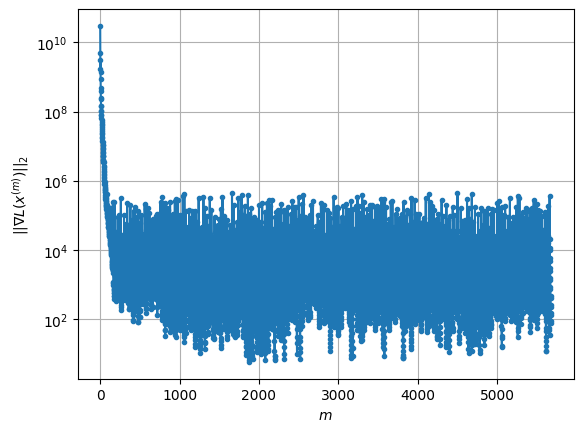

Windows:  96%|█████████▌| 284/296 [2:55:01<06:57, 34.81s/it]

Before applying the algorithm
Cost function: 445.7803453062882
Gradient norm: 92493.68267397801
Global relative error: 6.624649759192143
Position relative errors: 0.009208363793129276 m, 3.8007602582945053 m, 1.4504002760390071 m, 5.22842750008232 m

Iteration 1
Cost function: 445.1586142662584 (-0.14%)
Gradient norm: 5557.498998276604 (-93.99%)
Global relative error: 6.5103531619614525 (-1.73%)
Position relative errors: 0.010269634685815123 m, 3.172762911219465 m, 1.9400366907897162 m, 5.343633400662176 m

Iteration 2
Cost function: 445.0791806947899 (-0.02%)
Gradient norm: 5429.675167360317 (-2.30%)
Global relative error: 6.350430407697457 (-2.46%)
Position relative errors: 0.010237764743234581 m, 3.302956732953342 m, 1.8032016500714951 m, 5.115348918849499 m

Iteration 3
Cost function: 445.0604298885002 (-0.00%)
Gradient norm: 4061.5038882490435 (-25.20%)
Global relative error: 6.268302895714169 (-1.29%)
Position relative errors: 0.010214194011419918 m, 3.1049031006697216 m, 1.78175

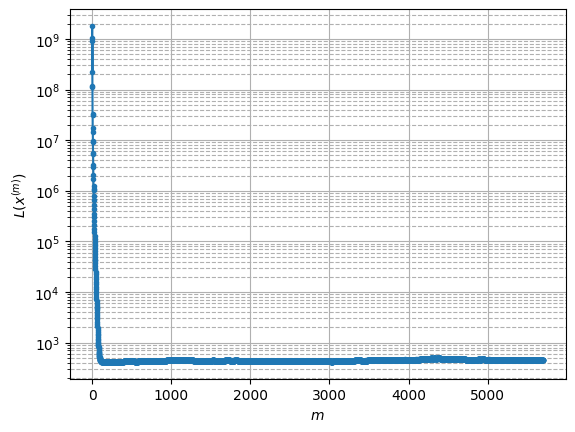

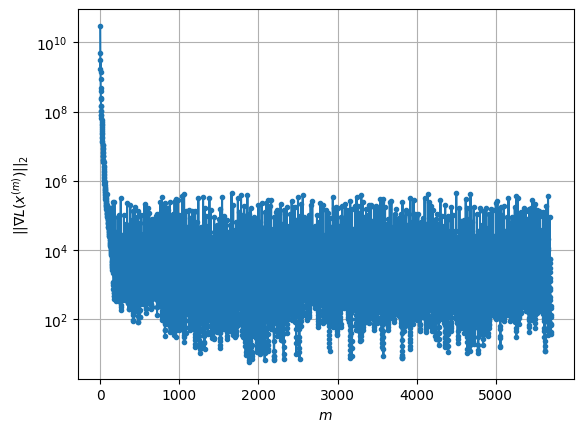

Windows:  96%|█████████▋| 285/296 [2:55:36<06:22, 34.74s/it]

Before applying the algorithm
Cost function: 446.8403051216039
Gradient norm: 71025.52258256797
Global relative error: 5.833671935450471
Position relative errors: 0.010452575970806552 m, 2.7274255449509366 m, 1.694537123071237 m, 4.870452120568974 m

Iteration 1
Cost function: 446.63245373963497 (-0.05%)
Gradient norm: 20777.10815788273 (-70.75%)
Global relative error: 5.7136263682472235 (-2.06%)
Position relative errors: 0.010402876953903923 m, 2.8791377311636634 m, 1.5222695941424884 m, 4.694536182607587 m

Iteration 2
Cost function: 446.5822635398641 (-0.01%)
Gradient norm: 11661.77907295621 (-43.87%)
Global relative error: 5.683215076231965 (-0.53%)
Position relative errors: 0.010485179766521704 m, 2.7267141968235244 m, 1.4972646912353582 m, 4.7562635569186655 m

Iteration 3
Cost function: 446.56271376402935 (-0.00%)
Gradient norm: 7401.951140499482 (-36.53%)
Global relative error: 5.632057926173173 (-0.90%)
Position relative errors: 0.010540413191692738 m, 2.7916651759972355 m, 1.

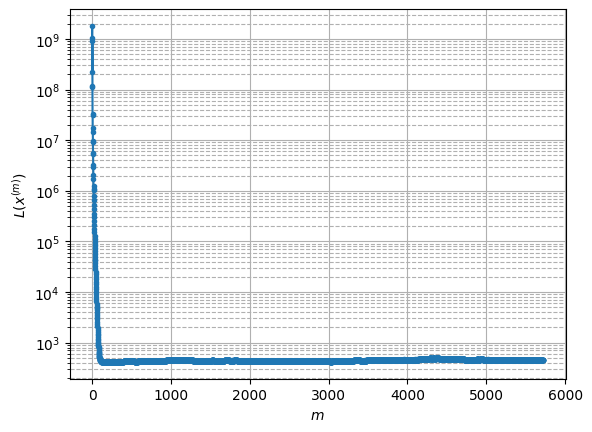

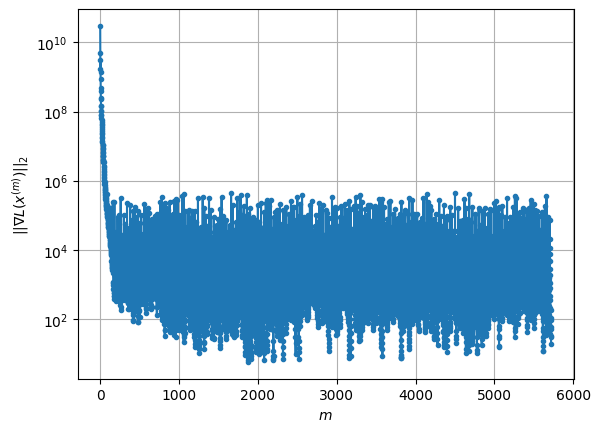

Windows:  97%|█████████▋| 286/296 [2:56:10<05:47, 34.71s/it]

Before applying the algorithm
Cost function: 449.6145013146241
Gradient norm: 159085.22746020713
Global relative error: 5.555732578613841
Position relative errors: 0.011360644512071716 m, 2.5787933192299124 m, 1.500476244727479 m, 4.686621633863869 m

Iteration 1
Cost function: 448.45653123387666 (-0.26%)
Gradient norm: 33033.962612852556 (-79.24%)
Global relative error: 4.964149444117633 (-10.65%)
Position relative errors: 0.012940374037654374 m, 2.285754973649402 m, 2.2395743097161556 m, 3.795027413455592 m

Iteration 2
Cost function: 448.2549532061561 (-0.04%)
Gradient norm: 16265.009319032803 (-50.76%)
Global relative error: 4.714227807129613 (-5.03%)
Position relative errors: 0.01287539403302742 m, 1.9540778889396404 m, 1.938129830903424 m, 3.8274012420550383 m

Iteration 3
Cost function: 448.187894210508 (-0.01%)
Gradient norm: 11023.002541806374 (-32.23%)
Global relative error: 4.427418762135672 (-6.08%)
Position relative errors: 0.012827653795180707 m, 1.895624920831746 m, 1.91

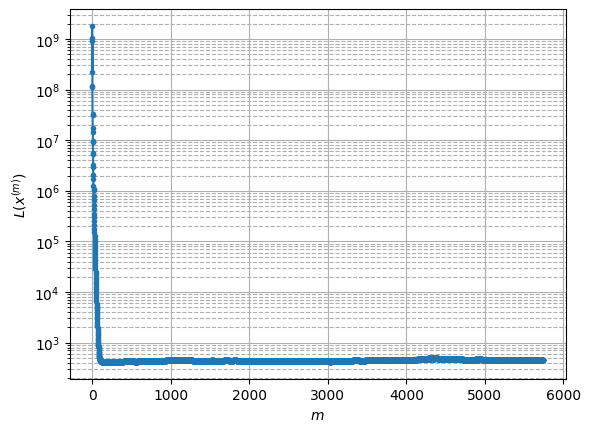

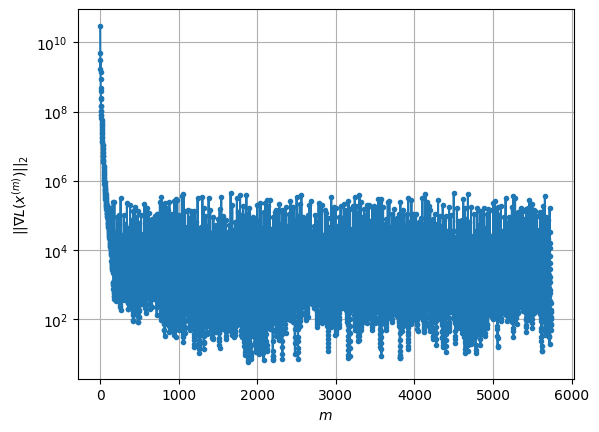

Windows:  97%|█████████▋| 287/296 [2:56:44<05:09, 34.36s/it]

Before applying the algorithm
Cost function: 443.61550249416484
Gradient norm: 119504.78467994105
Global relative error: 3.6107242795766026
Position relative errors: 0.014047734274267204 m, 1.1130739758442074 m, 1.6591489721458648 m, 3.007559188860843 m

Iteration 1
Cost function: 443.22029079231135 (-0.09%)
Gradient norm: 20966.330000689202 (-82.46%)
Global relative error: 3.9250691641618407 (8.71%)
Position relative errors: 0.013968407156437164 m, 1.001165487784006 m, 1.5354251512573565 m, 3.4707490584311205 m

Iteration 2
Cost function: 443.1766181480953 (-0.01%)
Gradient norm: 10930.735695199886 (-47.87%)
Global relative error: 3.878696808080634 (-1.18%)
Position relative errors: 0.01401007715658868 m, 1.1090233740806015 m, 1.6128793206799736 m, 3.34854742973804 m

Iteration 3
Cost function: 443.1653758127576 (-0.00%)
Gradient norm: 6887.851009367189 (-36.99%)
Global relative error: 3.962381766994395 (2.16%)
Position relative errors: 0.014028214039775923 m, 1.0708098883293182 m, 1.

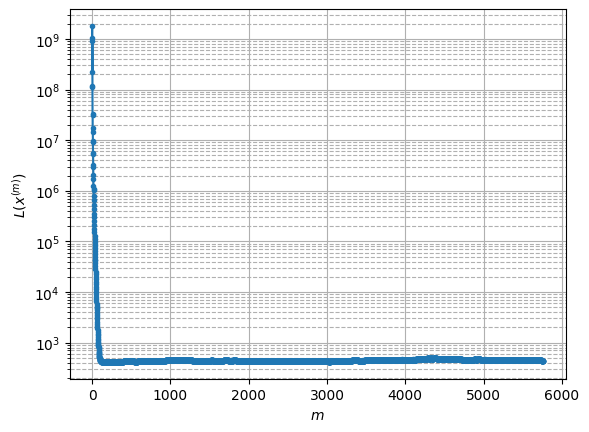

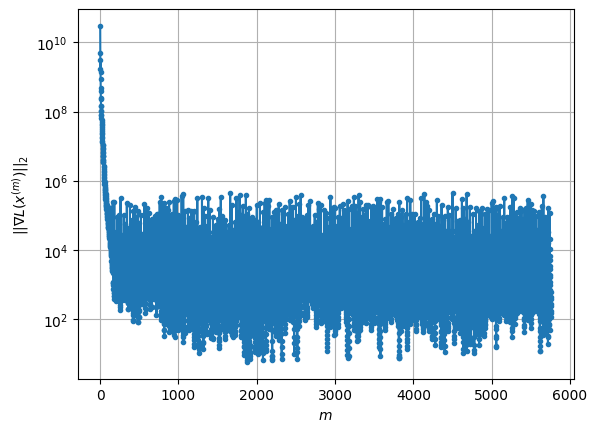

Windows:  97%|█████████▋| 288/296 [2:57:19<04:35, 34.45s/it]

Before applying the algorithm
Cost function: 444.77005590702794
Gradient norm: 217533.57506960945
Global relative error: 4.04300331814433
Position relative errors: 0.015235480255966142 m, 0.9962274588699862 m, 1.7032225863148978 m, 3.52876717400656 m

Iteration 1
Cost function: 444.5833196269612 (-0.04%)
Gradient norm: 14696.296928403195 (-93.24%)
Global relative error: 3.9558293126531443 (-2.16%)
Position relative errors: 0.015646667859222144 m, 1.2766389804393403 m, 1.6571159810487681 m, 3.3574528931786225 m

Iteration 2
Cost function: 444.5446472907681 (-0.01%)
Gradient norm: 9460.129125580925 (-35.63%)
Global relative error: 4.060522847186505 (2.65%)
Position relative errors: 0.015523483514502794 m, 1.125542447679806 m, 1.6355524844457088 m, 3.5419933235384375 m

Iteration 3
Cost function: 444.5284482468558 (-0.00%)
Gradient norm: 6149.923086868234 (-34.99%)
Global relative error: 4.028893873649388 (-0.78%)
Position relative errors: 0.015463565764679176 m, 1.294043452576045 m, 1.65

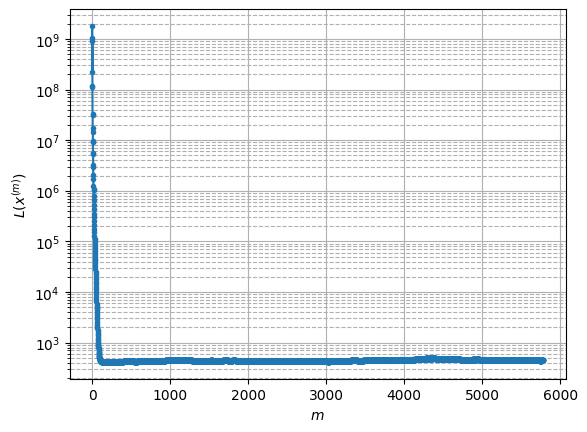

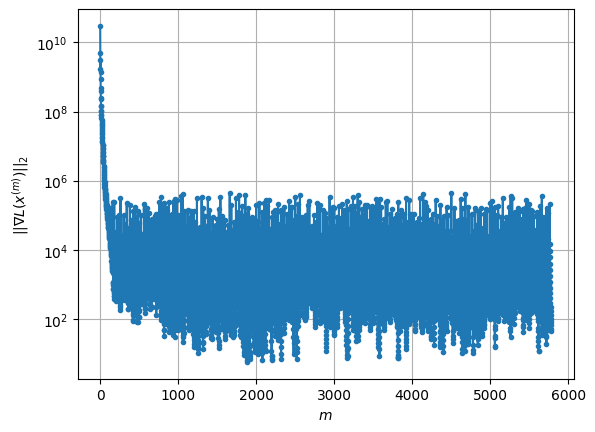

Windows:  98%|█████████▊| 289/296 [2:57:53<04:00, 34.34s/it]

Before applying the algorithm
Cost function: 444.1581520875544
Gradient norm: 140049.4113596235
Global relative error: 4.213163538884434
Position relative errors: 0.016422233067840637 m, 1.221003634372721 m, 1.7296420201045097 m, 3.6425203988588293 m

Iteration 1
Cost function: 444.0379005116563 (-0.03%)
Gradient norm: 14312.806574174212 (-89.78%)
Global relative error: 4.183468305580742 (-0.70%)
Position relative errors: 0.018825965602488674 m, 1.1682272119845312 m, 1.7948555658473928 m, 3.5937139655852786 m

Iteration 2
Cost function: 444.02527983703243 (-0.00%)
Gradient norm: 6556.821828106939 (-54.19%)
Global relative error: 4.201952441194132 (0.44%)
Position relative errors: 0.018892500411768366 m, 1.239105978615598 m, 1.7931248245287086 m, 3.592402474402391 m

Iteration 3
Cost function: 444.0216461260726 (-0.00%)
Gradient norm: 3844.0942067163974 (-41.37%)
Global relative error: 4.223777025404814 (0.52%)
Position relative errors: 0.018911460076023713 m, 1.2007414442361517 m, 1.80

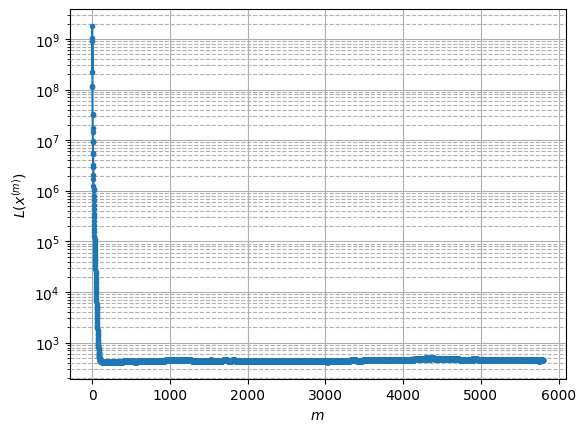

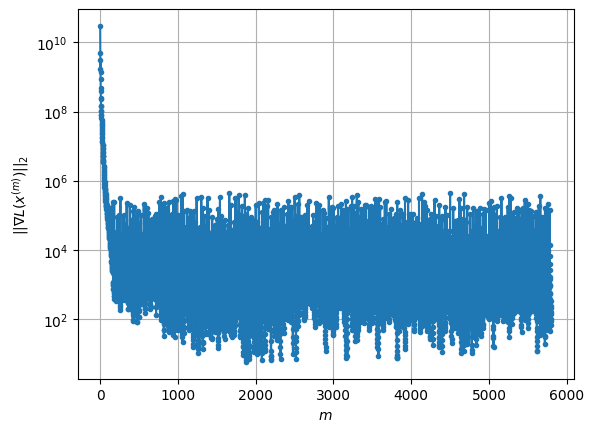

Windows:  98%|█████████▊| 290/296 [2:58:27<03:25, 34.29s/it]

Before applying the algorithm
Cost function: 445.32820831842326
Gradient norm: 140638.60140680682
Global relative error: 4.148009546089842
Position relative errors: 0.02018500445928086 m, 1.024670200110517 m, 1.8336098206968507 m, 3.5767986562263254 m

Iteration 1
Cost function: 444.62555518876934 (-0.16%)
Gradient norm: 24372.795548172933 (-82.67%)
Global relative error: 3.8716181748861502 (-6.66%)
Position relative errors: 0.029827522962997028 m, 1.1014587523867663 m, 2.3846385012527485 m, 2.8440834721331014 m

Iteration 2
Cost function: 444.54735179401195 (-0.02%)
Gradient norm: 10542.448949199365 (-56.75%)
Global relative error: 3.821759152462082 (-1.29%)
Position relative errors: 0.029744214850034187 m, 0.7553203101675133 m, 2.1961942049414436 m, 3.034990241028682 m

Iteration 3
Cost function: 444.52269873224924 (-0.01%)
Gradient norm: 5449.228470820869 (-48.31%)
Global relative error: 3.6104696339724454 (-5.53%)
Position relative errors: 0.029744860582605046 m, 0.8529608343493226

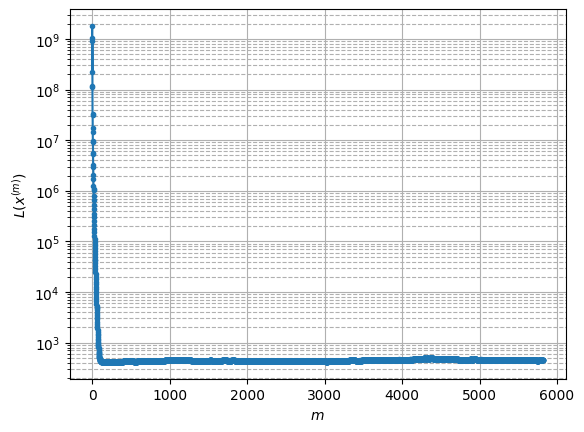

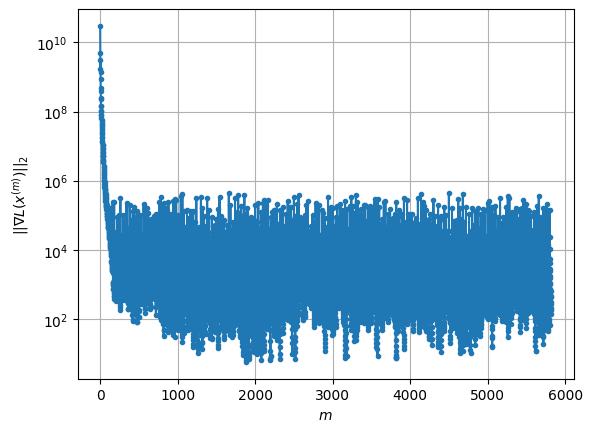

Windows:  98%|█████████▊| 291/296 [2:59:01<02:51, 34.23s/it]

Before applying the algorithm
Cost function: 445.4618114397706
Gradient norm: 76007.36451970323
Global relative error: 3.1283330950969845
Position relative errors: 0.030619197873272892 m, 0.3402165292543278 m, 2.0265780873806225 m, 2.358547791304487 m

Iteration 1
Cost function: 445.1113547684701 (-0.08%)
Gradient norm: 30635.625745074474 (-59.69%)
Global relative error: 2.794992066781443 (-10.66%)
Position relative errors: 0.02531923653433287 m, 0.358186795759415 m, 2.0925619734005343 m, 1.8177482221842234 m

Iteration 2
Cost function: 445.01886769092016 (-0.02%)
Gradient norm: 19901.624936234737 (-35.04%)
Global relative error: 2.746968904900343 (-1.72%)
Position relative errors: 0.02518181698766312 m, 0.371011467503522 m, 1.9616030467945191 m, 1.8867035987159944 m

Iteration 3
Cost function: 444.9765938767851 (-0.01%)
Gradient norm: 13234.431124228995 (-33.50%)
Global relative error: 2.5748033997428945 (-6.27%)
Position relative errors: 0.025136417880216175 m, 0.37700332625550054 m,

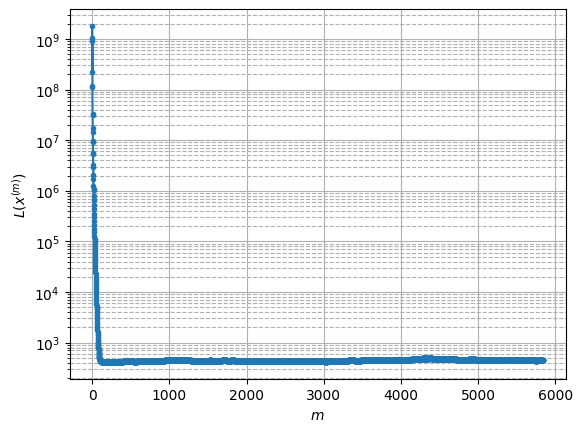

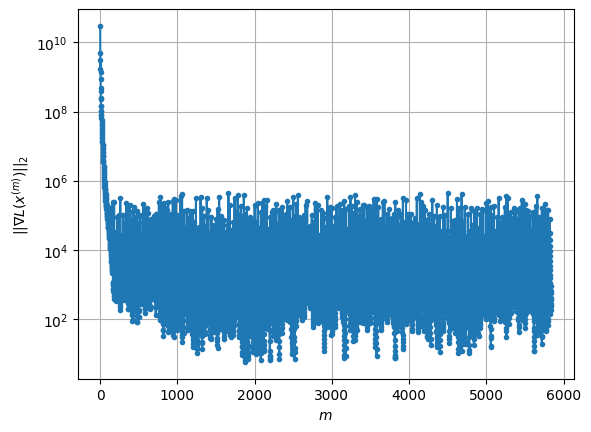

Windows:  99%|█████████▊| 292/296 [2:59:35<02:16, 34.18s/it]

Before applying the algorithm
Cost function: 445.41741726167504
Gradient norm: 84819.51004002194
Global relative error: 2.270022172867749
Position relative errors: 0.026104799858781665 m, 0.9272686735741136 m, 1.718938681519073 m, 1.1566000394806497 m

Iteration 1
Cost function: 445.1008963612814 (-0.07%)
Gradient norm: 22161.591844948507 (-73.87%)
Global relative error: 2.0750440778534207 (-8.59%)
Position relative errors: 0.023101534506113144 m, 0.9175365932422472 m, 1.1960129246643623 m, 1.4258105039266502 m

Iteration 2
Cost function: 445.0640500571152 (-0.01%)
Gradient norm: 8370.362153468723 (-62.23%)
Global relative error: 2.014180895124907 (-2.93%)
Position relative errors: 0.02293749303604819 m, 0.7798019968813666 m, 1.264869252848955 m, 1.3595566993166865 m

Iteration 3
Cost function: 445.0521386554834 (-0.00%)
Gradient norm: 4482.43394527778 (-46.45%)
Global relative error: 2.107619739454217 (4.64%)
Position relative errors: 0.022804498008950607 m, 0.8106225447964905 m, 1.24

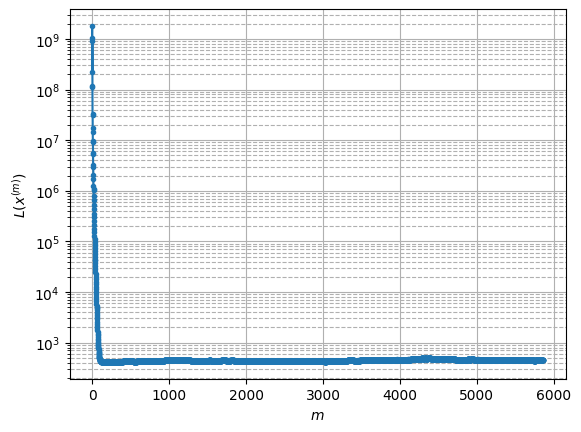

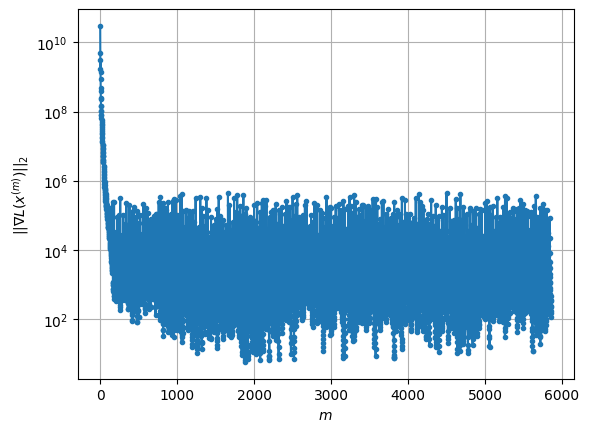

Windows:  99%|█████████▉| 293/296 [3:00:08<01:41, 33.96s/it]

Before applying the algorithm
Cost function: 433.43753491523347
Gradient norm: 41070.67032327323
Global relative error: 2.2059446056338103
Position relative errors: 0.02348587650831592 m, 0.7427230728709997 m, 1.3523554123352752 m, 1.5764257886340602 m

Iteration 1
Cost function: 432.0930998293151 (-0.31%)
Gradient norm: 44283.755810338705 (7.82%)
Global relative error: 1.7146909495319662 (-22.27%)
Position relative errors: 0.024418020716455317 m, 0.4860122771622072 m, 1.3021288016960602 m, 1.0038894532223397 m

Iteration 2
Cost function: 431.93661282176714 (-0.04%)
Gradient norm: 25237.54930548061 (-43.01%)
Global relative error: 1.7713528469193394 (3.30%)
Position relative errors: 0.02408776557963509 m, 0.5541642782396605 m, 1.2307117350283676 m, 1.1468792142444149 m

Iteration 3
Cost function: 431.88915881312823 (-0.01%)
Gradient norm: 15541.204073410063 (-38.42%)
Global relative error: 1.7438397517782387 (-1.55%)
Position relative errors: 0.023916339624207906 m, 0.5049649963019329 

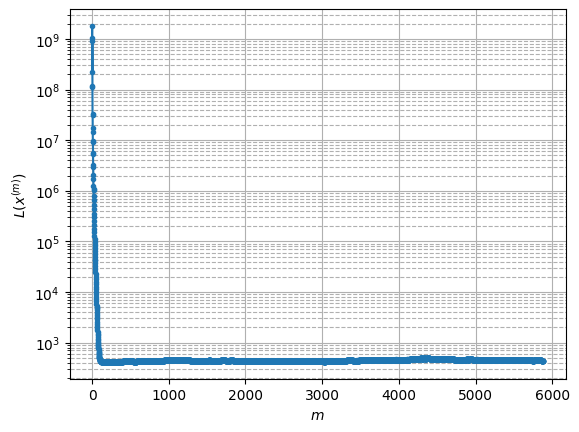

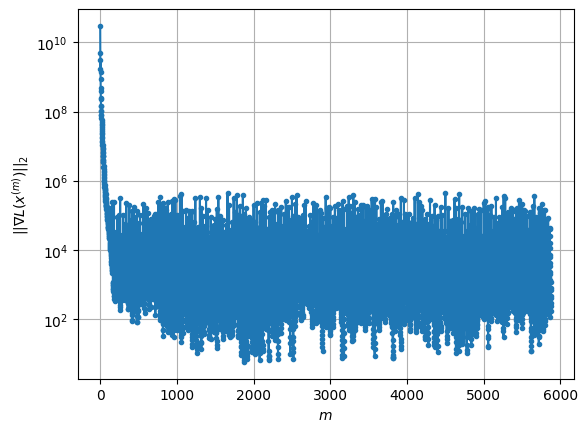

Windows:  99%|█████████▉| 294/296 [3:00:43<01:08, 34.14s/it]

Before applying the algorithm
Cost function: 431.1347656203603
Gradient norm: 87595.66984505845
Global relative error: 1.7644560469537949
Position relative errors: 0.024584010167067034 m, 0.5740481774493918 m, 1.316927211797927 m, 1.0241254611128054 m

Iteration 1
Cost function: 430.7358695998586 (-0.09%)
Gradient norm: 11492.459887044535 (-86.88%)
Global relative error: 2.2770081860672313 (29.05%)
Position relative errors: 0.026482353324618936 m, 1.1163125402830416 m, 1.6533281717772554 m, 1.0974396014084695 m

Iteration 2
Cost function: 430.673168956757 (-0.01%)
Gradient norm: 8909.17843274269 (-22.48%)
Global relative error: 2.044943185139051 (-10.19%)
Position relative errors: 0.02631653416291826 m, 1.0046647980765815 m, 1.574608441144406 m, 0.8320528579422278 m

Iteration 3
Cost function: 430.6489340489409 (-0.01%)
Gradient norm: 5411.479893759398 (-39.26%)
Global relative error: 2.1547008142381756 (5.37%)
Position relative errors: 0.02617341285972102 m, 1.267663376185478 m, 1.499

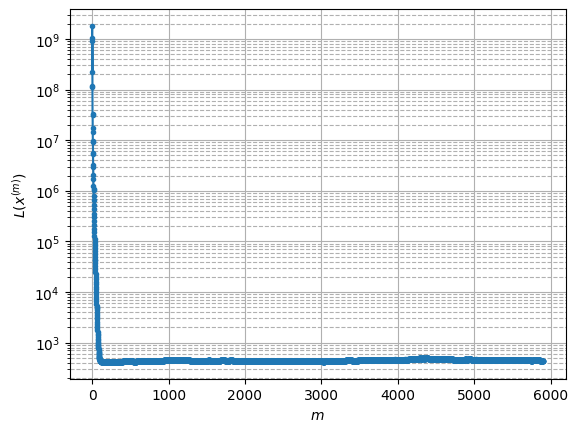

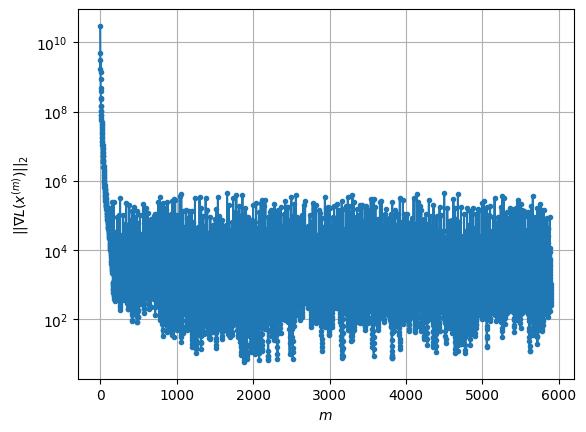

Windows: 100%|█████████▉| 295/296 [3:01:17<00:34, 34.17s/it]

Before applying the algorithm
Cost function: 435.24958629452505
Gradient norm: 331481.3399383089
Global relative error: 2.3426295976575493
Position relative errors: 0.026819534732908042 m, 1.8193519794381579 m, 1.3078431614720207 m, 0.6831186475019763 m

Iteration 1
Cost function: 434.8289801165023 (-0.10%)
Gradient norm: 25088.716348076254 (-92.43%)
Global relative error: 1.9302027646378905 (-17.61%)
Position relative errors: 0.030266633705399767 m, 1.6565913738641758 m, 0.8413528580451289 m, 0.5220652928965587 m

Iteration 2
Cost function: 434.78976068691475 (-0.01%)
Gradient norm: 15767.296769950859 (-37.15%)
Global relative error: 1.9491625726911885 (0.98%)
Position relative errors: 0.030205431830983467 m, 1.6451679551600724 m, 0.8839654532713186 m, 0.557050085887037 m

Iteration 3
Cost function: 434.77641242718227 (-0.00%)
Gradient norm: 10464.01361139936 (-33.63%)
Global relative error: 1.897609124964334 (-2.64%)
Position relative errors: 0.03017243093397302 m, 1.591105391252918 

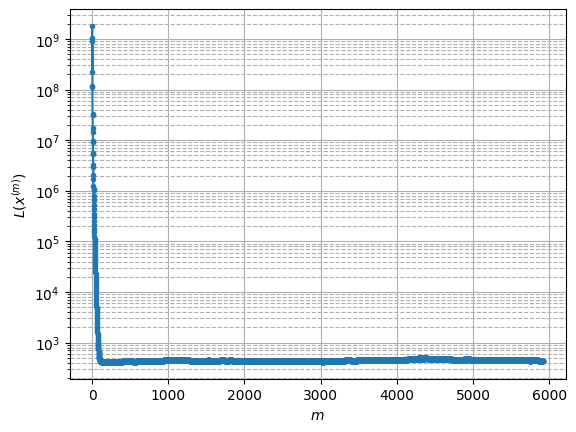

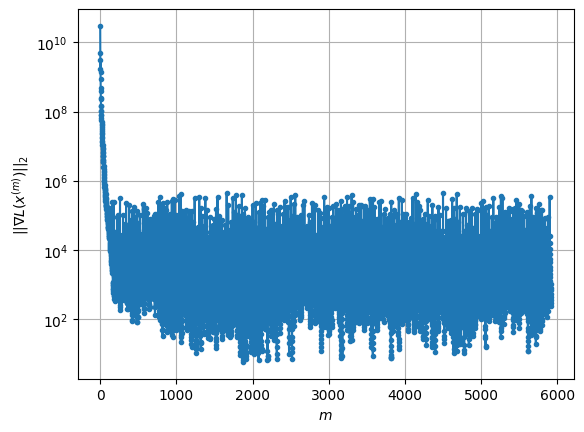

RMSE after convergence:
Chief: nan m
Deputy 1: nan m
Deputy 2: nan m
Deputy 3: nan m


/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.10/dist-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


In [10]:
# Main execution loop
def run_estimation():
    
    Y = np.zeros((9, 1, T))
    for t in range(T):
        Y[:, :, t] = h(X_true[:, :, t]) + np.random.normal(0, np.sqrt(np.diag(R)).reshape((9, 1)), size=(9, 1))
        
    # Initialize storage for results
    X_est_mm = np.zeros_like(X_true)
    X_est_mm[:, :, 0] = X_est[:, :, 0]  # Use same initial conditions
    
    # Storage for errors
    errors_chief_mm = []
    errors_deputy1_mm = []
    errors_deputy2_mm = []
    errors_deputy3_mm = []
    
    # Initialize solver
    solver = approxH_Newton()
    
    # Sliding window estimation
    for t in tqdm(range(T - W + 1), desc="Windows", leave=False):
        # Get measurements for current window
        Y_window = Y[:, :, t:t + W]
        
        # Initial guess is the previous estimate propagated forward
        if t == 0:
            x_init = X_est[:, :, t]
        else:
            x_init = X_est_mm[:, :, t]
        
        # Solve the optimization problem
        x_sol = solver.solve(x_init, Y_window, X_true[:, :, t])
        
        # Store the solution
        X_est_mm[:, :, t] = x_sol
        
        # Plot the results
        give_me_the_plots(solver.cost_function_values, solver.grad_norm_values)
        
        # Propagate solution to next timestep if not at the end
        if t < T - W:
            X_est_mm[:, :, t + 1] = SatelliteDynamics().x_new(dt, x_sol)
        
        # Calculate and store errors
        error_chief = np.linalg.norm(X_est_mm[:3, :, t] - X_true[:3, :, t])
        error_deputy1 = np.linalg.norm(X_est_mm[6:9, :, t] - X_true[6:9, :, t])
        error_deputy2 = np.linalg.norm(X_est_mm[12:15, :, t] - X_true[12:15, :, t])
        error_deputy3 = np.linalg.norm(X_est_mm[18:21, :, t] - X_true[18:21, :, t])
        
        errors_chief_mm.append(error_chief)
        errors_deputy1_mm.append(error_deputy1)
        errors_deputy2_mm.append(error_deputy2)
        errors_deputy3_mm.append(error_deputy3)
    
    return X_est_mm, errors_chief_mm, errors_deputy1_mm, errors_deputy2_mm, errors_deputy3_mm

# Run the estimation
X_est_mm, errors_chief_mm, errors_deputy1_mm, errors_deputy2_mm, errors_deputy3_mm = run_estimation()

# Print RMSE for each satellite
print("RMSE after convergence:")
print(f"Chief: {np.sqrt(np.mean(np.array(errors_chief_mm[T_RMSE:])**2)):.2f} m")
print(f"Deputy 1: {np.sqrt(np.mean(np.array(errors_deputy1_mm[T_RMSE:])**2)):.2f} m")
print(f"Deputy 2: {np.sqrt(np.mean(np.array(errors_deputy2_mm[T_RMSE:])**2)):.2f} m")
print(f"Deputy 3: {np.sqrt(np.mean(np.array(errors_deputy3_mm[T_RMSE:])**2)):.2f} m")

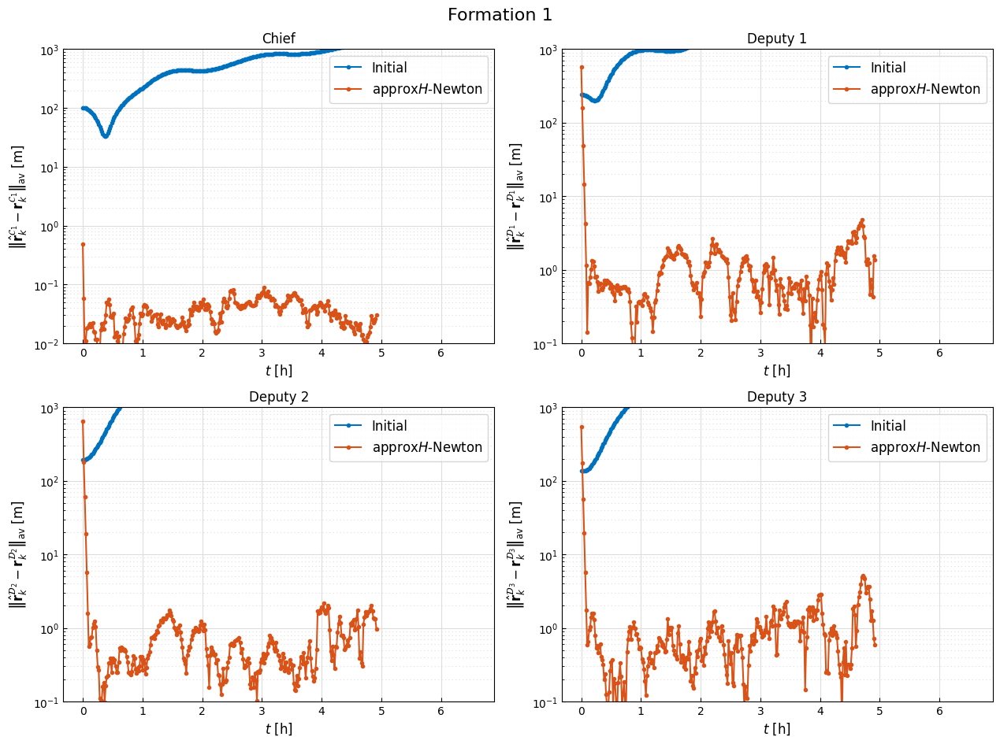

In [11]:
dev_chief = errors_chief_mm
dev_deputy1 = errors_deputy1_mm
dev_deputy2 = errors_deputy2_mm
dev_deputy3 = errors_deputy3_mm

# MATLAB default color cycle
matlab_default_colors = [
    [0, 0.4470, 0.7410],  # blue
    [0.8500, 0.3250, 0.0980],  # orange
    [0.9290, 0.6940, 0.1250],  # yellow
    [0.4940, 0.1840, 0.5560],  # purple
    [0.4660, 0.6740, 0.1880],  # green
    [0.3010, 0.7450, 0.9330],  # light blue
    [0.6350, 0.0780, 0.1840],  # red
]
# Set the color cycle in Matplotlib to match MATLAB's default
plt.rcParams["axes.prop_cycle"] = plt.cycler(color=matlab_default_colors)

time = np.arange(0, T) / dt
algorithm = "approx$H$-Newton"

# Plot positions based on screen size
fig_width = 2 * 6.4  # in inchesa
fig_height = 2 * 4.8  # in inches

# Create a 2 by 2 figure
fig, axs = plt.subplots(2, 2, figsize=(fig_width, fig_height))

# Plot 1: Chief
axs[0, 0].plot(time, dev_chief_initial, ".-", label="Initial")
axs[0, 0].plot(time[:K - W + 1], dev_chief, ".-", label=algorithm)
axs[0, 0].grid(which="major", color="#DDDDDD", zorder=1)
axs[0, 0].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[0, 0].grid(True, which="both")
axs[0, 0].set_yscale("log")
axs[0, 0].set_xlabel("$t$ [h]", fontsize=12)
axs[0, 0].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{C}_1} - \\mathbf{r}_k^{\\mathcal{C}_1}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
axs[0, 0].set_ylim([1e-2, 1e3])
axs[0, 0].tick_params(axis="both", which="both", direction="in")
axs[0, 0].legend(fontsize=12)
axs[0, 0].set_title("Chief")

# Plot 2: Deputy 1
axs[0, 1].plot(time, dev_deputy1_initial, ".-", label="Initial")
axs[0, 1].plot(time[:K - W + 1], dev_deputy1, ".-", label=algorithm)
axs[0, 1].grid(which="major", color="#DDDDDD", zorder=1)
axs[0, 1].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[0, 1].grid(True, which="both")
axs[0, 1].set_yscale("log")
axs[0, 1].set_xlabel("$t$ [h]", fontsize=12)
axs[0, 1].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{D}_1} - \\mathbf{r}_k^{\\mathcal{D}_1}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
axs[0, 1].set_ylim([1e-1, 1e3])
axs[0, 1].tick_params(axis="both", which="both", direction="in")
axs[0, 1].legend(fontsize=12)
axs[0, 1].set_title("Deputy 1")

# Plot 3: Deputy 2
axs[1, 0].plot(time, dev_deputy2_initial, ".-", label="Initial")
axs[1, 0].plot(time[:K - W + 1], dev_deputy2, ".-", label=algorithm)
axs[1, 0].grid(which="major", color="#DDDDDD", zorder=1)
axs[1, 0].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[1, 0].grid(True, which="both")
axs[1, 0].set_yscale("log")
axs[1, 0].set_xlabel("$t$ [h]", fontsize=12)
axs[1, 0].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{D}_2} - \\mathbf{r}_k^{\\mathcal{D}_2}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
axs[1, 0].set_ylim([1e-1, 1e3])
axs[1, 0].tick_params(axis="both", which="both", direction="in")
axs[1, 0].legend(fontsize=12)
axs[1, 0].set_title("Deputy 2")

# Plot 4: Deputy 3
axs[1, 1].plot(time, dev_deputy3_initial, ".-", label="Initial")
axs[1, 1].plot(time[:K - W + 1], dev_deputy3, ".-", label=algorithm)
axs[1, 1].grid(which="major", color="#DDDDDD", zorder=1)
axs[1, 1].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[1, 1].grid(True, which="both")
axs[1, 1].set_yscale("log")
axs[1, 1].set_xlabel("$t$ [h]", fontsize=12)
axs[1, 1].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{D}_3} - \\mathbf{r}_k^{\\mathcal{D}_3}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
axs[1, 1].set_ylim([1e-1, 1e3])
axs[1, 1].tick_params(axis="both", which="both", direction="in")
axs[1, 1].legend(fontsize=12)
axs[1, 1].set_title("Deputy 3")

fig.suptitle(f"Formation {formation}", fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 1])
plt.show()

In [14]:
import pickle
from datetime import datetime

# Fill the dictionary
data = {}
data["true"] = X_true
data[0] = X_est_mm

# Save to pickle file
with open(
    f'approxh_newton2_form{formation}_{datetime.now().strftime("%Y%m%d_%H%M%S")}.pkl',
    "wb",
) as file:
    pickle.dump(data, file)